# Restricted Boltzmann Machine - MNIST

## Imports

In [9]:
import dill
dill.load_session('kernel_ex2_gamma.db')

ModuleNotFoundError: No module named 'numpy._core'

In [6]:
!pip install --upgrade numpy

  Using cached numpy-1.24.4-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (17.3 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.3
    Uninstalling numpy-1.24.3:
      Successfully uninstalled numpy-1.24.3


In [73]:
import sys, datetime
import os
# numpy
import numpy as np
from numpy import exp,sqrt,log,log10,sign,power,cosh,sinh,tanh,floor
rng = np.random.default_rng(12345)
np.set_printoptions(precision=4)

# matplotlib
import matplotlib as mpl
%matplotlib inline
from matplotlib.ticker import NullFormatter, MaxNLocator
mpl.rcParams.update({"font.size": 12})  #"text.usetex": True,})
from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt

# to load MNIST
from sklearn.datasets import fetch_openml

!mkdir FIG
!mkdir FIG/FRAME
#!mkdir WEIGHTS
!mkdir DATA
if not os.path.exists('GRAPHS'):
    os.makedirs('GRAPHS')


mkdir: cannot create directory ‘FIG’: File exists
mkdir: cannot create directory ‘FIG/FRAME’: File exists
mkdir: cannot create directory ‘DATA’: File exists


## Load data

In [2]:
#import dill
#import IPython.display

#from IPython.core.display import display, HTML

# Attempt to load the session:
#try:
#dill.load_session('/content/save_ll_1.7 - Copia.db')
#except AttributeError:
    #print("Error loading session. Consider using a compatible IPython version or manually editing the session file.")
    # If you choose to edit manually, carefully inspect and modify the problematic object reference.
    # Refer to dill documentation for guidance on inspecting saved objects: https://dill.readthedocs.io/en/latest/
    # Use with caution as manual editing can corrupt the session file.

X_original, Y_original = fetch_openml("mnist_784", version=1, return_X_y=True, as_frame=False)
print(X_original.shape)

/home/jonny/.local/lib/python3.8/site-packages/sklearn/datasets/_openml.py:1022: FutureWarning: The default value of `parser` will change from `'liac-arff'` to `'auto'` in 1.4. You can set `parser='auto'` to silence this warning. Therefore, an `ImportError` will be raised from 1.4 if the dataset is dense and pandas is not installed. Note that the pandas parser may return different data types. See the Notes Section in fetch_openml's API doc for details.
  warn(


(70000, 784)


## Parameters

In [3]:
################################
#    CHOICE OF PARAMETERS      #
################################
# number of MNIST digits to keep (e.g., Ndigit=3 keeps 0,1,2)
Ndigit=3
# number of hidden units
L = 3
# use (+1,-1) if SPINS, otherwise use bits (1,0)
SPINS=False
# use one-hot encoding in hidden space if POTTS (use only if SPINS=False)
POTTS=False

dname='DATA/'
################################

# x_min =0 if bits, x_min=-1 if SPINS
# level_gap is the difference in values between the max (1) and the min (x_min)
if SPINS:
    x_min=-1
    level_gap=2.
else:
    x_min=0
    level_gap=1.

if POTTS:
    str_simul="RBM_Potts"
    # in one-hot encoding, number of possible hidden states matches L
    Nz=L
else:
    str_simul="RBM"
    # number of possible hidden states: 2**L
    Nz=2**L

if POTTS and SPINS:
    print("\n\n>>>>>>>> WARNING:  POTTS and SPINS cannot coexist\n\n")

## Select data, and digitalize them two levels

('1', '4', '7')
dataset with 21994 points, each with 784 bits

first 10 MNIST data points


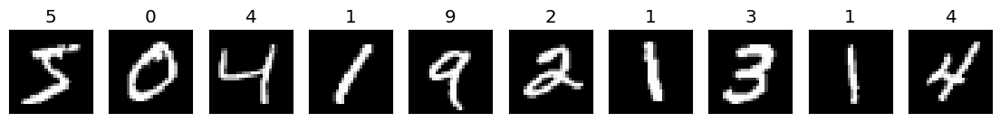

first 10 MNIST-3 data points


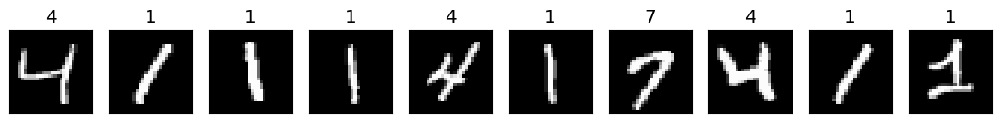

first 10 MNIST-3 data points, binarized


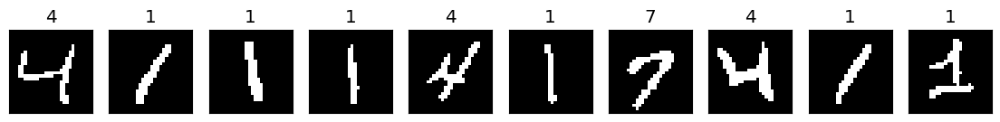

each of Nd=21994 data has D=784 bits


In [4]:
def show_MNIST(x, y=[], z=[], Nex=5, S=1.4, side=0, colors=[]):
    """Show digits"""
    if side==0: side = int(sqrt(x.shape[1]))
    if len(y)<1: y=np.full(Nex,"")
    colors=np.array(colors)
    fig, AX = plt.subplots(1,Nex,figsize=(S*Nex,S))

    for i, img in enumerate(x[:Nex].reshape(Nex, side, side)):
        if len(colors)==0: newcmp = "gray"
        else:
            col= colors[0] + (colors[1]-colors[0])*(i+1)/(Nex+1)
            newcmp = ListedColormap((col,(1,1,1,1)))
        ax=AX[i]
        ax.imshow(img, cmap=newcmp)
        ax.set_xticks([])
        ax.set_yticks([])
        if len(y)>0: ax.set_title(y[i])
        if len(z)>0: ax.set_title(''.join(map(str, z[i])),fontsize=9)
    plt.show()

def MNIST_bit(X,side=28,level=0.5):
    NX=len(X)
    #print(X.shape)
    print(f"dataset with {NX} points, each with {len(X[0])} bits\n")
    if side==14:
        X = np.reshape(X,(NX,28,28))
        # new value = average over 4 values in a 2x2 square
        Xr = 0.25*(X[:,0::2,0::2]+X[:,1::2,0::2]+X[:,0::2,1::2]+X[:,1::2,1::2])
        X  = Xr.reshape(NX,side**2)
    #print(X.shape)
    # binarize data and then convert it to 1/0 or 1/-1
    X = np.where(X/255 > level, 1, x_min)
    return X.astype("int")

list_10_digits = ('0','1','2','3','4','5','6','7','8','9')
list_digits = list_10_digits[1:8:Ndigit]
print(list_digits)
keep=np.isin(Y_original, list_digits)
X_keep,Y=X_original[keep],Y_original[keep]

data,label = MNIST_bit(X_keep),Y
data,label = data.astype("int"),label.astype("int")
print("first 10 MNIST data points")
show_MNIST(X_original, Y_original,Nex=10)
print(f"first 10 MNIST-{Ndigit} data points")
show_MNIST(X_keep, label,Nex=10)
print(f"first 10 MNIST-{Ndigit} data points, binarized")
show_MNIST(data, label,Nex=10)

# number of data points
Nd = len(data)
# number of visible units
D  = len(data[1])

print(f'each of Nd={Nd} data has D={D} bits')

## Plotting data stats

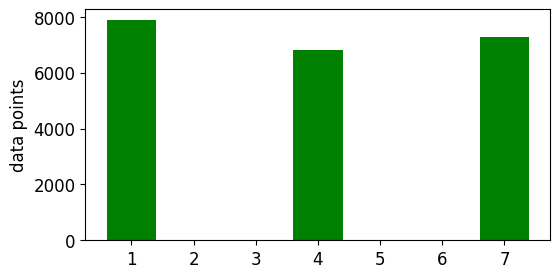

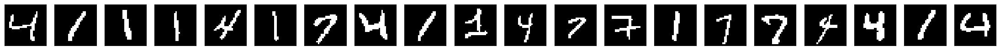

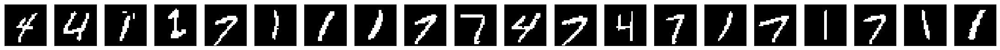

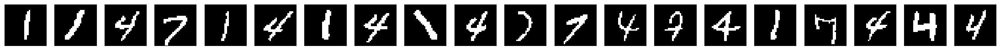

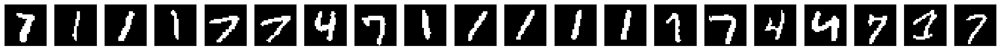

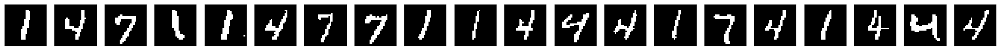

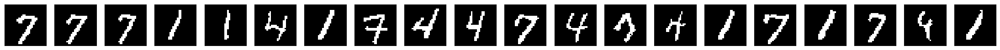

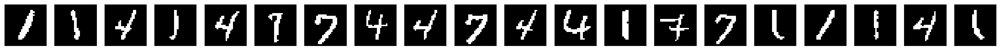

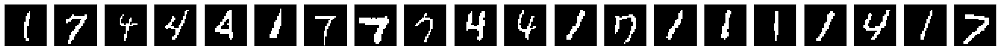

In [5]:
fig, (ax) = plt.subplots(1,1,figsize=(6,3))
ax.hist(np.sort(label),bins=[0.5,1.5,3.5,4.5,6.5,7.5],density=False,rwidth=0.8,color="g")
ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(1))
ax.set_ylabel("data points")
plt.show()
for i in range(8): show_MNIST(data[i*20:],Nex=20)

## Contrastive divergence (CD)


In [6]:
# eq(213) page 97, activation via sigmoid
# taking into account energy gap 2 for "spin" variables (-1,1)
def CD_step(v_in,wei,bias,details=False,POTTS=False):
    """
        Generates the state on the other layer:
        Field "H" ->  activation "a" -> probability "p" -> Spins/bits v_out

        Either (v_in=x, wei=w) or (v_in=z, wei=w.T)

        details = True --> returns also probability (p) and activation (a)

        POTTS means one-hot encoding (used only in hidden space)
    """
    # local "field"
    H = np.clip(np.dot(v_in, wei) + bias, a_min=-300, a_max=300)
    # "activation"
    a = exp(level_gap*H)
    n = np.shape(H)
    v_out = np.full(n, x_min, dtype=int) # initially, just a list on -1's or 0's
    if POTTS: # RBM with a single hidden unit = 1 (that is, "one-hot encoding" with L states)
        # p: state probability, normalized to 1 over all units=states
        p = a/np.sum(a)
        # F: cumulative probability
        F = np.cumsum(p)
        # pick a state "i" randomly with probability p[i]
        r = np.random.rand()
        i = 0
        while r>F[i]: i+=1
        v_out[i] = 1 # activate a single hidden unit
    else: # normal Ising RBM
        # p: local probability, normalized to 1 for each hidden unit
        p = a / (a + 1.)
        # at each position i, activate the 1's with local probability p[i]
        v_out[np.random.random_sample(n) < p] = 1

    if details: return v_out,p,a
    else: return v_out

## Plot weights

In [7]:
def plot_weights_bias(wE, bE, epoch, L,
                      side=0,cols=0,thr=0,s=1.5,
                      title=False, save=True,cmap="bwr"):
    '''
    Plot the weights of the RBM, one plot for each hidden unit.
    '''
    rows = int(np.ceil(L / cols))
    if rows==1: rows=2
    w=wE[epoch]
    b=bE[epoch]
    if side==0: side=int(sqrt(len(w)))
    if thr==0: thr=4
    plt.clf()
    fig, AX = plt.subplots(rows, cols+1, figsize=(s*(1+cols),s*rows))
    if title: fig.suptitle(f"epoch = {epoch}")
    k=1
    for i in range(rows):
        for j in range(cols):
            if rows==1: ax=AX[j+1]
            else: ax=AX[i,j+1]
            if k<=L:
                ax.imshow(w[:,k-1].reshape(side, side), cmap=cmap,vmin=-thr,vmax=thr)
                ax.set_xticks([])
                ax.set_yticks([])
                ax.set_title(f"hidden {k}")
            else: fig.delaxes(ax)
            k+=1
        if i>0:  fig.delaxes(AX[i,0])

    ax=AX[0,0];
    im=ax.imshow(b.reshape(side, side), cmap=cmap,vmin=-thr,vmax=thr)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title("bias")
    # colobar
    cbar_ax = fig.add_axes([0.14, 0.15, 0.024, 0.33])
    cbar = fig.colorbar(im, cax=cbar_ax)
    cbar.ax.tick_params(labelsize=12)

    S=0.3
    plt.subplots_adjust(hspace=S)

    if save: plt.savefig(f"./FIG/FRAME/RBM_{epoch}_w-a.png")

    plt.show()
    plt.close()


## Weights initialization

In [8]:
# initial bias of visible units, based on their average value in the dataset
# Hinton, "A Practical Guide to Training Restricted Boltzmann Machines"
def Hinton_bias_init(x):
    xmean=np.array(np.mean(x,axis=0))
    # remove values at extrema, to avoid divergences in the log's
    S = 1e-4
    x1,x2 = x_min+S,1-S
    xmean[xmean<x1] = x1
    xmean[xmean>x2] = x2
    return (1/level_gap)*np.clip(log(xmean-x_min) - log(1-xmean),-300,300)

# range of each initial weight
# Glorot and Bengio, "Understanding the difficulty of training deep feedforward neural networks"
sigma = sqrt(4. / float(L + D))

## Gradient descent method

In [77]:
# Gradient descent options
GRAD_list=["SGD","RMSprop"]
GRAD=GRAD_list[1]
if GRAD=="SGD":
    l_rate_ini,l_rate_fin=1.0,0.25
if GRAD=="RMSprop":
    beta,epsilon=0.9,1e-4
    l_rate_ini,l_rate_fin=0.05,0.05
    print("epsilon=",epsilon)
gamma = 0.001 ######### for regularization

print(f"D={D}\tsample size\nL={L}\tnr. z states")
print("Gradient descent type:",GRAD)
print(f"learning rate        = {l_rate_ini} --> {l_rate_fin}")
if gamma!=0: print(f"gamma={gamma}\tregularization")

epsilon= 0.0001
D=784	sample size
L=3	nr. z states
Gradient descent type: RMSprop
learning rate        = 0.05 --> 0.05
gamma=0.001	regularization


# RBM training


In [119]:
def make_weights_fname(label,dname="WEIGHTS"):
    fname=dname+"/"+label+"_"+str_simul+"_MNIST"+str(Ndigit)+"_L"+str(L)+"_Nt"+str(Nt)
    fname=fname+"_"+GRAD+"-"+"{:.2f}".format(l_rate_ini)+"-"+"{:.2f}".format(l_rate_fin)+"_Ep"+str(Nepoch)+str("_")+str(iteration)
    if gamma>0:  fname=fname+"_reg"+"{:.3g}".format(gamma)
    if POTTS: fname+="_POTTS"
    if SPINS: fname+="_SPINS"
    fname=fname
    return fname+".npy"

def save_epochs(qE,label):
    fname=make_weights_fname(label)
    #print(fname)
    np.save(fname,qE)


In [11]:
# random seed for reproducibility
np.random.seed(12345)

L_v = [3,4,5,6,8,10]
Nt_v= [2,4,6,8,10,15]
gamma_v= [0.0001,0.001,0.01,0.1,0.5]

In [ ]:
for L in L_v:
    if L == 3:
        for Nt in Nt_v:

            # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
            w = sigma * np.random.randn(D,L)
            #a = sigma * np.random.randn(D)
            # using Hinton initialization of visible biases
            a = Hinton_bias_init(data)
            # hidden biases initialized to zero
            b = np.zeros(L)
            #print("w=",w);print("a=",a);print("b=",b)

            # nr of epochs
            Nepoch=150
            # minibatches per epoch
            Nmini=20
            # minibatch size at initial epoch and final one
            N_ini,N_fin=10,500
            print(f"Nepoch={Nepoch}\nNmini={Nmini}")


            # recording history of weights ("E" means epoch)
            wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
            wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
            gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
            gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
            gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
            miniE = np.zeros(Nepoch+1)
            pzE=np.zeros((Nepoch+1,Nz))
            if GRAD=="RMSprop":
                gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)

            indices=np.arange(Nd).astype("int")
            plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)

            # for the plot with panels
            Ncols=min(8,max(2,L//2))

            if POTTS: print("Starting the training, POTTS=True")
            else: print("Starting the training")

            # Note: here an epoch does not analyze the whole dataset
            for epoch in range(1,1+Nepoch):
                # q maps epochs to interval [0,1]
                q = (epoch-1.)/(Nepoch-1.)
                # N, size of the mini batch
                # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
                N = int(N_ini + (N_fin-N_ini)*(q**2))
                #  l_rate interpolates between initial and final value
                l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q

                for mini in range(Nmini):
                    # initializitation for averages in minibatch
                    # visible variables "v" --> "x"
                    #  hidden variables "h" --> "z"
                    x_data, x_model = np.zeros(D),np.zeros(D)
                    z_data, z_model = np.zeros(L),np.zeros(L)
                    xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                    pz = np.zeros(L)

                    # Minibatch of size N: points randomply picked (without repetition) from data
                    selected = np.random.choice(indices,N,replace=False)
                    if epoch==1 and mini<=3: print(selected)

                    for k in range(N):
                        ###################################
                        x0 = data[selected[k]]
                        # positive CD phase: generating z from x[k]
                        z = CD_step(x0,w,b,POTTS=POTTS)
                        x_data  += x0
                        z_data  += z
                        xz_data += np.outer(x0,z)
                        # fantasy
                        zf=np.copy(z)
                        # Contrastive divergence with Nt steps
                        for t in range(Nt):
                            # negative CD pzase: generating fantasy xf from fantasy zf
                            xf = CD_step(zf,w.T,a)
                            # positive CD phase: generating fantasy zf from fantasy xf
                            zf = CD_step(xf,w,b,POTTS=POTTS)
                        x_model += xf
                        z_model += zf
                        xz_model+= np.outer(xf,zf)
                        # recording probability of encoding in z-space, if POTTS
                        if POTTS: pz[zf]+=1
                        ###################################

                    # gradient of the likelihood: follow it along its positive direction
                    gw_d,gw_m = xz_data/N, xz_model/N
                    ga_d,ga_m = x_data/N, x_model/N
                    gb_d,gb_m = z_data/N, z_model/N
                    gw=np.copy(gw_d - gw_m)
                    ga=np.copy(ga_d - ga_m)
                    gb=np.copy(gb_d - gb_m)

                    # gradient ascent step
                    if GRAD=="RMSprop":
                        # RMSprop gradient ascent
                        gw2 = beta*gw2+(1-beta)*np.square(gw)
                        ga2 = beta*ga2+(1-beta)*np.square(ga)
                        gb2 = beta*gb2+(1-beta)*np.square(gb)
                        w += l_rate*gw/sqrt(epsilon+gw2)
                        a += l_rate*ga/sqrt(epsilon+ga2)
                        b += l_rate*gb/sqrt(epsilon+gb2)
                    else:
                        # defaulting to the vanilla stochastic gradient ascent (SGD)
                        w += l_rate*gw
                        a += l_rate*ga
                        b += l_rate*gb
                    # regularization (LASSO)
                    if gamma>0.:
                        w -= (gamma*l_rate)*sign(w)
                        a -= (gamma*l_rate)*sign(a)
                        b -= (gamma*l_rate)*sign(b)

                wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
                aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
                bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
                miniE[epoch]=N
                if POTTS: pzE[epoch] = pz/np.sum(pz)
                print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                      " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)

                if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                    plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

                str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
            save_epochs(wE,"w")
            save_epochs(bE,"b")
            save_epochs(aE,"a")

        print("END of learning phase")


    else:
        # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
        w = sigma * np.random.randn(D,L)
        #a = sigma * np.random.randn(D)
        # using Hinton initialization of visible biases
        a = Hinton_bias_init(data)
        # hidden biases initialized to zero
        b = np.zeros(L)
        #print("w=",w);print("a=",a);print("b=",b)

        # nr of epochs
        Nepoch=150
        # minibatches per epoch
        Nmini=20
        # minibatch size at initial epoch and final one
        N_ini,N_fin=10,500
        print(f"Nepoch={Nepoch}\nNmini={Nmini}")
        # number of CD steps
        Nt=2

        # recording history of weights ("E" means epoch)
        wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
        wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
        gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
        gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
        gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
        miniE = np.zeros(Nepoch+1)
        pzE=np.zeros((Nepoch+1,Nz))
        if GRAD=="RMSprop":
            gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)

        indices=np.arange(Nd).astype("int")
        plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)

        # for the plot with panels
        Ncols=min(8,max(2,L//2))

        if POTTS: print("Starting the training, POTTS=True")
        else: print("Starting the training")

        # Note: here an epoch does not analyze the whole dataset
        for epoch in range(1,1+Nepoch):
            # q maps epochs to interval [0,1]
            q = (epoch-1.)/(Nepoch-1.)
            # N, size of the mini batch
            # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
            N = int(N_ini + (N_fin-N_ini)*(q**2))
            #  l_rate interpolates between initial and final value
            l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q

            for mini in range(Nmini):
                # initializitation for averages in minibatch
                # visible variables "v" --> "x"
                #  hidden variables "h" --> "z"
                x_data, x_model = np.zeros(D),np.zeros(D)
                z_data, z_model = np.zeros(L),np.zeros(L)
                xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                pz = np.zeros(L)

                # Minibatch of size N: points randomply picked (without repetition) from data
                selected = np.random.choice(indices,N,replace=False)
                if epoch==1 and mini<=3: print(selected)

                for k in range(N):
                    ###################################
                    x0 = data[selected[k]]
                    # positive CD phase: generating z from x[k]
                    z = CD_step(x0,w,b,POTTS=POTTS)
                    x_data  += x0
                    z_data  += z
                    xz_data += np.outer(x0,z)
                    # fantasy
                    zf=np.copy(z)
                    # Contrastive divergence with Nt steps
                    for t in range(Nt):
                        # negative CD pzase: generating fantasy xf from fantasy zf
                        xf = CD_step(zf,w.T,a)
                        # positive CD phase: generating fantasy zf from fantasy xf
                        zf = CD_step(xf,w,b,POTTS=POTTS)
                    x_model += xf
                    z_model += zf
                    xz_model+= np.outer(xf,zf)
                    # recording probability of encoding in z-space, if POTTS
                    if POTTS: pz[zf]+=1
                    ###################################

                # gradient of the likelihood: follow it along its positive direction
                gw_d,gw_m = xz_data/N, xz_model/N
                ga_d,ga_m = x_data/N, x_model/N
                gb_d,gb_m = z_data/N, z_model/N
                gw=np.copy(gw_d - gw_m)
                ga=np.copy(ga_d - ga_m)
                gb=np.copy(gb_d - gb_m)

                # gradient ascent step
                if GRAD=="RMSprop":
                    # RMSprop gradient ascent
                    gw2 = beta*gw2+(1-beta)*np.square(gw)
                    ga2 = beta*ga2+(1-beta)*np.square(ga)
                    gb2 = beta*gb2+(1-beta)*np.square(gb)
                    w += l_rate*gw/sqrt(epsilon+gw2)
                    a += l_rate*ga/sqrt(epsilon+ga2)
                    b += l_rate*gb/sqrt(epsilon+gb2)
                else:
                    # defaulting to the vanilla stochastic gradient ascent (SGD)
                    w += l_rate*gw
                    a += l_rate*ga
                    b += l_rate*gb
                # regularization (LASSO)
                if gamma>0.:
                    w -= (gamma*l_rate)*sign(w)
                    a -= (gamma*l_rate)*sign(a)
                    b -= (gamma*l_rate)*sign(b)

            wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
            aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
            bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
            miniE[epoch]=N
            if POTTS: pzE[epoch] = pz/np.sum(pz)
            print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                  " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)

            if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

            str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")

        save_epochs(wE,"w")
        save_epochs(bE,"b")
        save_epochs(aE,"a")
        print("END of learning phase")


## Test generative power of the trained RBM

<Figure size 640x480 with 0 Axes>

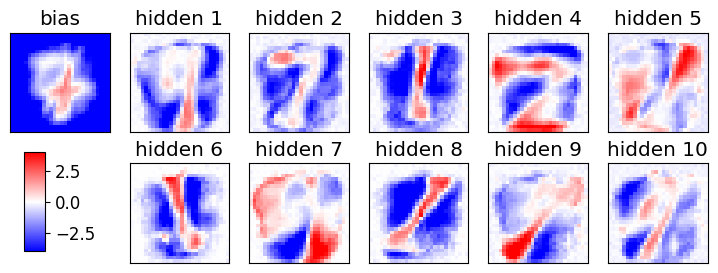

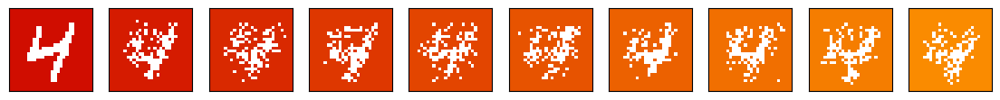

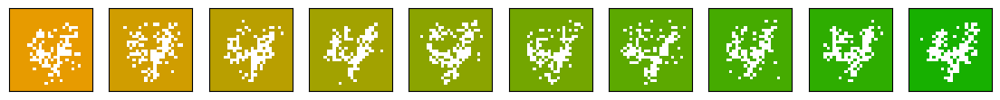

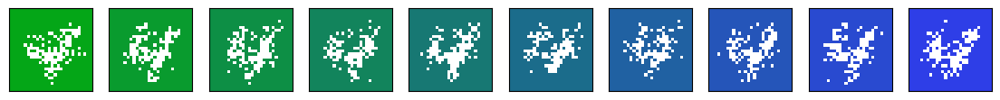

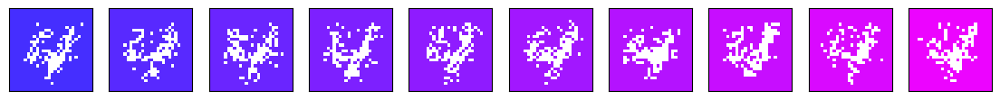

L: 10     amplification of weights: 1.0


In [ ]:
ee=-1
NN=200
traj_x,traj_z = np.zeros((NN+2,D)), np.zeros((NN+2,L))
xf=np.copy(data[np.random.randint(Nd)])
traj_x[0]=np.copy(xf)

# AF: multiply weights and biases by a number >1 to achieve a more deterministic behavior,
# equivalent to lower the temperature in a Boltzmann weight -> select lowest energies
# Note: here, this is done in the negative CD step only
AF=1.

for t in range(NN):
    t1=t+1
    # positive CD phase: generating fantasy zf from fantasy xf
    zf = CD_step(xf,1*wE[ee],1*bE[ee],POTTS=POTTS)
    traj_z[t] = np.copy(zf)
    # negative CD pzase: generating fantasy xf from fantasy zf
    xf = CD_step(zf,AF*wE[ee].T,AF*aE[ee])
    traj_x[t1] = np.copy(xf)


plot_weights_bias(wE, aE, Nepoch, L, cols=Ncols, save=False)

col0,col1,col2,col3,col4=(0.8,0,0,1),(1,0.6,0,1),(0,.7,0,1),(0.2,0.2,1,1),(1,0,1,1)
show_MNIST(traj_x[0:],Nex=10,colors=(col0,col1))
show_MNIST(traj_x[10:],Nex=10,colors=(col1,col2))
show_MNIST(traj_x[20:],Nex=10,colors=(col2,col3))
show_MNIST(traj_x[40:],Nex=10,colors=(col3,col4))
print("L:",L,"    amplification of weights:",AF)

## Plot of the gradient amplitude

NE= 150


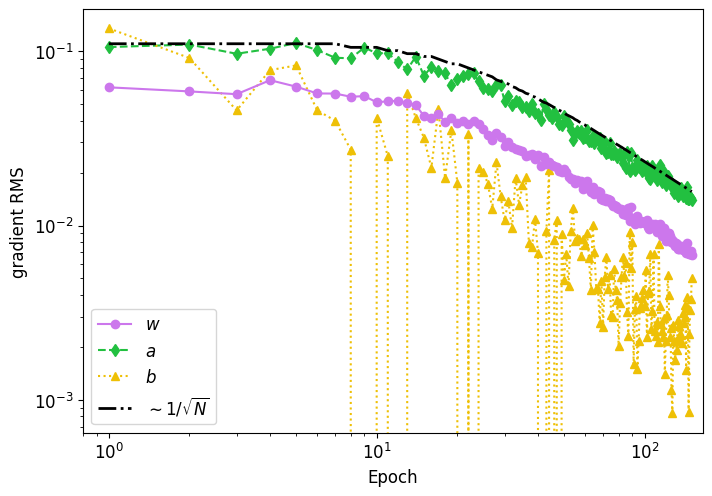

FIG/RBM_grad_MNIST3_E150_N10-500_RMSprop-0.05-0.05_CD-2_L10_reg0.001.png


In [ ]:
def make_fname(strin):
    fname="FIG/RBM_"+strin+"_MNIST"+str(Ndigit)+"_E"+str(NE)+"_N"+str(N_ini)+"-"+str(N_fin)
    fname=fname+"_"+GRAD+"-"+str(l_rate_ini)+"-"+str(l_rate_fin)+"_CD-"+str(Nt)+"_L"+str(L)
    if gamma>0:  fname=fname+"_reg"+str(gamma)
    return fname+".png"

NE = len(gwE)-1
print("NE=",NE)
mgw,mga,mgb,epo=np.zeros(NE),np.zeros(NE),np.zeros(NE),np.zeros(NE)
DE=1
if NE>30: DE=2
if NE>50: DE=5
if NE>100: DE=10
# compute RMS average of gradients during epochs
for ep in range(1,1+NE):
    epo[ep-1]=ep
    mgw[ep-1] = np.std(gwE[ep])
    mga[ep-1] = np.std(gaE[ep])
    mgb[ep-1] = np.std(gbE[ep])

#############################################################################
# creating grid for subplots
fig, ax = plt.subplots(1, 1, figsize=(8,5.5))
fig.subplots_adjust( left=None, bottom=None,  right=None, top=None, wspace=None, hspace=None)

ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(DE))
ax.plot(epo,mgw,"o-",c="#CC77EC",label="$w$",zorder=10)
ax.plot(epo,mga,"d--",c="#22C040",label="$a$",zorder=5)
ax.plot(epo,mgb,"^:",c="#EEC006",label="$b$",zorder=8)
ax.plot(epo,.35/sqrt(miniE[1:]),"k-.",label="$\sim 1 / \sqrt{N}$",zorder=20,lw=2)
ax.set_xlabel("Epoch")
ax.set_ylabel("gradient RMS")
ax.set_xlim(0.5,NE+0.5)
if 1==2: ax.set_ylim(0,)
else:
    ax.set_xlim(0.8,Nepoch*1.1)
    ax.set_xscale("log")
    ax.set_yscale("log")
ax.legend()

fname=make_fname("grad")
fig.savefig(fname,dpi=200,bbox_inches='tight',pad_inches=0.02, transparent=False)
plt.show()
print(fname)

## Log-likelihood calculation

In [14]:
import numpy as np
from tqdm import tqdm
import itertools as it
from scipy.optimize import curve_fit
from numba import jit

def compute_log_likelihood(w, a, b, data):

    D = w.shape[0]      #  visible units
    L = w.shape[1]    #  hidden units
    M = data.shape[0]      # data

    all_z = np.array(list(it.product((0, 1), repeat=L)), dtype=np.float64)  ### il dtype serve per numba
    log_likelihoods = []

    sample_size=int(M/4) #### take 1/4 of the data for each epoch
    idx = np.random.choice(M, sample_size, replace=False)
    data_sample = data[idx]
    log_likelihoods = []

    for m in tqdm(range(len(data_sample)), desc='Computing log-likelihood'):
        x = data_sample[m]
        log_likelihoods.append(compute_single_log_likelihood(w, a, b, x, all_z, D, L))


    return np.mean(log_likelihoods)

@jit(nopython=True)
def compute_single_log_likelihood(w, a, b, x, all_z, D, L):

    q_samples = []
    for i in range(min(100, D)):  # Sample a few visible units
        for z_idx in range(min(10, 2**L)):  # Sample a few hidden states
            z = all_z[z_idx]
            H_i = a[i] + np.dot(w[i], z)
            q_samples.append(1 + np.exp(H_i))
    q = np.mean(np.array(q_samples))


    first_term = compute_free_energy_term(w, a, b, x, all_z, q, D)
    second_term = -compute_partition_function(w, a, b, all_z, q, D)

    return first_term + second_term



# if SPINS:
#     x_min=-1
#     level_gap=2.
# else:
#     x_min=0
#     level_gap=1.


@jit(nopython=True)
def compute_partition_function(w, a, b, all_z, q, D):

    sum_term = 0

    for z in all_z:
        G_z=1.0
        for i in range(L):
            G_z *= np.exp(b[i] * z[i])

        product_term = 1.0
        for i in range(D):
            H_i = a[i] + np.dot(w[i], z)
            product_term *= (1 + np.exp(H_i)) / q

        sum_term += G_z * product_term

    return D * np.log(q) + np.log(sum_term)

@jit(nopython=True)
def compute_free_energy_term(w, a, b, x, all_z, q, D):
    """
    Compute the free energy term using log-space arithmetic for numerical stability.
    This implements the formula: e^(-E(x,z)) = ∏_μ e^(b_μ*z_μ) * ∏_i e^(H_i(z)*x_i)
    """
    # Use log-sum-exp trick for numerical stability
    log_terms = np.zeros(len(all_z))

    for z_idx in range(len(all_z)):
        z = all_z[z_idx]

        # Compute log G(z) = log(∏_μ e^(b_μ*z_μ)) = ∑_μ b_μ*z_μ
        log_G_z = np.sum(b * z)

        # Compute log product term for visible units
        log_product = 0.0
        for i in range(D):
            if x[i] == 1:  # Only consider where x = 1
                H_i = a[i] + np.dot(w[i], z)
                log_product += H_i
            #if x[i] == -1:  # Only consider where x = -1
            #    H_i = a[i] + np.dot(w[i], z)
            #    log_product += (-H_i)
            ### case x=0 we have 0 (log(e^(H_z*x)=0))

        # Total log term for this z
        log_terms[z_idx] = log_G_z + log_product

    # Log-sum-exp trick: log(∑_i e^x_i) = a + log(∑_i e^(x_i - a))
    # where a = max(x_i) to prevent overflow
    if len(log_terms) > 0:
        max_log_term = np.max(log_terms)
        # Avoid -inf if all terms are -inf
        if max_log_term == -np.inf:
            return -np.inf

        sum_exp = np.sum(np.exp(log_terms - max_log_term))
        return max_log_term + np.log(sum_exp)
    else:
        return -np.inf  # If no hidden states, return -inf

## Likelihood evolution during the whole training  

In [ ]:
# Log-likelihood evolution for different L and fixed CD steps = 2
log_like_L=[]
for L in L_v:
    Nt=2
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    num_epo=[]
    Nepoch=150
    n=3  ### take 1/3 of the epoch
    for i in range(Nepoch):
        if i%n==0:
            print(f'Epoch n.{i}')
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            log_like.append(ll)
            num_epo.append(i)
            print('Log-likelihood=',ll)
    log_like_L.append(log_like)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2280.19it/s]


Log-likelihood= -167.46639562353087
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3031.66it/s]


Log-likelihood= -153.30224022268249
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2167.52it/s]


Log-likelihood= -149.29984189944383
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2140.84it/s]


Log-likelihood= -145.3430656562798
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2228.00it/s]


Log-likelihood= -150.69288269856673
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2207.40it/s]


Log-likelihood= -147.58903653630878
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2150.40it/s]


Log-likelihood= -140.05929497579703
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2251.94it/s]


Log-likelihood= -143.16418878267984
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.40it/s]


Log-likelihood= -141.55624860080403
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.57it/s]


Log-likelihood= -141.1333456533539
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2291.30it/s]


Log-likelihood= -141.77690018303306
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2282.77it/s]


Log-likelihood= -141.30056009011076
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2296.67it/s]


Log-likelihood= -137.69138747338388
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2315.90it/s]


Log-likelihood= -141.56208266171464
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3284.75it/s]


Log-likelihood= -137.1427448730522
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2332.22it/s]


Log-likelihood= -136.6715776585117
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2315.67it/s]


Log-likelihood= -135.60655794490071
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.72it/s]


Log-likelihood= -136.97555370675877
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2188.37it/s]


Log-likelihood= -136.72116198230265
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2232.07it/s]


Log-likelihood= -136.72376396073773
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2250.15it/s]


Log-likelihood= -137.59913726517547
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2214.07it/s]


Log-likelihood= -134.23329747002762
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2227.49it/s]


Log-likelihood= -136.91135119613836
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2308.85it/s]


Log-likelihood= -136.4325580927051
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2266.59it/s]


Log-likelihood= -137.56143278022006
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2274.37it/s]


Log-likelihood= -137.93122748254368
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2304.04it/s]


Log-likelihood= -134.52485713619993
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2256.80it/s]


Log-likelihood= -135.90228161247612
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3173.75it/s]


Log-likelihood= -136.1987229107427
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2242.66it/s]


Log-likelihood= -135.8655752782017
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2261.64it/s]


Log-likelihood= -136.20254188139637
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2271.02it/s]


Log-likelihood= -137.36244353253431
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2234.97it/s]


Log-likelihood= -136.2697933295724
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2209.58it/s]


Log-likelihood= -134.67619643569626
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2284.95it/s]


Log-likelihood= -136.39688289020455
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2247.28it/s]


Log-likelihood= -137.24671766643695
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2282.35it/s]


Log-likelihood= -137.6385311930961
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2300.91it/s]


Log-likelihood= -136.50771150303032
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2290.03it/s]


Log-likelihood= -134.9666097243515
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2267.83it/s]


Log-likelihood= -137.65680609790834
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2324.19it/s]


Log-likelihood= -137.83050152876964
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3381.49it/s]


Log-likelihood= -136.80611264490508
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.18it/s]


Log-likelihood= -135.14433081288252
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2207.03it/s]


Log-likelihood= -136.78365084933301
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2292.97it/s]


Log-likelihood= -136.033221252348
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2299.29it/s]


Log-likelihood= -137.88975363858924
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2305.90it/s]


Log-likelihood= -138.22442290638955
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2260.70it/s]


Log-likelihood= -134.07610994198214
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2280.65it/s]


Log-likelihood= -136.4088892031857
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2286.85it/s]


Log-likelihood= -135.02388182467786
a_all L=4, Nt=2
b_all L=4, Nt=2
w_all L=4, Nt=2
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.69it/s]


Log-likelihood= -167.26125039459475
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.18it/s]


Log-likelihood= -148.77345297407734
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1432.00it/s]


Log-likelihood= -147.61714540077304
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1189.97it/s]


Log-likelihood= -143.75963014000584
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.74it/s]


Log-likelihood= -145.5370454305124
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1200.22it/s]


Log-likelihood= -144.96919542433898
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1190.84it/s]


Log-likelihood= -141.04234989525747
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1189.70it/s]


Log-likelihood= -140.5357499277552
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1184.69it/s]


Log-likelihood= -139.92773109301754
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1412.31it/s]


Log-likelihood= -141.95504743208537
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1190.35it/s]


Log-likelihood= -139.5026635748997
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1174.03it/s]


Log-likelihood= -136.44388147599682
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1170.81it/s]


Log-likelihood= -138.83589854796577
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1184.39it/s]


Log-likelihood= -135.7087432673348
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1181.95it/s]


Log-likelihood= -134.73380955122218
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1131.83it/s]


Log-likelihood= -135.58305724904383
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1387.22it/s]


Log-likelihood= -135.03017099736775
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1150.97it/s]


Log-likelihood= -134.6562744112458
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 1077.46it/s]


Log-likelihood= -132.84599022684125
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 1060.63it/s]


Log-likelihood= -134.51691531235366
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1108.46it/s]


Log-likelihood= -133.39991380595978
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1118.54it/s]


Log-likelihood= -133.2852116218248
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1175.80it/s]


Log-likelihood= -133.12045972615263
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1379.67it/s]


Log-likelihood= -135.09635183992629
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1152.33it/s]


Log-likelihood= -129.49054341069063
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1125.83it/s]


Log-likelihood= -130.0545602880187
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1114.32it/s]


Log-likelihood= -127.66314905670576
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1122.44it/s]


Log-likelihood= -126.49595231999798
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.79it/s]


Log-likelihood= -126.06259645661025
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1369.52it/s]


Log-likelihood= -124.3657674628067
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.26it/s]


Log-likelihood= -126.86064155614153
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1185.44it/s]


Log-likelihood= -125.45877064842979
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1180.45it/s]


Log-likelihood= -128.0072845909842
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1182.41it/s]


Log-likelihood= -125.78873955730435
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1148.32it/s]


Log-likelihood= -126.91742723121247
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1160.25it/s]


Log-likelihood= -126.00329361906314
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1356.74it/s]


Log-likelihood= -126.64954811875906
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1151.46it/s]


Log-likelihood= -129.0202605155102
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1172.66it/s]


Log-likelihood= -126.58428108969552
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.97it/s]


Log-likelihood= -128.6863052766173
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1170.64it/s]


Log-likelihood= -126.13036819979084
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1124.60it/s]


Log-likelihood= -125.22974573596422
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1207.37it/s]


Log-likelihood= -125.37308332774235
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1441.02it/s]


Log-likelihood= -126.21824197434125
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.27it/s]


Log-likelihood= -126.10343220627901
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1181.40it/s]


Log-likelihood= -127.99399667538816
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1188.43it/s]


Log-likelihood= -128.41999321157178
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1164.82it/s]


Log-likelihood= -127.53934006948327
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1168.32it/s]


Log-likelihood= -128.02000937694777
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1166.47it/s]


Log-likelihood= -129.33495177433497
a_all L=5, Nt=2
b_all L=5, Nt=2
w_all L=5, Nt=2
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.59it/s]


Log-likelihood= -167.9604557873782
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 586.55it/s]


Log-likelihood= -143.5042434936922
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 574.88it/s]


Log-likelihood= -136.77885881200825
Epoch n.9


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 645.41it/s]


Log-likelihood= -132.49927277964917
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 590.51it/s]


Log-likelihood= -128.61238634453
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 565.80it/s]


Log-likelihood= -130.62356924898205
Epoch n.18


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 496.62it/s]


Log-likelihood= -131.19865517214126
Epoch n.21


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 541.49it/s]


Log-likelihood= -131.11616339519205
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 557.63it/s]


Log-likelihood= -128.49605809907396
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 569.94it/s]


Log-likelihood= -129.5130036082506
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 624.45it/s]


Log-likelihood= -128.43256711944255
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 596.41it/s]


Log-likelihood= -125.50002278744955
Epoch n.36


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 573.86it/s]


Log-likelihood= -128.910749525361
Epoch n.39


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 603.61it/s]


Log-likelihood= -126.53231120632095
Epoch n.42


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 577.28it/s]


Log-likelihood= -124.67885994690177
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 584.58it/s]


Log-likelihood= -125.02436451796235
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.68it/s]


Log-likelihood= -125.6665963522175
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 574.92it/s]


Log-likelihood= -123.47014892566231
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 571.20it/s]


Log-likelihood= -126.03663121646501
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 561.37it/s]


Log-likelihood= -127.10812293689811
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.88it/s]


Log-likelihood= -128.47155501728233
Epoch n.63


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 592.78it/s]


Log-likelihood= -126.95461203569256
Epoch n.66


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 571.65it/s]


Log-likelihood= -125.64471865575088
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.60it/s]


Log-likelihood= -126.66414488330328
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 589.28it/s]


Log-likelihood= -124.55211452247848
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 591.06it/s]


Log-likelihood= -126.32281053476883
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 595.79it/s]


Log-likelihood= -127.85108433738776
Epoch n.81


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 644.83it/s]


Log-likelihood= -124.87571501674472
Epoch n.84


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 598.83it/s]


Log-likelihood= -124.74612735076407
Epoch n.87


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 603.76it/s]


Log-likelihood= -126.15168095391516
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 658.52it/s]


Log-likelihood= -125.69035484521923
Epoch n.93


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 599.35it/s]


Log-likelihood= -126.14069030107638
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 602.24it/s]


Log-likelihood= -124.98345671464735
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 602.85it/s]


Log-likelihood= -125.70115001417682
Epoch n.102


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 645.11it/s]


Log-likelihood= -124.9216315247487
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 542.38it/s]


Log-likelihood= -125.38063556297514
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 559.03it/s]


Log-likelihood= -124.04439094010988
Epoch n.111


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 636.08it/s]


Log-likelihood= -123.85892306720173
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 570.04it/s]


Log-likelihood= -125.25141806112585
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 582.36it/s]


Log-likelihood= -127.23410167913582
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 635.96it/s]


Log-likelihood= -125.7484513479046
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 592.36it/s]


Log-likelihood= -125.42903242262395
Epoch n.126


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 591.35it/s]


Log-likelihood= -124.25994691569801
Epoch n.129


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 590.52it/s]


Log-likelihood= -126.7666258569637
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 651.90it/s]


Log-likelihood= -124.51464281149165
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 577.32it/s]


Log-likelihood= -126.07712993983777
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 569.21it/s]


Log-likelihood= -126.0503506054616
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 648.56it/s]


Log-likelihood= -124.46543897791452
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 562.36it/s]


Log-likelihood= -124.34722579993863
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 523.01it/s]


Log-likelihood= -124.68819871754732
a_all L=6, Nt=2
b_all L=6, Nt=2
w_all L=6, Nt=2
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 322.78it/s]


Log-likelihood= -167.82839428146056
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 303.20it/s]


Log-likelihood= -140.02720427633028
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 320.24it/s]


Log-likelihood= -139.66024198229758
Epoch n.9


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.12it/s]


Log-likelihood= -133.99796869952323
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.58it/s]


Log-likelihood= -134.85249625199745
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.19it/s]


Log-likelihood= -137.81450787649985
Epoch n.18


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 287.92it/s]


Log-likelihood= -134.4462238555384
Epoch n.21


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 288.60it/s]


Log-likelihood= -139.15994837219736
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 285.18it/s]


Log-likelihood= -138.55250615237324
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.61it/s]


Log-likelihood= -135.35959551490959
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 300.52it/s]


Log-likelihood= -134.93654412212754
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 286.25it/s]


Log-likelihood= -131.7890678374308
Epoch n.36


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 305.07it/s]


Log-likelihood= -134.26209234113696
Epoch n.39


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.58it/s]


Log-likelihood= -134.81862858782102
Epoch n.42


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 302.06it/s]


Log-likelihood= -132.4071999881581
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.68it/s]


Log-likelihood= -133.0928308193174
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.90it/s]


Log-likelihood= -136.71855341501146
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.46it/s]


Log-likelihood= -135.83997309166426
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.29it/s]


Log-likelihood= -135.58276440216045
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 306.78it/s]


Log-likelihood= -134.7011766685891
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.35it/s]


Log-likelihood= -132.37018226431397
Epoch n.63


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.38it/s]


Log-likelihood= -132.8623054511501
Epoch n.66


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.66it/s]


Log-likelihood= -133.73405974673514
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.48it/s]


Log-likelihood= -137.70880844162517
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.89it/s]


Log-likelihood= -133.76906177904385
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.28it/s]


Log-likelihood= -135.82329007814937
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.90it/s]


Log-likelihood= -140.06562351979912
Epoch n.81


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.91it/s]


Log-likelihood= -136.7601991257981
Epoch n.84


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.84it/s]


Log-likelihood= -141.72971189372228
Epoch n.87


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.68it/s]


Log-likelihood= -135.3718838464157
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.76it/s]


Log-likelihood= -133.20323607427235
Epoch n.93


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.32it/s]


Log-likelihood= -130.68581203146934
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.24it/s]


Log-likelihood= -136.00155483357682
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 311.95it/s]


Log-likelihood= -131.85581557846106
Epoch n.102


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.76it/s]


Log-likelihood= -129.7339999000464
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 304.72it/s]


Log-likelihood= -126.35954185361607
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 297.11it/s]


Log-likelihood= -128.4595016307388
Epoch n.111


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.95it/s]


Log-likelihood= -126.88807938696806
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 309.86it/s]


Log-likelihood= -125.6899529317442
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.28it/s]


Log-likelihood= -125.33446792789417
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.47it/s]


Log-likelihood= -126.5738726445217
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.63it/s]


Log-likelihood= -123.80593995360576
Epoch n.126


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 303.49it/s]


Log-likelihood= -123.88324928984012
Epoch n.129


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 300.28it/s]


Log-likelihood= -125.04275814144907
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 309.60it/s]


Log-likelihood= -127.71518491849886
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.98it/s]


Log-likelihood= -128.5612008303615
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.72it/s]


Log-likelihood= -125.00912256109461
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.75it/s]


Log-likelihood= -127.23541300316028
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 306.18it/s]


Log-likelihood= -125.47838408069725
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 320.70it/s]


Log-likelihood= -124.6727540876417
a_all L=8, Nt=2
b_all L=8, Nt=2
w_all L=8, Nt=2
Epoch n.0


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.98it/s]


Log-likelihood= -167.56168703669934
Epoch n.3


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.28it/s]


Log-likelihood= -142.83786419910177
Epoch n.6


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.15it/s]


Log-likelihood= -134.7137184134017
Epoch n.9


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:07<00:00, 81.02it/s]


Log-likelihood= -126.24903892914352
Epoch n.12


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.19it/s]


Log-likelihood= -128.88253273724231
Epoch n.15


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.60it/s]


Log-likelihood= -128.1742339970567
Epoch n.18


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.69it/s]


Log-likelihood= -128.95560229909577
Epoch n.21


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.86it/s]


Log-likelihood= -128.8181546339894
Epoch n.24


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.97it/s]


Log-likelihood= -128.4414534003503
Epoch n.27


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.28it/s]


Log-likelihood= -130.52554058391286
Epoch n.30


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.90it/s]


Log-likelihood= -128.2534474542727
Epoch n.33


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.48it/s]


Log-likelihood= -130.48209457945973
Epoch n.36


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.80it/s]


Log-likelihood= -125.76439216651129
Epoch n.39


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.29it/s]


Log-likelihood= -126.71267336416649
Epoch n.42


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.27it/s]


Log-likelihood= -128.1705110812231
Epoch n.45


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.83it/s]


Log-likelihood= -126.45442284978765
Epoch n.48


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.08it/s]


Log-likelihood= -128.3739525610633
Epoch n.51


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.37it/s]


Log-likelihood= -128.664186336212
Epoch n.54


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.18it/s]


Log-likelihood= -131.55238834556386
Epoch n.57


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -127.50814445454051
Epoch n.60


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.27it/s]


Log-likelihood= -129.170238548205
Epoch n.63


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.55it/s]


Log-likelihood= -131.6875389651791
Epoch n.66


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.14it/s]


Log-likelihood= -129.65844807103835
Epoch n.69


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.48it/s]


Log-likelihood= -125.78235323946345
Epoch n.72


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.91it/s]


Log-likelihood= -130.29459529188648
Epoch n.75


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.49it/s]


Log-likelihood= -131.34455808758614
Epoch n.78


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.65it/s]


Log-likelihood= -126.9536172816826
Epoch n.81


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.48it/s]


Log-likelihood= -129.07105531107402
Epoch n.84


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.25it/s]


Log-likelihood= -128.17530346076106
Epoch n.87


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.20it/s]


Log-likelihood= -126.02669720337981
Epoch n.90


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.79it/s]


Log-likelihood= -131.33470877085202
Epoch n.93


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.27it/s]


Log-likelihood= -128.11064690394153
Epoch n.96


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.20it/s]


Log-likelihood= -130.0169910334589
Epoch n.99


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -131.84500780429315
Epoch n.102


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.18it/s]


Log-likelihood= -128.82380969991922
Epoch n.105


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.09it/s]


Log-likelihood= -132.14912456756852
Epoch n.108


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.53it/s]


Log-likelihood= -133.26551384704422
Epoch n.111


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.36it/s]


Log-likelihood= -133.2026034645289
Epoch n.114


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.15it/s]


Log-likelihood= -133.92757163398437
Epoch n.117


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.35it/s]


Log-likelihood= -133.39419064156726
Epoch n.120


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.25it/s]


Log-likelihood= -136.0273791310948
Epoch n.123


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.58it/s]


Log-likelihood= -135.303745555103
Epoch n.126


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.13it/s]


Log-likelihood= -135.6643037995829
Epoch n.129


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.06it/s]


Log-likelihood= -135.8692238818429
Epoch n.132


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.54it/s]


Log-likelihood= -138.0868459747056
Epoch n.135


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.15it/s]


Log-likelihood= -140.62545217619865
Epoch n.138


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.29it/s]


Log-likelihood= -143.24514671460466
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.79it/s]


Log-likelihood= -138.7612876385819
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -139.71833383593813
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.42it/s]


Log-likelihood= -143.29595281618663
a_all L=10, Nt=2
b_all L=10, Nt=2
w_all L=10, Nt=2
Epoch n.0


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.29it/s]


Log-likelihood= -168.02160816075647
Epoch n.3


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.54it/s]


Log-likelihood= -136.49303448120102
Epoch n.6


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:44<00:00, 19.33it/s]


Log-likelihood= -124.54118527537752
Epoch n.9


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.16it/s]


Log-likelihood= -123.2101202445941
Epoch n.12


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.14it/s]


Log-likelihood= -126.51225332670599
Epoch n.15


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -125.12327950438193
Epoch n.18


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.26it/s]


Log-likelihood= -124.40559293652244
Epoch n.21


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.23it/s]


Log-likelihood= -127.38053124263723
Epoch n.24


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -125.1567271303564
Epoch n.27


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.16it/s]


Log-likelihood= -121.98535241443783
Epoch n.30


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -123.60695775429551
Epoch n.33


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:48<00:00, 19.05it/s]


Log-likelihood= -129.92706931389054
Epoch n.36


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:48<00:00, 19.04it/s]


Log-likelihood= -130.94066255096385
Epoch n.39


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.10it/s]


Log-likelihood= -132.80274194612247
Epoch n.42


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:49<00:00, 18.97it/s]


Log-likelihood= -131.06788914719718
Epoch n.45


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.76it/s]


Log-likelihood= -130.34176869750894
Epoch n.48


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:55<00:00, 18.63it/s]


Log-likelihood= -126.19269970250967
Epoch n.51


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:50<00:00, 18.94it/s]


Log-likelihood= -128.69649993706233
Epoch n.54


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:52<00:00, 18.77it/s]


Log-likelihood= -130.84296852633315
Epoch n.57


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.14it/s]


Log-likelihood= -124.85462726189246
Epoch n.60


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.72it/s]


Log-likelihood= -126.11755522589188
Epoch n.63


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:58<00:00, 18.44it/s]


Log-likelihood= -125.34316467014854
Epoch n.66


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.19it/s]


Log-likelihood= -121.38894789975254
Epoch n.69


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:42<00:00, 19.47it/s]


Log-likelihood= -123.22057435781281
Epoch n.72


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -125.12626840611875
Epoch n.75


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.99it/s]


Log-likelihood= -125.49042897052719
Epoch n.78


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -123.69047746321647
Epoch n.81


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:36<00:00, 19.92it/s]


Log-likelihood= -124.52384664143102
Epoch n.84


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -123.84783020367134
Epoch n.87


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -121.14757321357567
Epoch n.90


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -121.07578731147076
Epoch n.93


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -118.55811729408404
Epoch n.96


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.03it/s]


Log-likelihood= -116.78297451371358
Epoch n.99


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -119.48616377020674
Epoch n.102


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.92it/s]


Log-likelihood= -114.13198262910228
Epoch n.105


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.05it/s]


Log-likelihood= -116.30035041097378
Epoch n.108


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -116.30145241891645
Epoch n.111


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.00it/s]


Log-likelihood= -119.42028825152487
Epoch n.114


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.03it/s]


Log-likelihood= -116.14413511129851
Epoch n.117


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -118.27649553258439
Epoch n.120


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -116.78625212743452
Epoch n.123


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -116.23294539232789
Epoch n.126


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -120.18589175574884
Epoch n.129


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -119.71331765630502
Epoch n.132


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -121.27313234672091
Epoch n.135


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -117.06862339922307
Epoch n.138


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:33<00:00, 20.08it/s]


Log-likelihood= -116.79509888869605
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -118.99634972903671
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:36<00:00, 19.91it/s]


Log-likelihood= -114.57554406077575
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.95it/s]

Log-likelihood= -119.01322526073503


In [ ]:
log_like_cd=[]

# Log-likelihood evolution for fixed L=3 and different CD steps

for L in L_v:
    if L==3:
        for Nt in Nt_v:
            a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
            b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
            w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

            log_like=[]
            num_epo=[]
            Nepoch=150
            n=3  ### take 1/3 of the epoch
            for i in range(Nepoch):
                if i%n==0:
                    print(f'Epoch n.{i}')
                    ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
                    log_like.append(ll)
                    num_epo.append(i)
                    print('Log-likelihood=',ll)
            log_like_cd.append(log_like)

a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.0


Computing log-likelihood:   0%|                                                                | 0/5498 [00:00<?, ?it/s]/tmp/ipykernel_681/779657587.py:41: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (Array(float64, 1, 'C', False, aligned=True), Array(float64, 1, 'A', False, aligned=True))
  second_term = -compute_partition_function(w, a, b, all_z, q, D)
Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:07<00:00, 770.57it/s]


Log-likelihood= -167.0619582470125
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.37it/s]


Log-likelihood= -153.91380773196778
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 910.76it/s]


Log-likelihood= -150.79911203045867
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.20it/s]


Log-likelihood= -146.18286317167184
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1263.60it/s]


Log-likelihood= -150.7975139446413
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.64it/s]


Log-likelihood= -145.83368565576026
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.14it/s]


Log-likelihood= -141.8379678125805
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.99it/s]


Log-likelihood= -143.07079172851942
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.20it/s]


Log-likelihood= -140.99871912316317
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 949.04it/s]


Log-likelihood= -142.12682516332038
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.82it/s]


Log-likelihood= -142.22555042710545
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.07it/s]


Log-likelihood= -140.4195790171541
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.18it/s]


Log-likelihood= -136.61794028844332
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1203.60it/s]


Log-likelihood= -140.7232094456506
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.89it/s]


Log-likelihood= -137.02533088838942
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.04it/s]


Log-likelihood= -137.24895116667676
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 906.42it/s]


Log-likelihood= -135.54764095984305
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.00it/s]


Log-likelihood= -137.10179325629935
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1211.42it/s]


Log-likelihood= -136.4280190549347
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.77it/s]


Log-likelihood= -136.0602139530983
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1211.36it/s]


Log-likelihood= -136.78500666781412
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1191.30it/s]


Log-likelihood= -134.84579821080163
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1188.08it/s]


Log-likelihood= -137.9025134591677
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 907.00it/s]


Log-likelihood= -136.38151146505055
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1214.63it/s]


Log-likelihood= -135.99726567713552
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1283.27it/s]


Log-likelihood= -137.06047926507108
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1280.33it/s]


Log-likelihood= -135.30578629736476
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.05it/s]


Log-likelihood= -137.31241494184835
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.18it/s]


Log-likelihood= -136.47912744683077
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.31it/s]


Log-likelihood= -136.41121429688255
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 952.78it/s]


Log-likelihood= -136.17395894916874
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1277.62it/s]


Log-likelihood= -138.0128243180918
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.26it/s]


Log-likelihood= -136.45627614196752
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.80it/s]


Log-likelihood= -135.18712117774922
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1290.66it/s]


Log-likelihood= -135.66665644578342
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.38it/s]


Log-likelihood= -136.1487433065035
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.72it/s]


Log-likelihood= -137.32125230815697
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.89it/s]


Log-likelihood= -136.39701093756725
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 937.73it/s]


Log-likelihood= -136.0396811463683
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.36it/s]


Log-likelihood= -137.0263635392604
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.57it/s]


Log-likelihood= -137.27674244462864
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.63it/s]


Log-likelihood= -136.3430194145506
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.73it/s]


Log-likelihood= -134.91024641798245
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.12it/s]


Log-likelihood= -136.45110741263926
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.69it/s]


Log-likelihood= -135.25465109010926
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 970.00it/s]


Log-likelihood= -138.50978350410554
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1204.74it/s]


Log-likelihood= -137.53445534268457
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1315.34it/s]


Log-likelihood= -135.25248446687726
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1293.21it/s]


Log-likelihood= -134.7393113270953
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1349.08it/s]


Log-likelihood= -135.50172222870538
a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1283.75it/s]


Log-likelihood= -167.36940146232564
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.07it/s]


Log-likelihood= -151.43773272715717
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 896.82it/s]


Log-likelihood= -144.3845672898909
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1198.08it/s]


Log-likelihood= -143.56116545836343
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1269.06it/s]


Log-likelihood= -143.3527488061263
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1300.68it/s]


Log-likelihood= -144.96469604835798
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.40it/s]


Log-likelihood= -142.3012742833728
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.85it/s]


Log-likelihood= -144.398954662032
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.93it/s]


Log-likelihood= -141.7963459418535
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.79it/s]


Log-likelihood= -136.9520382794936
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 891.64it/s]


Log-likelihood= -135.63967127927643
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.67it/s]


Log-likelihood= -136.30290107990388
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1333.90it/s]


Log-likelihood= -133.89693107867691
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.42it/s]


Log-likelihood= -134.99542196672812
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.53it/s]


Log-likelihood= -133.84014328659825
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.52it/s]


Log-likelihood= -133.29639517749263
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.71it/s]


Log-likelihood= -136.0565559487416
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 898.17it/s]


Log-likelihood= -134.6582134468092
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.51it/s]


Log-likelihood= -135.177865176888
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.43it/s]


Log-likelihood= -132.00759638737156
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.68it/s]


Log-likelihood= -133.59414596591458
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1313.61it/s]


Log-likelihood= -131.81053497207705
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1284.74it/s]


Log-likelihood= -133.43774761751385
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.19it/s]


Log-likelihood= -131.84274459764572
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 867.37it/s]


Log-likelihood= -134.4900621721476
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.81it/s]


Log-likelihood= -132.17387960725944
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.63it/s]


Log-likelihood= -130.82083706899934
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.74it/s]


Log-likelihood= -132.4570817997721
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1270.64it/s]


Log-likelihood= -132.46815091715993
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.71it/s]


Log-likelihood= -131.7122546405801
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.46it/s]


Log-likelihood= -132.73711857846368
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.65it/s]


Log-likelihood= -136.3271404346707
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 839.53it/s]


Log-likelihood= -131.37788768183972
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1214.22it/s]


Log-likelihood= -131.6937956044197
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.28it/s]


Log-likelihood= -132.68132608309315
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.24it/s]


Log-likelihood= -133.2517339791439
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.40it/s]


Log-likelihood= -131.1810143942101
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.16it/s]


Log-likelihood= -132.44167619085445
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.44it/s]


Log-likelihood= -132.66020855132223
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 956.63it/s]


Log-likelihood= -132.3814993435518
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.37it/s]


Log-likelihood= -132.50923720927764
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.09it/s]


Log-likelihood= -131.42889961780284
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.71it/s]


Log-likelihood= -132.5620227199188
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.10it/s]


Log-likelihood= -132.43300186401777
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.91it/s]


Log-likelihood= -133.42060307796527
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.80it/s]


Log-likelihood= -132.09346580783387
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 901.65it/s]


Log-likelihood= -131.87058058883463
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.32it/s]


Log-likelihood= -134.57359530666105
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1274.77it/s]


Log-likelihood= -130.6430868309253
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.11it/s]


Log-likelihood= -131.71583986828782
a_all L=3, Nt=6
b_all L=3, Nt=6
w_all L=3, Nt=6
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.86it/s]


Log-likelihood= -166.7634028764675
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.69it/s]


Log-likelihood= -151.15352518686646
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1266.06it/s]


Log-likelihood= -146.27894989351333
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.21it/s]


Log-likelihood= -142.690763221806
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 897.87it/s]


Log-likelihood= -147.71445502255128
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1278.30it/s]


Log-likelihood= -141.4454504162074
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.10it/s]


Log-likelihood= -142.45002446620478
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.77it/s]


Log-likelihood= -144.102879912941
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.02it/s]


Log-likelihood= -141.17957245293158
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.81it/s]


Log-likelihood= -140.6371147404727
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.23it/s]


Log-likelihood= -140.62353996101098
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 917.21it/s]


Log-likelihood= -139.85141189192692
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.81it/s]


Log-likelihood= -139.5033773228586
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.90it/s]


Log-likelihood= -140.37725486133374
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.09it/s]


Log-likelihood= -137.50988469891493
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.98it/s]


Log-likelihood= -135.0570553043074
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.95it/s]


Log-likelihood= -136.99723130659953
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.13it/s]


Log-likelihood= -136.55809345366367
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 916.64it/s]


Log-likelihood= -136.42198081143192
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.09it/s]


Log-likelihood= -137.28494160963143
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1229.15it/s]


Log-likelihood= -140.75155583266866
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.45it/s]


Log-likelihood= -139.42824707760516
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.01it/s]


Log-likelihood= -137.13251909571457
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.73it/s]


Log-likelihood= -136.08375759162547
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.79it/s]


Log-likelihood= -136.37213302683818
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.42it/s]


Log-likelihood= -136.59410698361526
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 879.84it/s]


Log-likelihood= -136.00938083701752
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.33it/s]


Log-likelihood= -137.5678988128239
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1236.84it/s]


Log-likelihood= -136.10471054977847
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.47it/s]


Log-likelihood= -137.29371668635915
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.31it/s]


Log-likelihood= -137.8961458059041
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.05it/s]


Log-likelihood= -138.4513244625272
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.29it/s]


Log-likelihood= -135.87242493666943
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.95it/s]


Log-likelihood= -136.44733559063818
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.26it/s]


Log-likelihood= -137.00195069618383
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.31it/s]


Log-likelihood= -136.86439670673303
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 815.37it/s]


Log-likelihood= -134.7454175841513
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.92it/s]


Log-likelihood= -137.75032469458253
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.32it/s]


Log-likelihood= -137.78079650353163
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.60it/s]


Log-likelihood= -136.9083287967815
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.70it/s]


Log-likelihood= -139.2609880056879
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1264.45it/s]


Log-likelihood= -137.4908654551755
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.15it/s]


Log-likelihood= -137.67328807466222
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1264.60it/s]


Log-likelihood= -138.69091278034927
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 898.12it/s]


Log-likelihood= -136.66958834478174
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.51it/s]


Log-likelihood= -138.29734077361582
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.19it/s]


Log-likelihood= -138.16385850538117
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.26it/s]


Log-likelihood= -138.38227959002984
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.34it/s]


Log-likelihood= -137.01459933025427
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.15it/s]


Log-likelihood= -138.7525759228951
a_all L=3, Nt=8
b_all L=3, Nt=8
w_all L=3, Nt=8
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.13it/s]


Log-likelihood= -167.31564281850328
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 913.72it/s]


Log-likelihood= -150.35861217693633
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.55it/s]


Log-likelihood= -144.29489631159421
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.61it/s]


Log-likelihood= -142.13831512765285
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.30it/s]


Log-likelihood= -147.16972180838596
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.34it/s]


Log-likelihood= -141.0404683278056
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.99it/s]


Log-likelihood= -139.74240721315616
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1227.65it/s]


Log-likelihood= -142.73999370693215
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 916.81it/s]


Log-likelihood= -140.16049708519932
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.83it/s]


Log-likelihood= -143.15510121602594
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.91it/s]


Log-likelihood= -140.90457871997285
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.65it/s]


Log-likelihood= -139.22911230905567
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.38it/s]


Log-likelihood= -141.2804208852259
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.31it/s]


Log-likelihood= -138.64478475085116
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.33it/s]


Log-likelihood= -143.0623838945089
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1273.84it/s]


Log-likelihood= -137.07448907598345
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 926.71it/s]


Log-likelihood= -140.5984547727017
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.29it/s]


Log-likelihood= -140.9587831158454
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.93it/s]


Log-likelihood= -138.50455965817602
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.14it/s]


Log-likelihood= -136.50814773019974
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.97it/s]


Log-likelihood= -134.39514179476876
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.80it/s]


Log-likelihood= -132.50361026174025
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.07it/s]


Log-likelihood= -131.3766467997649
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 883.92it/s]


Log-likelihood= -132.33407555424958
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.80it/s]


Log-likelihood= -130.9411932820327
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.62it/s]


Log-likelihood= -131.71599215293935
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.58it/s]


Log-likelihood= -130.72131673472666
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.64it/s]


Log-likelihood= -131.5507384529515
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.57it/s]


Log-likelihood= -131.6547504762219
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.51it/s]


Log-likelihood= -132.20397535514192
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 852.84it/s]


Log-likelihood= -132.3993321016373
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.41it/s]


Log-likelihood= -133.73495199250806
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.18it/s]


Log-likelihood= -132.18985968909453
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.49it/s]


Log-likelihood= -131.22713267169217
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1236.38it/s]


Log-likelihood= -132.23505959142645
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.68it/s]


Log-likelihood= -132.81279748245015
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.40it/s]


Log-likelihood= -132.2461470620024
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.35it/s]


Log-likelihood= -132.4716930709083
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 910.99it/s]


Log-likelihood= -131.40155804987614
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.19it/s]


Log-likelihood= -132.09725856214712
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.10it/s]


Log-likelihood= -131.6298966380341
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.07it/s]


Log-likelihood= -132.1806173753379
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.37it/s]


Log-likelihood= -132.13322236118844
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1266.51it/s]


Log-likelihood= -132.06134592628803
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1273.08it/s]


Log-likelihood= -132.48208518200497
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 884.69it/s]


Log-likelihood= -132.0035838441319
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.09it/s]


Log-likelihood= -130.78705168973687
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.89it/s]


Log-likelihood= -131.87597167461564
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.15it/s]


Log-likelihood= -131.43193712314883
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.09it/s]


Log-likelihood= -130.04848288318848
a_all L=3, Nt=10
b_all L=3, Nt=10
w_all L=3, Nt=10
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.67it/s]


Log-likelihood= -167.47056590756083
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.55it/s]


Log-likelihood= -152.78426780693434
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 938.12it/s]


Log-likelihood= -148.5082170896151
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.49it/s]


Log-likelihood= -149.18253967706548
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1213.26it/s]


Log-likelihood= -145.98741749321914
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.67it/s]


Log-likelihood= -139.4214199220991
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.58it/s]


Log-likelihood= -139.24265310905963
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.49it/s]


Log-likelihood= -138.7342858108394
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.03it/s]


Log-likelihood= -135.40335746895434
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.83it/s]


Log-likelihood= -139.47881685966775
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 891.35it/s]


Log-likelihood= -138.65822662770162
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.02it/s]


Log-likelihood= -135.30143410885884
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.58it/s]


Log-likelihood= -135.17698744360462
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.56it/s]


Log-likelihood= -139.56140381506125
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.57it/s]


Log-likelihood= -133.9219437081514
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.16it/s]


Log-likelihood= -135.93916219844047
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.36it/s]


Log-likelihood= -136.43983222328924
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 874.04it/s]


Log-likelihood= -136.8590577664586
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.21it/s]


Log-likelihood= -138.47885274867622
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.54it/s]


Log-likelihood= -137.53233337674422
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.27it/s]


Log-likelihood= -139.25807740849527
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.50it/s]


Log-likelihood= -138.09750044385825
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.94it/s]


Log-likelihood= -138.88606529130746
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.08it/s]


Log-likelihood= -138.20988583942773
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 888.36it/s]


Log-likelihood= -140.86382655618718
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.13it/s]


Log-likelihood= -136.72671812396788
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1212.05it/s]


Log-likelihood= -139.1053296960345
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1323.28it/s]


Log-likelihood= -138.0744965854004
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.30it/s]


Log-likelihood= -139.40683765388803
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.49it/s]


Log-likelihood= -138.48899084780825
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.78it/s]


Log-likelihood= -137.93185797478017
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.77it/s]


Log-likelihood= -138.01088857944683
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 867.62it/s]


Log-likelihood= -138.90194016356588
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.11it/s]


Log-likelihood= -139.34268786990438
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.97it/s]


Log-likelihood= -138.23128831900493
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.89it/s]


Log-likelihood= -138.65132015277578
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1321.52it/s]


Log-likelihood= -138.26414390146837
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.47it/s]


Log-likelihood= -139.74424879531273
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.26it/s]


Log-likelihood= -137.91656112923917
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 896.23it/s]


Log-likelihood= -138.5140110170626
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1221.94it/s]


Log-likelihood= -139.44086498166567
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1282.22it/s]


Log-likelihood= -139.77781710663538
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1329.14it/s]


Log-likelihood= -140.43495970528335
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1284.53it/s]


Log-likelihood= -139.17682656849638
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.04it/s]


Log-likelihood= -138.8048585606388
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.05it/s]


Log-likelihood= -140.13499742601536
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.99it/s]


Log-likelihood= -139.00813222817635
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 829.76it/s]


Log-likelihood= -138.00225444937234
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.58it/s]


Log-likelihood= -139.9386178315608
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.62it/s]


Log-likelihood= -137.73756883377519
a_all L=3, Nt=15
b_all L=3, Nt=15
w_all L=3, Nt=15
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.31it/s]


Log-likelihood= -167.56688305548167
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1326.03it/s]


Log-likelihood= -149.57459003697164
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1306.80it/s]


Log-likelihood= -148.92201576745612
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.40it/s]


Log-likelihood= -144.49699483912954
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 888.95it/s]


Log-likelihood= -142.65000422223918
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.77it/s]


Log-likelihood= -140.4280441424735
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.11it/s]


Log-likelihood= -141.7448350819875
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.48it/s]


Log-likelihood= -137.7395302170032
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1313.94it/s]


Log-likelihood= -139.69429142694176
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.21it/s]


Log-likelihood= -139.14603038264303
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.13it/s]


Log-likelihood= -137.47472515699013
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 864.12it/s]


Log-likelihood= -136.56899743627926
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.07it/s]


Log-likelihood= -135.74029496060325
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.21it/s]


Log-likelihood= -134.7535182435389
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1312.98it/s]


Log-likelihood= -134.72844823472388
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1297.33it/s]


Log-likelihood= -133.1559386275543
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.03it/s]


Log-likelihood= -130.79011379950413
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.33it/s]


Log-likelihood= -132.93062435337276
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.01it/s]


Log-likelihood= -132.32729123124594
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 842.44it/s]


Log-likelihood= -132.41780205522238
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.63it/s]


Log-likelihood= -132.41892985284332
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.70it/s]


Log-likelihood= -130.78128991619275
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.34it/s]


Log-likelihood= -134.29778060803926
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.72it/s]


Log-likelihood= -131.76417546286368
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.82it/s]


Log-likelihood= -134.36682334482597
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.78it/s]


Log-likelihood= -133.78541633013467
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 835.17it/s]


Log-likelihood= -132.22659407271274
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.03it/s]


Log-likelihood= -132.87452002843142
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1328.76it/s]


Log-likelihood= -133.4962397486291
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1285.67it/s]


Log-likelihood= -132.5756679147564
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.27it/s]


Log-likelihood= -133.15314231772024
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.68it/s]


Log-likelihood= -132.49289832972585
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.88it/s]


Log-likelihood= -132.94989403257628
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 879.64it/s]


Log-likelihood= -133.0811427254383
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.20it/s]


Log-likelihood= -133.8124582305792
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.08it/s]


Log-likelihood= -131.95613970263906
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1278.35it/s]


Log-likelihood= -132.75947195120915
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1297.47it/s]


Log-likelihood= -135.04058371731935
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1277.63it/s]


Log-likelihood= -133.29644008628742
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.68it/s]


Log-likelihood= -135.2445799408096
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.79it/s]


Log-likelihood= -132.32634395848908
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 862.72it/s]


Log-likelihood= -133.11409381249797
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.75it/s]


Log-likelihood= -132.77708319663932
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1291.86it/s]


Log-likelihood= -132.51737443109675
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.30it/s]


Log-likelihood= -134.48169441349756
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.64it/s]


Log-likelihood= -136.69788209698285
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.09it/s]


Log-likelihood= -134.37401879695435
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.45it/s]


Log-likelihood= -134.83789470261087
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 829.85it/s]


Log-likelihood= -134.21187632877076
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.72it/s]

Log-likelihood= -133.59259213577883


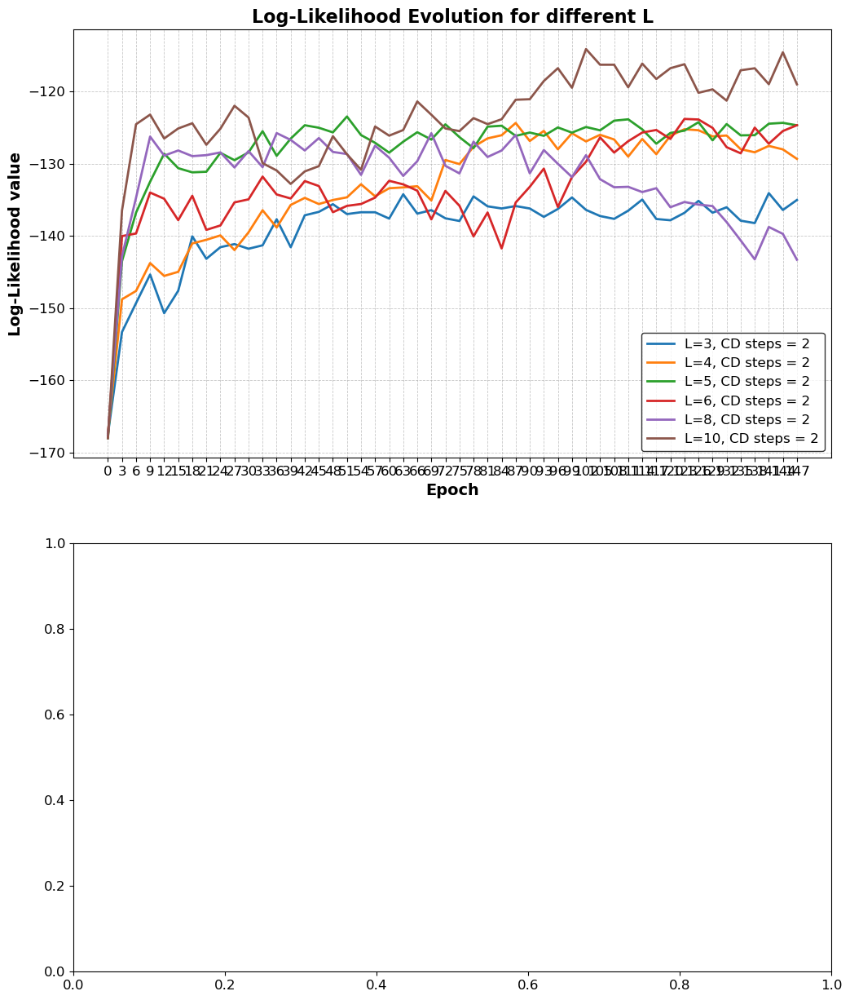

ValueError: x and y must have same first dimension, but have shapes (50,) and (10,)

In [ ]:
# drawing graphs
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))

for i,log_like in enumerate(log_like_L): # fixed CD steps=2
    ax1.plot(num_epo, log_like, label=f'L={L_v[i]}, CD steps = 2',linewidth=2, markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax1.set_title('Log-Likelihood Evolution for different L', fontsize=16, fontweight='bold')
    ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    #ax1.set_xticks(num_epo)
    ax1.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

for i,log_like in enumerate(log_like_cd): # fixed L=3
    ax2.plot(num_epo, log_like, label=f'L=3, CD steps ={Nt_v[i]}',marker='o',linewidth=2, markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax2.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax2.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax2.set_title('Log-Likelihood evolution for different CD steps', fontsize=16, fontweight='bold')
    #ax2.set_xticks(num_epo)
    ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    ax2.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

plt.show()


## Likelihood dependance on number of visible variables and CD steps  

Now we want to compare the likelihood values after the transient, in the last epochs of training, varying the parameters L and Nt. We previously observed that the likelihood appers to be quite stable after a certain number of epochs, but this needs to be verified more rigorously considering more iterations for each likelihhod estimation (10 for computational feasability), and taking their average and standard deviation. We focus on the last 10 epochs and, after verifying the stability of the likelihood, we compare their average values for the different number of visible variables and CD steps considered.       

In [ ]:
# Log-likelyhood after transient for different L and fixed CD steps = 2: stability check and mean; mean comparison for different L

log_like_L=[]
log_like_L_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-10,Nepoch,1)

for L in L_v:
    Nt=2
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    log_like_std=[]
    for i in range(Nepoch-10,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter= []
        for iter in range(10): # to determine the loglike at each epoch we run the calculation 10 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like.append(ll_mean)
        log_like_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_L.append(log_like)
    log_like_L_std.append(log_like_std)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1259.76it/s]


Log-likelihood= -135.33417648347438 +- 0.4948436913465755
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1140.92it/s]


Log-likelihood= -134.8111327991385 +- 0.7519264151407518
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1185.13it/s]


Log-likelihood= -135.55996648476102 +- 0.4509732611999631
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.98it/s]


Log-likelihood= -135.3511763225206 +- 0.547801735890055
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.27it/s]


Log-likelihood= -135.90257631379617 +- 0.728230882196492
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.41it/s]


Log-likelihood= -136.76855143709196 +- 0.47586230560254345
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1279.10it/s]


Log-likelihood= -135.16244862200264 +- 0.5562445680022283
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.01it/s]


Log-likelihood= -135.29951070916115 +- 0.6054118397588848
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1167.63it/s]


Log-likelihood= -137.856631852215 +- 0.3441585016734641
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.59it/s]


Log-likelihood= -136.16619959293686 +- 0.25801107424517805
a_all L=4, Nt=2
b_all L=4, Nt=2
w_all L=4, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 513.36it/s]


Log-likelihood= -127.23964660500101 +- 0.6780543748242523
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 664.22it/s]


Log-likelihood= -127.51342276154364 +- 0.6509824597578027
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 660.13it/s]


Log-likelihood= -127.10669977917291 +- 0.5055897364897357
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 664.17it/s]


Log-likelihood= -127.87576526185676 +- 0.4787348963725224
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 668.49it/s]


Log-likelihood= -128.63018612941715 +- 0.519124372826951
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 658.09it/s]


Log-likelihood= -126.13121638301577 +- 0.32314326017105055
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 630.02it/s]


Log-likelihood= -128.37572819065633 +- 0.5815404561838426
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 630.22it/s]


Log-likelihood= -127.59672423564625 +- 0.3357670414481326
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 628.76it/s]


Log-likelihood= -127.85731339124989 +- 0.60759003302781
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 522.57it/s]


Log-likelihood= -127.24332584476846 +- 0.3837833880827182
a_all L=5, Nt=2
b_all L=5, Nt=2
w_all L=5, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 286.59it/s]


Log-likelihood= -124.89476238745674 +- 0.9758199745947126
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 324.57it/s]


Log-likelihood= -124.32258789311607 +- 0.600548972734193
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.41it/s]


Log-likelihood= -125.20089106503936 +- 0.6650164555437056
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 496.01it/s]


Log-likelihood= -124.39628785756847 +- 0.5295998619426238
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 633.18it/s]


Log-likelihood= -124.21529083572823 +- 0.6846724798821712
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 640.20it/s]


Log-likelihood= -124.71925130957898 +- 0.6167279671393802
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 521.09it/s]


Log-likelihood= -124.59398138047318 +- 0.5755982318103808
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 637.73it/s]


Log-likelihood= -124.75019284466148 +- 0.501963749973891
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 642.09it/s]


Log-likelihood= -124.58670012040932 +- 0.6344227892486787
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 522.32it/s]


Log-likelihood= -126.353581685533 +- 0.6850705981884185
a_all L=6, Nt=2
b_all L=6, Nt=2
w_all L=6, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 283.45it/s]


Log-likelihood= -124.39803732334796 +- 0.5754579471967136
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.32it/s]


Log-likelihood= -128.07955933051826 +- 0.3888809271906497
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 322.19it/s]


Log-likelihood= -126.26470575733603 +- 0.5187534766411706
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 292.17it/s]


Log-likelihood= -125.09584782778013 +- 0.5254182921438733
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 321.92it/s]


Log-likelihood= -125.1264102145808 +- 0.5315586332479377
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 326.19it/s]


Log-likelihood= -122.57487770281391 +- 0.904060831077091
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 290.48it/s]


Log-likelihood= -125.33736516050458 +- 0.5439818076971923
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.44it/s]


Log-likelihood= -124.25358464764872 +- 0.5476136563096112
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 336.04it/s]


Log-likelihood= -123.90844003512714 +- 0.4056092130889154
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 327.66it/s]


Log-likelihood= -125.34595677910254 +- 0.7057755641162581
a_all L=8, Nt=2
b_all L=8, Nt=2
w_all L=8, Nt=2
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.15it/s]


Log-likelihood= -138.8940384882829 +- 0.6695564998307214
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.37it/s]


Log-likelihood= -138.8846233625182 +- 0.5734429837321443
Epoch n.142


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.96it/s]


Log-likelihood= -141.19081979456698 +- 0.40445018925136705
Epoch n.143


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.43it/s]


Log-likelihood= -142.0026786300512 +- 0.7902159243919353
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.88it/s]


Log-likelihood= -139.93224318546316 +- 0.5682470997883244
Epoch n.145


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.38it/s]


Log-likelihood= -143.31943112793687 +- 0.39284761572730864
Epoch n.146


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.90it/s]


Log-likelihood= -142.93490990751363 +- 0.6556731291415835
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.81it/s]


Log-likelihood= -142.83249761388294 +- 0.4144386309838914
Epoch n.148


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.91it/s]


Log-likelihood= -144.50049937518668 +- 0.4488331629640661
Epoch n.149


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:13<00:00, 74.72it/s]


Log-likelihood= -143.95647410022974 +- 0.6227667792952782
a_all L=10, Nt=2
b_all L=10, Nt=2
w_all L=10, Nt=2
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:44<00:00, 19.29it/s]


Log-likelihood= -120.98272949543063 +- 0.1880402209943159
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:59<00:00, 18.34it/s]


Log-likelihood= -119.06022603199169 +- 0.3886766717074701
Epoch n.142


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.52it/s]


Log-likelihood= -118.15374164821438 +- 0.44014342644319515
Epoch n.143


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:33<00:00, 20.10it/s]


Log-likelihood= -120.63752887443452 +- 0.37117820128720863
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -115.27407393736273 +- 0.5426310855937532
Epoch n.145


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.72it/s]


Log-likelihood= -118.33354007929377 +- 0.2893632765113282
Epoch n.146


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.56it/s]


Log-likelihood= -118.2082683436015 +- 0.5958565634503485
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:51<00:00, 18.88it/s]


Log-likelihood= -119.16769683870943 +- 0.4292029640536674
Epoch n.148


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:50<00:00, 18.92it/s]


Log-likelihood= -115.77222552770385 +- 0.2773327479113979
Epoch n.149


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:55<00:00, 18.58it/s]

Log-likelihood= -114.99729793520255 +- 0.7080737294347231


In [ ]:
import dill
dill.dump_session('save_ll_1.7.db')
#import dill
#dill.load_session('save_ll.db_1.7')
#

In [ ]:
# Log-likelyhood after transient for different CD steps and fixed L = 3: stability check and mean; mean comparison for different CD steps

log_like_cd=[]
log_like_cd_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-10,Nepoch,1)

for L in L_v:
    if L==3:
        for Nt in Nt_v:
            a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
            b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
            w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

            log_like=[]
            log_like_std=[]
            Nepoch=150
            for i in range(Nepoch-10,Nepoch,1):
                print(f'Epoch n.{i}')
                ll_iter=[]
                mean=[]
                for iter in range(10): # to determine the loglike at each epoch we run the calculation 10 times and compute the average, to reduce randomness
                    ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
                    ll_iter.append(ll)
                ll_mean= np.array(ll_iter).mean()
                ll_std= np.array(ll_iter).std()
                log_like.append(ll_mean)
                log_like_std.append(ll_std)
                print('Log-likelihood=',ll_mean,"+-",ll_std)
            log_like_cd.append(log_like)
            log_like_cd_std.append(log_like_std)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2303.36it/s]


Log-likelihood= -135.40244199882693 +- 0.4064576716831954
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2281.73it/s]


Log-likelihood= -134.80174518824106 +- 0.6544495331297595
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2255.27it/s]


Log-likelihood= -135.4733447721828 +- 0.4727529126773889
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2281.40it/s]


Log-likelihood= -134.85709953691213 +- 0.5561732850054889
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2287.75it/s]


Log-likelihood= -135.60779506409935 +- 0.38213269719854126
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.47it/s]


Log-likelihood= -136.66377353849435 +- 0.7581315063921562
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2318.56it/s]


Log-likelihood= -135.32058149727166 +- 0.2423803120777691
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2088.95it/s]


Log-likelihood= -135.46887302374594 +- 0.5678899520697064
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2185.31it/s]


Log-likelihood= -137.95932993407374 +- 0.4370521579879841
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2264.38it/s]


Log-likelihood= -136.34938393386227 +- 0.3984022302331581
a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2145.98it/s]


Log-likelihood= -131.78400472104974 +- 0.6156035629335075
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2046.90it/s]


Log-likelihood= -133.4510570424571 +- 0.7007948806647603
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2128.24it/s]


Log-likelihood= -131.65811079246814 +- 0.5635793653271923
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2194.06it/s]


Log-likelihood= -132.15154309424784 +- 0.560565735000031
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2213.10it/s]


Log-likelihood= -132.04595727772278 +- 0.6755670677629372
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2287.43it/s]


Log-likelihood= -132.60066211388505 +- 0.6671162489332465
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2236.96it/s]


Log-likelihood= -131.97316505605727 +- 0.6878004506596289
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2116.09it/s]


Log-likelihood= -131.5429920280286 +- 0.5377688847156716
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2195.19it/s]


Log-likelihood= -131.48110043235027 +- 0.6864442451894349
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2124.71it/s]


Log-likelihood= -131.6920525186129 +- 0.7851726696602334
a_all L=3, Nt=6
b_all L=3, Nt=6
w_all L=3, Nt=6
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2303.93it/s]


Log-likelihood= -138.5189379465333 +- 0.588272834139861
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2231.17it/s]


Log-likelihood= -138.0830687221584 +- 0.533357643559949
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2112.52it/s]


Log-likelihood= -136.69706982423364 +- 0.4469185615013901
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2181.67it/s]


Log-likelihood= -139.25442254791417 +- 0.43331996389215605
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2297.09it/s]


Log-likelihood= -137.522518426016 +- 0.41561270607493656
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3205.86it/s]


Log-likelihood= -139.0266563235406 +- 0.560888616334427
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2300.66it/s]


Log-likelihood= -137.09725928832418 +- 0.5871874193054396
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2192.89it/s]


Log-likelihood= -138.87441175683392 +- 0.556122196952543
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2216.75it/s]


Log-likelihood= -137.2204115241542 +- 0.3870065509106904
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2222.09it/s]


Log-likelihood= -137.1386697223408 +- 0.41515645049600175
a_all L=3, Nt=8
b_all L=3, Nt=8
w_all L=3, Nt=8
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2211.36it/s]


Log-likelihood= -131.93444690763366 +- 0.5992888370884695
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2238.25it/s]


Log-likelihood= -131.26384222353695 +- 0.633165671183006
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2215.65it/s]


Log-likelihood= -131.83929376012918 +- 0.6172394313356687
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2121.61it/s]


Log-likelihood= -132.75838543082148 +- 0.6102940064162099
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 2961.52it/s]


Log-likelihood= -131.50124926168507 +- 0.5949768092231003
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2166.11it/s]


Log-likelihood= -131.70532187613148 +- 0.4150116301992774
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2237.69it/s]


Log-likelihood= -131.39400500651692 +- 0.5506826404248658
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2271.43it/s]


Log-likelihood= -131.9267508834783 +- 0.6128364020183464
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2297.70it/s]


Log-likelihood= -132.07714446105746 +- 0.6500349131992584
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2209.74it/s]


Log-likelihood= -132.65609932041366 +- 0.555598822602165
a_all L=3, Nt=10
b_all L=3, Nt=10
w_all L=3, Nt=10
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2269.61it/s]


Log-likelihood= -139.22652463607128 +- 0.4957176355423664
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2283.60it/s]


Log-likelihood= -138.2416056269301 +- 0.4765155792163485
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3365.60it/s]


Log-likelihood= -138.19518722014908 +- 0.6447341640592643
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2322.81it/s]


Log-likelihood= -138.79636511472617 +- 0.47976882421021505
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2242.59it/s]


Log-likelihood= -138.86111333115795 +- 0.4910005354421933
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2210.69it/s]


Log-likelihood= -139.37913916431813 +- 0.6591393618671353
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2244.12it/s]


Log-likelihood= -137.25599268025408 +- 0.48488594644730243
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2181.36it/s]


Log-likelihood= -137.32012826392247 +- 0.5331333744545672
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2192.51it/s]


Log-likelihood= -138.8454413367235 +- 0.24931820809070573
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2104.26it/s]


Log-likelihood= -139.7254582172481 +- 0.45059376677110324
a_all L=3, Nt=15
b_all L=3, Nt=15
w_all L=3, Nt=15
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2290.55it/s]


Log-likelihood= -134.95994553501606 +- 0.4446400687830309
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2248.70it/s]


Log-likelihood= -134.5258668775715 +- 0.8428762802819025
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2252.34it/s]


Log-likelihood= -134.39313539889125 +- 0.6601746132077289
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.19it/s]


Log-likelihood= -134.80374006767016 +- 0.7263023012433573
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2352.10it/s]


Log-likelihood= -134.62408650413028 +- 0.71548688680001
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3120.23it/s]


Log-likelihood= -135.23556137915062 +- 0.5754182086565504
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2221.82it/s]


Log-likelihood= -135.3570455709304 +- 0.5345471318252437
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2256.19it/s]


Log-likelihood= -133.8319397373477 +- 0.5191095584380684
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2213.68it/s]


Log-likelihood= -134.81752609460844 +- 0.6343818886318692
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2298.82it/s]

Log-likelihood= -134.50114583157932 +- 0.6634738584173402


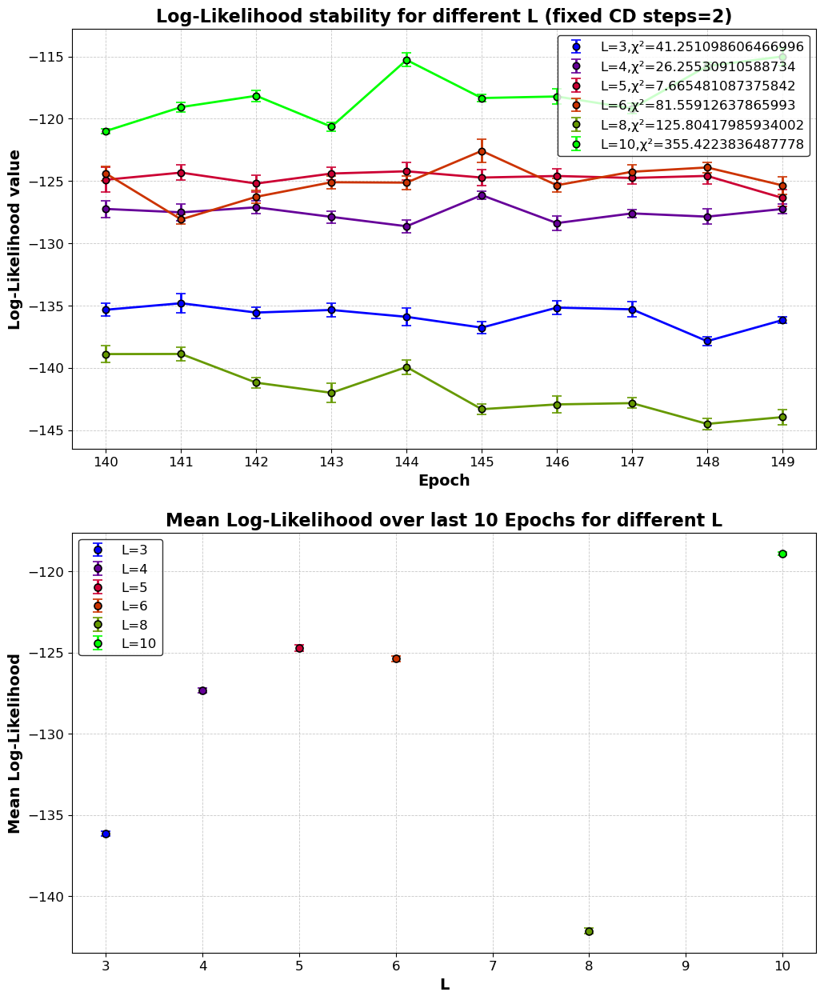

In [ ]:
# plots of log-likelihood of last 10 epochs and their mean

# variable L, fixed CD steps
colors = plt.cm.brg(np.linspace(0, 1, len(log_like_L)))
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))
num_epo=np.arange(Nepoch-10,Nepoch,1)

for i, log_like in enumerate(log_like_L):
    weights = 1 / np.array(log_like_L_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_L_std[i])** 2)

    ax1.errorbar(num_epo,log_like,yerr=log_like_L_std[i],fmt='o',color=colors[i],label=f'L={L_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=6,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(L_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'L={L_v[i]}',linewidth=2,markersize=6.5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    #ax1.plot(num_epo,np.ones(10)*weighted_avg,linestyle='--',color=colors[i])

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different L (fixed CD steps=2)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='best', frameon=True,bbox_to_anchor=(1, 0.9) edgecolor='black')

ax2.set_xlabel('L', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 10 Epochs for different L', fontsize=16, fontweight='bold')
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

plt.show()

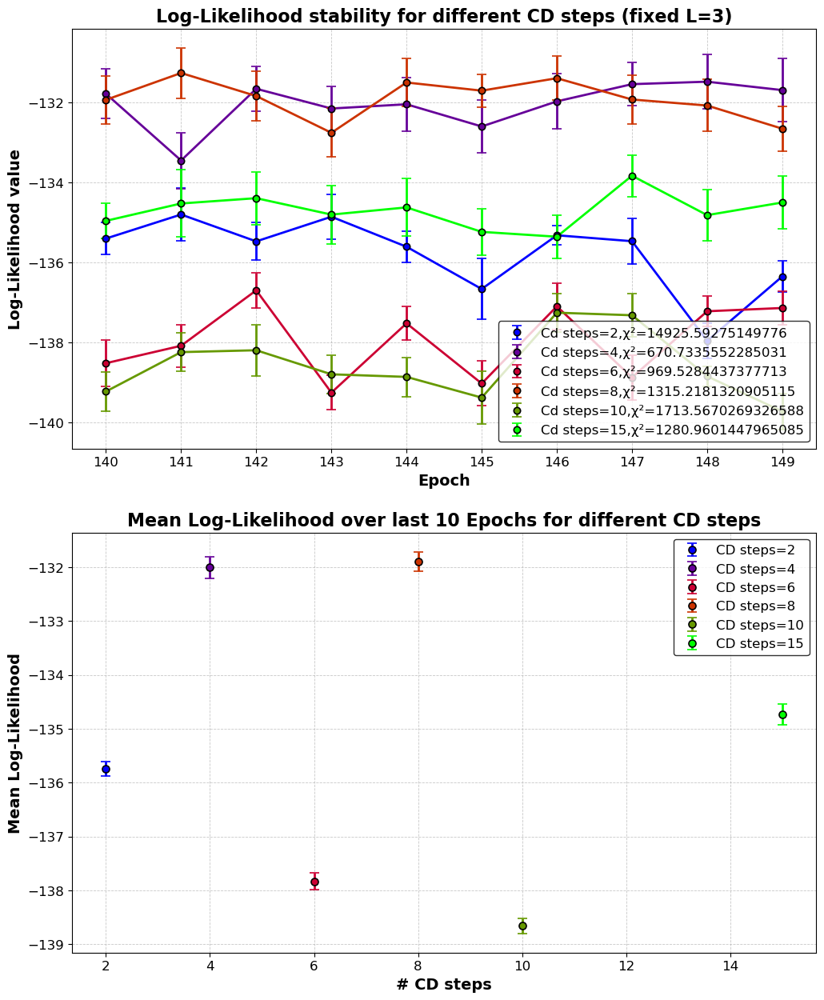

In [ ]:
# variable CD steps, fixed L
colors = plt.cm.brg(np.linspace(0, 1, len(log_like_cd)))
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))

for i, log_like in enumerate(log_like_cd):
    weights = 1 / np.array(log_like_cd_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_cd_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_cd_std[i],fmt='o',color=colors[i],label=f'CD steps={Nt_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=6,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(Nt_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'CD steps={Nt_v[i]}',linewidth=2,markersize=6.5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    #ax1.plot(num_epo,np.ones(10)*weighted_avg,linestyle='--',color=colors[i])

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different CD steps (fixed L=3)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

ax2.set_xlabel('# CD steps', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 10 Epochs for different CD steps', fontsize=16, fontweight='bold')
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

plt.show()

Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

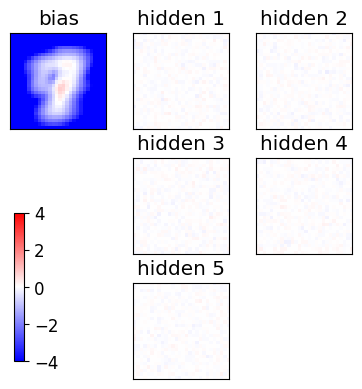

Starting the training
[13762  5407  5139 18824  3022 13556 13880  9621 19603  6252]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[ 4363 15877  8648  4167   493  6217  5094 15224 19288 20763]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[11572  1208 17461   539   701 16259 20623 17001  1746 17256]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[ 6398   708 12122 13365 13334  3311  9083   301 13458  3831]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

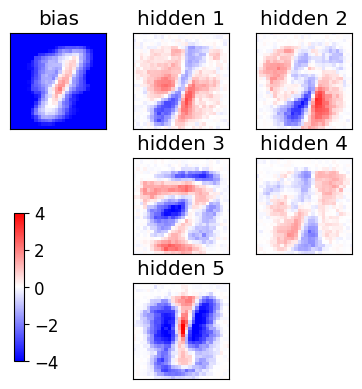

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

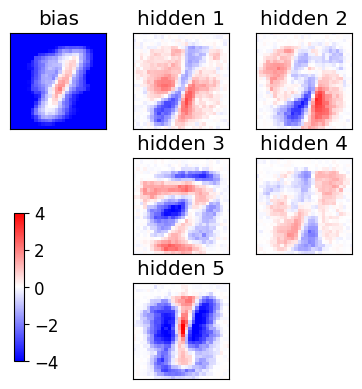

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

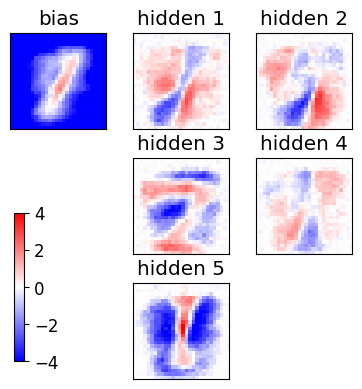

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

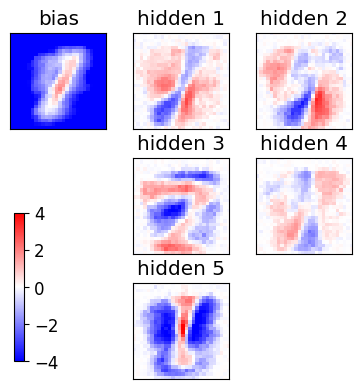

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

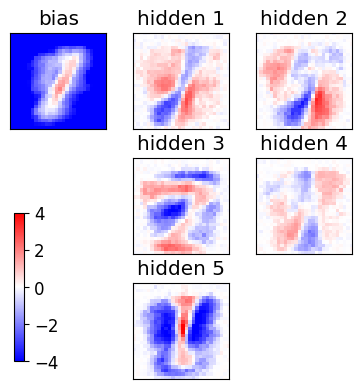

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

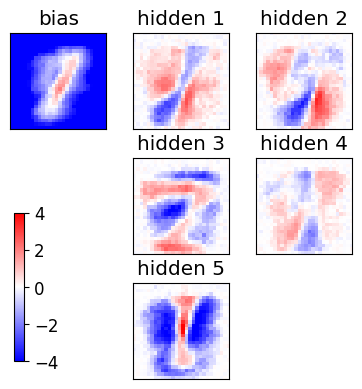

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

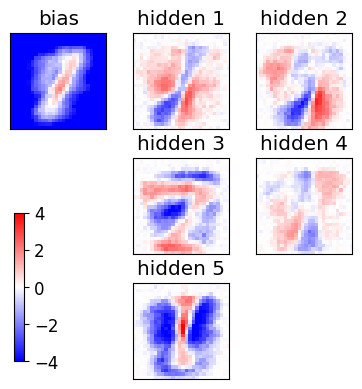

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

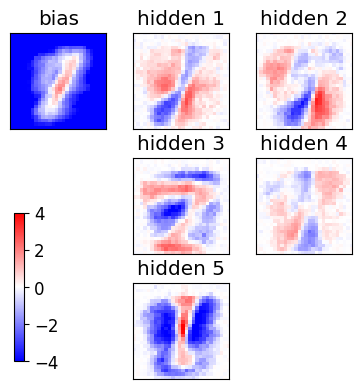

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

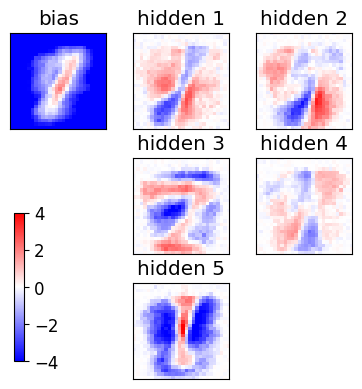

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

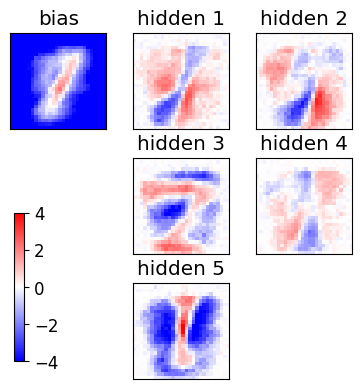

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

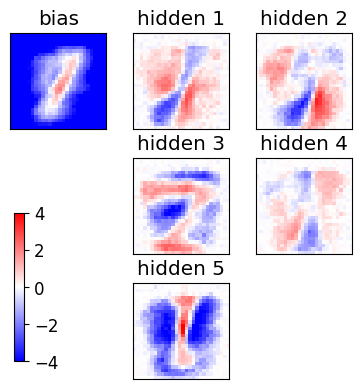

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

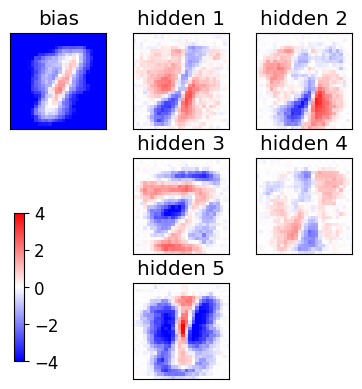

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

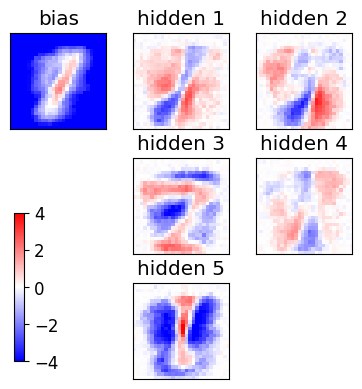

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

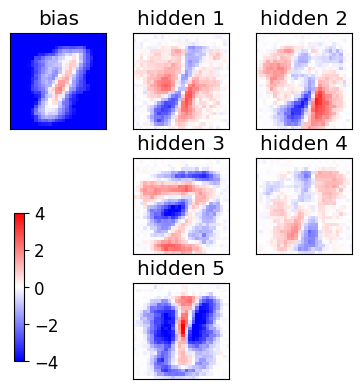

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

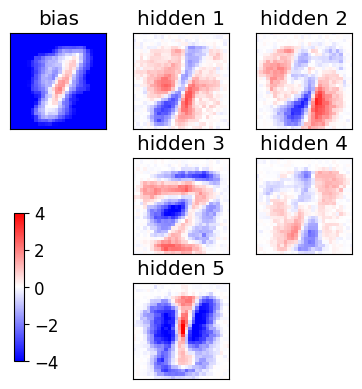

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

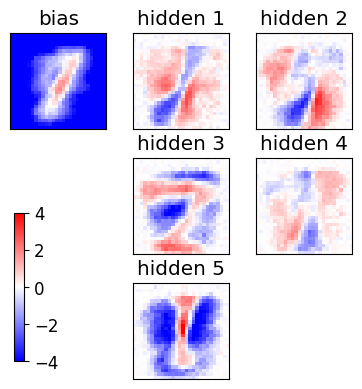

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

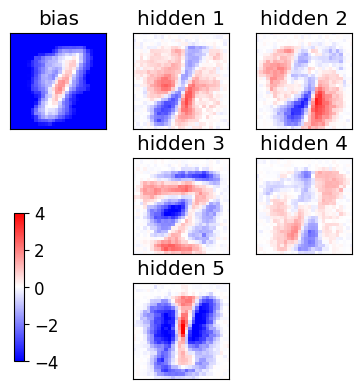

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

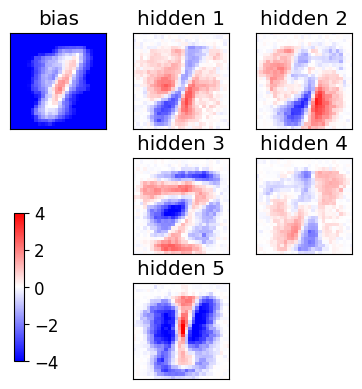

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

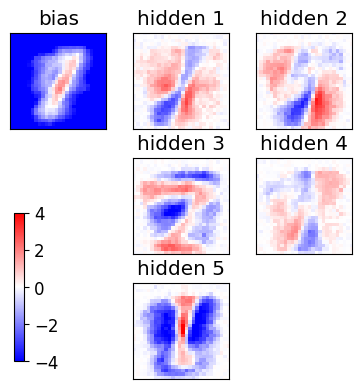

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

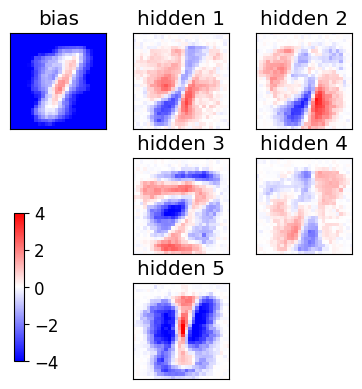

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

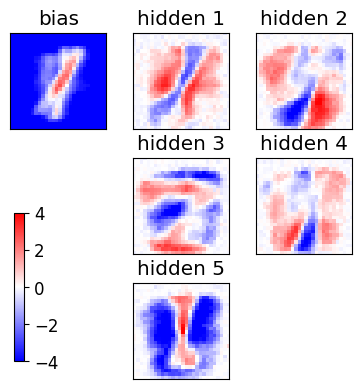

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

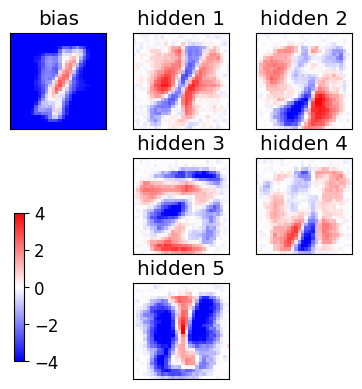

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

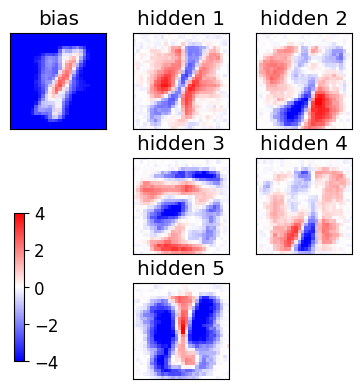

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

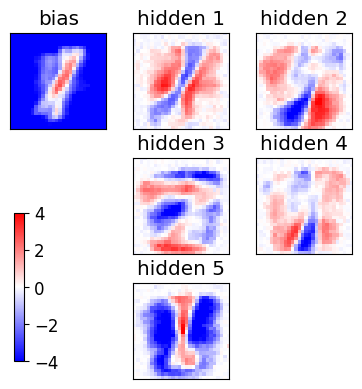

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

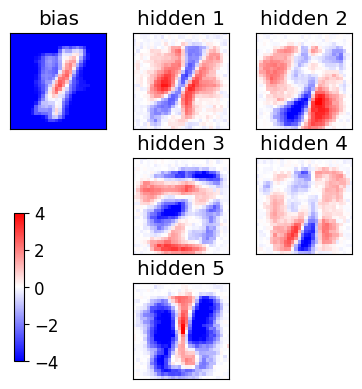

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

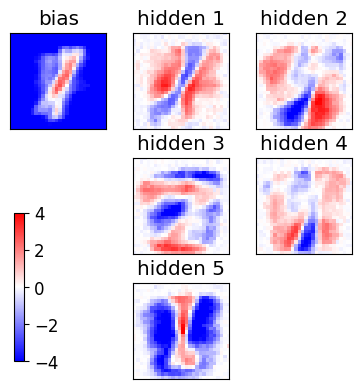

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

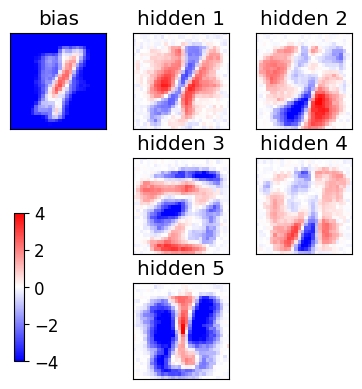

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

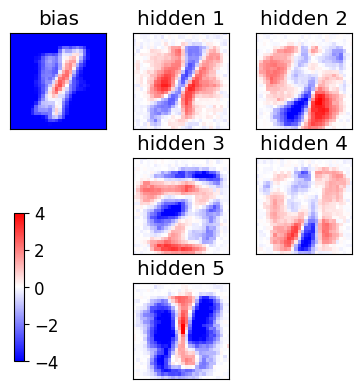

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

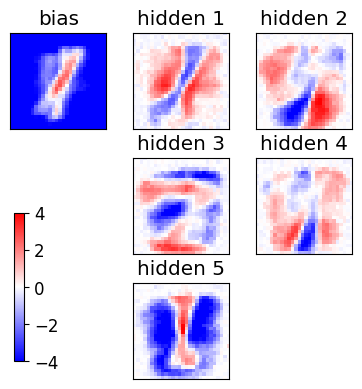

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

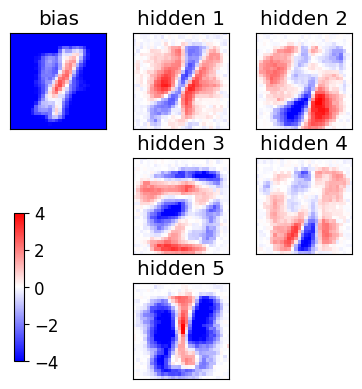

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

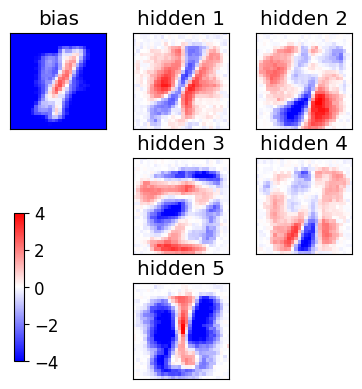

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

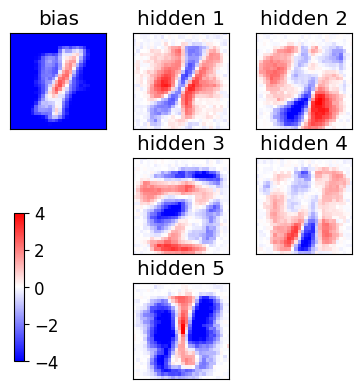

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

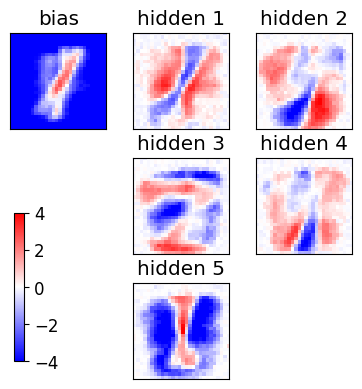

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

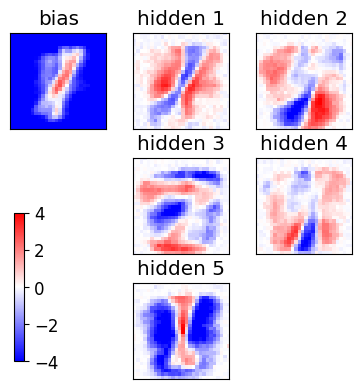

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

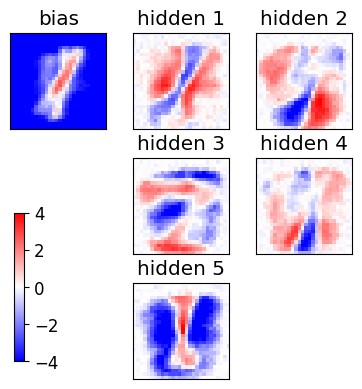

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

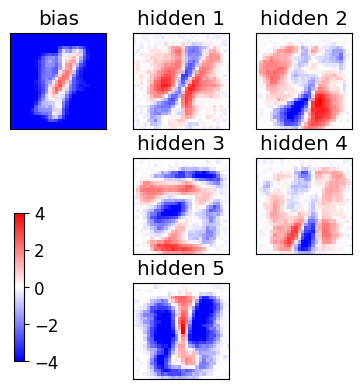

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

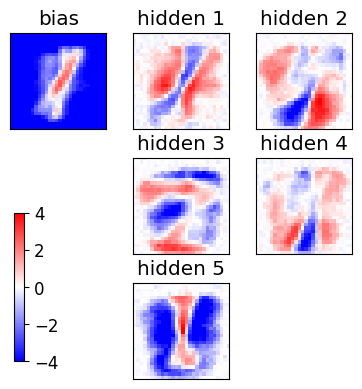

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

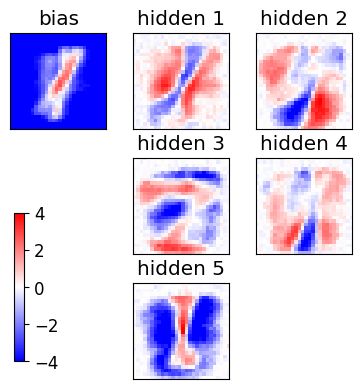

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

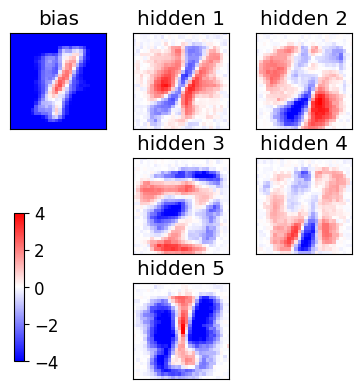

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

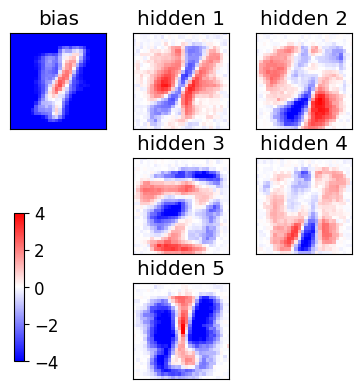

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

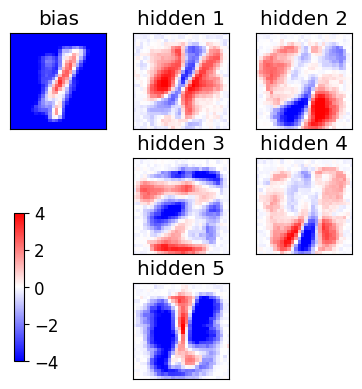

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

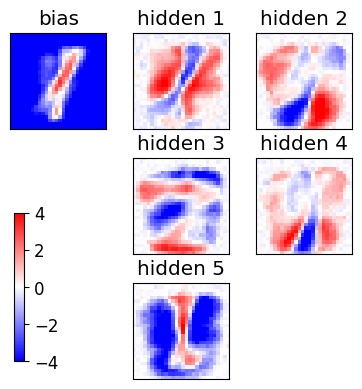

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

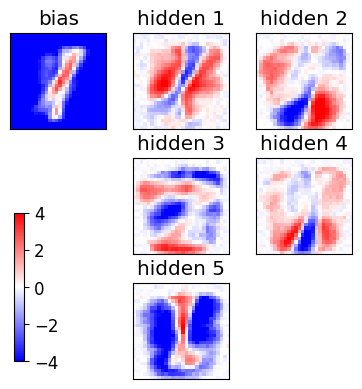

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

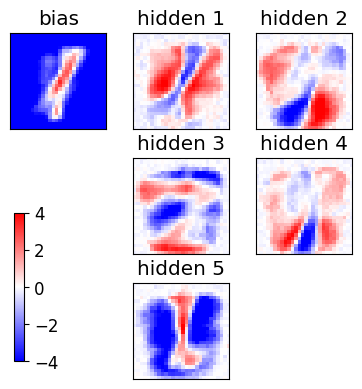

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

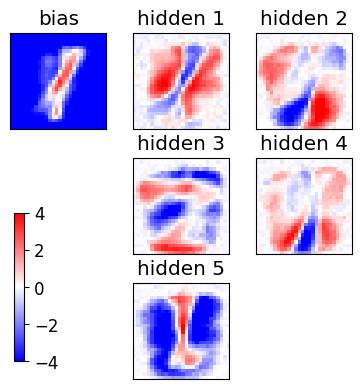

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

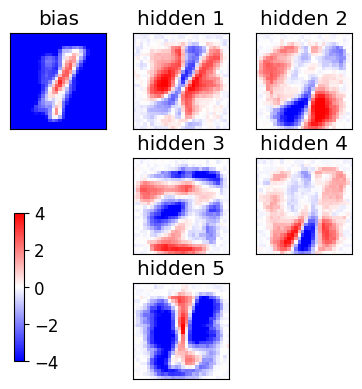

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

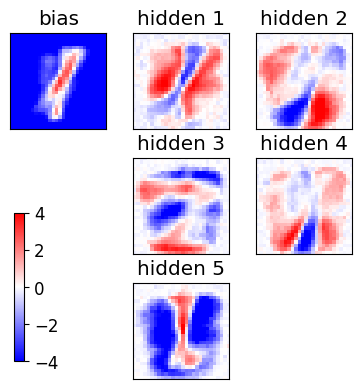

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

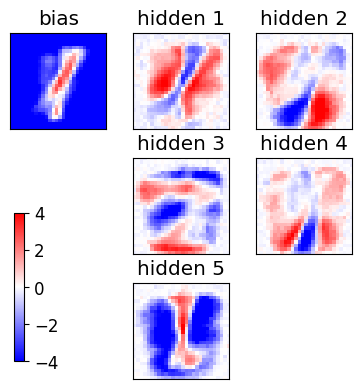

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

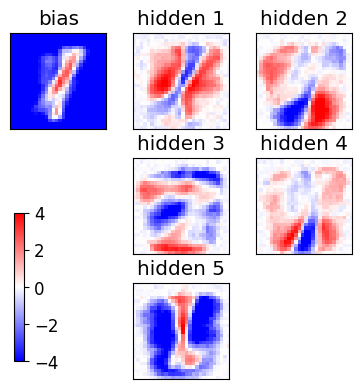

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

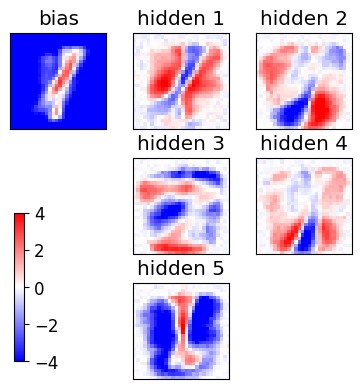

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

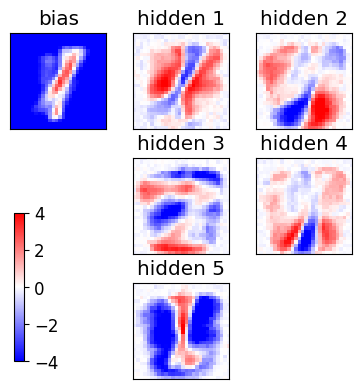

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

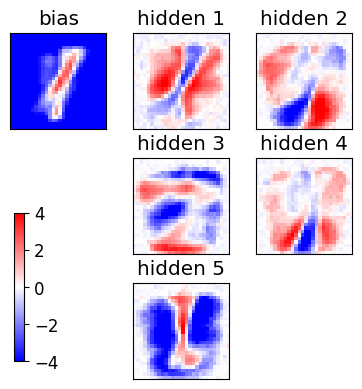

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

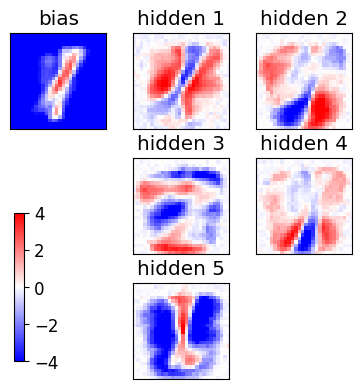

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

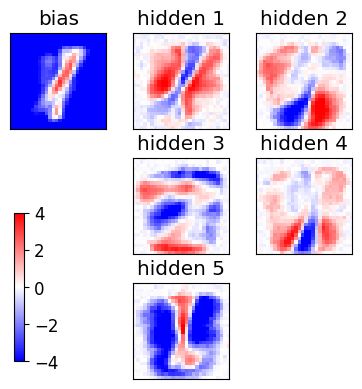

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

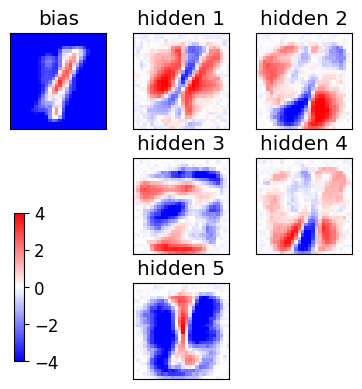

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

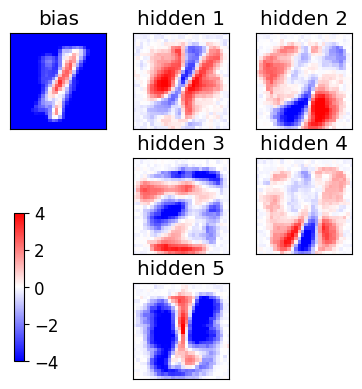

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

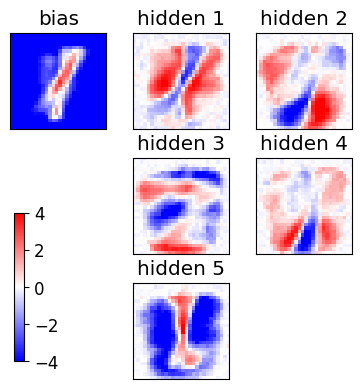

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

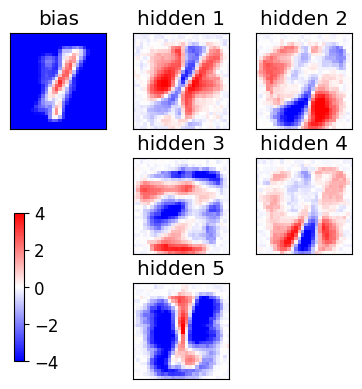

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

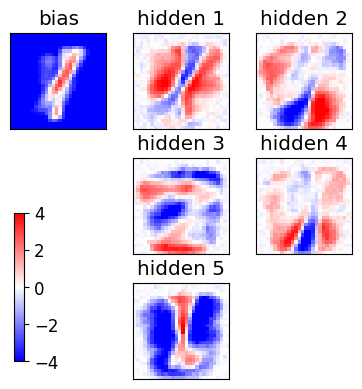

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

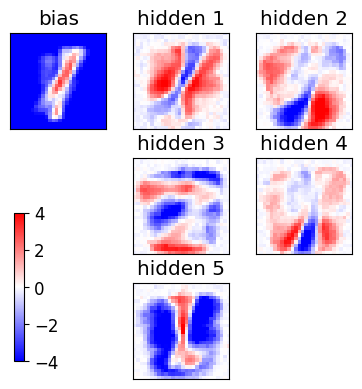

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

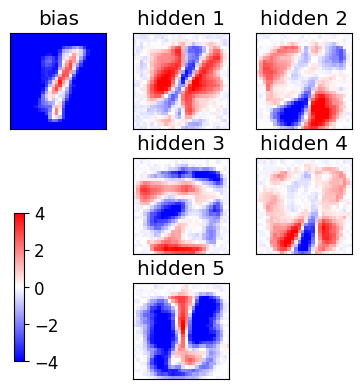

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

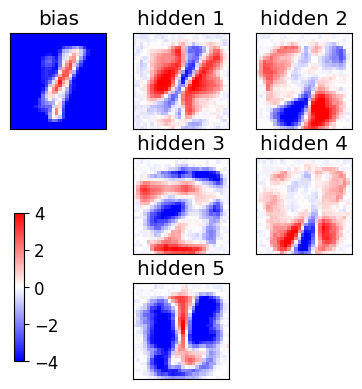

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

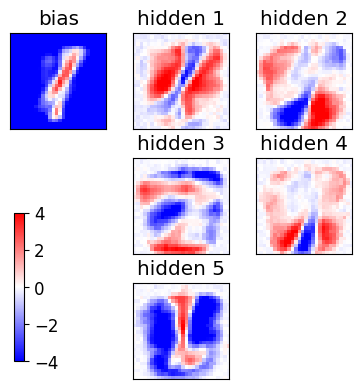

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

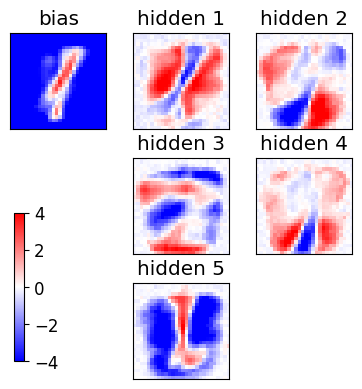

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

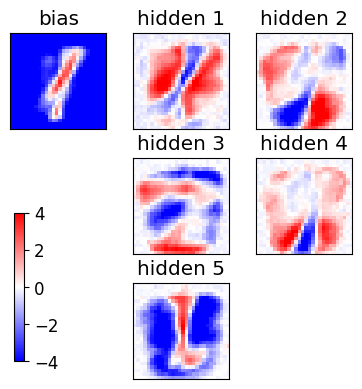

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

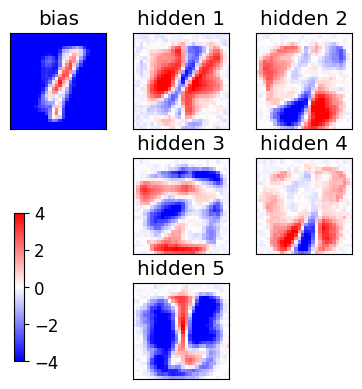

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

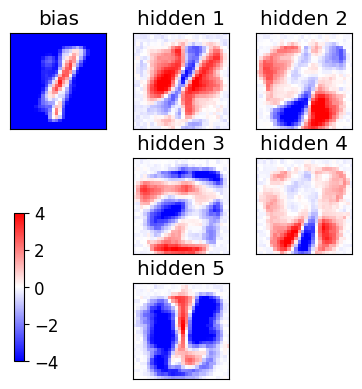

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

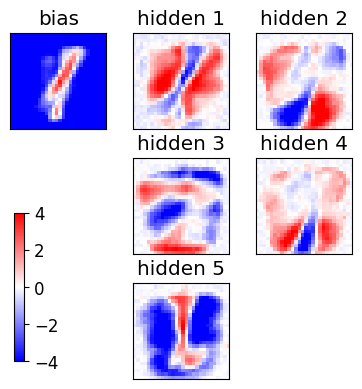

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

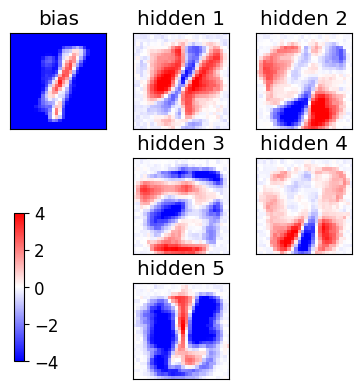

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

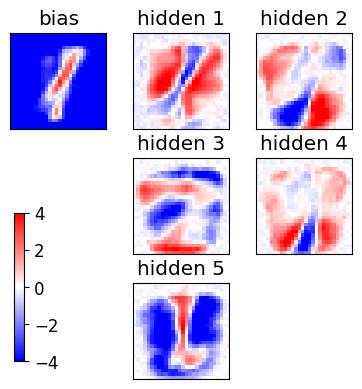

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

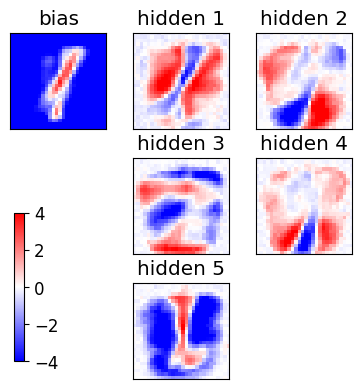

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

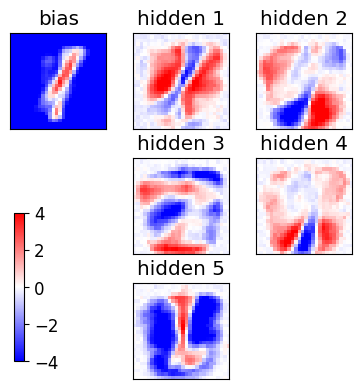

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

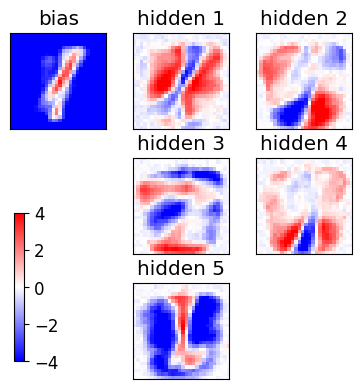

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

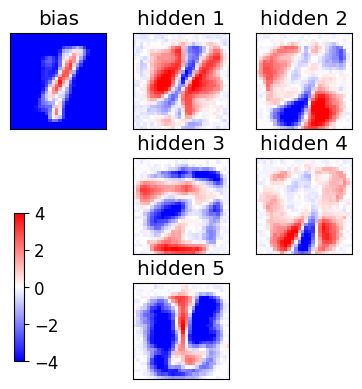

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

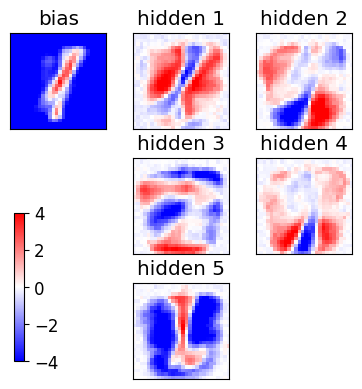

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

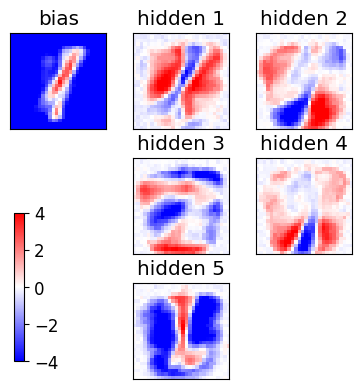

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

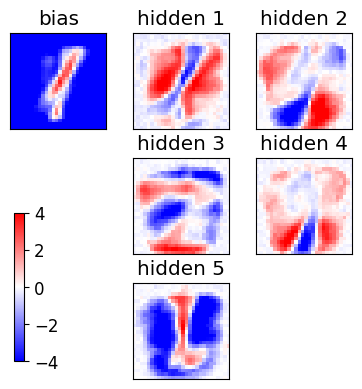

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

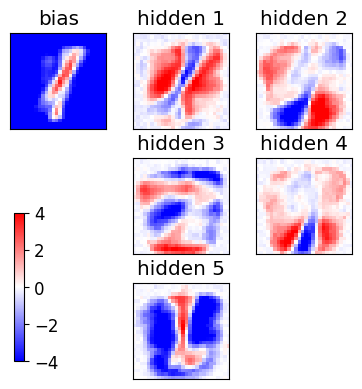

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

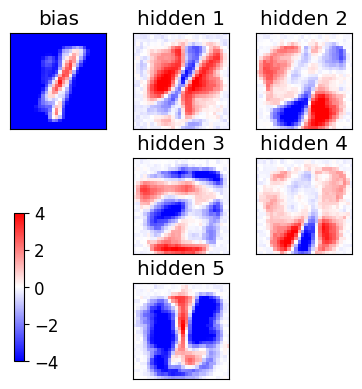

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

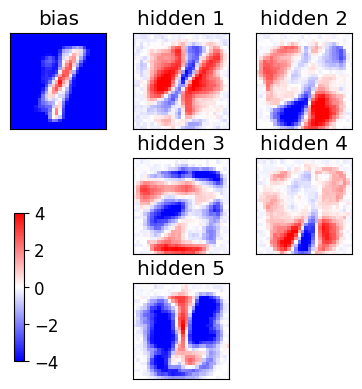

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 

<Figure size 640x480 with 0 Axes>

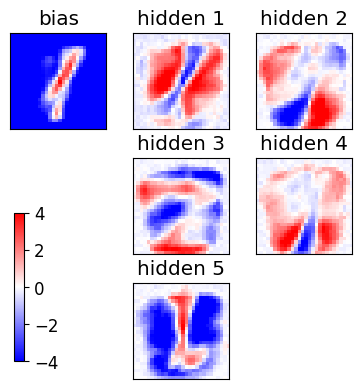

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

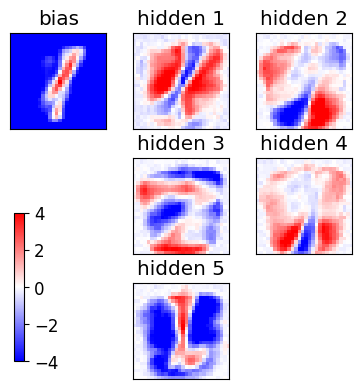

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

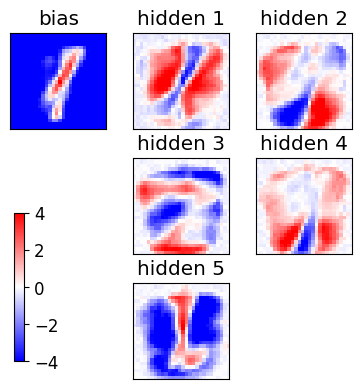

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

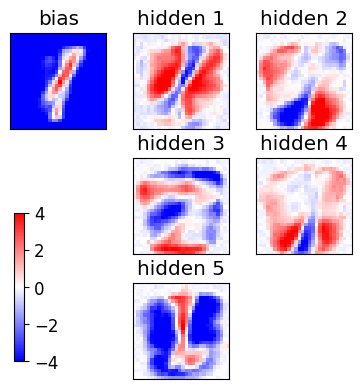

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

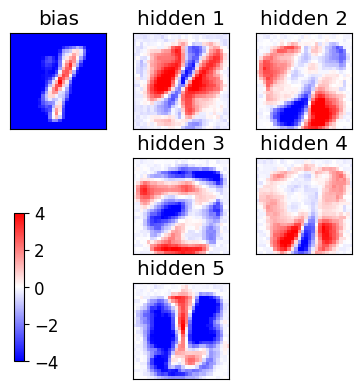

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

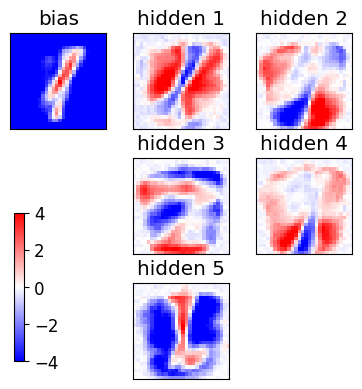

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

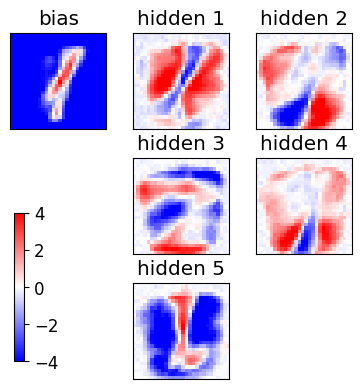

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

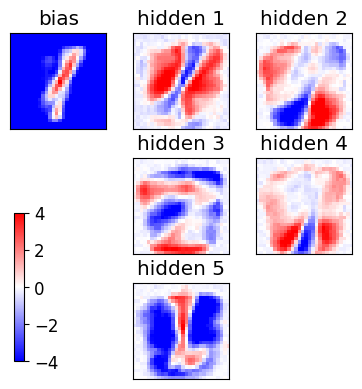

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

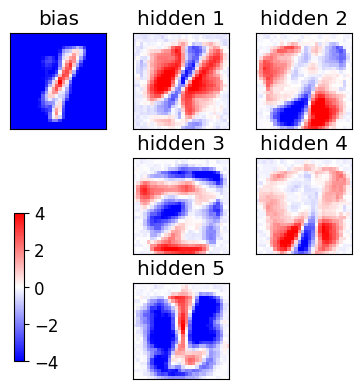

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

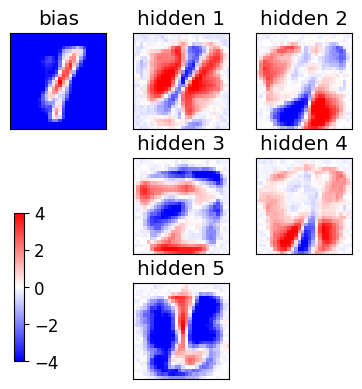

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

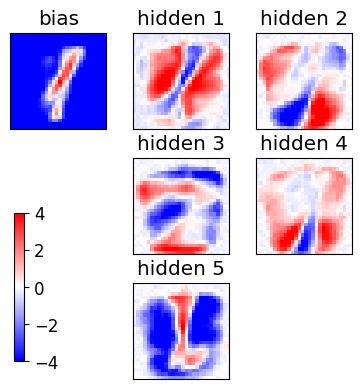

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

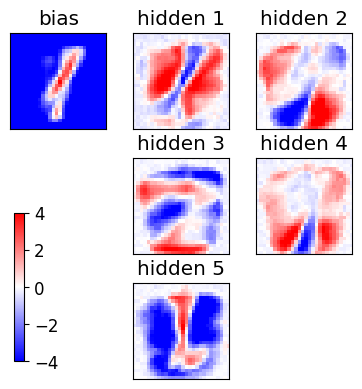

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

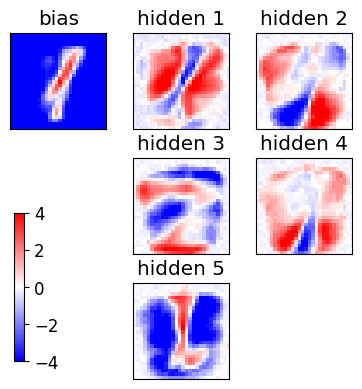

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

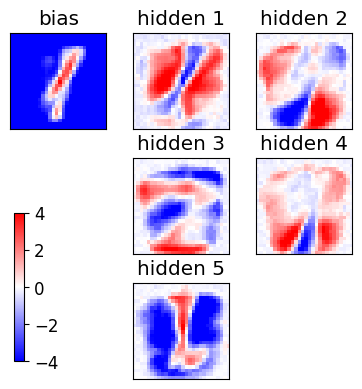

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

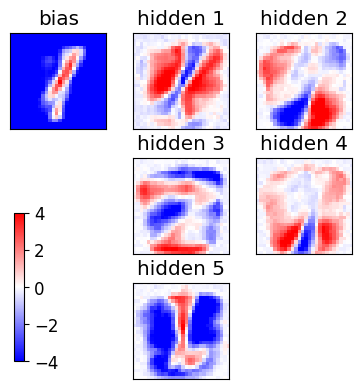

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

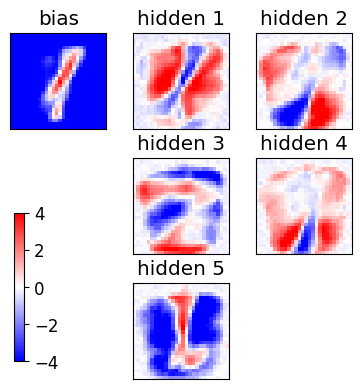

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

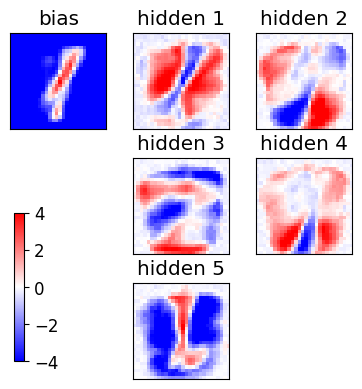

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

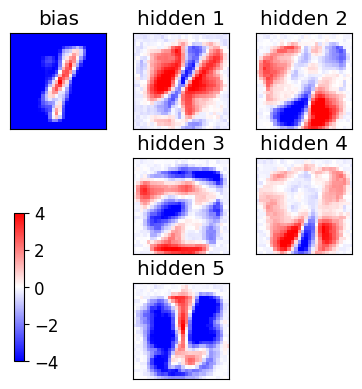

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

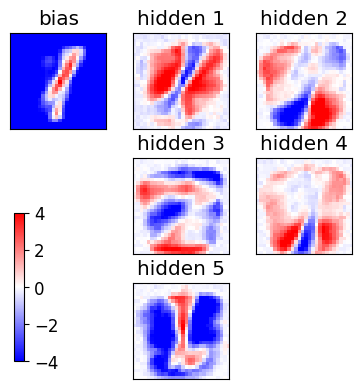

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

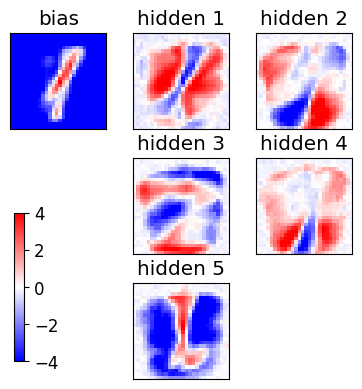

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  

<Figure size 640x480 with 0 Axes>

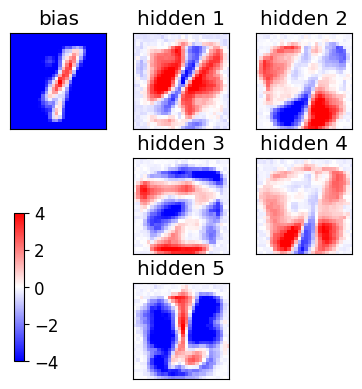

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

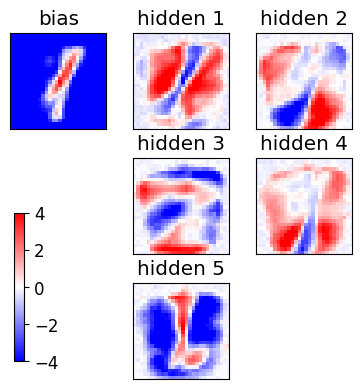

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

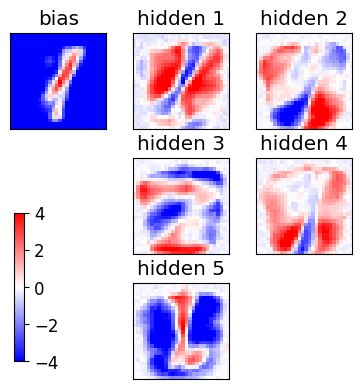

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

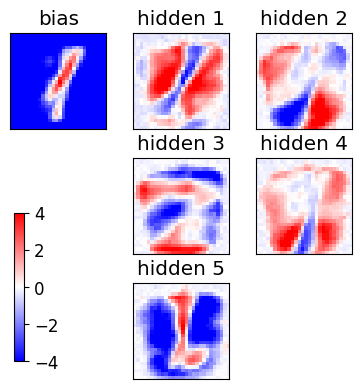

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

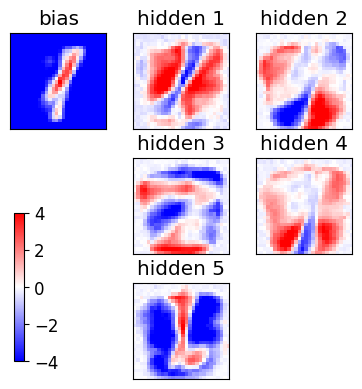

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

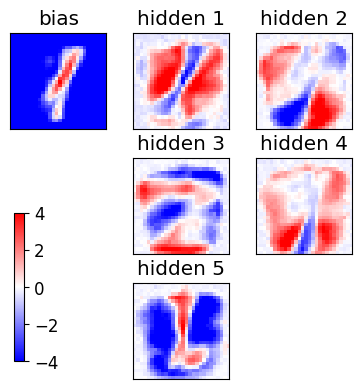

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

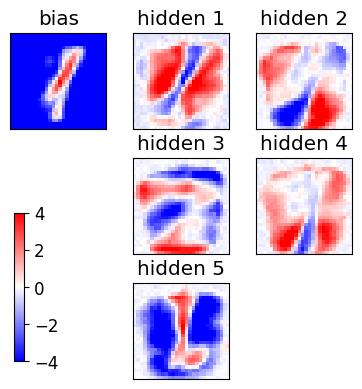

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

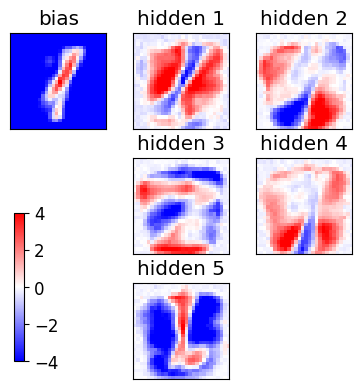

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

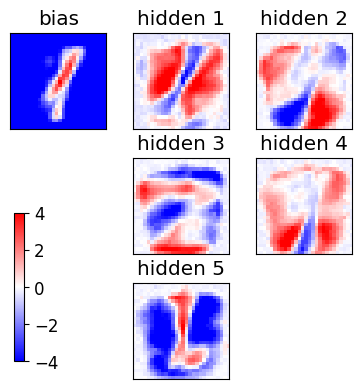

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

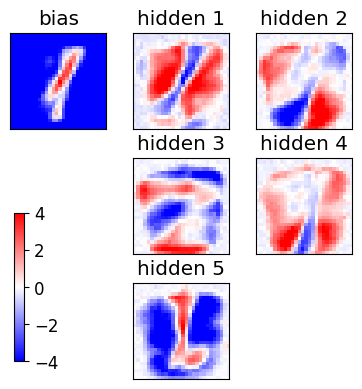

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

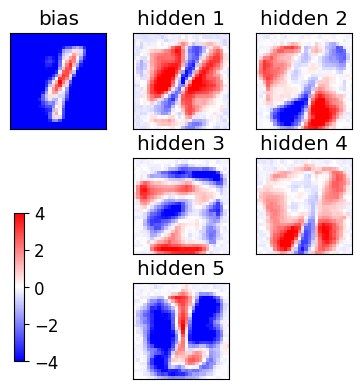

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

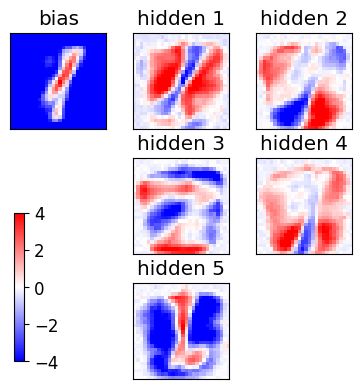

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

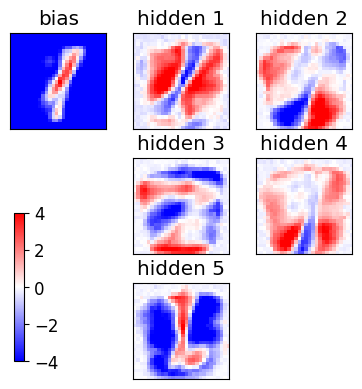

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

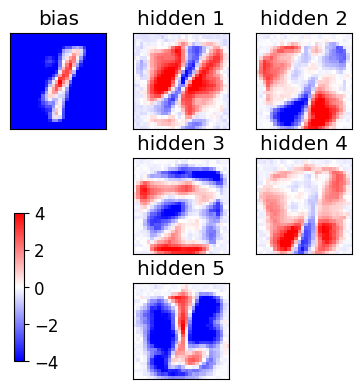

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

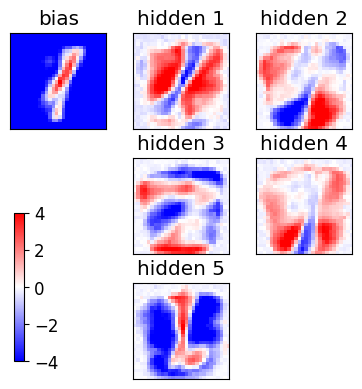

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

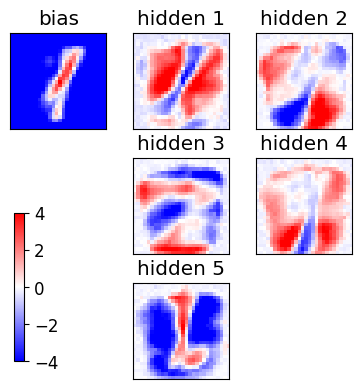

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

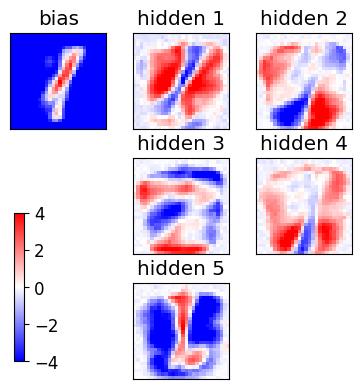

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

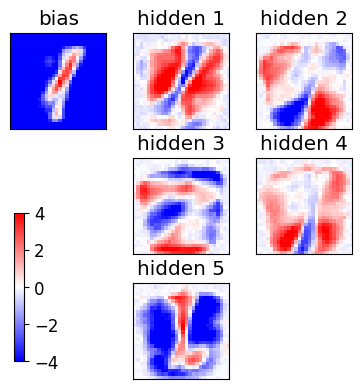

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

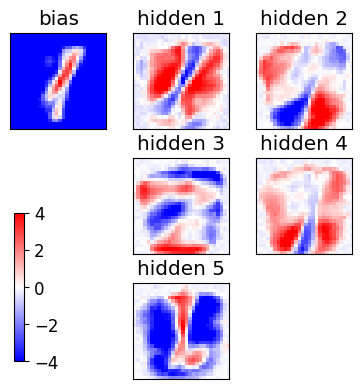

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

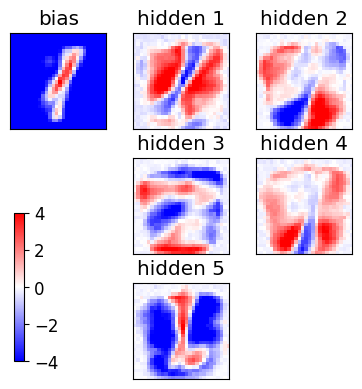

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  

<Figure size 640x480 with 0 Axes>

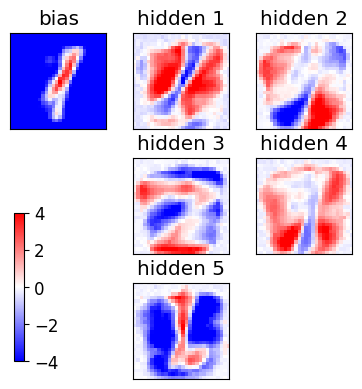

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

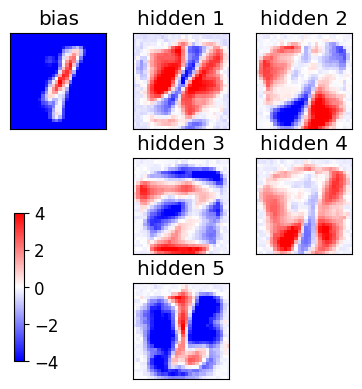

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

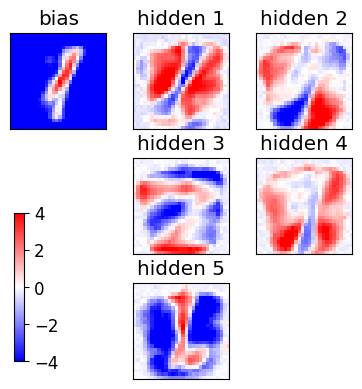

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

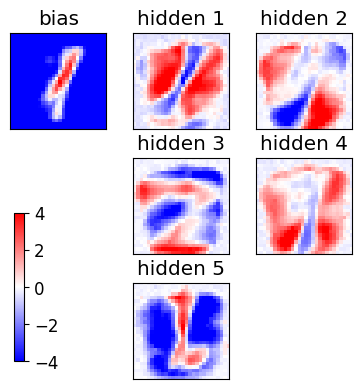

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

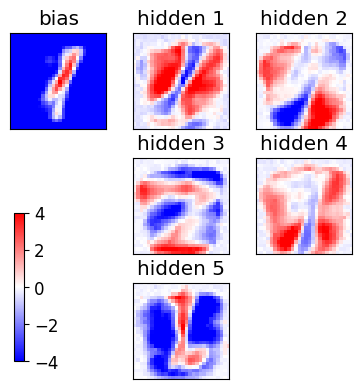

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

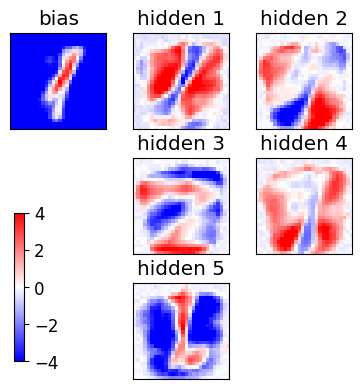

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

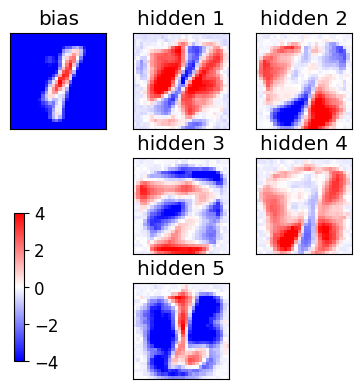

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

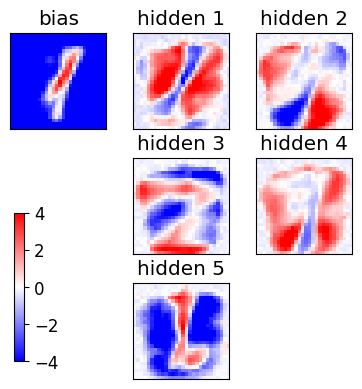

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

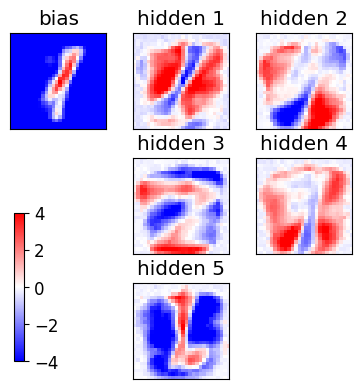

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

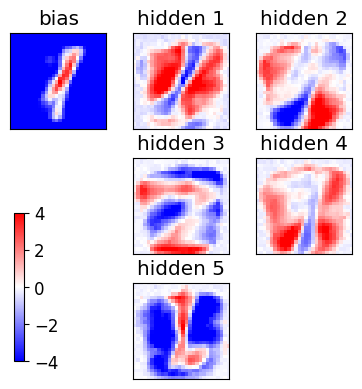

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

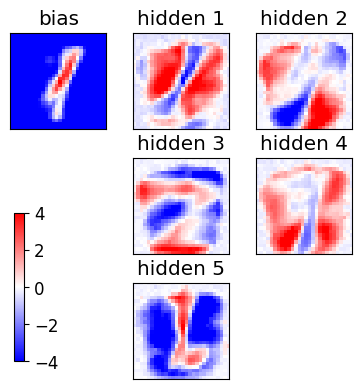

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

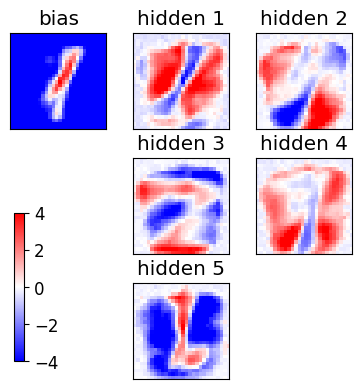

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

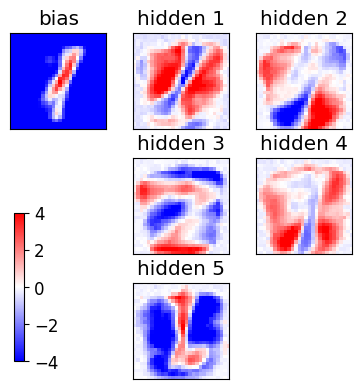

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

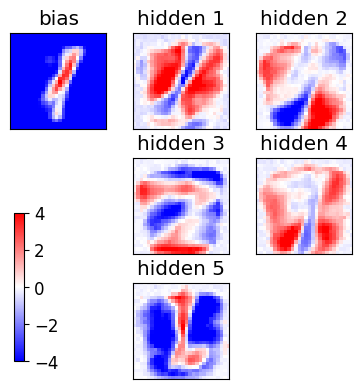

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

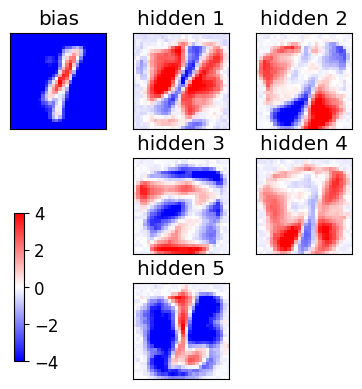

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

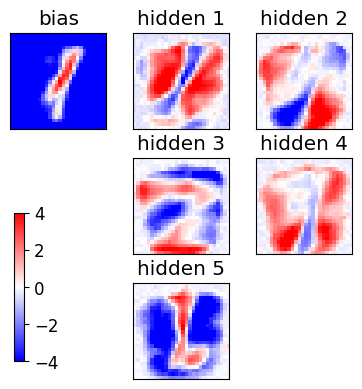

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

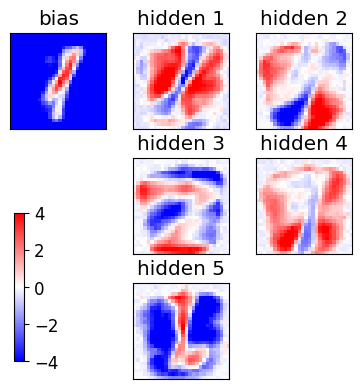

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

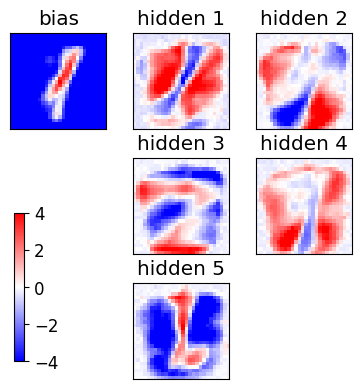

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

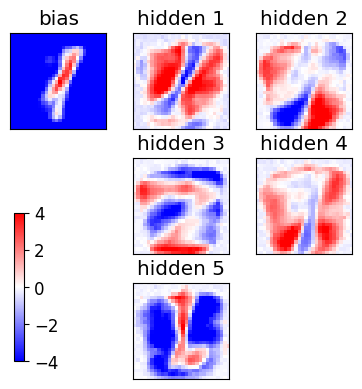

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

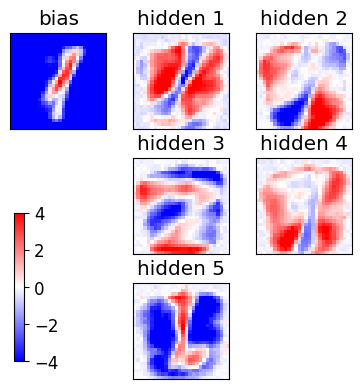

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  

<Figure size 640x480 with 0 Axes>

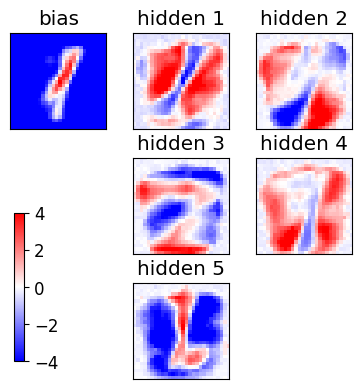

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

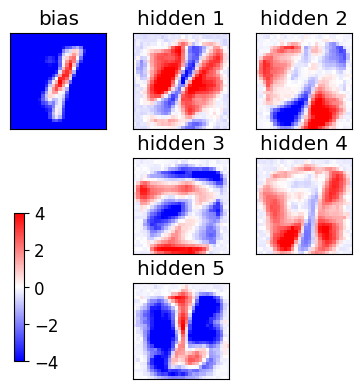

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

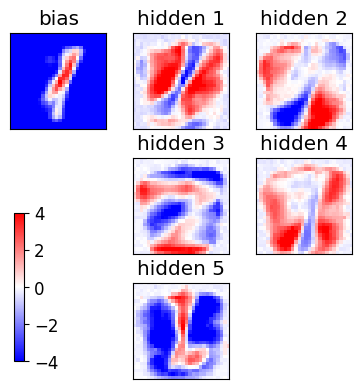

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

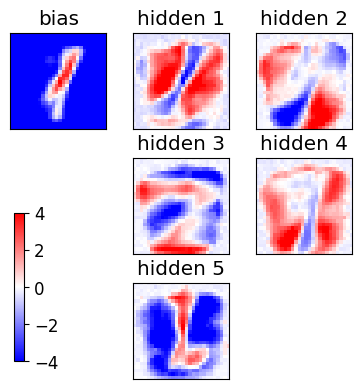

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

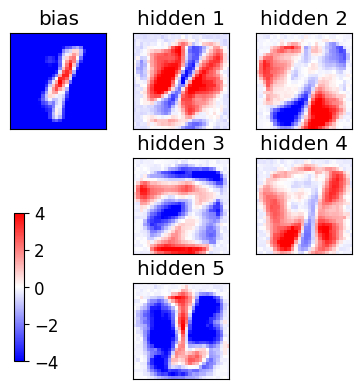

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

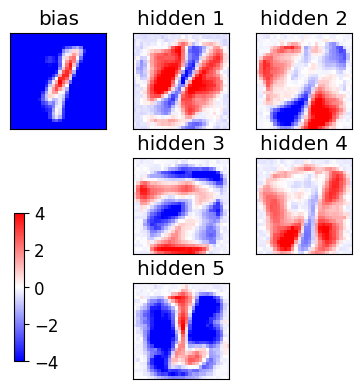

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

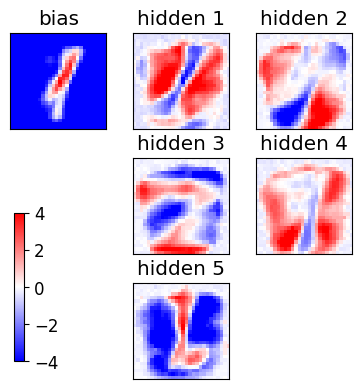

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

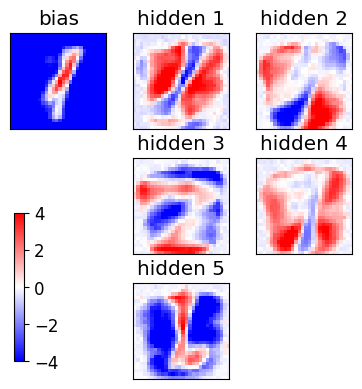

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

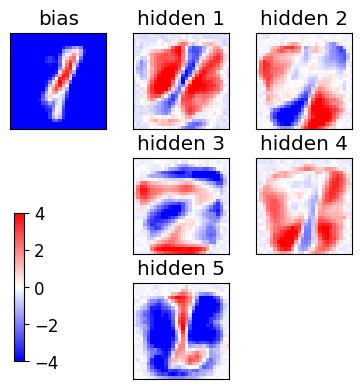

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

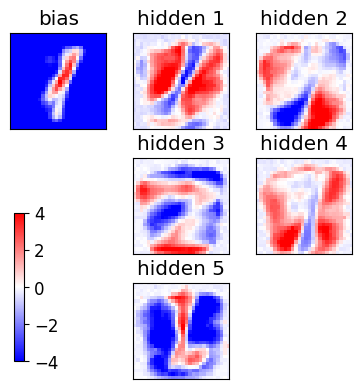

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

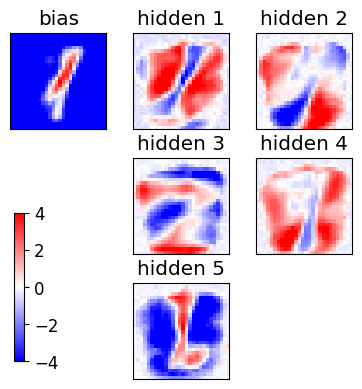

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

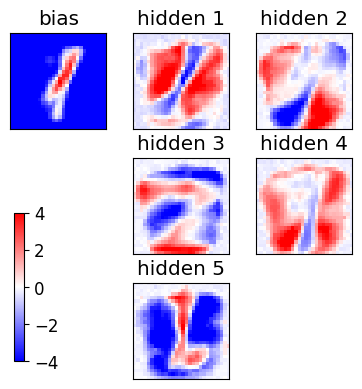

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

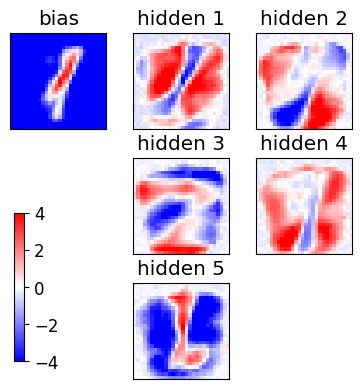

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

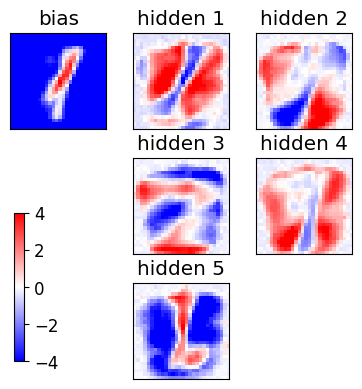

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

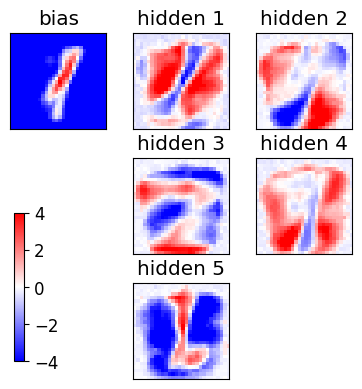

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

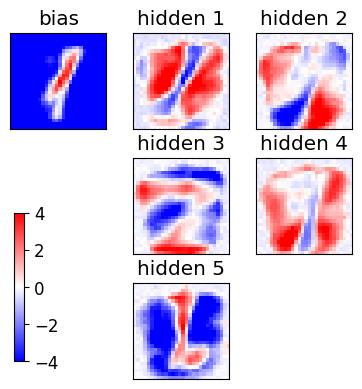

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

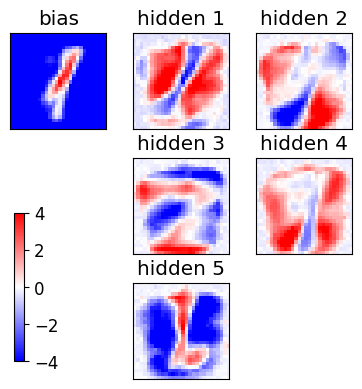

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

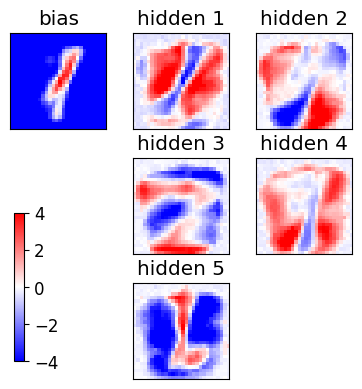

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

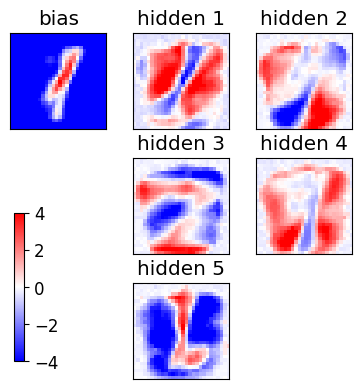

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

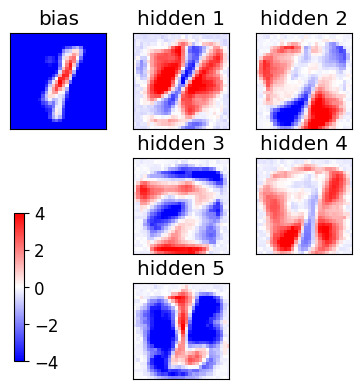

END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

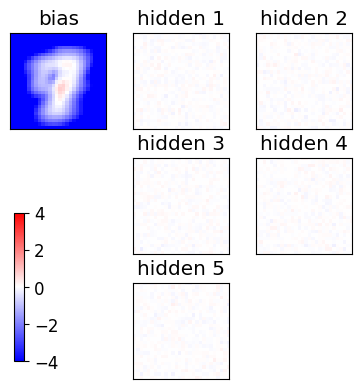

Starting the training
[20914 21166 12757  7459  1948  3950 15501 10401  3826 19217]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[19248  1389 12409 21545  7653   734  2184 17421  7675 16079]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[ 3633  4982 17509  3615  6681 21048 21865  7204  8197 18383]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[18149  1111  1326   641   611  7318  9996 17939 15816 16573]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= Fa

<Figure size 640x480 with 0 Axes>

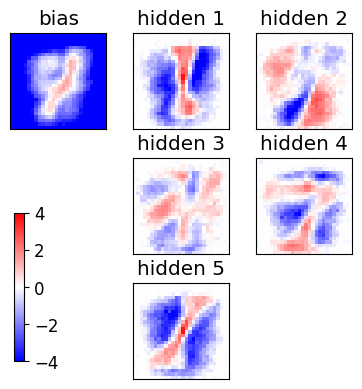

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

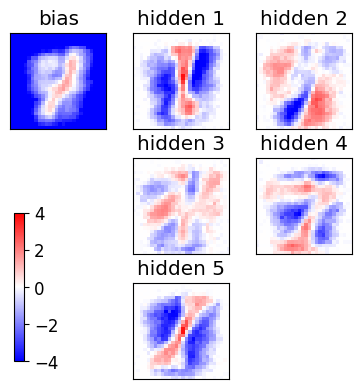

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

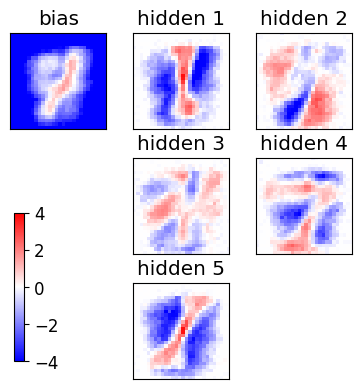

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

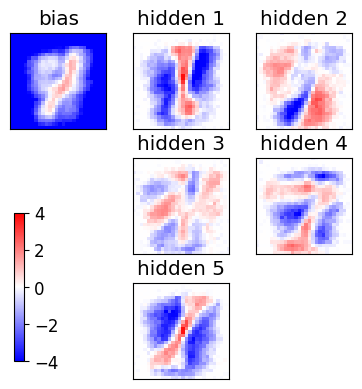

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

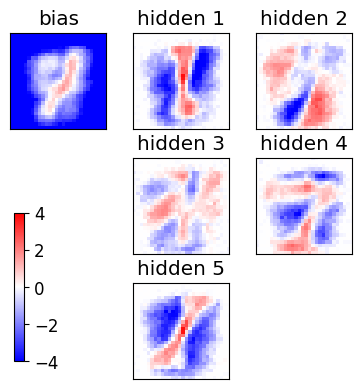

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

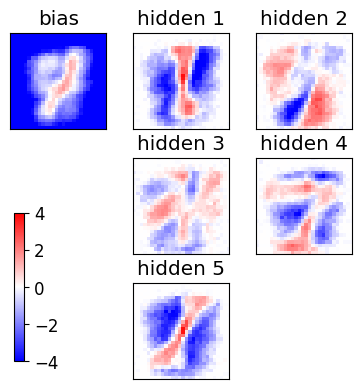

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

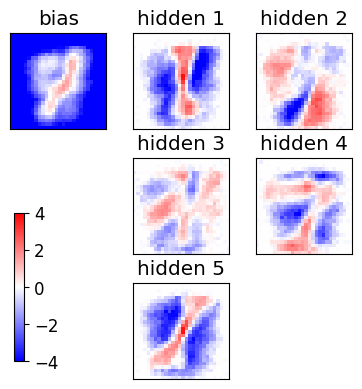

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

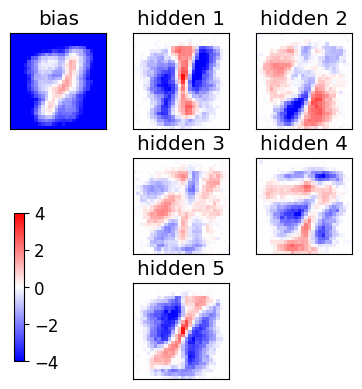

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

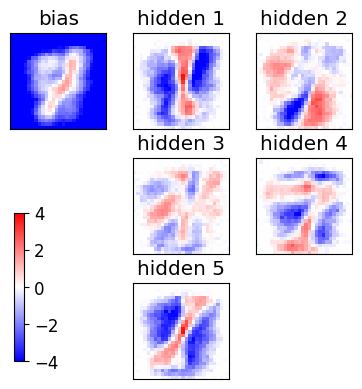

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

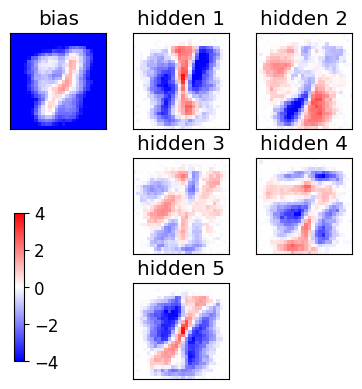

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

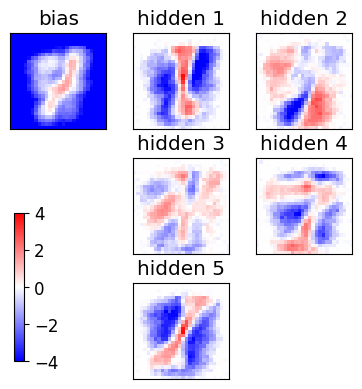

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

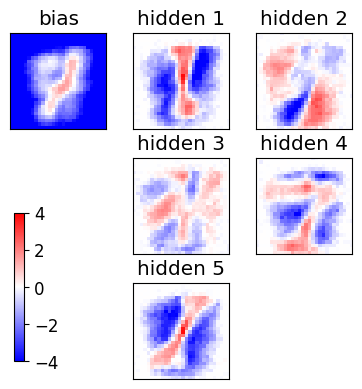

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

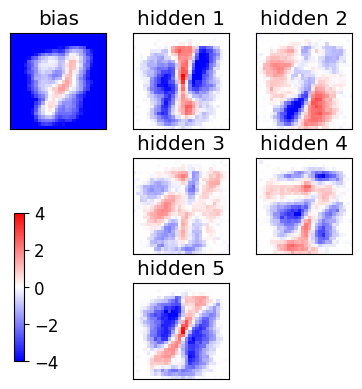

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

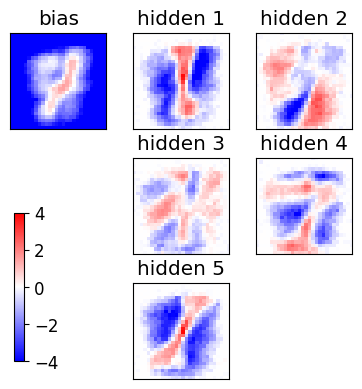

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

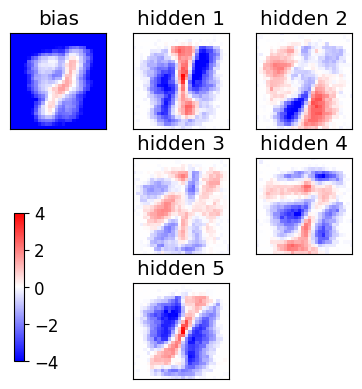

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

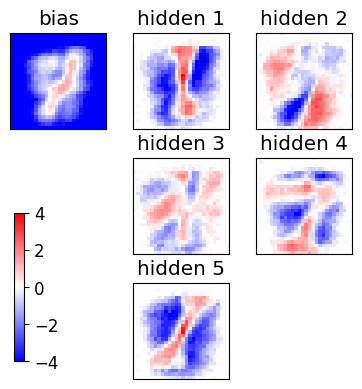

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

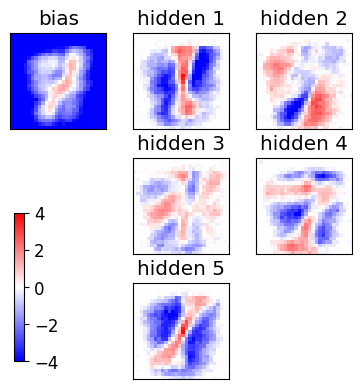

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

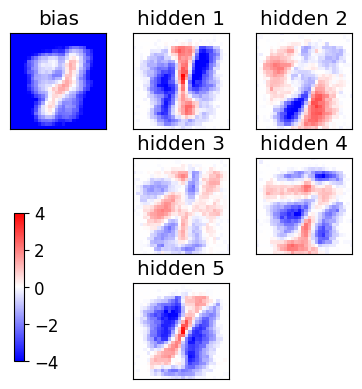

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

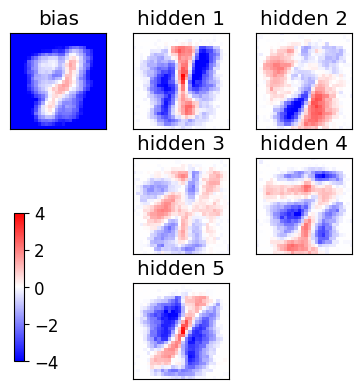

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

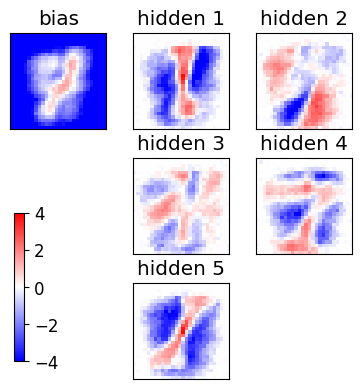

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

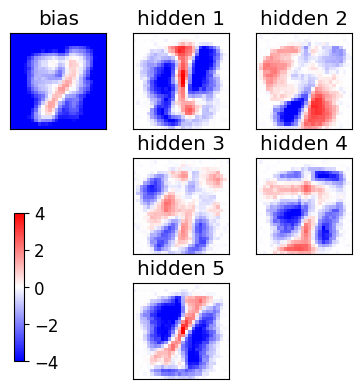

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

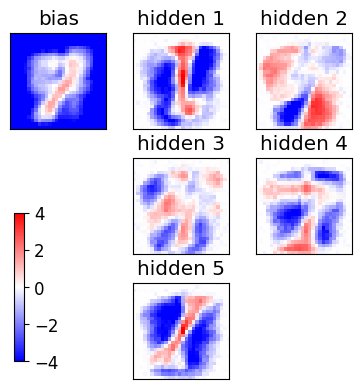

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

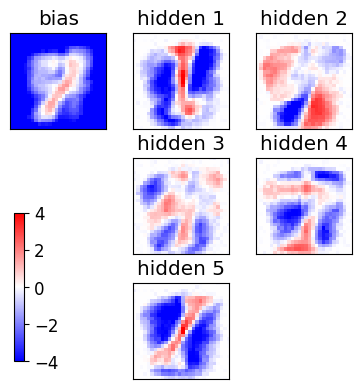

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

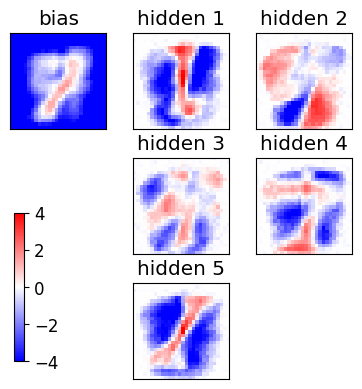

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

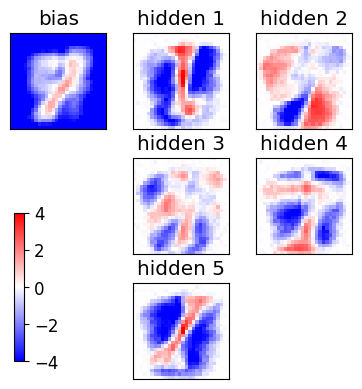

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

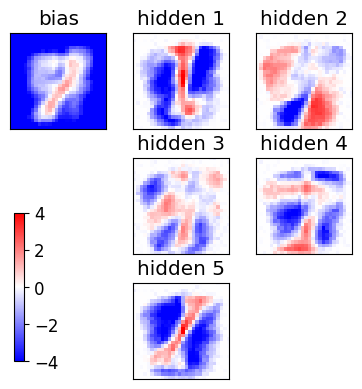

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

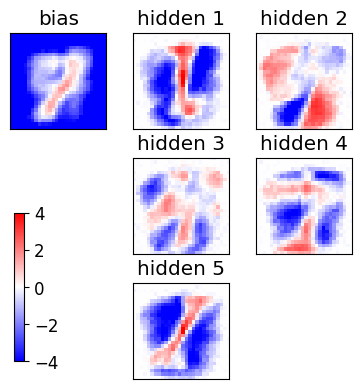

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

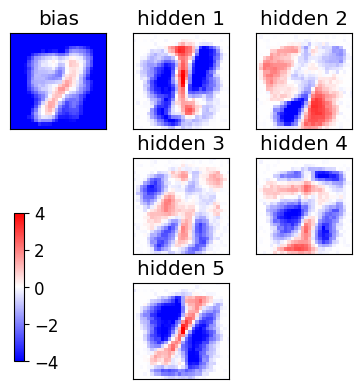

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

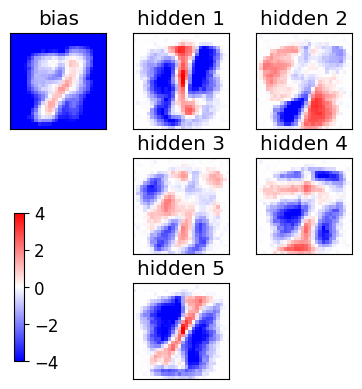

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

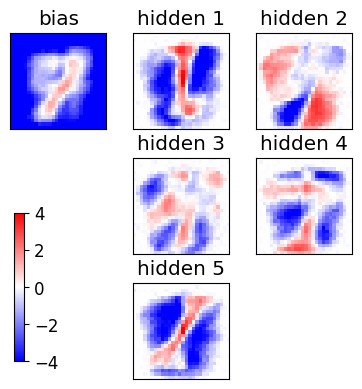

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

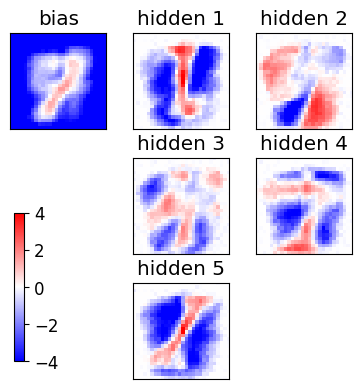

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

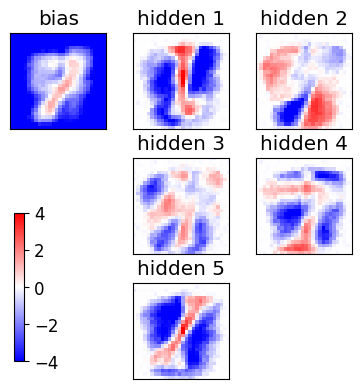

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

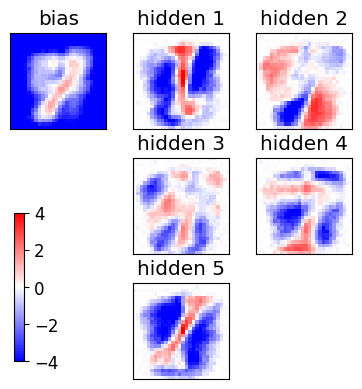

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

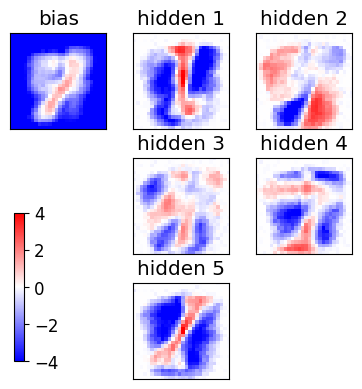

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

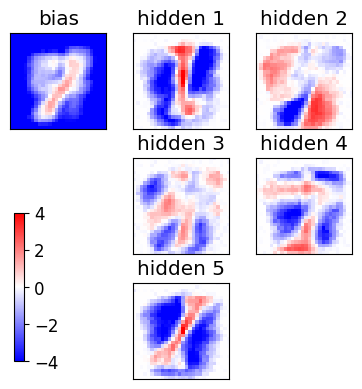

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

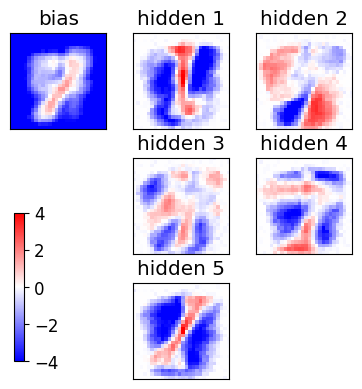

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

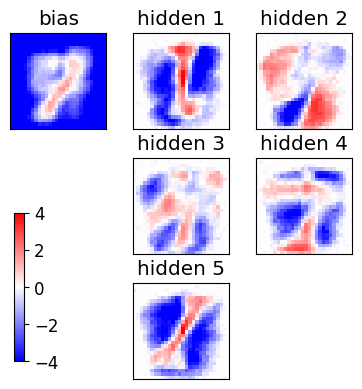

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

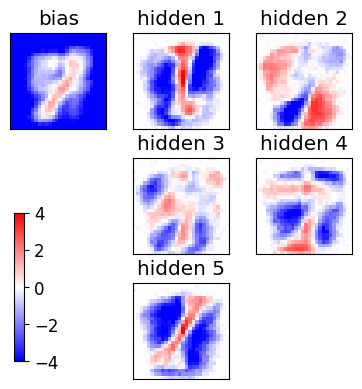

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

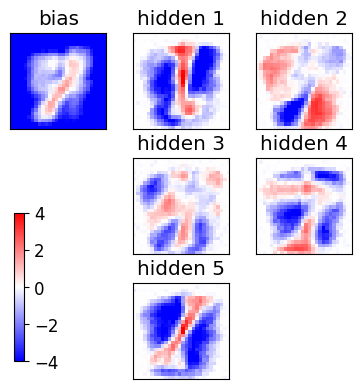

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

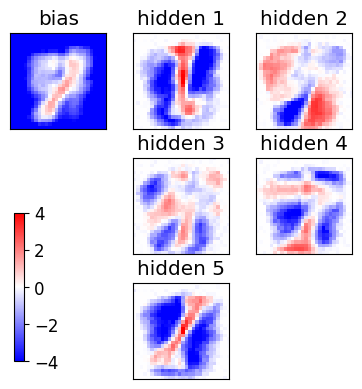

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

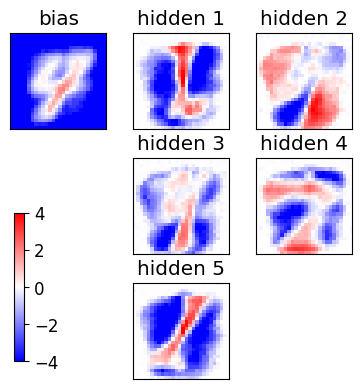

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

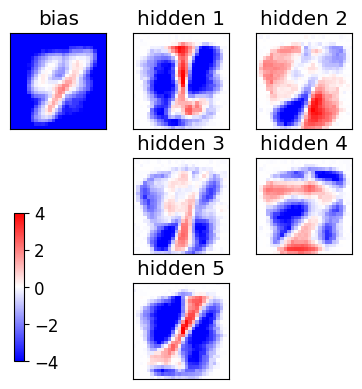

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

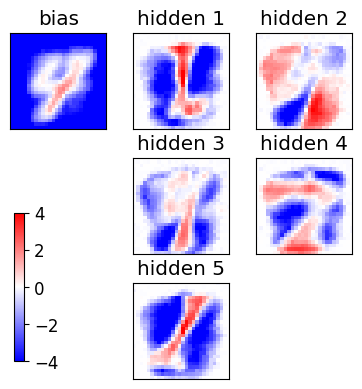

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

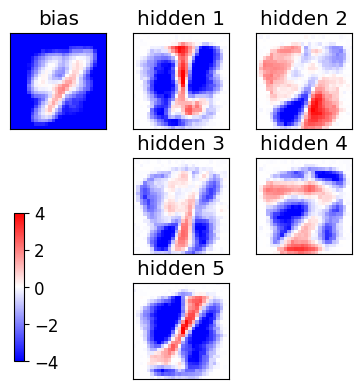

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

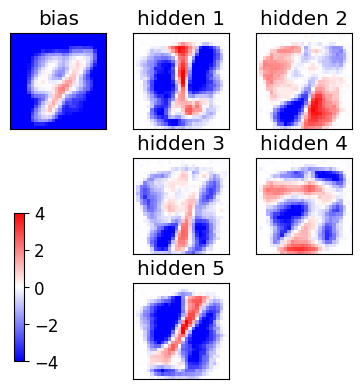

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

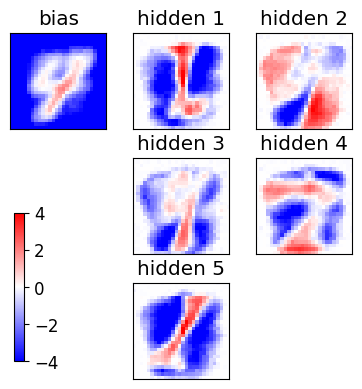

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

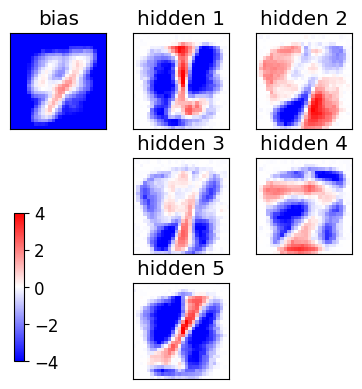

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

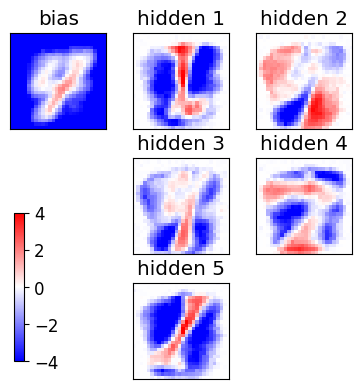

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

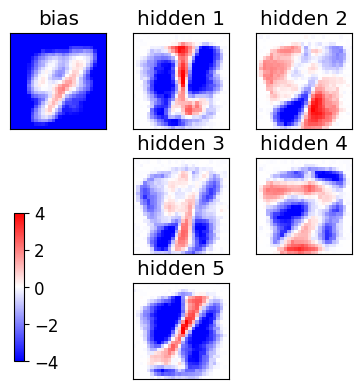

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

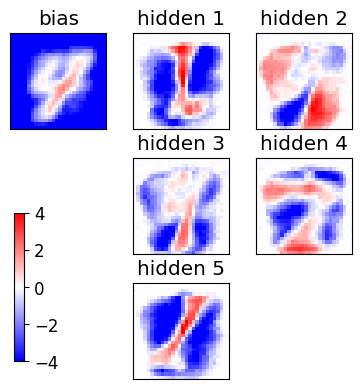

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

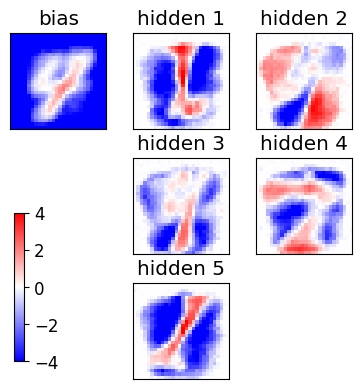

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

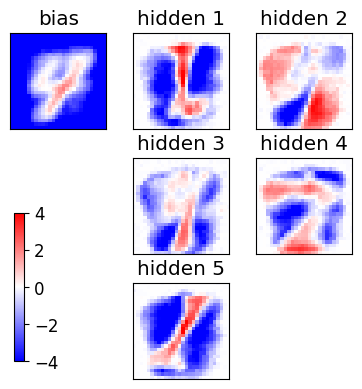

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

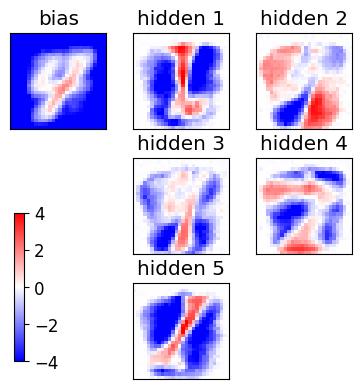

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

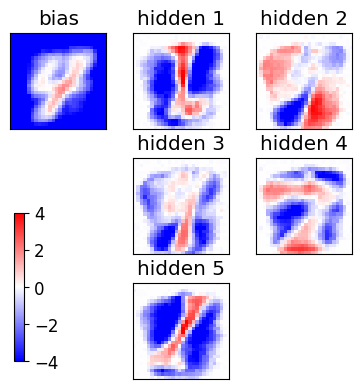

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

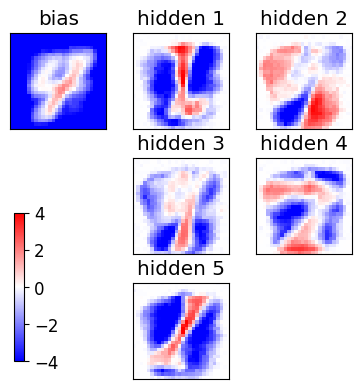

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

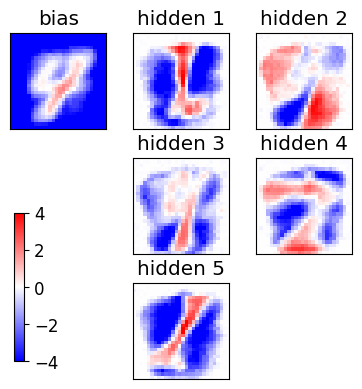

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

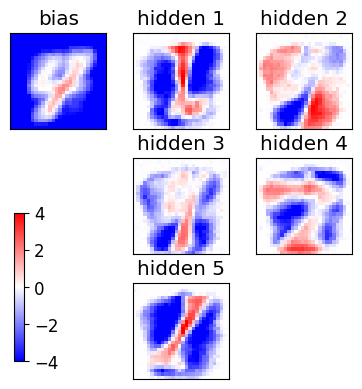

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

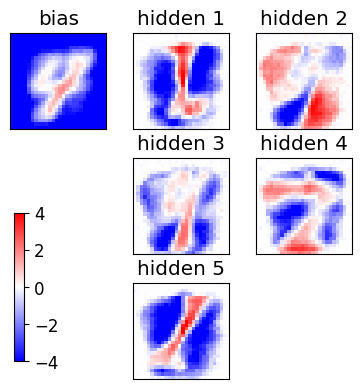

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

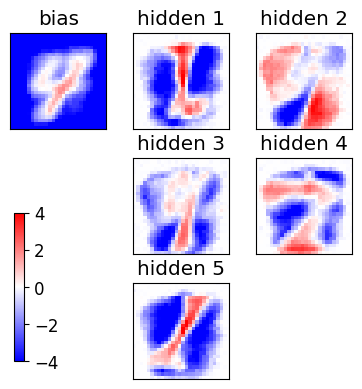

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

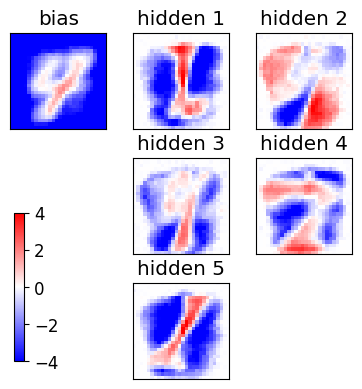

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

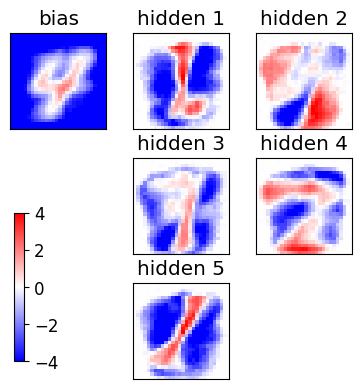

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

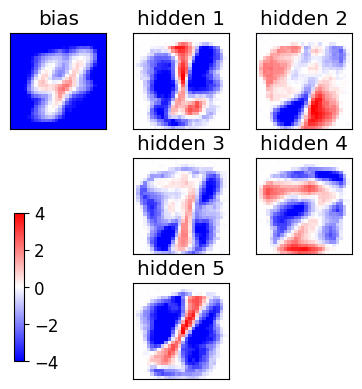

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

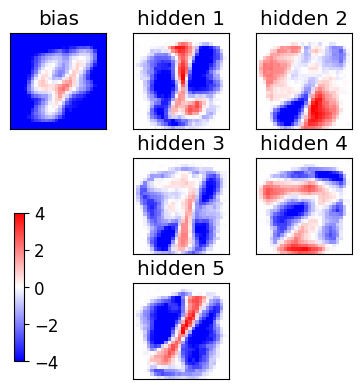

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

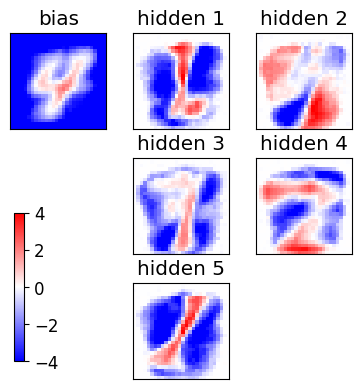

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

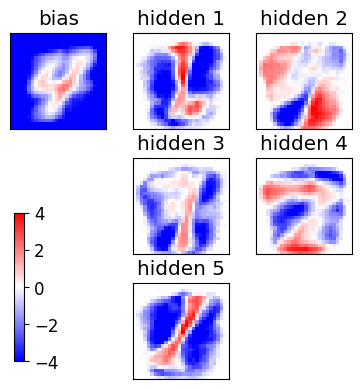

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

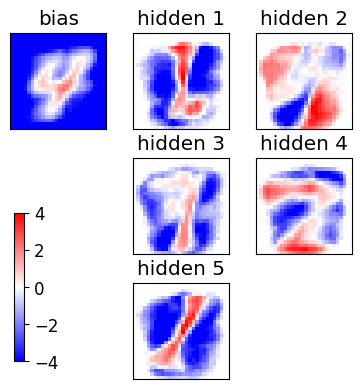

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

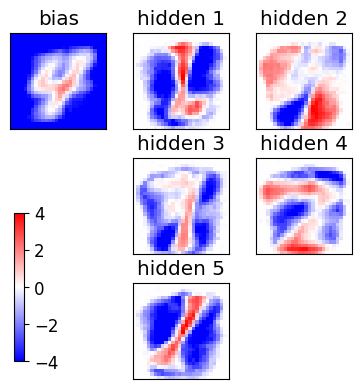

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

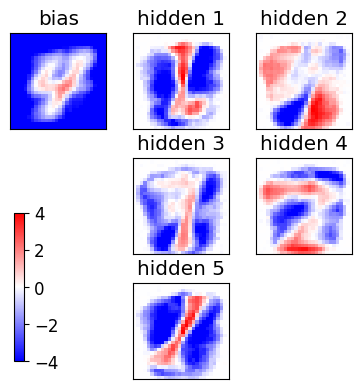

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

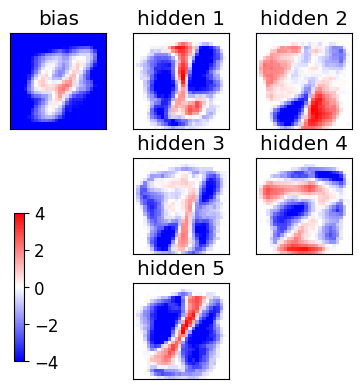

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

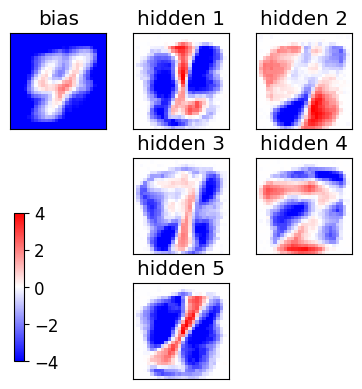

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

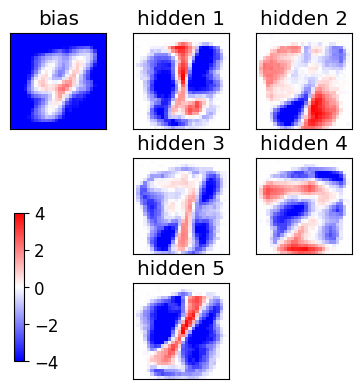

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

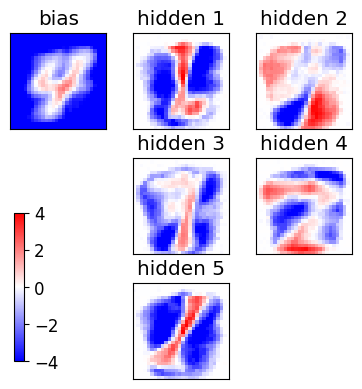

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

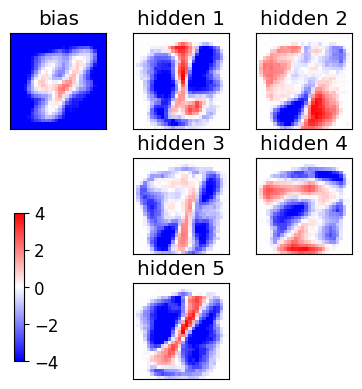

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

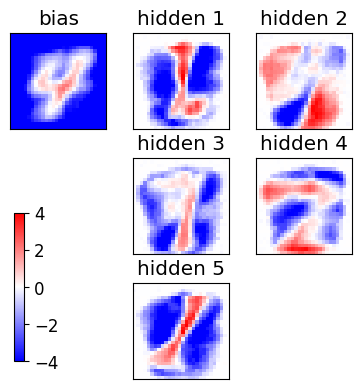

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

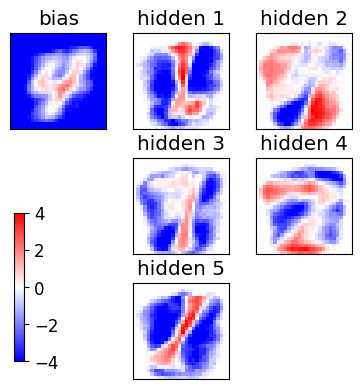

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

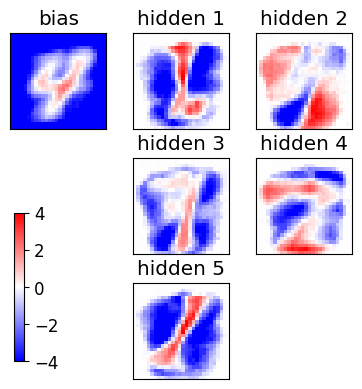

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

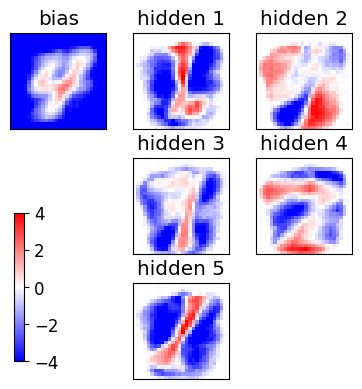

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

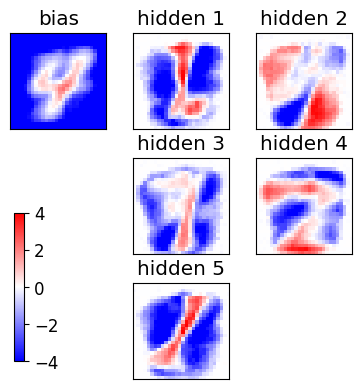

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

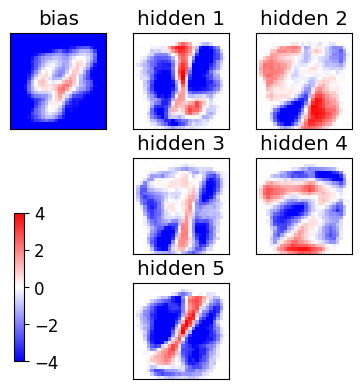

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

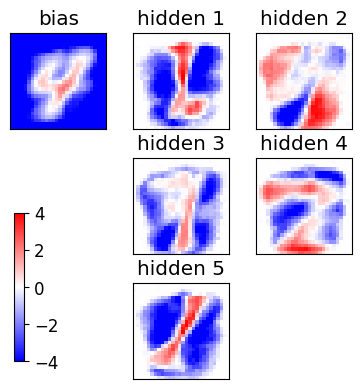

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS=

<Figure size 640x480 with 0 Axes>

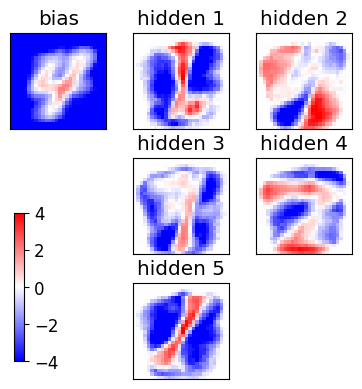

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

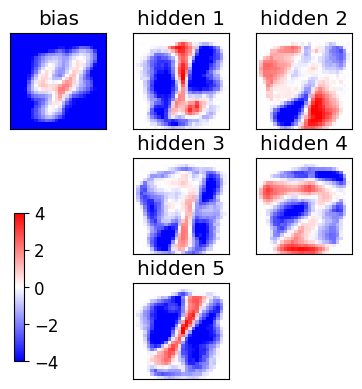

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

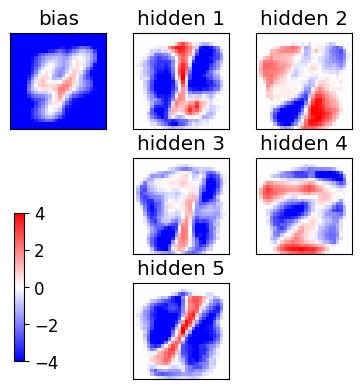

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

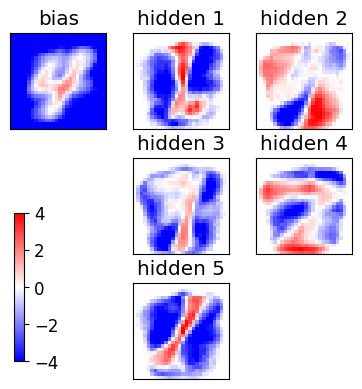

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

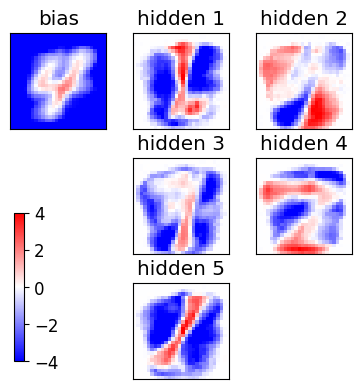

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

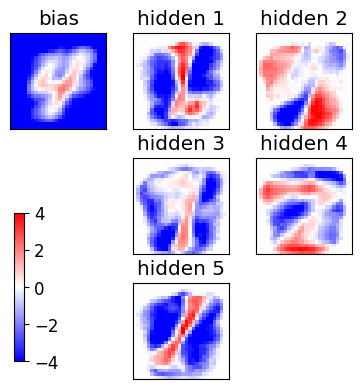

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

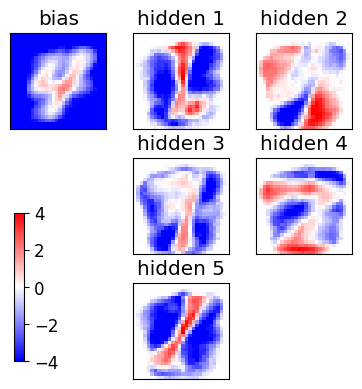

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

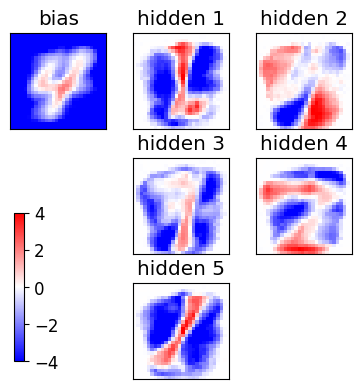

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

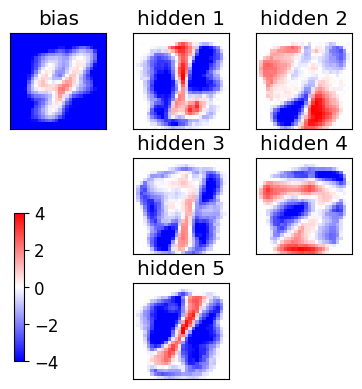

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

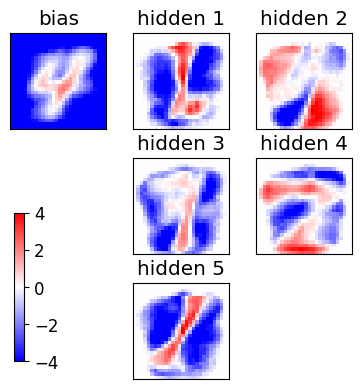

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

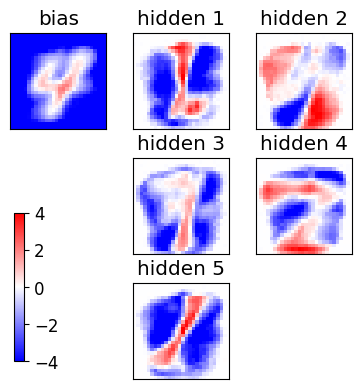

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

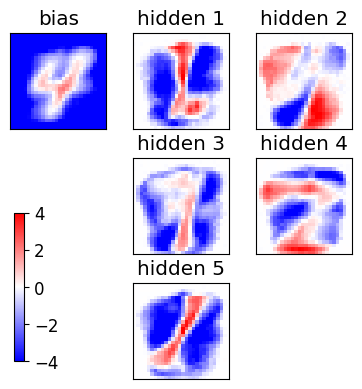

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

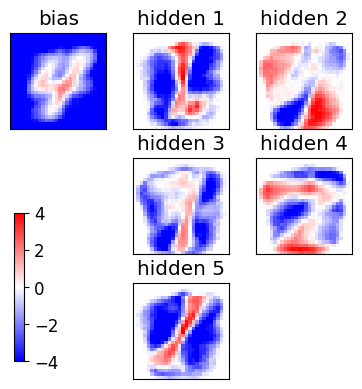

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

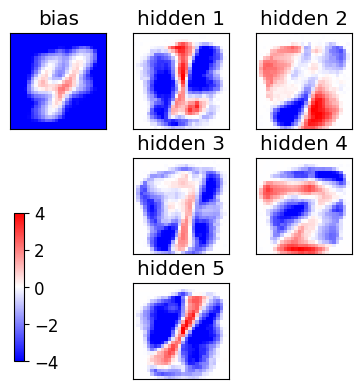

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

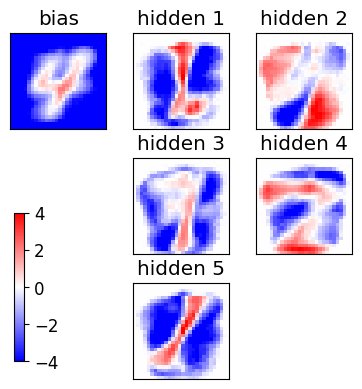

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

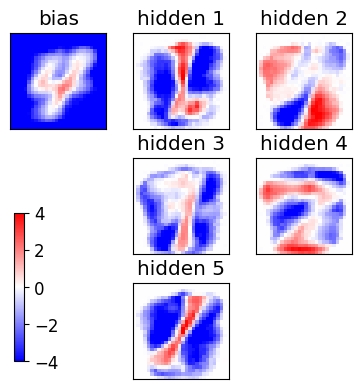

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

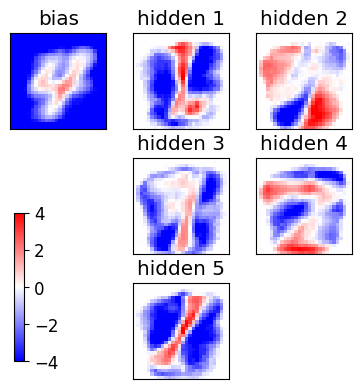

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

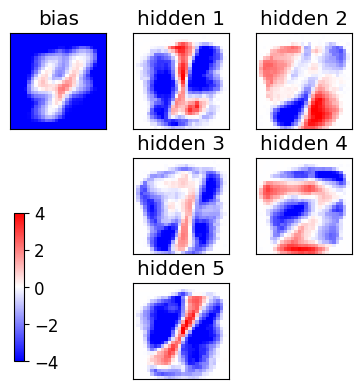

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

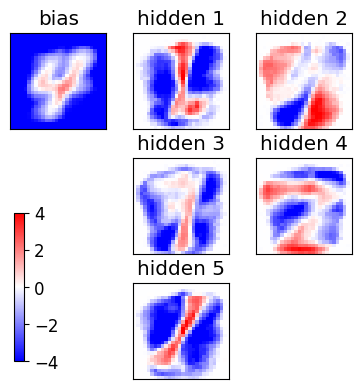

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

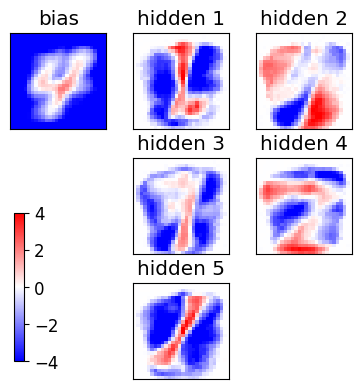

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

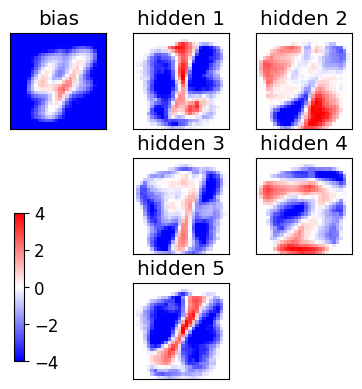

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

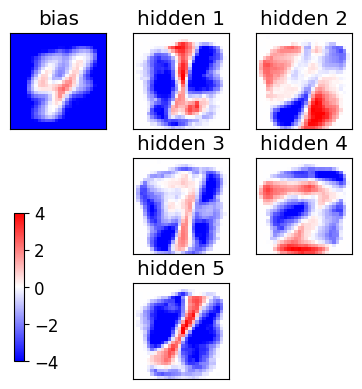

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

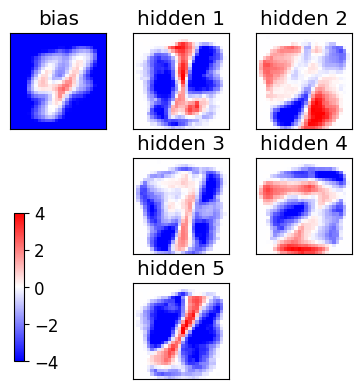

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

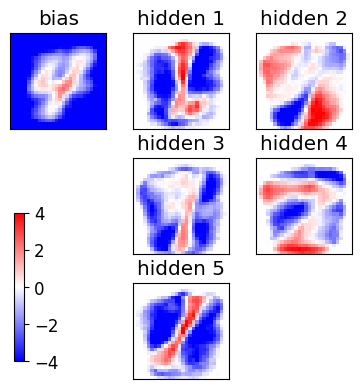

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

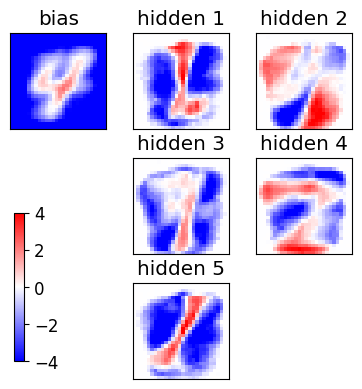

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

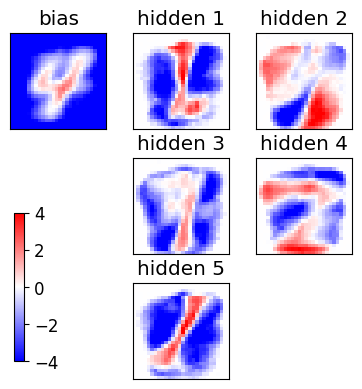

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

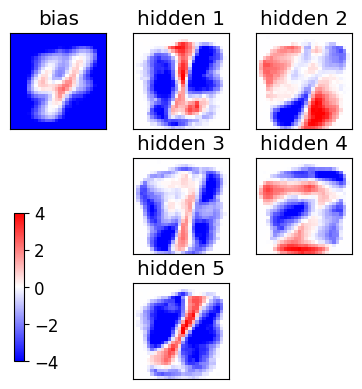

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

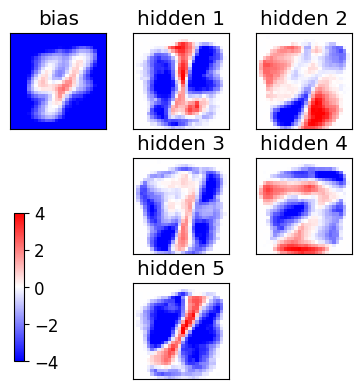

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

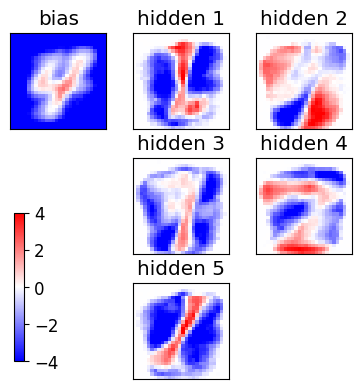

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

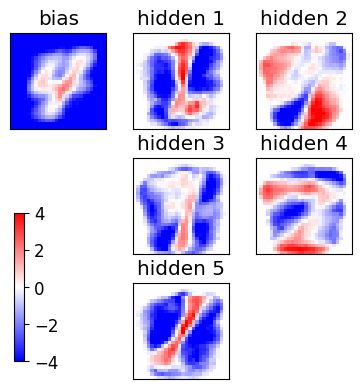

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

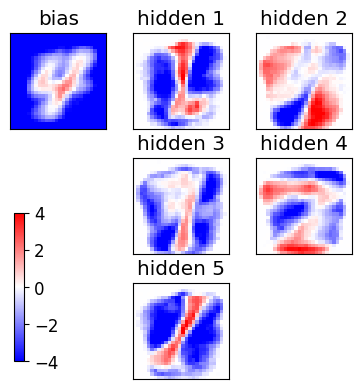

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

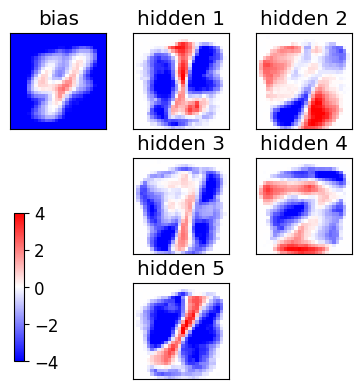

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

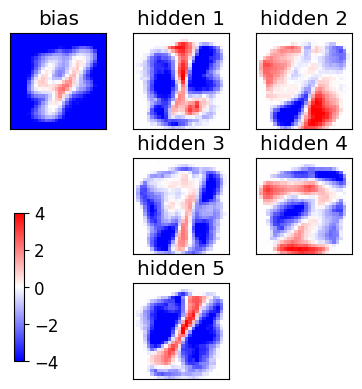

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

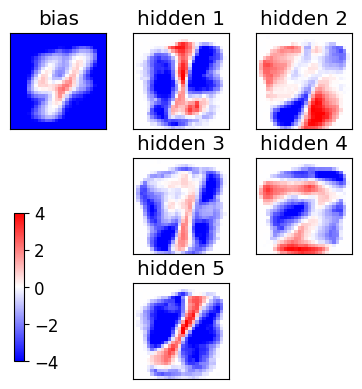

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

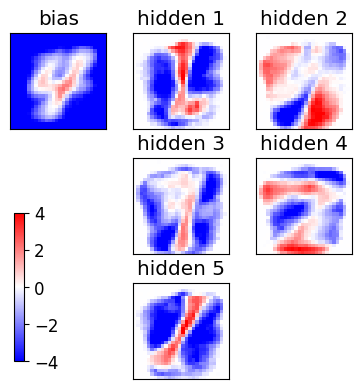

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

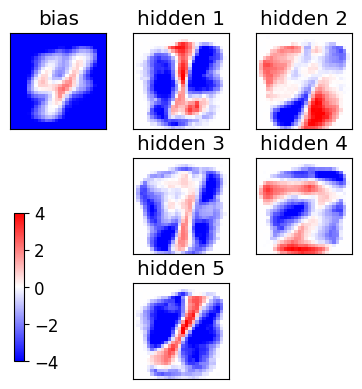

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

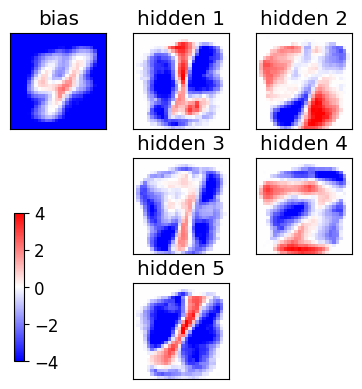

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

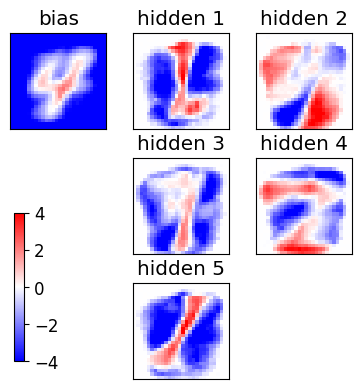

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

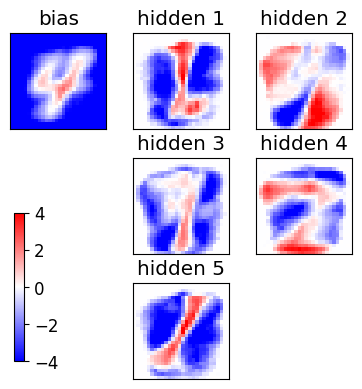

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

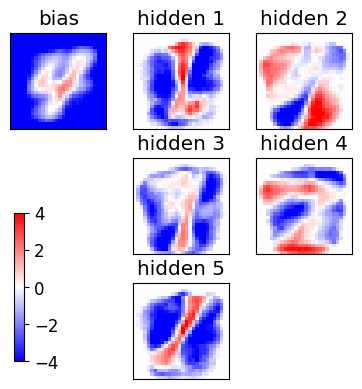

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

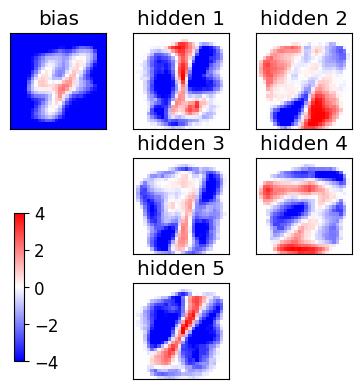

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

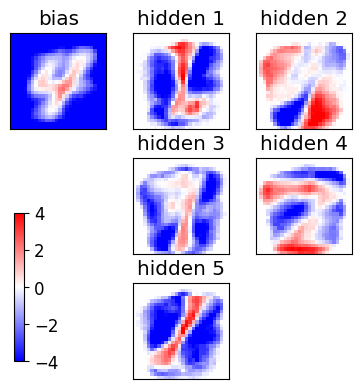

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

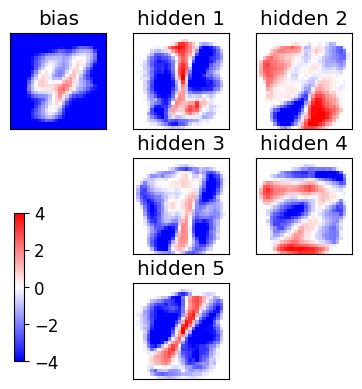

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

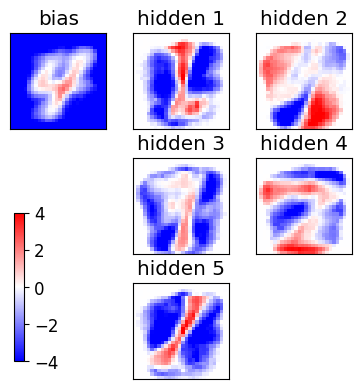

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

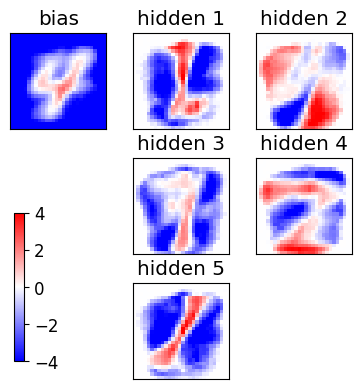

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

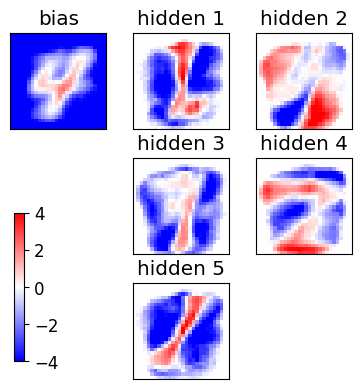

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

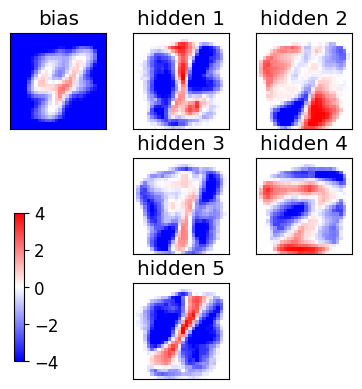

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

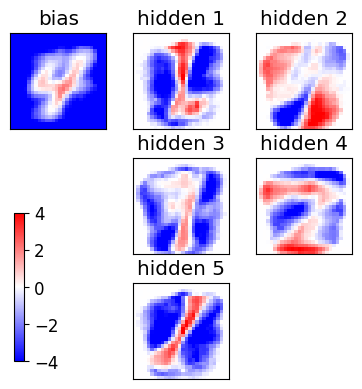

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

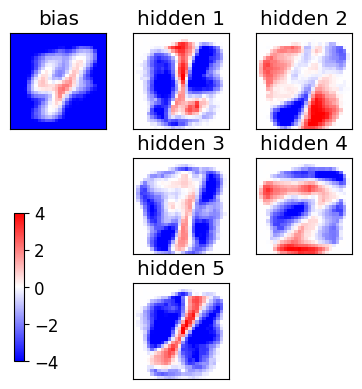

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

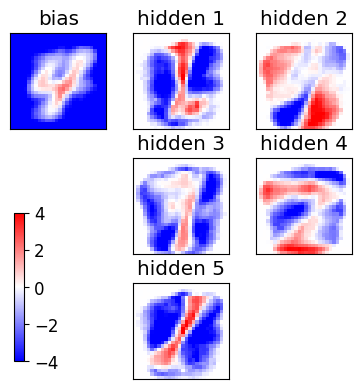

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

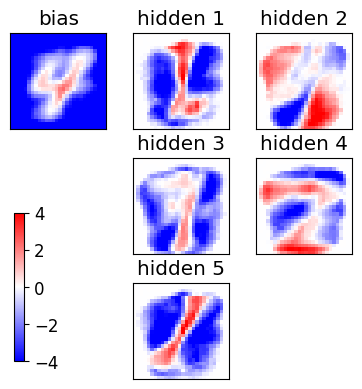

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

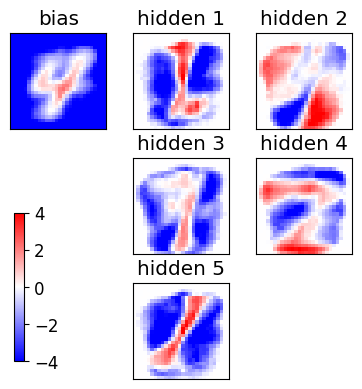

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

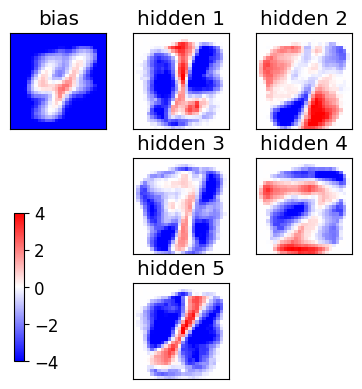

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

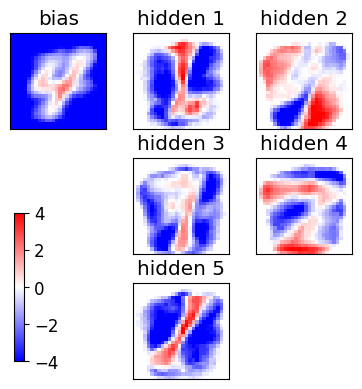

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

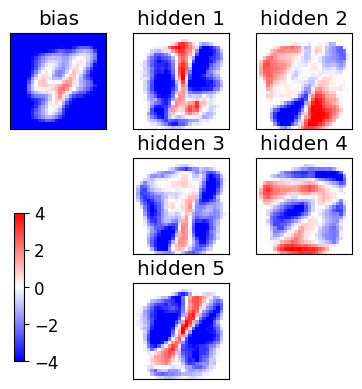

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

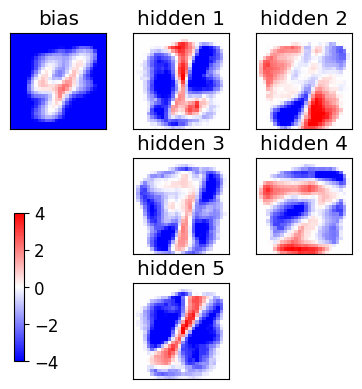

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

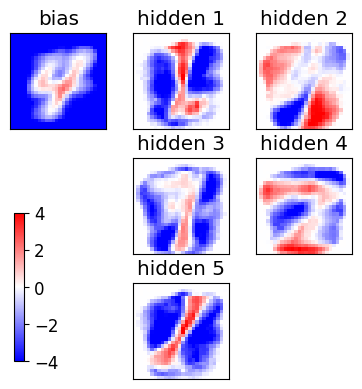

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

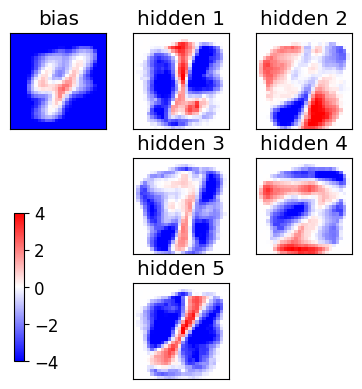

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

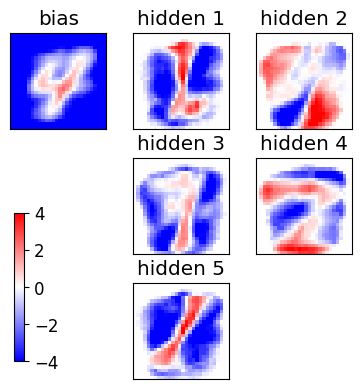

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

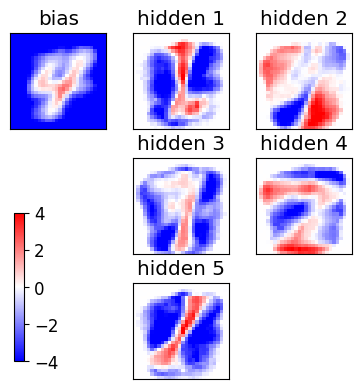

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

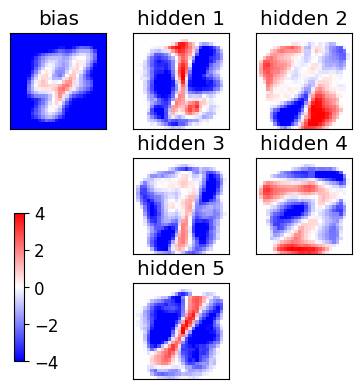

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

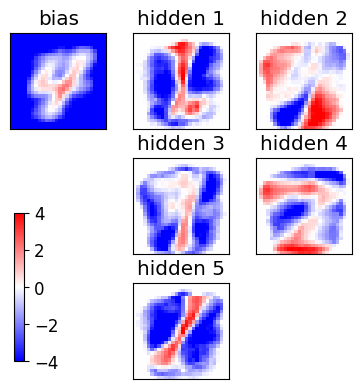

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

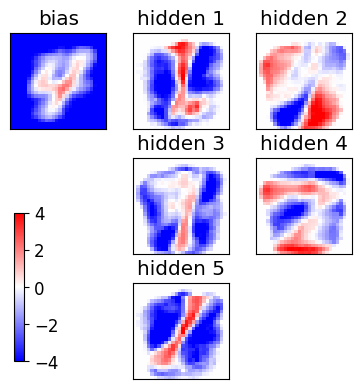

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

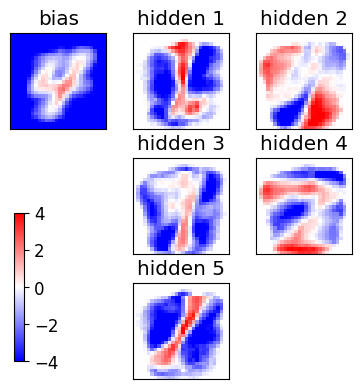

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

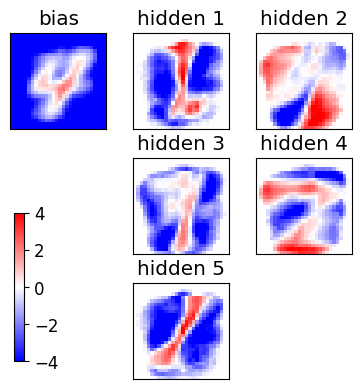

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

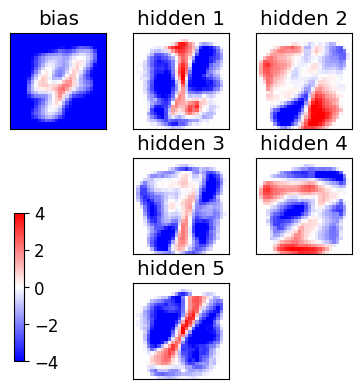

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

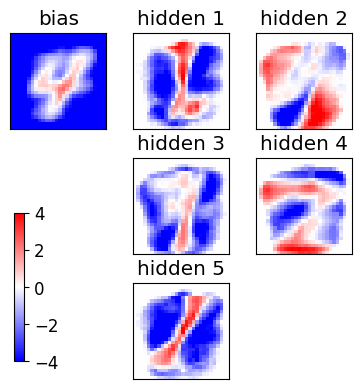

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

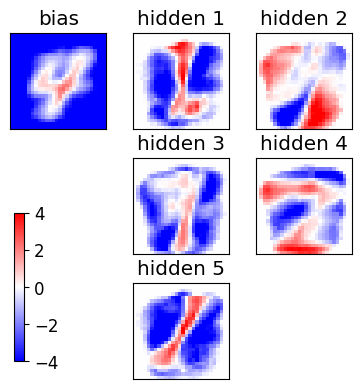

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

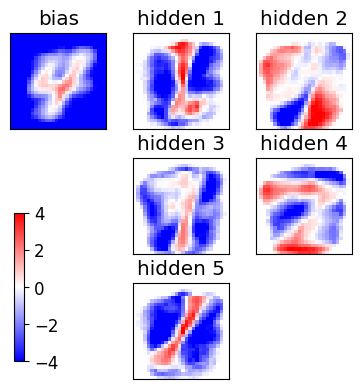

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

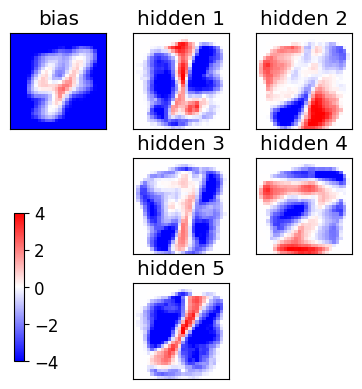

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

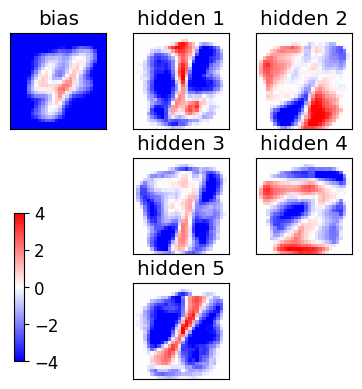

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

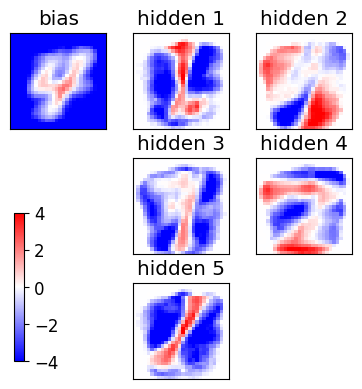

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

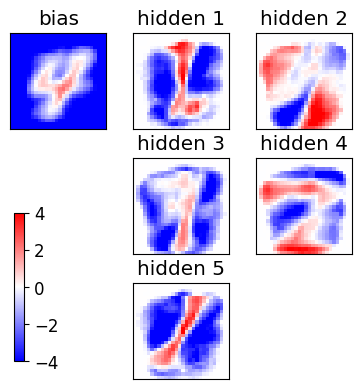

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

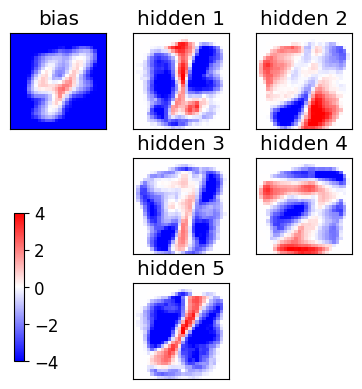

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

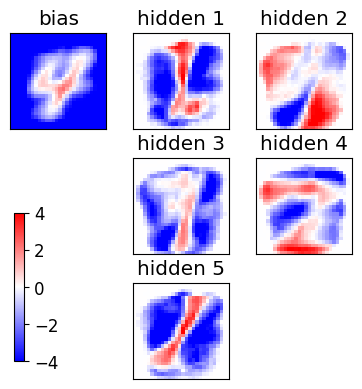

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

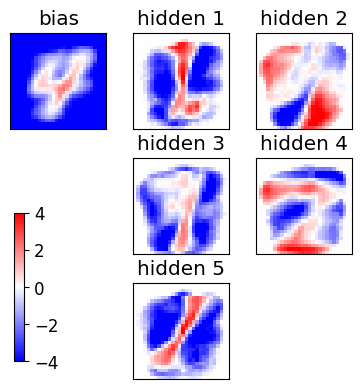

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

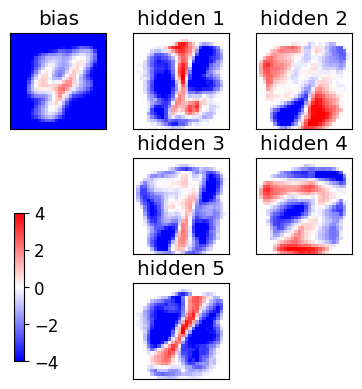

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

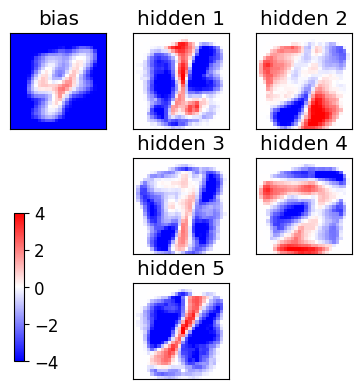

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

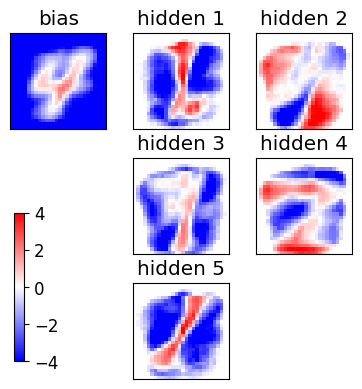

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

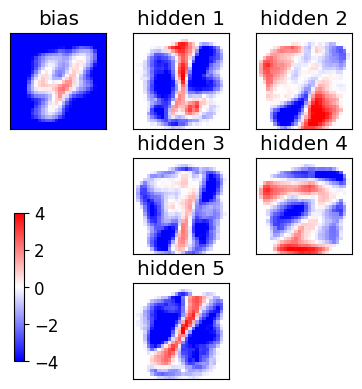

END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

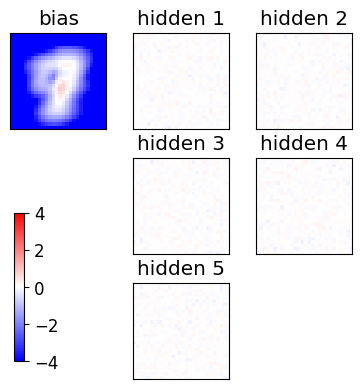

Starting the training
[10161  7791 15918 19634 21735 20477  9798  4611 20222 14461]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[19882  3864 20832  9534 10944 13062  1167  5272  4228  2228]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[ 7415  1109  6379 12680  1364  8453 15188  5952 12623 14858]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[19237  4203 11276  9762 14483 17045   310 15518 15471  6644]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

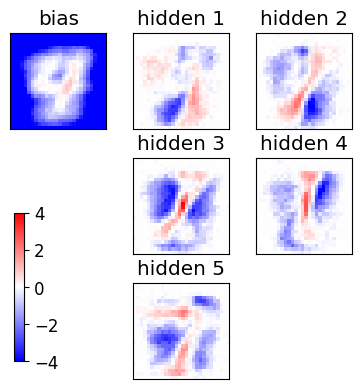

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

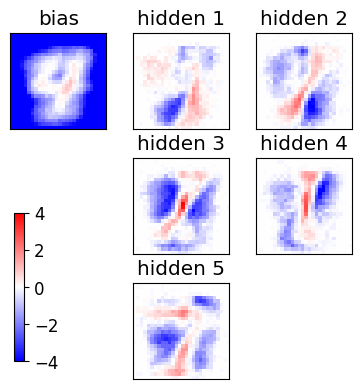

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

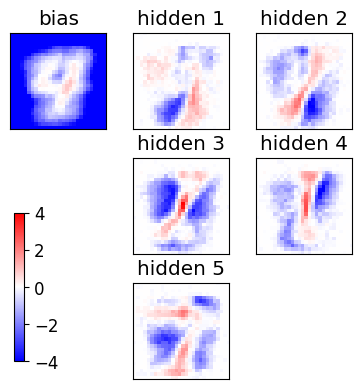

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

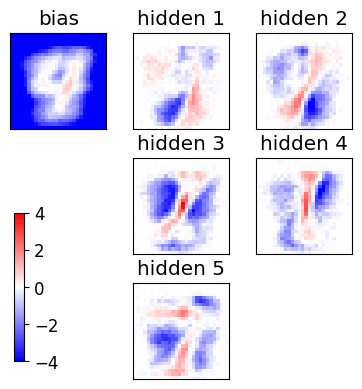

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

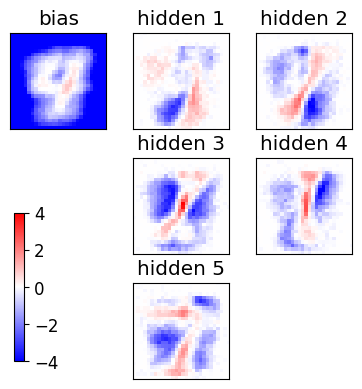

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

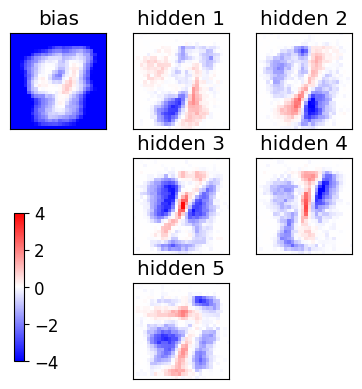

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

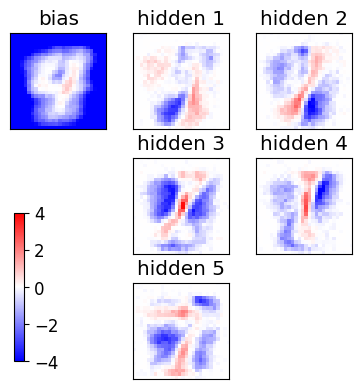

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

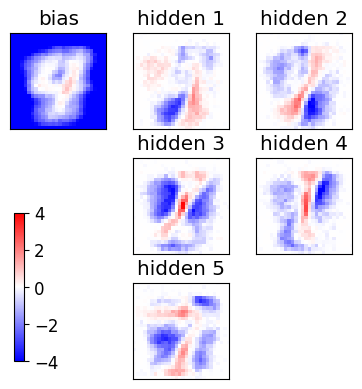

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

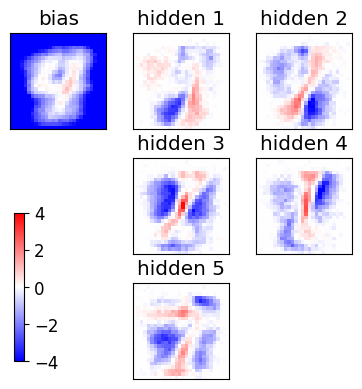

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

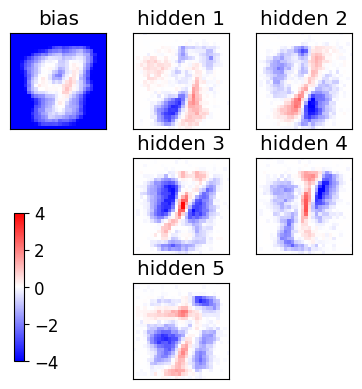

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

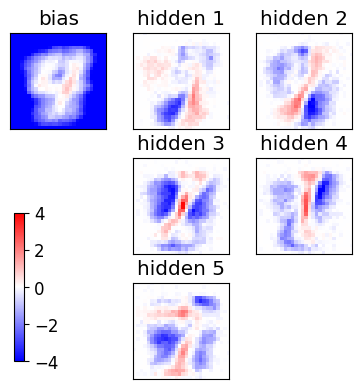

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

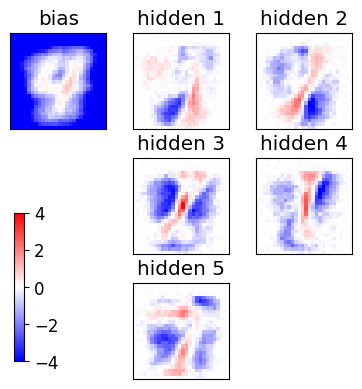

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

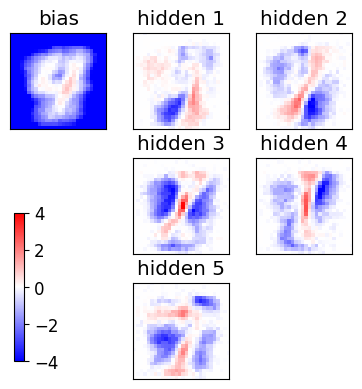

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

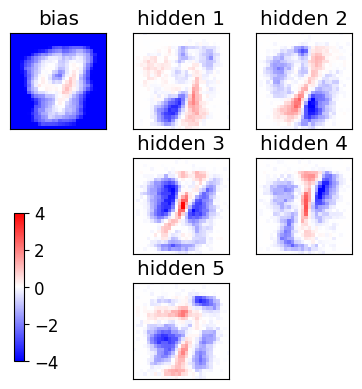

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

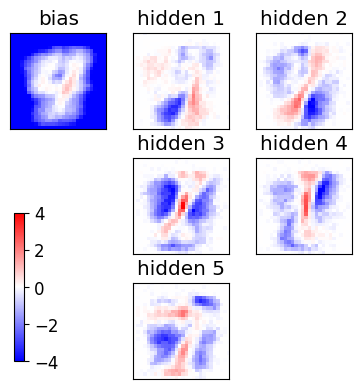

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

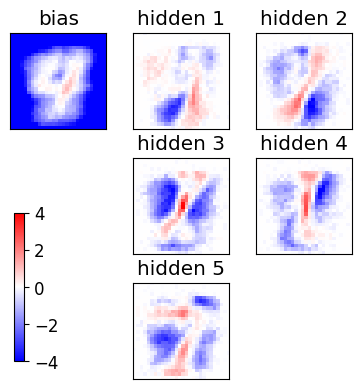

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

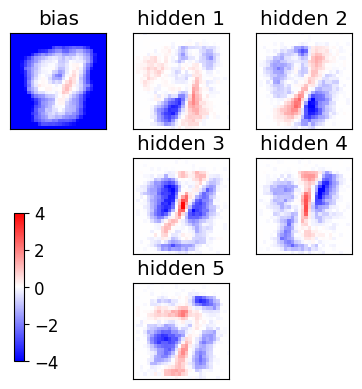

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

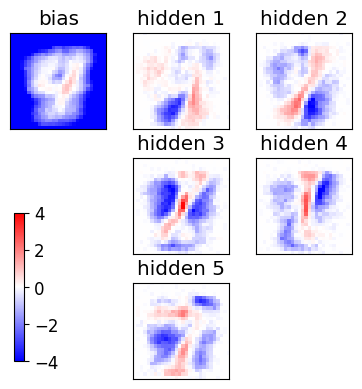

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

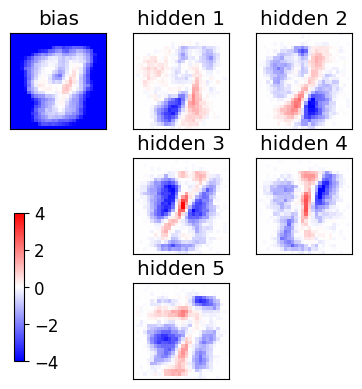

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

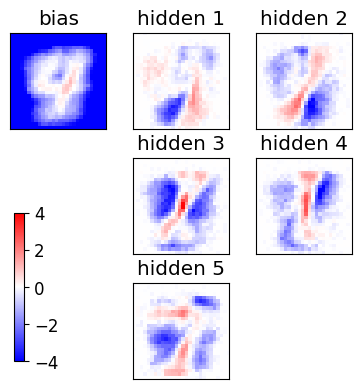

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

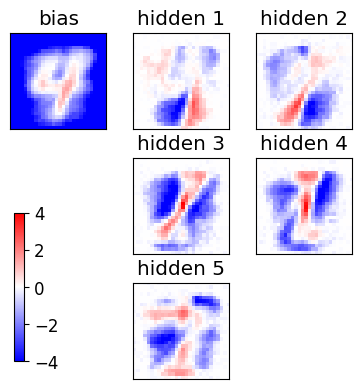

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

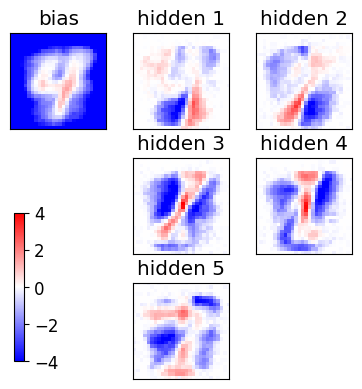

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

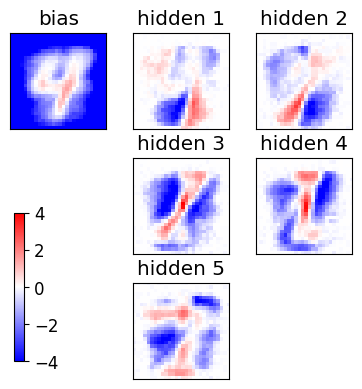

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

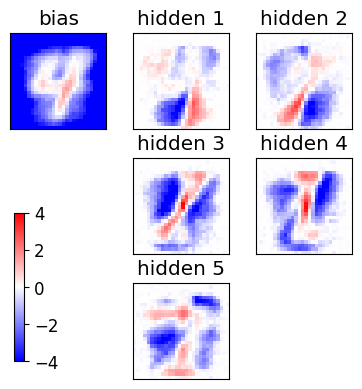

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

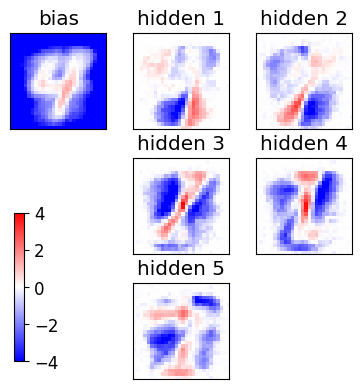

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

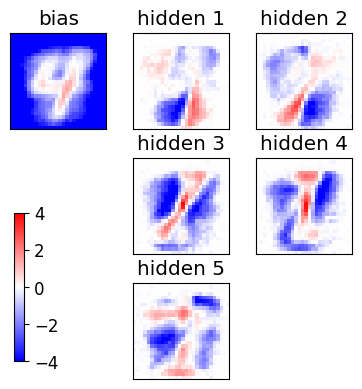

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

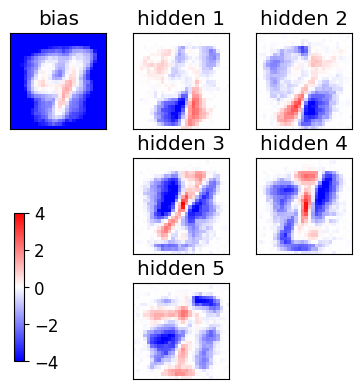

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

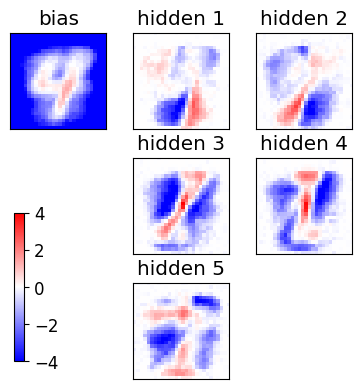

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

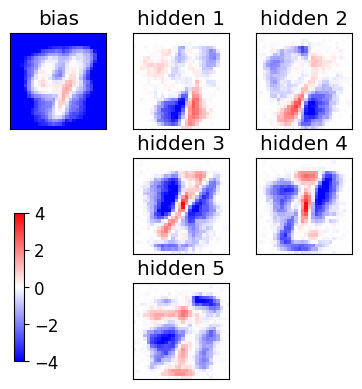

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

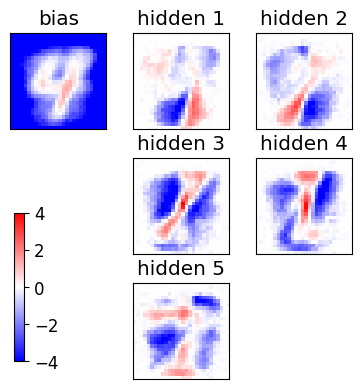

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

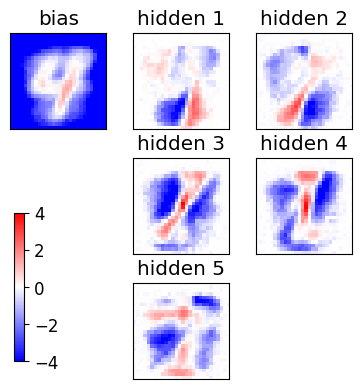

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

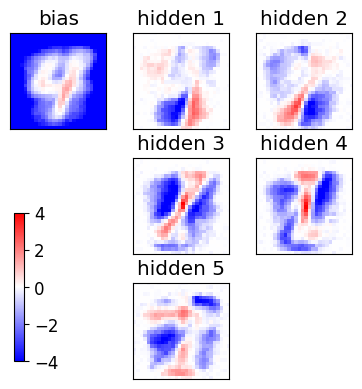

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

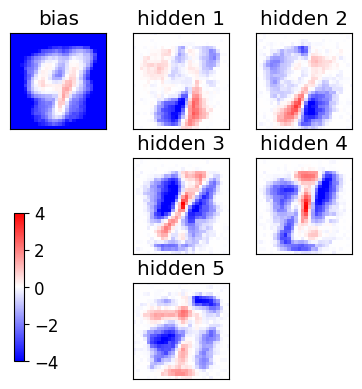

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

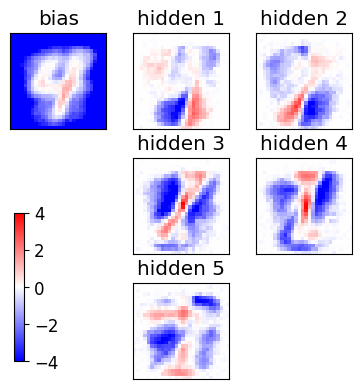

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

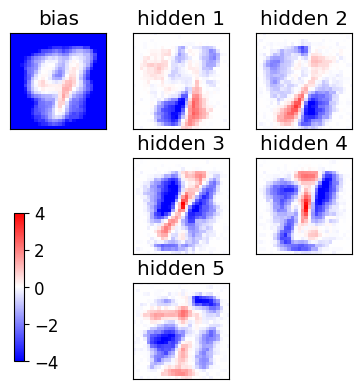

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

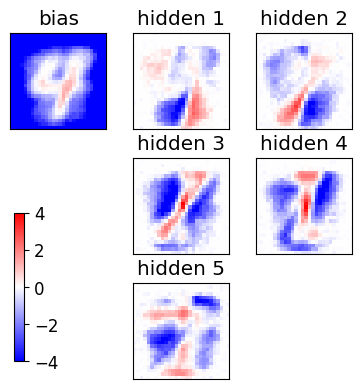

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

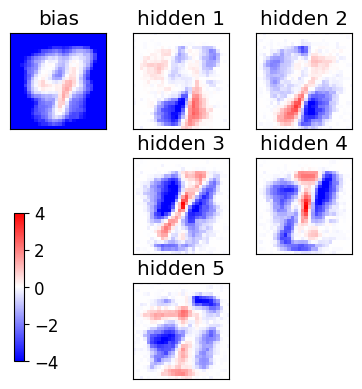

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

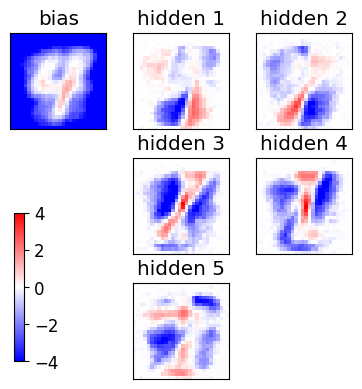

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

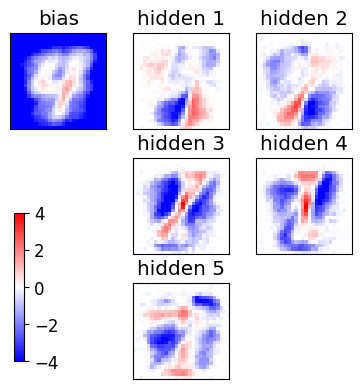

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

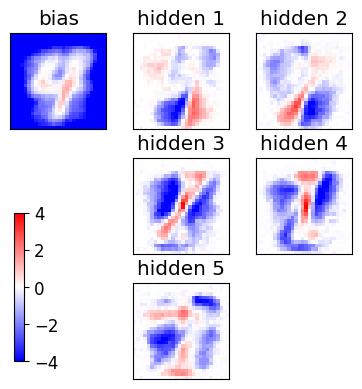

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

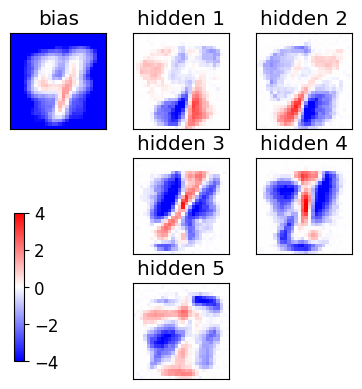

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

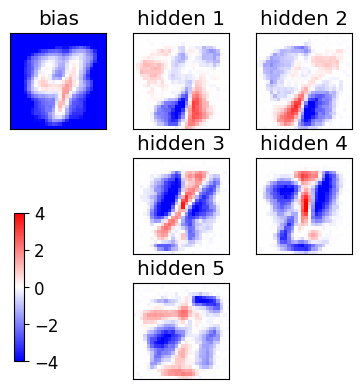

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

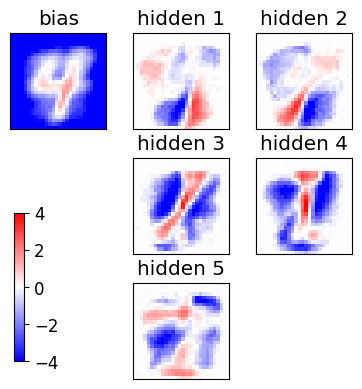

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

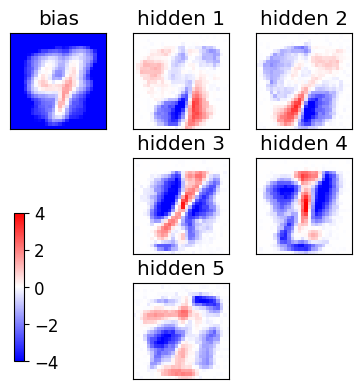

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

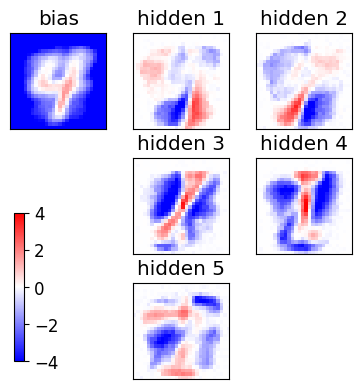

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

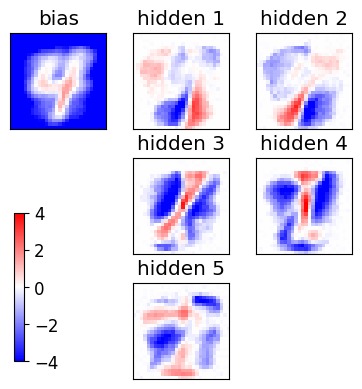

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

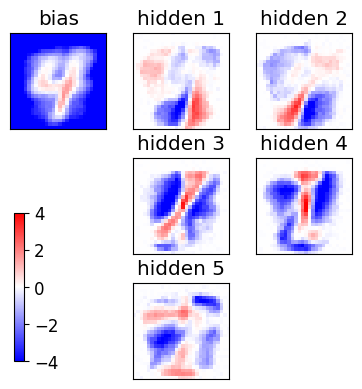

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

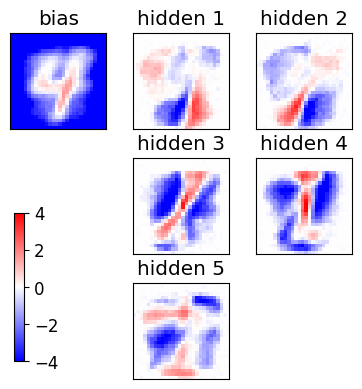

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

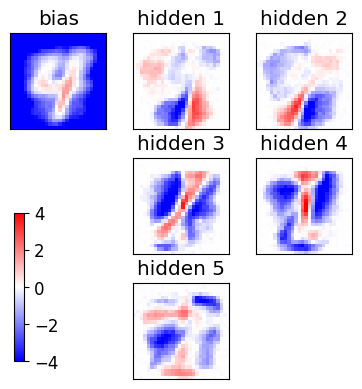

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

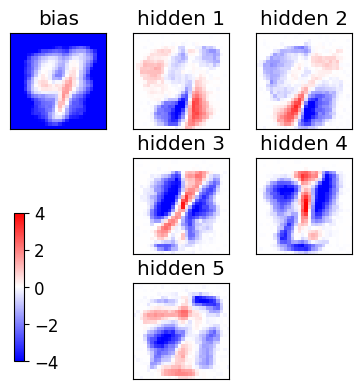

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

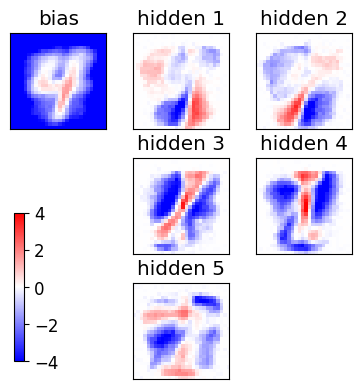

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

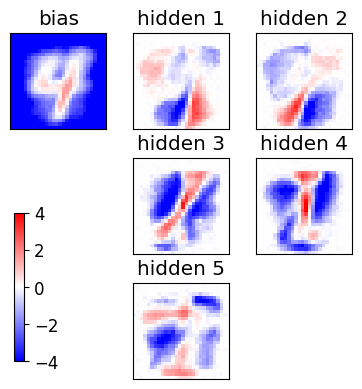

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

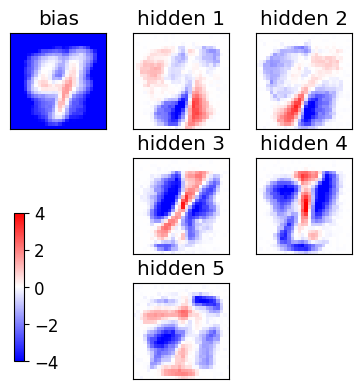

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

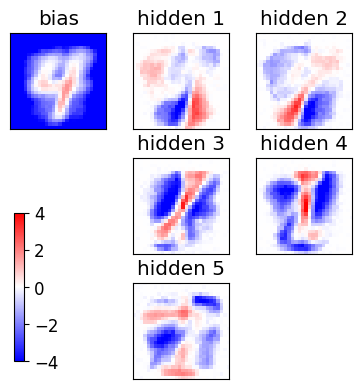

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

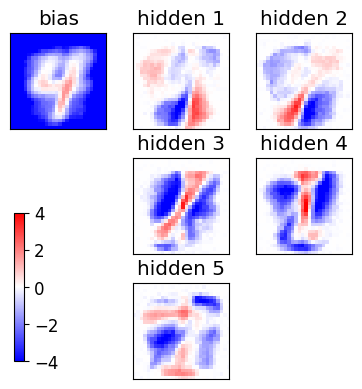

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

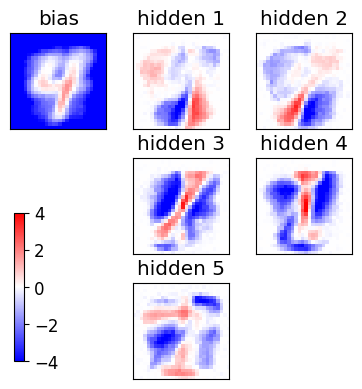

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

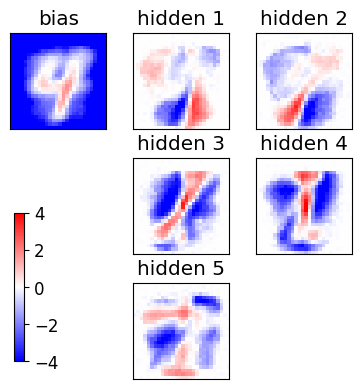

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

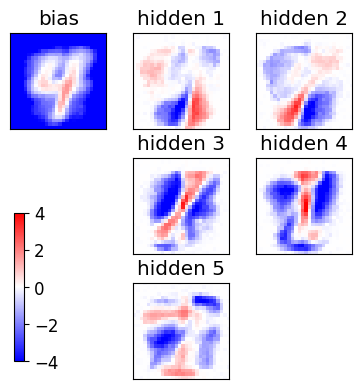

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

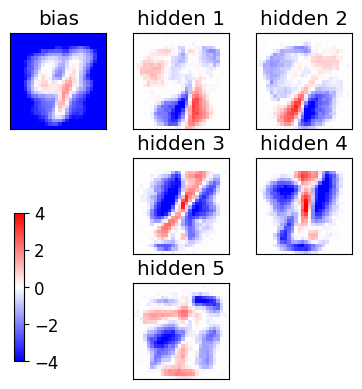

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

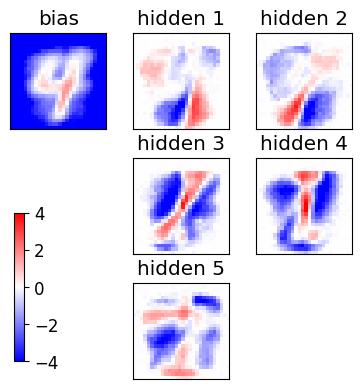

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

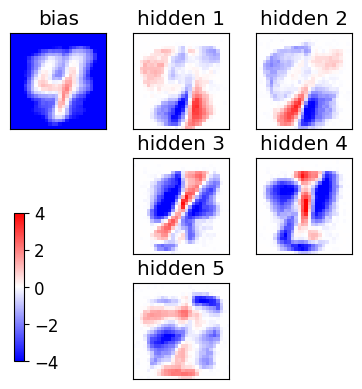

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

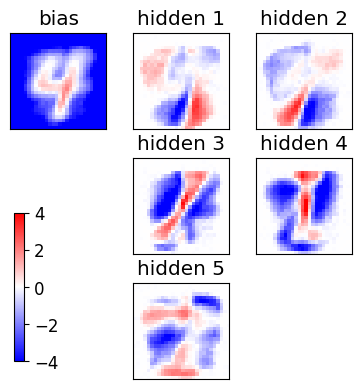

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

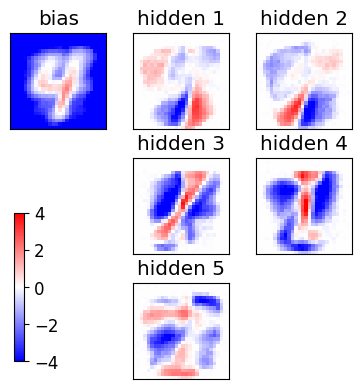

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

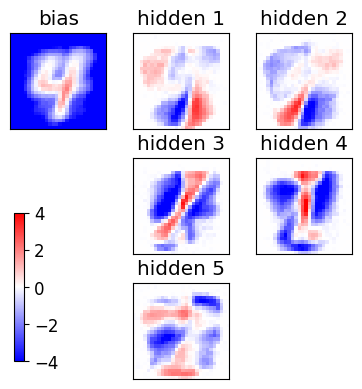

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

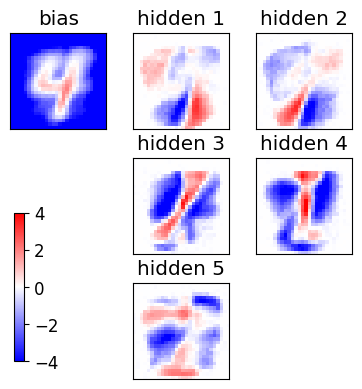

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

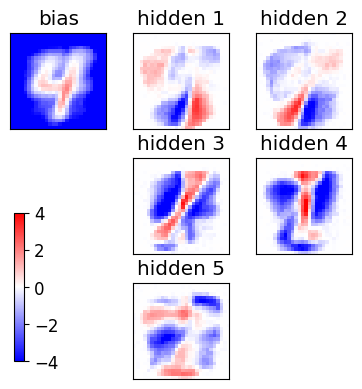

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

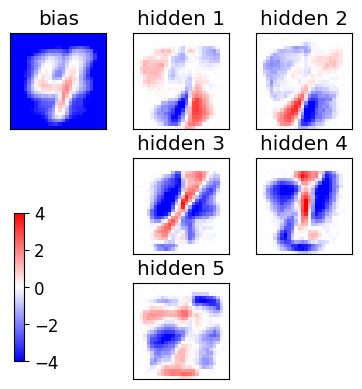

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

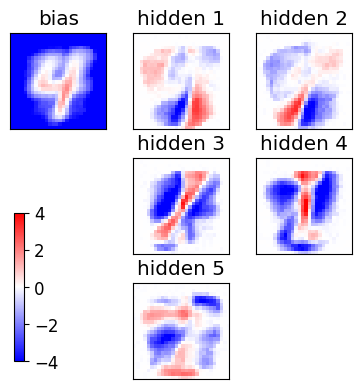

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

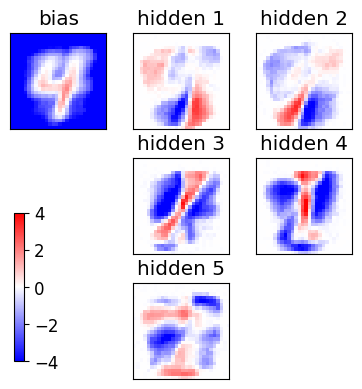

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

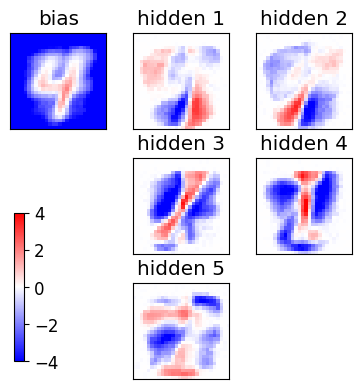

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

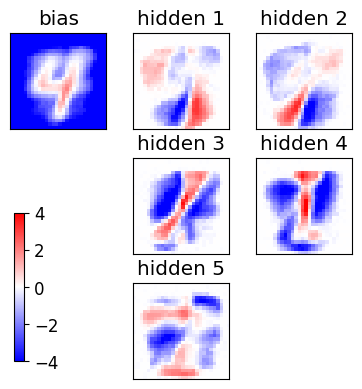

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

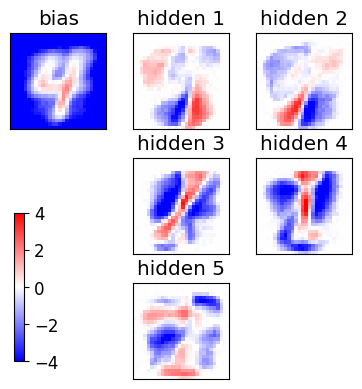

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

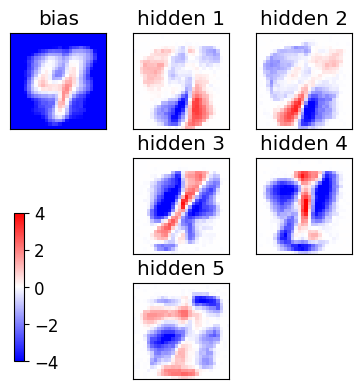

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

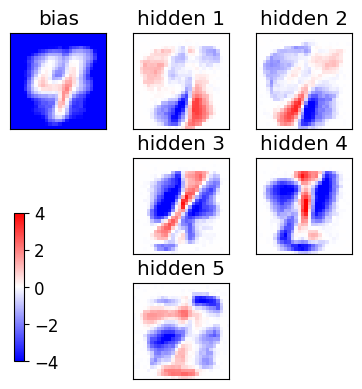

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

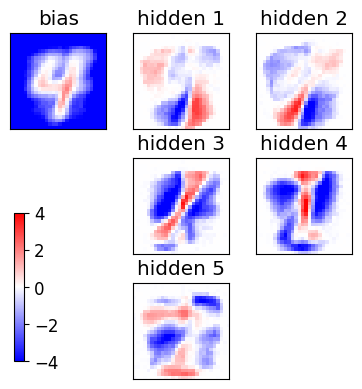

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

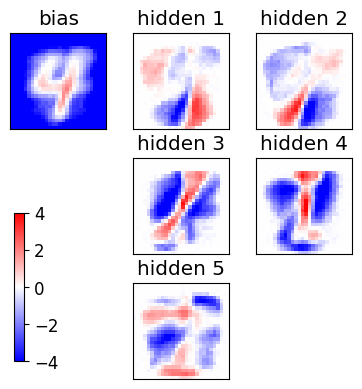

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

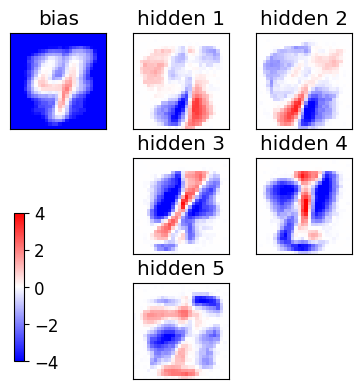

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

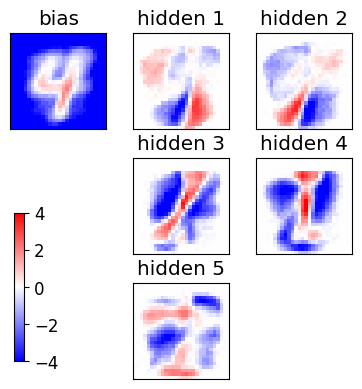

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

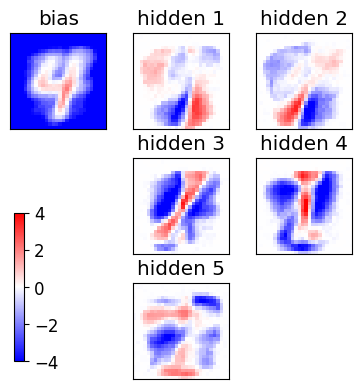

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

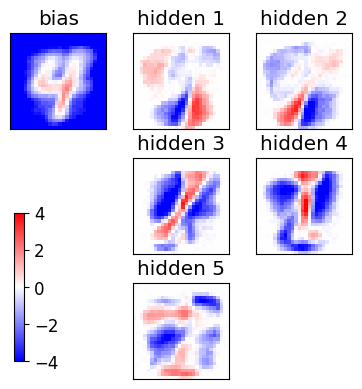

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

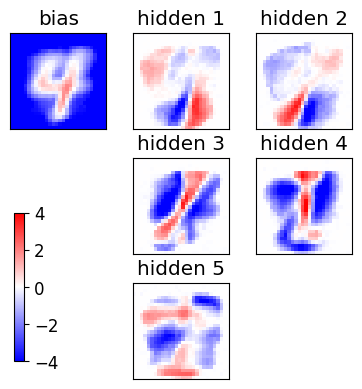

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

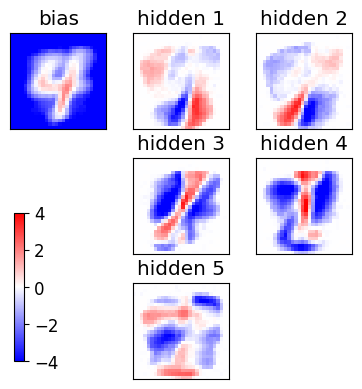

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

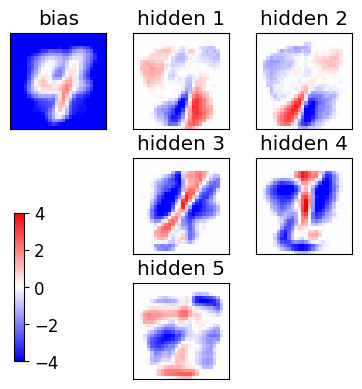

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

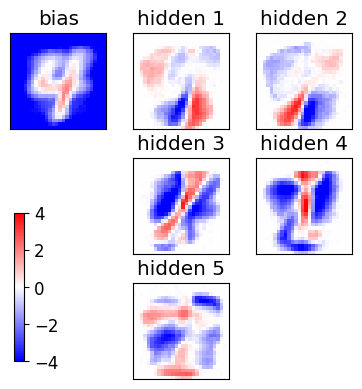

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

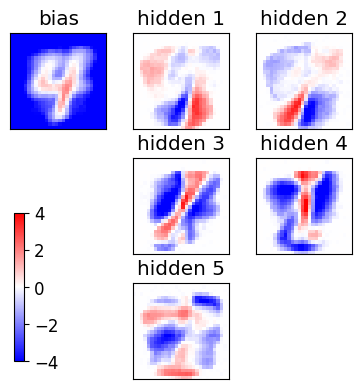

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

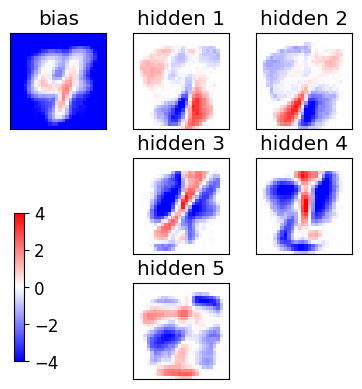

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

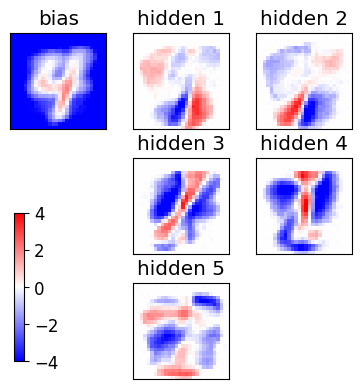

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

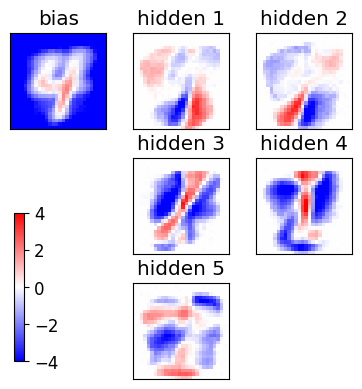

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

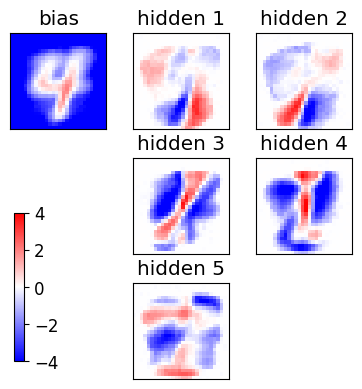

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

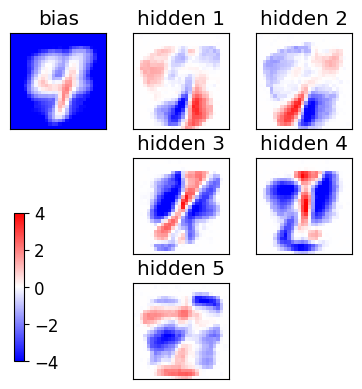

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

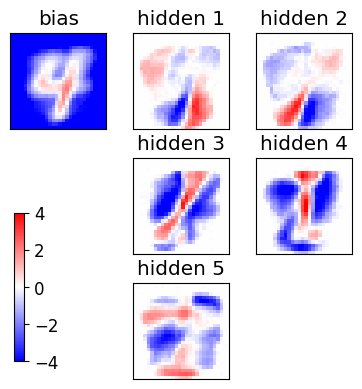

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

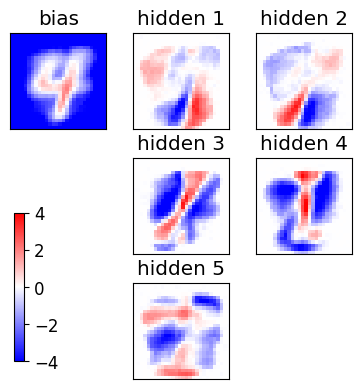

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

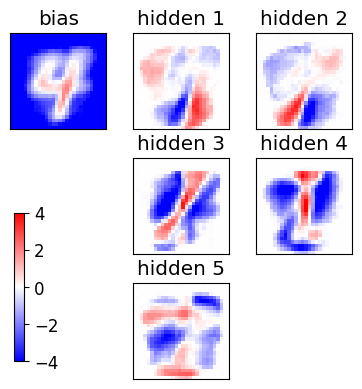

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

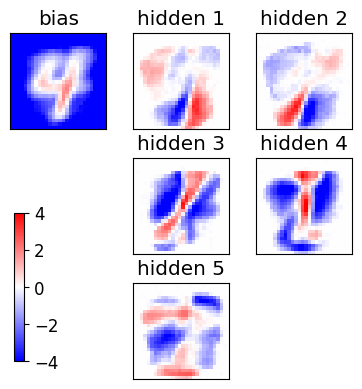

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

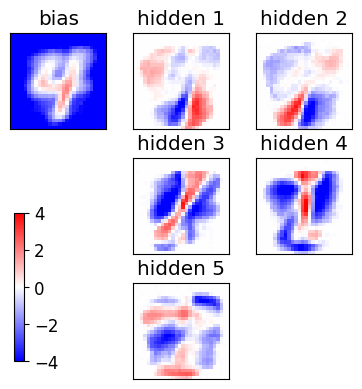

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

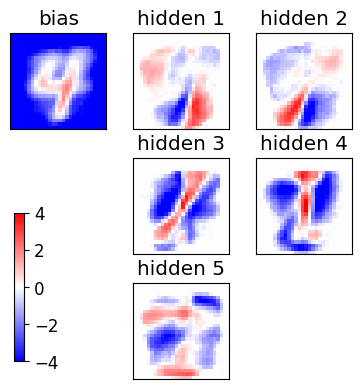

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

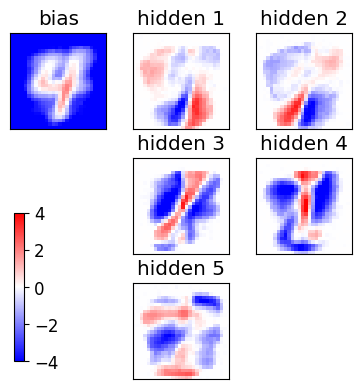

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

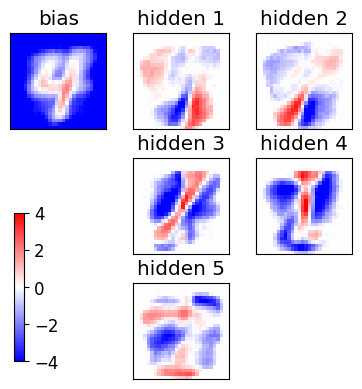

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

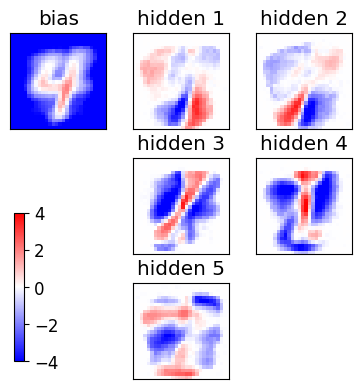

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

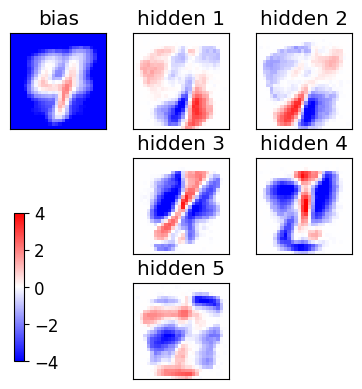

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

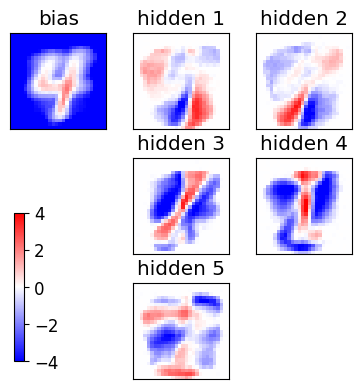

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

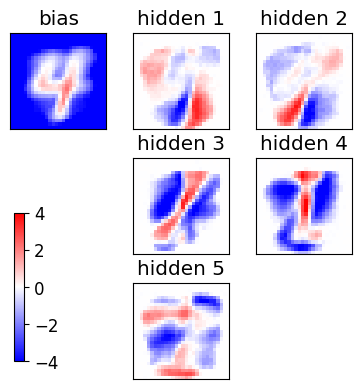

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

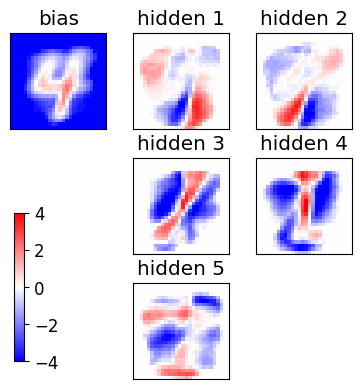

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

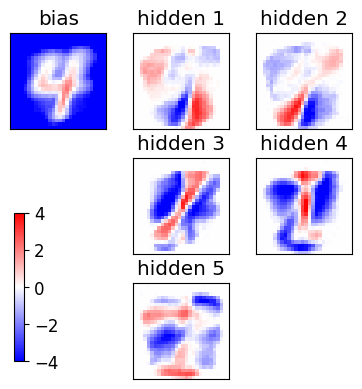

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

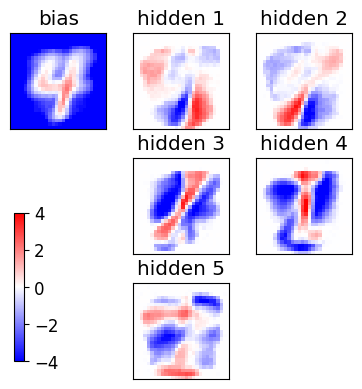

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

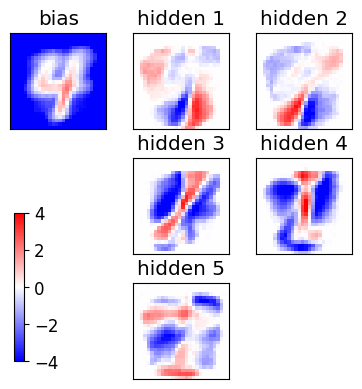

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

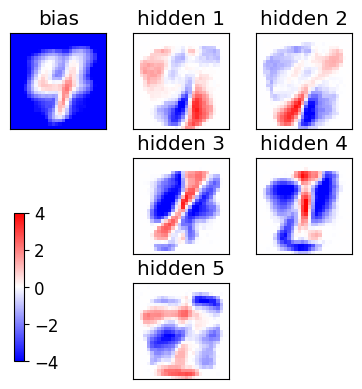

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

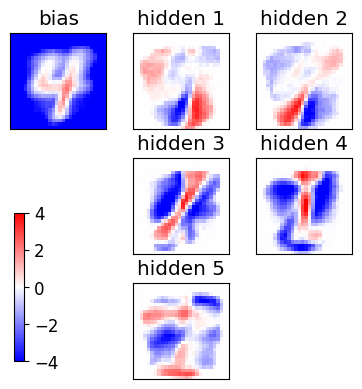

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

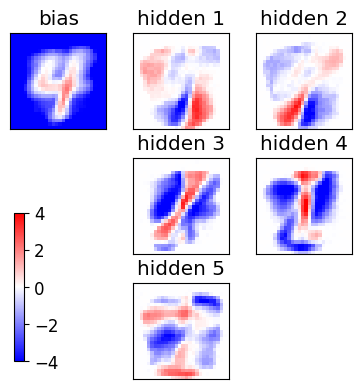

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

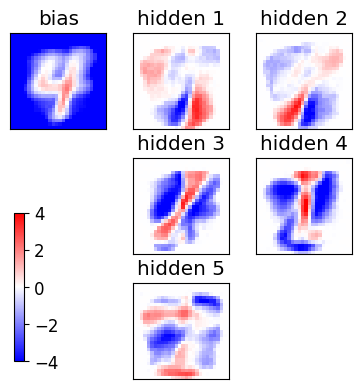

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

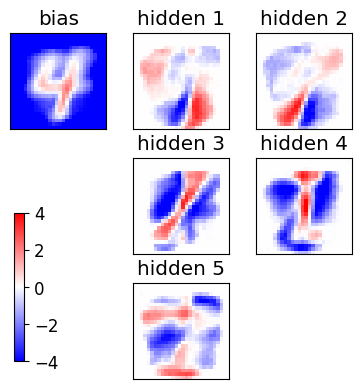

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

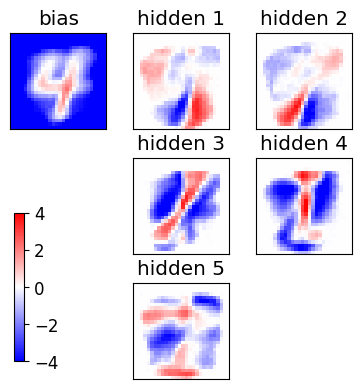

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

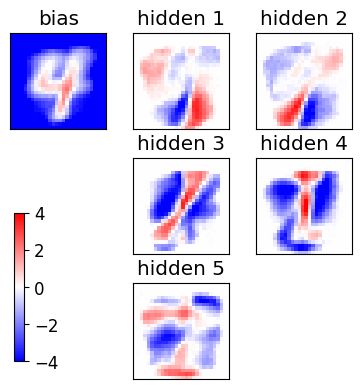

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

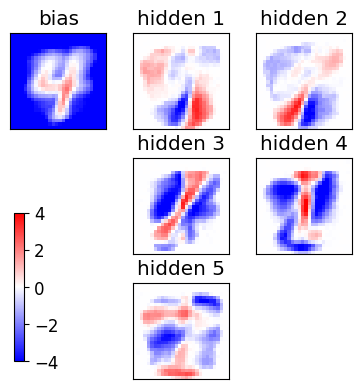

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

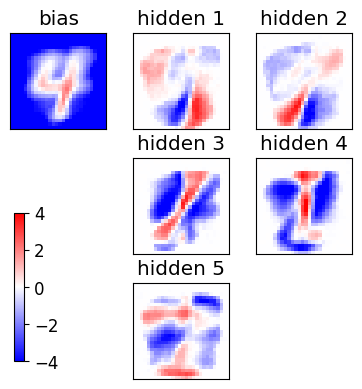

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

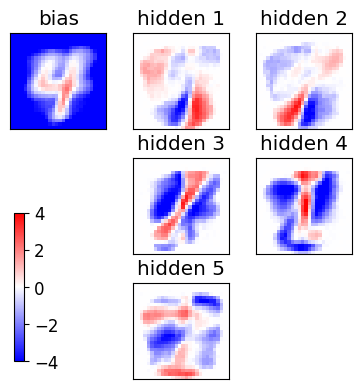

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

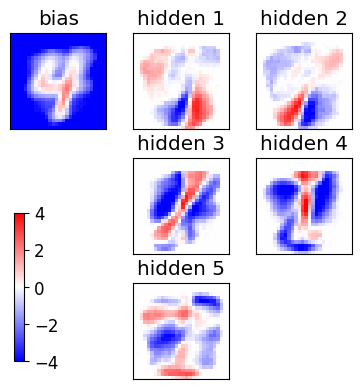

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

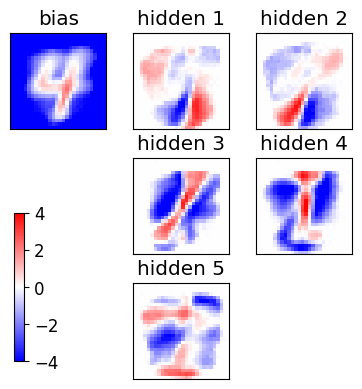

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

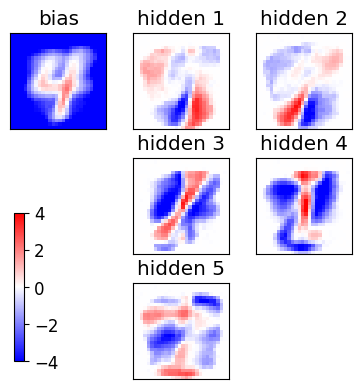

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

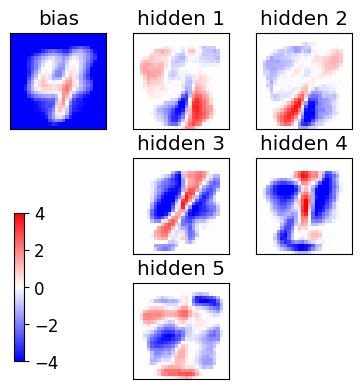

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

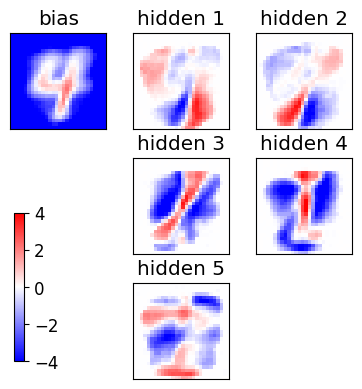

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

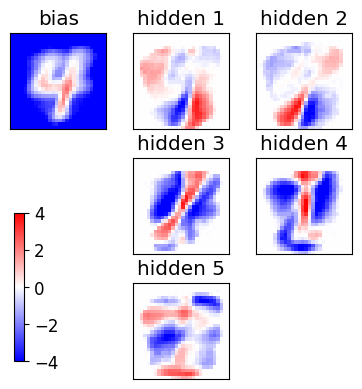

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

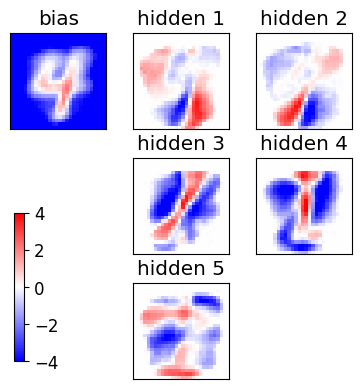

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

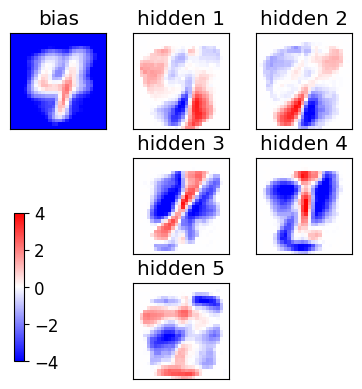

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

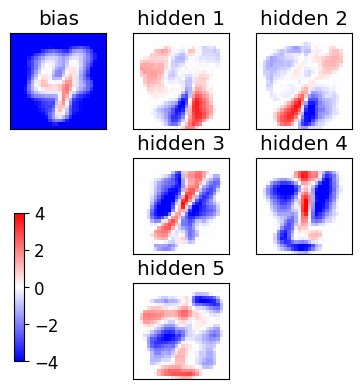

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

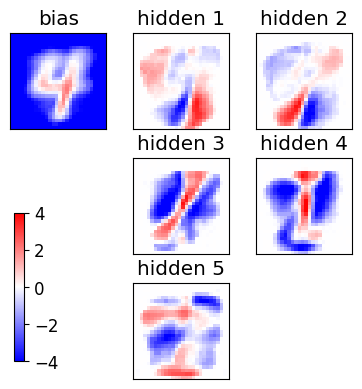

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

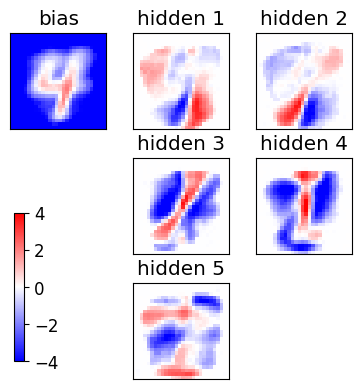

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

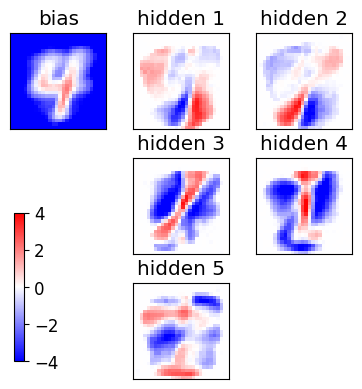

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

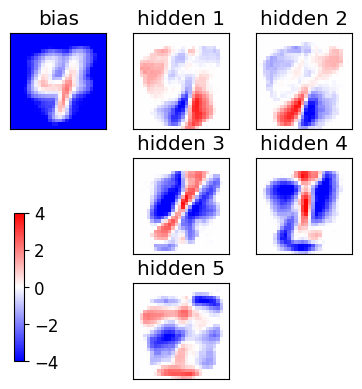

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

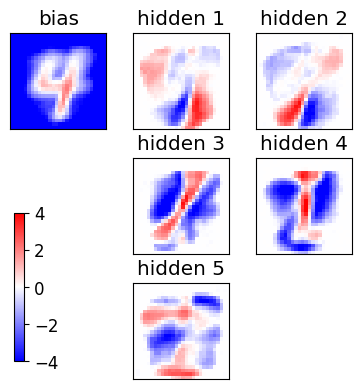

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

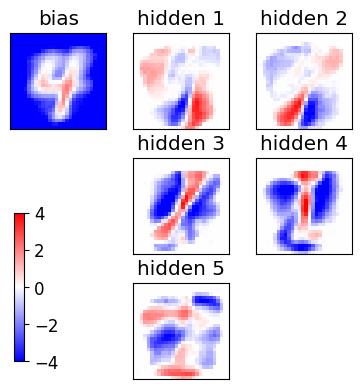

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

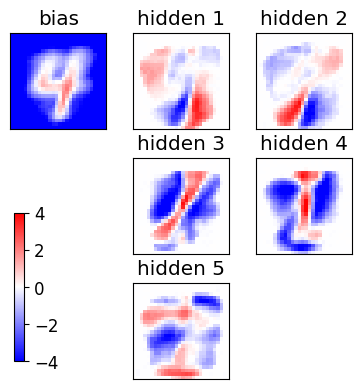

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

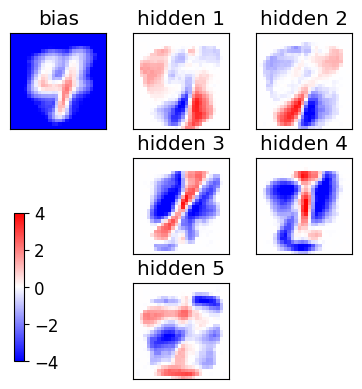

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

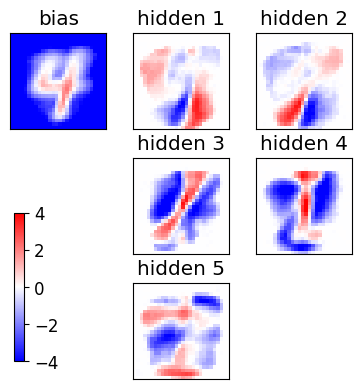

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

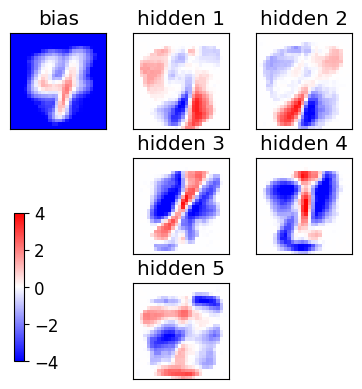

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

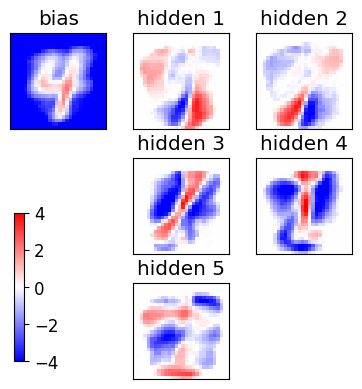

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

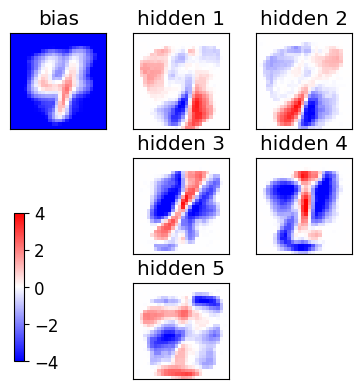

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

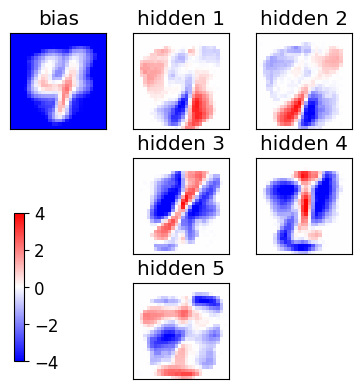

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

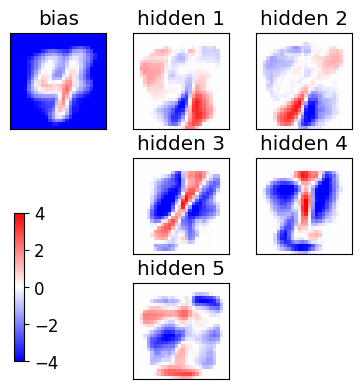

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

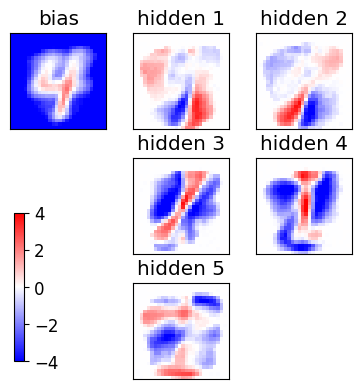

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

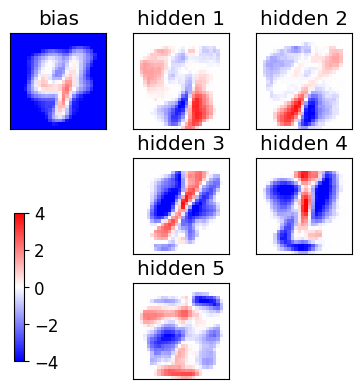

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

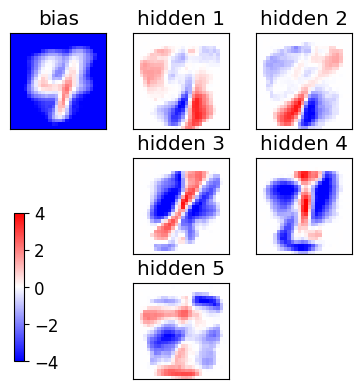

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

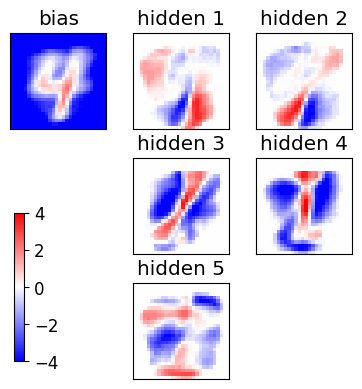

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

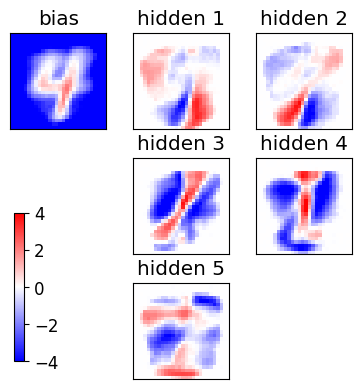

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

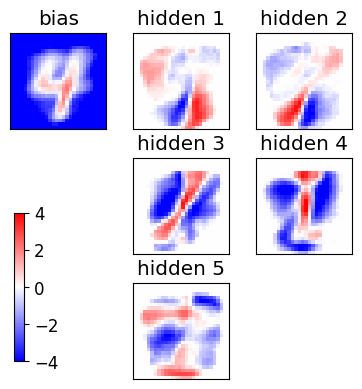

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

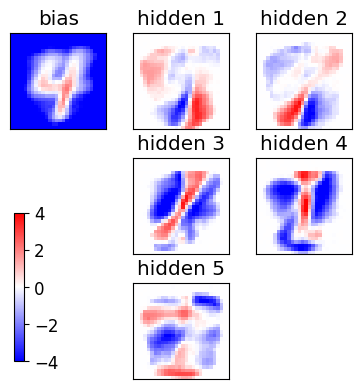

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

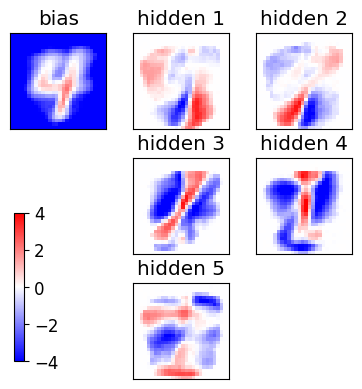

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

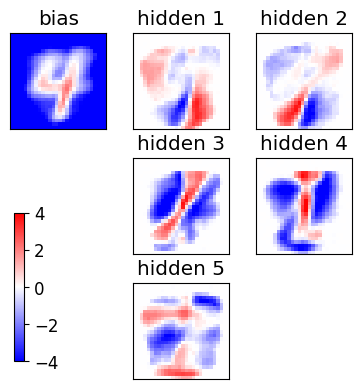

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

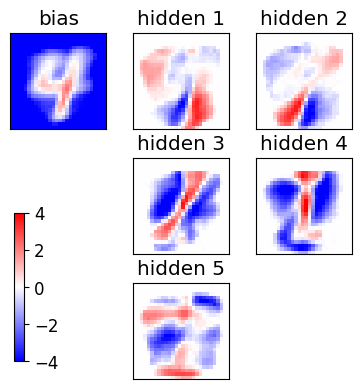

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

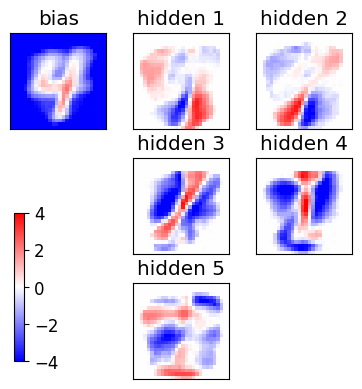

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

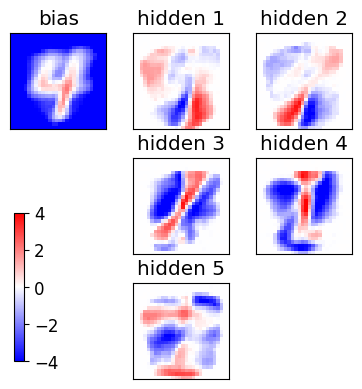

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

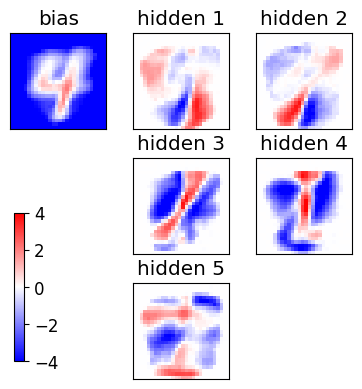

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

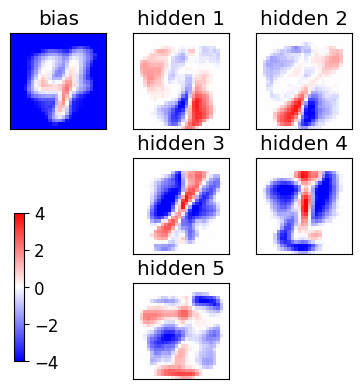

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

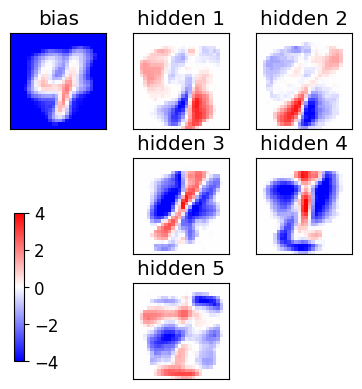

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

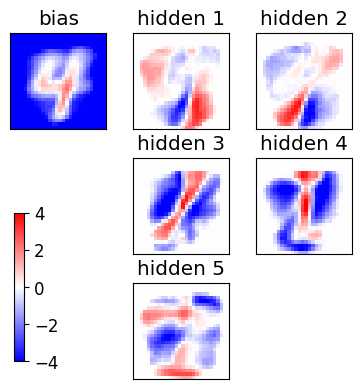

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

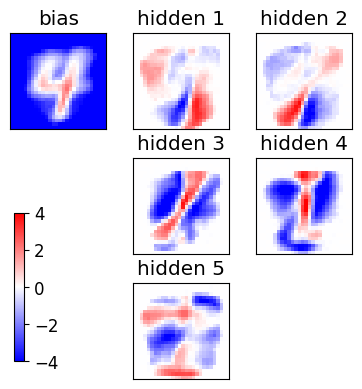

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

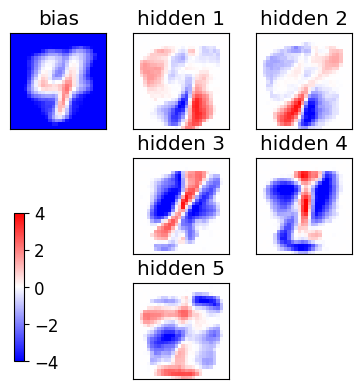

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

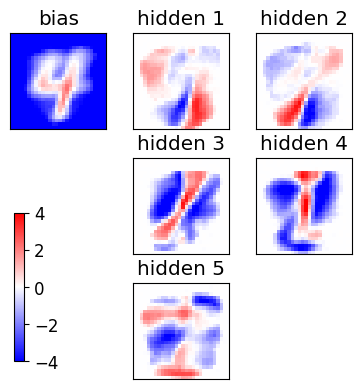

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

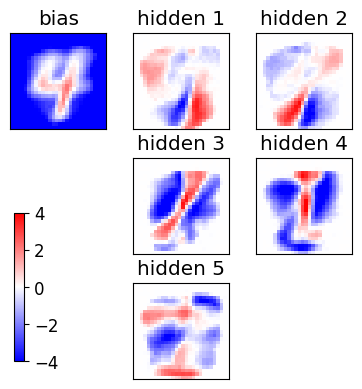

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

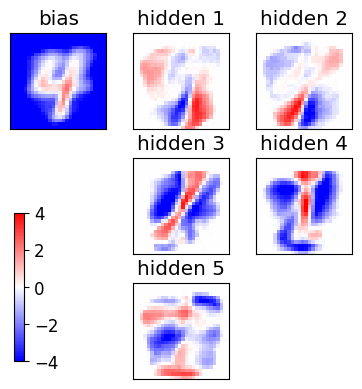

END of learning phase


In [38]:
#training for different regularization gamma, Nt

for gamma in gamma_v:
    if gamma>0:
        L = 5
        Nt = 4
        # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
        w = sigma * np.random.randn(D, L)
        #a = sigma * np.random.randn(D)
        # using Hinton initialization of visible biases
        a = Hinton_bias_init(data)
        # hidden biases initialized to zero
        b = np.zeros(L)
        #print("w=",w);print("a=",a);print("b=",b)

        # nr of epochs
        Nepoch = 150
        # minibatches per epoch
        Nmini = 20
        # minibatch size at initial epoch and final one
        N_ini, N_fin = 10, 500
        print(f"Nepoch={Nepoch}\nNmini={Nmini}")

        # recording history of weights ("E" means epoch)
        wE, aE, bE = np.zeros((Nepoch + 1, D, L)), np.zeros((Nepoch + 1, D)), np.zeros((Nepoch + 1, L))
        wE[0], aE[0], bE[0] = np.copy(w), np.copy(a), np.copy(b)
        gwE, gw2E, gwE_d, gwE_m = np.zeros_like(wE), np.zeros_like(wE), np.zeros_like(wE), np.zeros_like(wE)
        gaE, ga2E, gaE_d, gaE_m = np.zeros_like(aE), np.zeros_like(aE), np.zeros_like(aE), np.zeros_like(aE)
        gbE, gb2E, gbE_d, gbE_m = np.zeros_like(bE), np.zeros_like(bE), np.zeros_like(bE), np.zeros_like(bE)
        miniE = np.zeros(Nepoch + 1)
        pzE = np.zeros((Nepoch + 1, Nz))
        if GRAD == "RMSprop":
            gw2, ga2, gb2 = np.zeros_like(w), np.zeros_like(a), np.zeros_like(b)

        indices = np.arange(Nd).astype("int")
        plot_weights_bias(wE, aE, 0, L, cols=L // 2, save=False)

        # for the plot with panels
        Ncols = min(8, max(2, L // 2))

        if POTTS:
            print("Starting the training, POTTS=True")
        else:
            print("Starting the training")

        # Note: here an epoch does not analyze the whole dataset
        for epoch in range(1, 1 + Nepoch):
            # q maps epochs to interval [0,1]
            q = (epoch - 1.) / (Nepoch - 1.)
            # N, size of the mini batch
            # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
            N = int(N_ini + (N_fin - N_ini) * (q ** 2))
            # l_rate interpolates between initial and final value
            l_rate = l_rate_ini + (l_rate_fin - l_rate_ini) * q

            for mini in range(Nmini):
                # initializitation for averages in minibatch
                # visible variables "v" --> "x"
                # hidden variables "h" --> "z"
                x_data, x_model = np.zeros(D), np.zeros(D)
                z_data, z_model = np.zeros(L), np.zeros(L)
                xz_data, xz_model = np.zeros((D, L)), np.zeros((D, L))
                pz = np.zeros(L)

                # Minibatch of size N: points randomly picked (without repetition) from data
                selected = np.random.choice(indices, N, replace=False)
                if epoch == 1 and mini <= 3:
                    print(selected)

                for k in range(N):
                    ###################################
                    x0 = data[selected[k]]
                    # positive CD phase: generating z from x[k]
                    z = CD_step(x0, w, b, POTTS=POTTS)
                    x_data += x0
                    z_data += z
                    xz_data += np.outer(x0, z)
                    # fantasy
                    zf = np.copy(z)
                    # Contrastive divergence with Nt steps
                    for t in range(Nt):
                        # negative CD phase: generating fantasy xf from fantasy zf
                        xf = CD_step(zf, w.T, a)
                        # positive CD phase: generating fantasy zf from fantasy xf
                        zf = CD_step(xf, w, b, POTTS=POTTS)
                    x_model += xf
                    z_model += zf
                    xz_model += np.outer(xf, zf)
                    # recording probability of encoding in z-space, if POTTS
                    if POTTS:
                        pz[zf] += 1
                    ###################################

                # gradient of the likelihood: follow it along its positive direction
                gw_d, gw_m = xz_data / N, xz_model / N
                ga_d, ga_m = x_data / N, x_model / N
                gb_d, gb_m = z_data / N, z_model / N
                gw = np.copy(gw_d - gw_m)
                ga = np.copy(ga_d - ga_m)
                gb = np.copy(gb_d - gb_m)

                # gradient ascent step
                if GRAD == "RMSprop":
                    # RMSprop gradient ascent
                    gw2 = beta * gw2 + (1 - beta) * np.square(gw)
                    ga2 = beta * ga2 + (1 - beta) * np.square(ga)
                    gb2 = beta * gb2 + (1 - beta) * np.square(gb)
                    w += l_rate * gw / sqrt(epsilon + gw2)
                    a += l_rate * ga / sqrt(epsilon + ga2)
                    b += l_rate * gb / sqrt(epsilon + gb2)
                else:
                    # defaulting to the vanilla stochastic gradient ascent (SGD)
                    w += l_rate * gw
                    a += l_rate * ga
                    b += l_rate * gb
                # regularization (LASSO)
                if gamma > 0.:
                    w -= (gamma * l_rate) * sign(w)
                    a -= (gamma * l_rate) * sign(a)
                    b -= (gamma * l_rate) * sign(b)

                wE[epoch], gwE[epoch], gwE_d[epoch], gwE_m[epoch] = np.copy(w), np.copy(gw), np.copy(gw_d), np.copy(gw_m)
                aE[epoch], gaE[epoch], gaE_d[epoch], gaE_m[epoch] = np.copy(a), np.copy(ga), np.copy(ga_d), np.copy(ga_m)
                bE[epoch], gbE[epoch], gbE_d[epoch], gbE_m[epoch] = np.copy(b), np.copy(gb), np.copy(gb_d), np.copy(gb_m)
                miniE[epoch] = N
                if POTTS:
                    pzE[epoch] = pz / np.sum(pz)
                print("epoch", epoch, "/", Nepoch, " Nt:", Nt, " N:", N, " L:", L,
                    " rate:", l_rate, " gam:", gamma, "SPINS=", SPINS, "POTTS=", POTTS)

                if Nepoch <= 100 or epoch % 20 == 0 or epoch == Nepoch:
                    plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

                str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
                save_epochs(wE, "w")
                save_epochs(bE, "b")
                save_epochs(aE, "a")

        print("END of learning phase")

In [45]:
log_like_gamma=[]
log_like_gamma_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-5,Nepoch,1) # consider trend over the last 5 iterations

for gamma in gamma_v:
  if gamma>0.:
    L=5
    Nt=4
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'a_all gamma={gamma}, L={L}, Nt={Nt}')
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'b_all gamma={gamma}, L={L}, Nt={Nt}')
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'w_all gamma={gamma}, L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like_g=[]
    log_like_g_std=[]
    Nepoch=150
    for i in range(Nepoch-5,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter=[]
        mean=[]
        for iter in range(5): # to determine the loglike at each epoch we run the calculation 5 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like_g.append(ll_mean)
        log_like_g_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_gamma.append(log_like_g)
    log_like_gamma_std.append(log_like_g_std)


a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:20<00:00, 274.30it/s]


Log-likelihood= -127.24936264327123 +- 0.09868374070078725
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 289.84it/s]


Log-likelihood= -125.48560986222321 +- 0.39617839366682694
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 285.79it/s]


Log-likelihood= -125.56843316209658 +- 0.6485767332868067
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 274.95it/s]


Log-likelihood= -126.39556656076766 +- 0.33898509978117325
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 275.02it/s]


Log-likelihood= -123.94252645370557 +- 0.2938311468828203
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.13it/s]


Log-likelihood= -126.72476994924375 +- 0.3505401132270048
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 286.81it/s]


Log-likelihood= -124.40563102266633 +- 0.5328862241434911
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 279.15it/s]


Log-likelihood= -123.72866452859 +- 0.2972349430252236
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.05it/s]


Log-likelihood= -125.87915395843947 +- 0.653735542159499
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.78it/s]


Log-likelihood= -125.22376629258126 +- 0.44020738848745683
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.66it/s]


Log-likelihood= -124.01324762304156 +- 0.6988188686443131
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.09it/s]


Log-likelihood= -122.89829156322526 +- 0.39900742915502585
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.81it/s]


Log-likelihood= -123.82261531115947 +- 0.5694427577354926
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.20it/s]


Log-likelihood= -124.02969839974651 +- 0.7031704100238827
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 277.88it/s]


Log-likelihood= -123.67887959517209 +- 0.3788611044094232
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 279.04it/s]


Log-likelihood= -127.33794499632832 +- 0.43345310910550594
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 280.92it/s]


Log-likelihood= -127.02620649819498 +- 0.44587762480186455
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.57it/s]


Log-likelihood= -126.82888105086695 +- 0.11149532781481647
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.78it/s]


Log-likelihood= -129.48453970010192 +- 0.4457653442159149
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 281.74it/s]

Log-likelihood= -127.12897024309113 +- 0.4447652683135306


In [19]:

log_like_gamma = [
    [-127.24936264327123, -125.48560986222321, -125.56843316209658, -126.39556656076766, -123.94252645370557],  # Case 1
    [-126.72476994924375, -124.40563102266633, -123.72866452859, -125.87915395843947, -125.22376629258126],  # Case 2
    [-124.01324762304156, -122.89829156322526, -123.82261531115947, -124.02969839974651, -123.67887959517209],  # Case 3
    [-127.33794499632832, -127.02620649819498, -126.82888105086695, -129.48453970010192, -127.12897024309113],  # Case 4
    [-138.47331831474386, -138.1203701712743, -137.71334920388665, -138.20494530508435, -138.7838087707658]  # Case 5 (aggiunto)
]

log_like_gamma_std = [
    [0.09868374070078725, 0.39617839366682694, 0.6485767332868067, 0.33898509978117325, 0.2938311468828203],  # Case 1
    [0.3505401132270048, 0.5328862241434911, 0.2972349430252236, 0.653735542159499, 0.44020738848745683],  # Case 2
    [0.6988188686443131, 0.39900742915502585, 0.5694427577354926, 0.7031704100238827, 0.3788611044094232],  # Case 3
    [0.43345310910550594, 0.44587762480186455, 0.11149532781481647, 0.4457653442159149, 0.4447652683135306],  # Case 4
    [0.4011070862112876, 0.561959628581091, 0.5458788509620577, 0.676651791500994, 0.549637774447985]  # Case 5 (aggiunto)
]

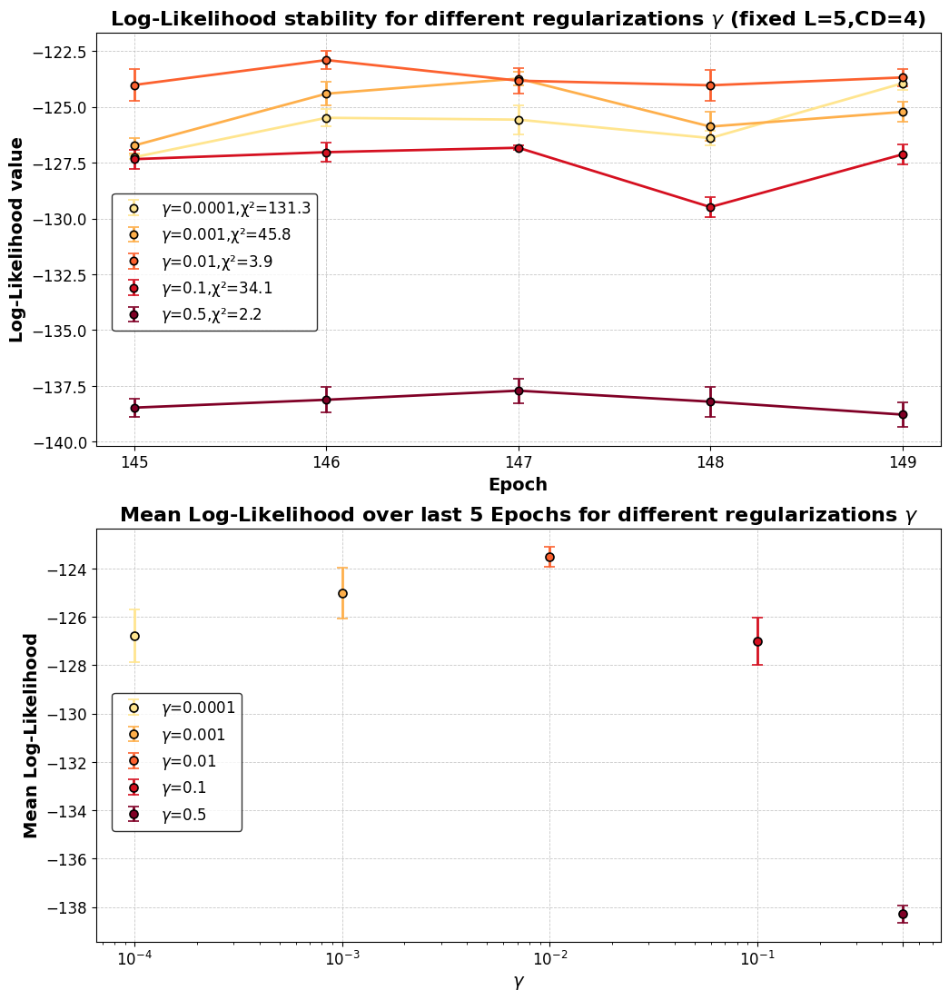

In [74]:
# variable gamma steps, fixed L=5 and CD steps=4
colors = plt.cm.YlOrRd(np.linspace(0.178, 1, len(log_like_gamma)))
Nepoch=150
num_epo=np.arange(Nepoch-5,Nepoch,1)

fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,13))

for i, log_like in enumerate(log_like_gamma):
    weights = 1 / np.array(log_like_gamma_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(5))/log_like_gamma_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_gamma_std[i],fmt='o',color=colors[i],label=f'$\gamma$={gamma_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=6,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(gamma_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'$\gamma$={gamma_v[i]}',linewidth=2,markersize=6.5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    ax2.set_xscale('log')
   

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different regularizations $\gamma$ (fixed L=5,CD=4)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='center left', frameon=True, bbox_to_anchor=(0.01, 0.444), edgecolor='black')

ax2.set_xlabel('$\gamma$', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 5 Epochs for different regularizations $\gamma$', fontsize=16, fontweight='bold')
ax2.set_xticks(gamma_v)
#ax2.set_xticklabels([f'{tick:.1e}' for tick in gamma_v])
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='lower left', frameon=True, bbox_to_anchor=(0.01, 0.25), edgecolor='black')

file_path = 'GRAPHS/log_like_gammas_plot.png'  # Path where you want to save the figure
fig.savefig(file_path, dpi=300, bbox_inches='tight')  # Save the figure as a .png file with high resolution


plt.show()

## Dependance on the choice of likelihood maximization algorithm 

We compare the results for SGD and RMSProp algorithms for likelihood maximization, fixed the best parameters previosuly found L=5, CD steps=4 and $\gamma$= 0.01 

In [88]:
L_v= [3,4,5,6,8] # here we cho0se L=5 (previous best found)
Nt=4
GRAD=GRAD_list[0] # SGD algorithm for likelihood maximization
if GRAD=="SGD":
    l_rate_ini,l_rate_fin=1.0,0.25
gamma=0.01 

END of learning phase
END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

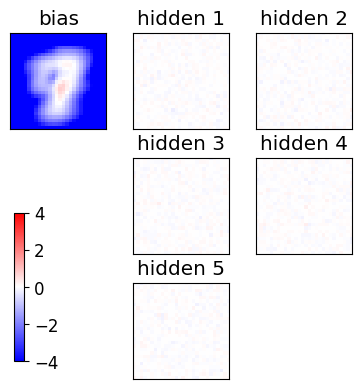

Starting the training
[16801 20681 13650 17337 16919 18129 11873 16107 11868 20865]
[ 8884  3690 11607  4229  7414  5548  7884  3837  6232 13320]
[19739 10507  7313 10783  2468 10568  2299 11968 14367 15257]
[ 3879  1349  3470  6776  6845  6186  5187  7132 16378 14712]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 2 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 3 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 4 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 5 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 6 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 7 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 8 / 150  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 9 / 150  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= Fa

<Figure size 640x480 with 0 Axes>

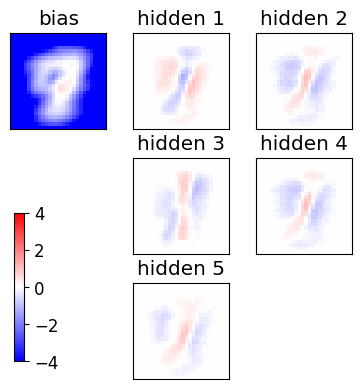

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 22 / 150  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 23 / 150  Nt: 4  N: 20  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 24 / 150  Nt: 4  N: 21  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 25 / 150  Nt: 4  N: 22  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 26 / 150  Nt: 4  N: 23  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 27 / 150  Nt: 4  N: 24  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 28 / 150  Nt: 4  N: 26  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 29 / 150  Nt: 4  N: 27  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 30 / 150  Nt: 4  N: 28  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 31 / 150  Nt: 4  N: 29  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 32 / 150  Nt: 4  N: 31  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

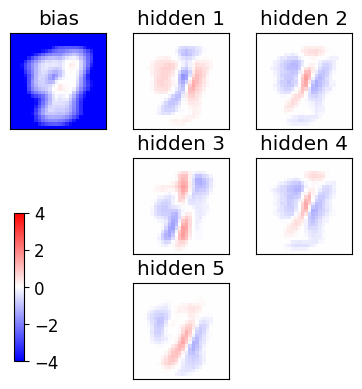

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 42 / 150  Nt: 4  N: 47  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 43 / 150  Nt: 4  N: 48  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 44 / 150  Nt: 4  N: 50  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 45 / 150  Nt: 4  N: 52  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 46 / 150  Nt: 4  N: 54  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 47 / 150  Nt: 4  N: 56  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 48 / 150  Nt: 4  N: 58  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 49 / 150  Nt: 4  N: 60  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 50 / 150  Nt: 4  N: 62  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 51 / 150  Nt: 4  N: 65  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 52 / 150  Nt: 4  N: 67  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

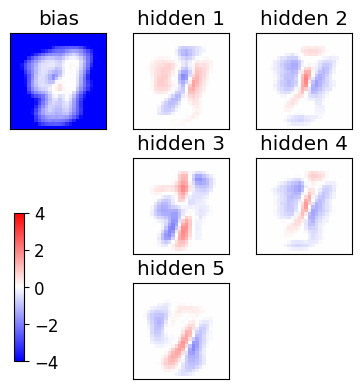

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 62 / 150  Nt: 4  N: 92  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 63 / 150  Nt: 4  N: 94  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 64 / 150  Nt: 4  N: 97  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 65 / 150  Nt: 4  N: 100  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 66 / 150  Nt: 4  N: 103  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 67 / 150  Nt: 4  N: 106  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 68 / 150  Nt: 4  N: 109  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 69 / 150  Nt: 4  N: 112  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 70 / 150  Nt: 4  N: 115  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 71 / 150  Nt: 4  N: 118  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 72 / 150  Nt: 4  N: 121  L: 5  rate: 0.05  gam: 0.01 SPINS= Fal

<Figure size 640x480 with 0 Axes>

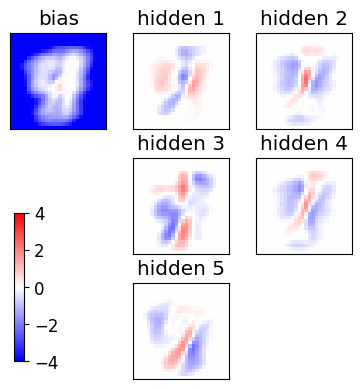

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 82 / 150  Nt: 4  N: 154  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 83 / 150  Nt: 4  N: 158  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 84 / 150  Nt: 4  N: 162  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 85 / 150  Nt: 4  N: 165  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 86 / 150  Nt: 4  N: 169  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 87 / 150  Nt: 4  N: 173  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 88 / 150  Nt: 4  N: 177  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 89 / 150  Nt: 4  N: 180  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 90 / 150  Nt: 4  N: 184  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 91 / 150  Nt: 4  N: 188  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 92 / 150  Nt: 4  N: 192  L: 5  rate: 0.05  gam: 0.01 SPINS=

<Figure size 640x480 with 0 Axes>

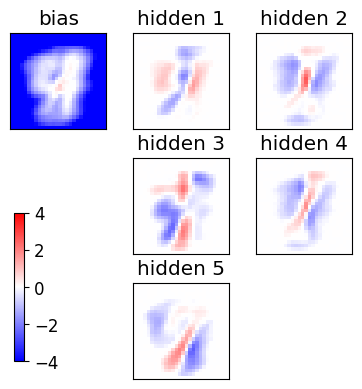

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 102 / 150  Nt: 4  N: 235  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 103 / 150  Nt: 4  N: 239  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 104 / 150  Nt: 4  N: 244  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 105 / 150  Nt: 4  N: 248  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 106 / 150  Nt: 4  N: 253  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 107 / 150  Nt: 4  N: 257  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 108 / 150  Nt: 4  N: 262  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 109 / 150  Nt: 4  N: 267  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 110 / 150  Nt: 4  N: 272  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 111 / 150  Nt: 4  N: 277  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 112 / 150  Nt: 4  N: 281  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

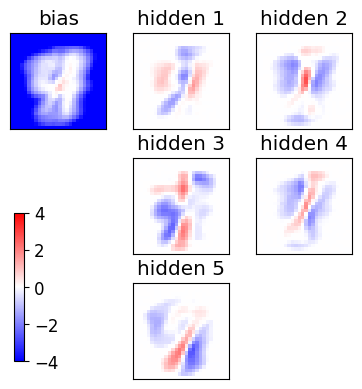

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 122 / 150  Nt: 4  N: 333  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 123 / 150  Nt: 4  N: 338  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 124 / 150  Nt: 4  N: 343  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 125 / 150  Nt: 4  N: 349  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 126 / 150  Nt: 4  N: 354  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 127 / 150  Nt: 4  N: 360  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 128 / 150  Nt: 4  N: 365  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 129 / 150  Nt: 4  N: 371  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 130 / 150  Nt: 4  N: 377  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 131 / 150  Nt: 4  N: 383  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 132 / 150  Nt: 4  N: 388  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

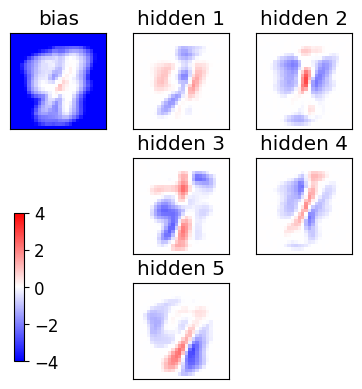

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 142 / 150  Nt: 4  N: 448  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 143 / 150  Nt: 4  N: 455  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 144 / 150  Nt: 4  N: 461  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 145 / 150  Nt: 4  N: 467  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 146 / 150  Nt: 4  N: 474  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 147 / 150  Nt: 4  N: 480  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 148 / 150  Nt: 4  N: 486  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 149 / 150  Nt: 4  N: 493  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

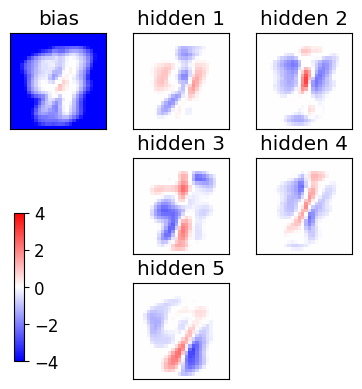

END of learning phase
END of learning phase
END of learning phase


In [81]:
 for L in L_v:
    if L == 5: 
        # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
        w = sigma * np.random.randn(D,L)
        #a = sigma * np.random.randn(D)
        # using Hinton initialization of visible biases
        a = Hinton_bias_init(data)
        # hidden biases initialized to zero
        b = np.zeros(L)
        #print("w=",w);print("a=",a);print("b=",b)
    
        # nr of epochs
        Nepoch=150
        # minibatches per epoch
        Nmini=20
        # minibatch size at initial epoch and final one
        N_ini,N_fin=10,500
        print(f"Nepoch={Nepoch}\nNmini={Nmini}")
    
    
        # recording history of weights ("E" means epoch)
        wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
        wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
        gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
        gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
        gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
        miniE = np.zeros(Nepoch+1)
        pzE=np.zeros((Nepoch+1,Nz))
        if GRAD=="RMSprop":
            gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)
    
        indices=np.arange(Nd).astype("int")
        plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)
    
        # for the plot with panels
        Ncols=min(8,max(2,L//2))
    
        if POTTS: print("Starting the training, POTTS=True")
        else: print("Starting the training")
    
        # Note: here an epoch does not analyze the whole dataset
        for epoch in range(1,1+Nepoch):
            # q maps epochs to interval [0,1]
            q = (epoch-1.)/(Nepoch-1.)
            # N, size of the mini batch
            # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
            N = int(N_ini + (N_fin-N_ini)*(q**2))
            #  l_rate interpolates between initial and final value
            l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q
    
            for mini in range(Nmini):
                # initializitation for averages in minibatch
                # visible variables "v" --> "x"
                #  hidden variables "h" --> "z"
                x_data, x_model = np.zeros(D),np.zeros(D)
                z_data, z_model = np.zeros(L),np.zeros(L)
                xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                pz = np.zeros(L)
    
                # Minibatch of size N: points randomply picked (without repetition) from data
                selected = np.random.choice(indices,N,replace=False)
                if epoch==1 and mini<=3: print(selected)
    
                for k in range(N):
                    ###################################
                    x0 = data[selected[k]]
                    # positive CD phase: generating z from x[k]
                    z = CD_step(x0,w,b,POTTS=POTTS)
                    x_data  += x0
                    z_data  += z
                    xz_data += np.outer(x0,z)
                    # fantasy
                    zf=np.copy(z)
                    # Contrastive divergence with Nt steps
                    for t in range(Nt):
                        # negative CD pzase: generating fantasy xf from fantasy zf
                        xf = CD_step(zf,w.T,a)
                        # positive CD phase: generating fantasy zf from fantasy xf
                        zf = CD_step(xf,w,b,POTTS=POTTS)
                    x_model += xf
                    z_model += zf
                    xz_model+= np.outer(xf,zf)
                    # recording probability of encoding in z-space, if POTTS
                    if POTTS: pz[zf]+=1
    
                # gradient of the likelihood: follow it along its positive direction
                gw_d,gw_m = xz_data/N, xz_model/N
                ga_d,ga_m = x_data/N, x_model/N
                gb_d,gb_m = z_data/N, z_model/N
                gw=np.copy(gw_d - gw_m)
                ga=np.copy(ga_d - ga_m)
                gb=np.copy(gb_d - gb_m)
    
                # gradient ascent step
                if GRAD=="RMSprop":
                    # RMSprop gradient ascent
                    gw2 = beta*gw2+(1-beta)*np.square(gw)
                    ga2 = beta*ga2+(1-beta)*np.square(ga)
                    gb2 = beta*gb2+(1-beta)*np.square(gb)
                    w += l_rate*gw/sqrt(epsilon+gw2)
                    a += l_rate*ga/sqrt(epsilon+ga2)
                    b += l_rate*gb/sqrt(epsilon+gb2)
                else:
                    # defaulting to the vanilla stochastic gradient ascent (SGD)
                    w += l_rate*gw
                    a += l_rate*ga
                    b += l_rate*gb
                # regularization (LASSO)
                if gamma>0.:
                    w -= (gamma*l_rate)*sign(w)
                    a -= (gamma*l_rate)*sign(a)
                    b -= (gamma*l_rate)*sign(b)
    
            wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
            aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
            bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
            miniE[epoch]=N
            if POTTS: pzE[epoch] = pz/np.sum(pz)
            print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                  " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)
    
            if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)
    
            str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
        save_epochs(wE,"w")
        save_epochs(bE,"b")
        save_epochs(aE,"a")
    
    print("END of learning phase")


## Log-likelihood with SGD

In [90]:
log_like_sgd=[]
log_like_sgd_std=[]
Nepoch=150
GRAD_list= ["SGD","RMSprop"]
num_epo=np.arange(1,Nepoch,1) # consider trend over the last 5 iterations

for grad in GRAD_list:
    L=5
    Nt=4
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_SGD-0.05-0.05_Ep150_reg0.01.npy", allow_pickle=True)
    print(f'a_all alg={grad}, gamma={0.01}, L={L}, Nt={Nt}')
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_SGD-0.05-0.05_Ep150_reg0.01.npy", allow_pickle=True)
    print(f'b_all alg={grad}, gamma={0.01}, L={L}, Nt={Nt}')
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_SGD-0.05-0.05_Ep150_reg0.01.npy", allow_pickle=True)
    print(f'w_all alg={grad}, gamma={0.01}, L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like_s=[]
    log_like_s_std=[]
    Nepoch=150
    for i in range(Nepoch-10,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter=[]
        mean=[]
        for iter in range(5): # to determine the loglike at each epoch we run the calculation 5 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like_s.append(ll_mean)
        log_like_s_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_sgd.append(log_like_s)
    log_like_sgd_std.append(log_like_g_std)


a_all alg=SGD, gamma=0.01, L=5, Nt=4
b_all alg=SGD, gamma=0.01, L=5, Nt=4
w_all alg=SGD, gamma=0.01, L=5, Nt=4
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:12<00:00, 434.96it/s]


Log-likelihood= -136.43195015018296 +- 0.6634041401223008
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 471.65it/s]


Log-likelihood= -136.5881363364273 +- 0.6405366242638701
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 478.75it/s]


Log-likelihood= -136.52014481704947 +- 0.34956546809108935
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 484.66it/s]


Log-likelihood= -136.17914769659035 +- 0.6242080111943158
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 481.49it/s]


Log-likelihood= -136.41129823071546 +- 0.48618769529466327
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:12<00:00, 430.09it/s]


Log-likelihood= -136.49786534312256 +- 0.2431426761464852
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 466.72it/s]


Log-likelihood= -136.48499831838996 +- 0.6013798513853724
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 471.39it/s]


Log-likelihood= -136.13714705091556 +- 0.46482286585875876
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:12<00:00, 443.95it/s]


Log-likelihood= -136.32401032396814 +- 0.7636502057991761
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 471.32it/s]


Log-likelihood= -136.51092871638804 +- 0.5122036952181888
a_all alg=RMSprop, gamma=0.01, L=5, Nt=4
b_all alg=RMSprop, gamma=0.01, L=5, Nt=4
w_all alg=RMSprop, gamma=0.01, L=5, Nt=4
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 459.17it/s]


Log-likelihood= -136.2531591112505 +- 0.30628891742376524
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 483.66it/s]


Log-likelihood= -136.71877788661666 +- 0.2983070911609236
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 488.50it/s]


Log-likelihood= -136.5495156894802 +- 0.46098505109866367
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 493.20it/s]


Log-likelihood= -136.2052287114306 +- 0.3419901326715745
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 510.34it/s]


Log-likelihood= -135.8897678864609 +- 0.5637473647698849
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 506.54it/s]


Log-likelihood= -136.49843956148797 +- 0.6079325439414491
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 503.43it/s]


Log-likelihood= -136.7513088028865 +- 0.42581324827194533
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 504.67it/s]


Log-likelihood= -136.37019286089475 +- 0.3798620569438675
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 501.30it/s]


Log-likelihood= -136.4840234183304 +- 0.5283209434085377
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 469.72it/s]

Log-likelihood= -136.24866961726175 +- 0.41907098910709983


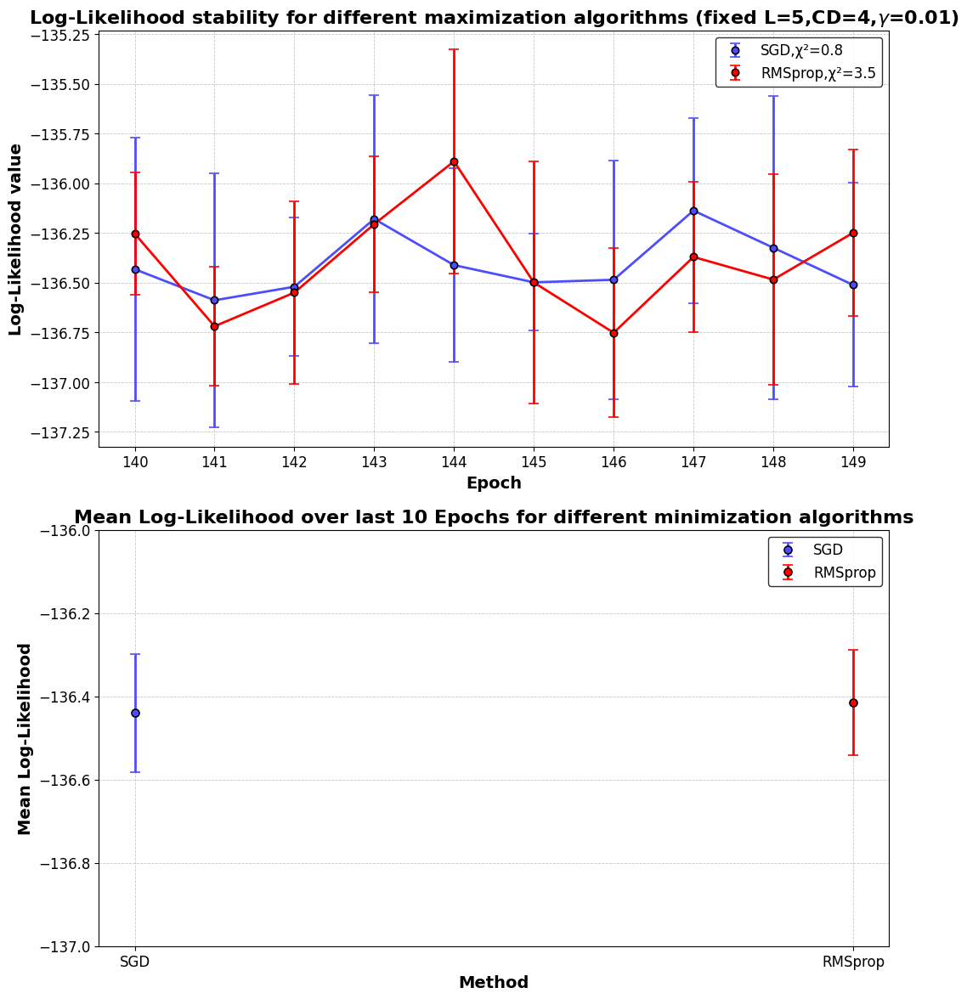

In [136]:
# graphs: comparison SGD and RMSProp 
colors = plt.cm.rainbow(np.linspace(0.1, 1, len(log_like_sgd)))
Nepoch=150
num_epo=np.arange(Nepoch-10,Nepoch,1)

fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,14))

for i, log_like in enumerate(log_like_sgd):
    weights = 1 / np.array(log_like_sgd_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_sgd_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_sgd_std[i],fmt='o',color=colors[i],label=f'{GRAD_list[i]},χ²={round(chi,1)}',linewidth=2, markersize=6,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(GRAD_list[i],weighted_avg,yerr=weighted_error,fmt='o',color=colors[i],label=f'{GRAD_list[i]}',linewidth=2,markersize=6.5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
   

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different maximization algorithms (fixed L=5,CD=4,$\gamma$=0.01)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

ax2.set_xlabel('Method', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 10 Epochs for different minimization algorithms', fontsize=16, fontweight='bold')
#ax2.set_xticklabels([f'{tick:.1e}' for tick in gamma_v])
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')
ax2.set_ylim(-137,-136)

file_path = 'GRAPHS/log_like_algorithm_plot.png'  # Path where you want to save the figure
fig.savefig(file_path, dpi=300, bbox_inches='tight')  # Save the figure as a .png file with high resolution


plt.show()

## Study of the variability of the same model for different trainings (L=8): 

We train 4 times the same models L=3,5,8 with CD=4,gamma=0.001 to study their variability to different training sets.

In [124]:
L_v=[3,5,8]
POTTS=False
gamma=0.001
Nt=4
GRAD=GRAD_list[1]
beta,epsilon=0.9,1e-4
l_rate_ini,l_rate_fin=0.05,0.05

END of learning phase
END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

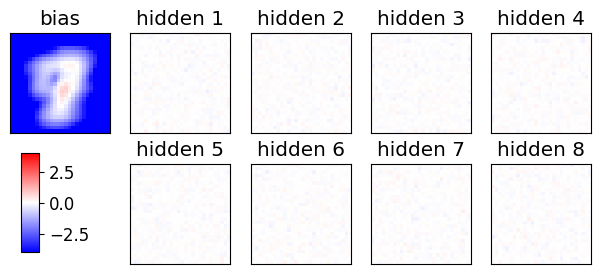

Starting the training
[ 4983  2861 12819  8779 19643 13646   345  7021 21927 14983]
[14141 16426  7577   613 14535 11045 12346 14641 14967  6650]
[10303 19914 21151 13546 17870   415 12298 19740  1446 10081]
[16613  5287  1517 14930   623  7845 15212  2915 12643  8720]
iteration 0 epoch 1 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 2 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 3 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 4 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 5 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 6 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 7 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 8 / 150  Nt: 4  N: 11  L: 8  rate: 0.05 

<Figure size 640x480 with 0 Axes>

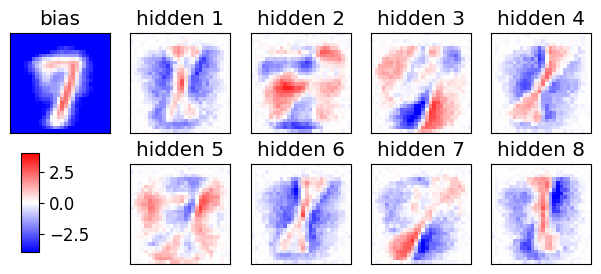

iteration 0 epoch 21 / 150  Nt: 4  N: 18  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 22 / 150  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 23 / 150  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 24 / 150  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 25 / 150  Nt: 4  N: 22  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 26 / 150  Nt: 4  N: 23  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 27 / 150  Nt: 4  N: 24  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 28 / 150  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 29 / 150  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 30 / 150  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 31 / 150  Nt

<Figure size 640x480 with 0 Axes>

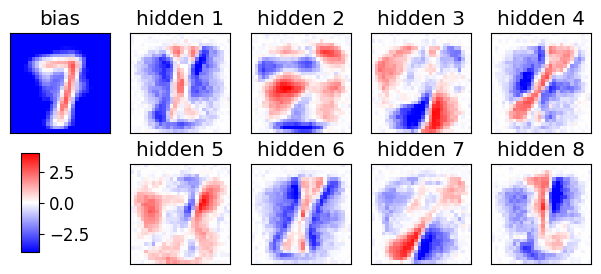

iteration 0 epoch 41 / 150  Nt: 4  N: 45  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 42 / 150  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 43 / 150  Nt: 4  N: 48  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 44 / 150  Nt: 4  N: 50  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 45 / 150  Nt: 4  N: 52  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 46 / 150  Nt: 4  N: 54  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 47 / 150  Nt: 4  N: 56  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 48 / 150  Nt: 4  N: 58  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 49 / 150  Nt: 4  N: 60  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 50 / 150  Nt: 4  N: 62  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 51 / 150  Nt

<Figure size 640x480 with 0 Axes>

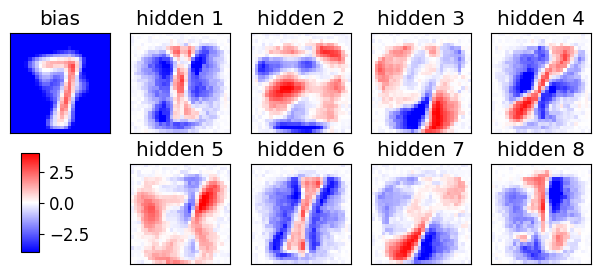

iteration 0 epoch 61 / 150  Nt: 4  N: 89  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 62 / 150  Nt: 4  N: 92  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 63 / 150  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 64 / 150  Nt: 4  N: 97  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 65 / 150  Nt: 4  N: 100  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 66 / 150  Nt: 4  N: 103  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 67 / 150  Nt: 4  N: 106  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 68 / 150  Nt: 4  N: 109  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 69 / 150  Nt: 4  N: 112  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 70 / 150  Nt: 4  N: 115  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 71 / 1

<Figure size 640x480 with 0 Axes>

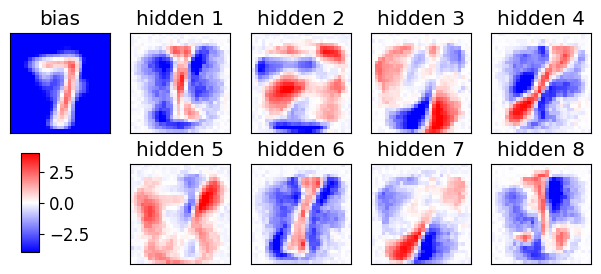

iteration 0 epoch 81 / 150  Nt: 4  N: 151  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 82 / 150  Nt: 4  N: 154  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 83 / 150  Nt: 4  N: 158  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 84 / 150  Nt: 4  N: 162  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 85 / 150  Nt: 4  N: 165  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 86 / 150  Nt: 4  N: 169  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 87 / 150  Nt: 4  N: 173  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 88 / 150  Nt: 4  N: 177  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 89 / 150  Nt: 4  N: 180  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 90 / 150  Nt: 4  N: 184  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 91

<Figure size 640x480 with 0 Axes>

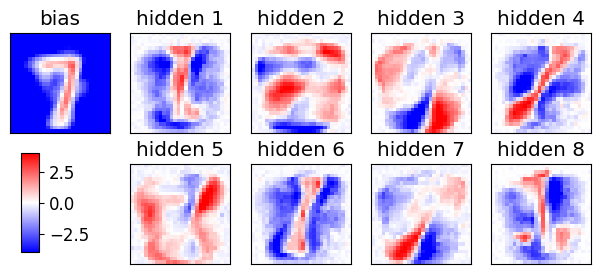

iteration 0 epoch 101 / 150  Nt: 4  N: 230  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 102 / 150  Nt: 4  N: 235  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 103 / 150  Nt: 4  N: 239  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 104 / 150  Nt: 4  N: 244  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 105 / 150  Nt: 4  N: 248  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 106 / 150  Nt: 4  N: 253  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 107 / 150  Nt: 4  N: 257  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 108 / 150  Nt: 4  N: 262  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 109 / 150  Nt: 4  N: 267  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 110 / 150  Nt: 4  N: 272  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

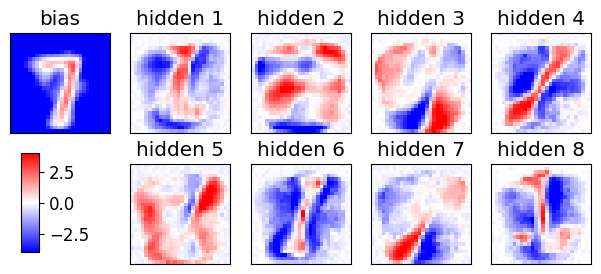

iteration 0 epoch 121 / 150  Nt: 4  N: 327  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 122 / 150  Nt: 4  N: 333  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 123 / 150  Nt: 4  N: 338  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 124 / 150  Nt: 4  N: 343  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 125 / 150  Nt: 4  N: 349  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 126 / 150  Nt: 4  N: 354  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 127 / 150  Nt: 4  N: 360  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 128 / 150  Nt: 4  N: 365  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 129 / 150  Nt: 4  N: 371  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 130 / 150  Nt: 4  N: 377  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

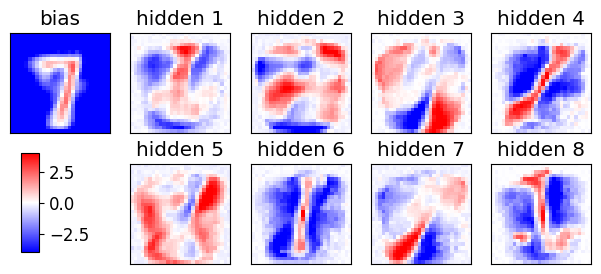

iteration 0 epoch 141 / 150  Nt: 4  N: 442  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 142 / 150  Nt: 4  N: 448  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 143 / 150  Nt: 4  N: 455  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 144 / 150  Nt: 4  N: 461  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 145 / 150  Nt: 4  N: 467  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 146 / 150  Nt: 4  N: 474  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 147 / 150  Nt: 4  N: 480  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 148 / 150  Nt: 4  N: 486  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 149 / 150  Nt: 4  N: 493  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 0 epoch 150 / 150  Nt: 4  N: 500  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

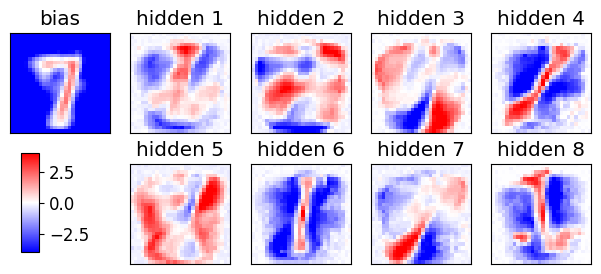

END of learning phase
END of learning phase
END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

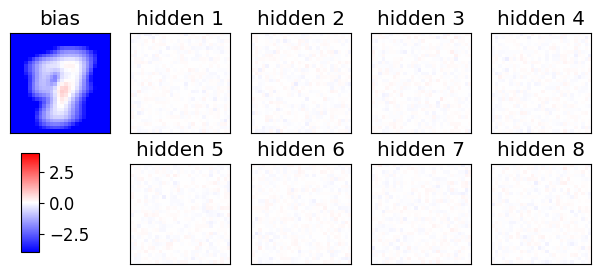

Starting the training
[19413 20191 15326 14258 21092  5269 14530  4807  4963 14340]
[10876  5172 12884 14677  6994 17757  8724  4927 13711 12270]
[18595 13556  1414 16359  6505  5455  1345 11343 18338 14204]
[ 2808 18073 15127 21451  1534  4441 20616 11682 18152   606]
iteration 1 epoch 1 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 2 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 3 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 4 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 5 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 6 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 7 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 8 / 150  Nt: 4  N: 11  L: 8  rate: 0.05 

<Figure size 640x480 with 0 Axes>

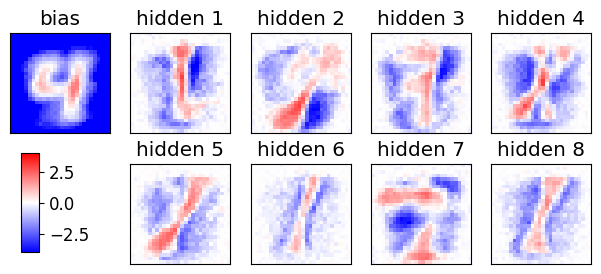

iteration 1 epoch 21 / 150  Nt: 4  N: 18  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 22 / 150  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 23 / 150  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 24 / 150  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 25 / 150  Nt: 4  N: 22  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 26 / 150  Nt: 4  N: 23  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 27 / 150  Nt: 4  N: 24  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 28 / 150  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 29 / 150  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 30 / 150  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 31 / 150  Nt

<Figure size 640x480 with 0 Axes>

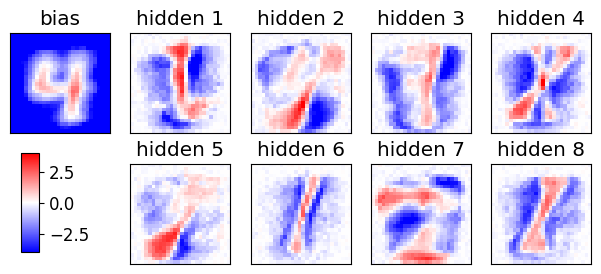

iteration 1 epoch 41 / 150  Nt: 4  N: 45  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 42 / 150  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 43 / 150  Nt: 4  N: 48  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 44 / 150  Nt: 4  N: 50  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 45 / 150  Nt: 4  N: 52  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 46 / 150  Nt: 4  N: 54  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 47 / 150  Nt: 4  N: 56  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 48 / 150  Nt: 4  N: 58  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 49 / 150  Nt: 4  N: 60  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 50 / 150  Nt: 4  N: 62  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 51 / 150  Nt

<Figure size 640x480 with 0 Axes>

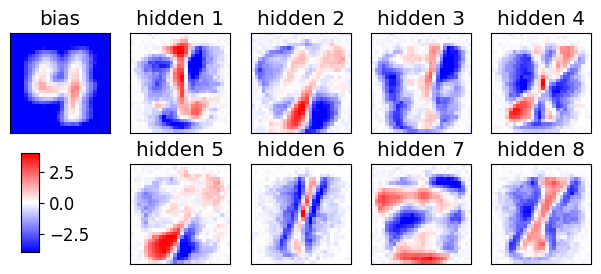

iteration 1 epoch 61 / 150  Nt: 4  N: 89  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 62 / 150  Nt: 4  N: 92  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 63 / 150  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 64 / 150  Nt: 4  N: 97  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 65 / 150  Nt: 4  N: 100  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 66 / 150  Nt: 4  N: 103  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 67 / 150  Nt: 4  N: 106  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 68 / 150  Nt: 4  N: 109  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 69 / 150  Nt: 4  N: 112  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 70 / 150  Nt: 4  N: 115  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 71 / 1

<Figure size 640x480 with 0 Axes>

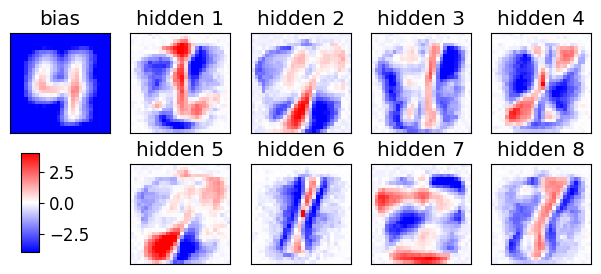

iteration 1 epoch 81 / 150  Nt: 4  N: 151  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 82 / 150  Nt: 4  N: 154  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 83 / 150  Nt: 4  N: 158  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 84 / 150  Nt: 4  N: 162  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 85 / 150  Nt: 4  N: 165  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 86 / 150  Nt: 4  N: 169  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 87 / 150  Nt: 4  N: 173  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 88 / 150  Nt: 4  N: 177  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 89 / 150  Nt: 4  N: 180  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 90 / 150  Nt: 4  N: 184  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 91

<Figure size 640x480 with 0 Axes>

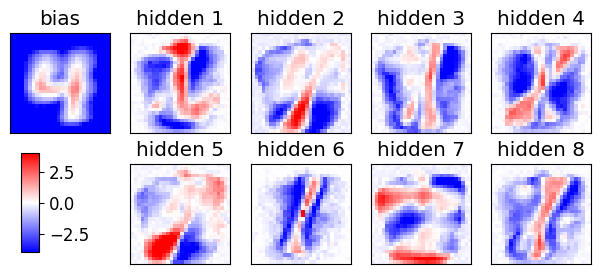

iteration 1 epoch 101 / 150  Nt: 4  N: 230  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 102 / 150  Nt: 4  N: 235  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 103 / 150  Nt: 4  N: 239  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 104 / 150  Nt: 4  N: 244  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 105 / 150  Nt: 4  N: 248  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 106 / 150  Nt: 4  N: 253  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 107 / 150  Nt: 4  N: 257  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 108 / 150  Nt: 4  N: 262  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 109 / 150  Nt: 4  N: 267  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 110 / 150  Nt: 4  N: 272  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

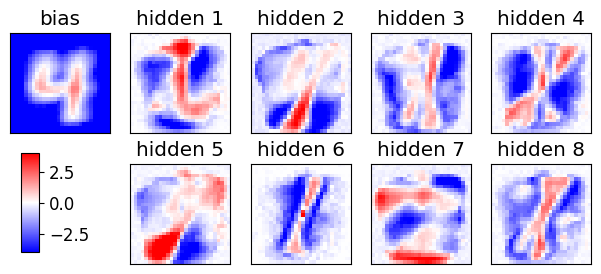

iteration 1 epoch 121 / 150  Nt: 4  N: 327  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 122 / 150  Nt: 4  N: 333  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 123 / 150  Nt: 4  N: 338  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 124 / 150  Nt: 4  N: 343  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 125 / 150  Nt: 4  N: 349  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 126 / 150  Nt: 4  N: 354  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 127 / 150  Nt: 4  N: 360  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 128 / 150  Nt: 4  N: 365  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 129 / 150  Nt: 4  N: 371  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 130 / 150  Nt: 4  N: 377  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

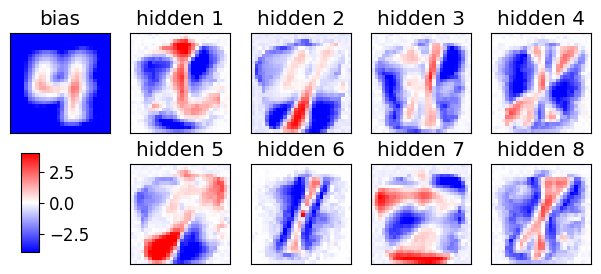

iteration 1 epoch 141 / 150  Nt: 4  N: 442  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 142 / 150  Nt: 4  N: 448  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 143 / 150  Nt: 4  N: 455  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 144 / 150  Nt: 4  N: 461  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 145 / 150  Nt: 4  N: 467  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 146 / 150  Nt: 4  N: 474  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 147 / 150  Nt: 4  N: 480  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 148 / 150  Nt: 4  N: 486  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 149 / 150  Nt: 4  N: 493  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 1 epoch 150 / 150  Nt: 4  N: 500  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

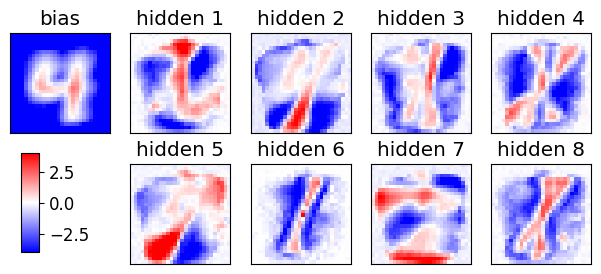

END of learning phase
END of learning phase
END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

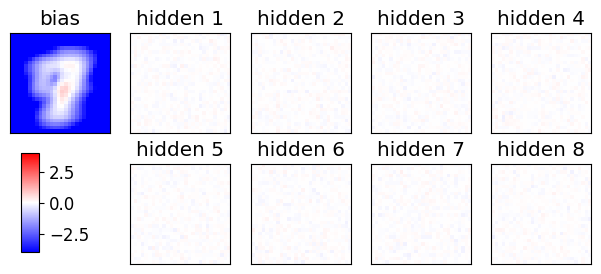

Starting the training
[12688 11285 21556   158 19069  7835 15590  3635  2278  2861]
[ 5672 13675 15174  9129  6349 13080 21919   205  1207  4442]
[13205 10781 19387 13803  2388 19721 15889  9012 19799 14983]
[11240   333 20769 10667  3686  3548 14040 14825  4224 13538]
iteration 2 epoch 1 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 2 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 3 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 4 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 5 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 6 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 7 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 8 / 150  Nt: 4  N: 11  L: 8  rate: 0.05 

<Figure size 640x480 with 0 Axes>

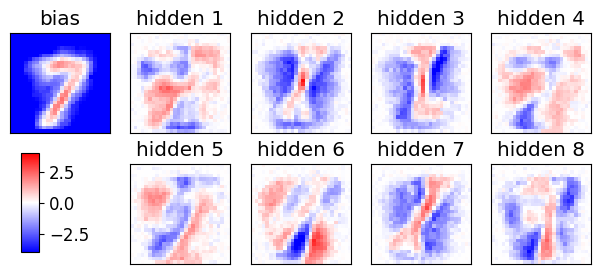

iteration 2 epoch 21 / 150  Nt: 4  N: 18  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 22 / 150  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 23 / 150  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 24 / 150  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 25 / 150  Nt: 4  N: 22  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 26 / 150  Nt: 4  N: 23  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 27 / 150  Nt: 4  N: 24  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 28 / 150  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 29 / 150  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 30 / 150  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 31 / 150  Nt

<Figure size 640x480 with 0 Axes>

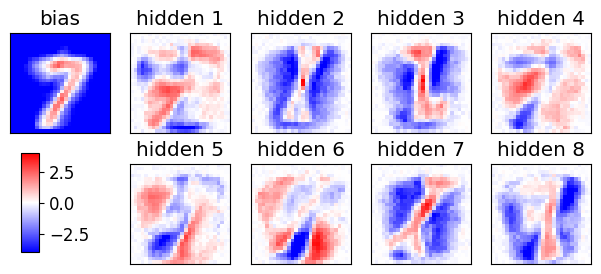

iteration 2 epoch 41 / 150  Nt: 4  N: 45  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 42 / 150  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 43 / 150  Nt: 4  N: 48  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 44 / 150  Nt: 4  N: 50  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 45 / 150  Nt: 4  N: 52  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 46 / 150  Nt: 4  N: 54  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 47 / 150  Nt: 4  N: 56  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 48 / 150  Nt: 4  N: 58  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 49 / 150  Nt: 4  N: 60  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 50 / 150  Nt: 4  N: 62  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 51 / 150  Nt

<Figure size 640x480 with 0 Axes>

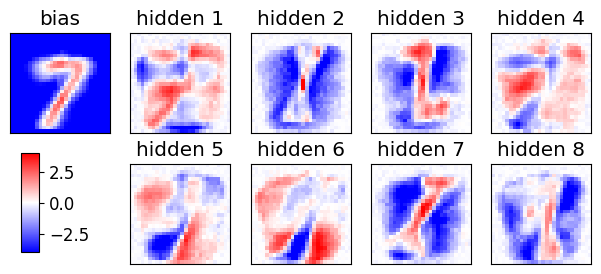

iteration 2 epoch 61 / 150  Nt: 4  N: 89  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 62 / 150  Nt: 4  N: 92  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 63 / 150  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 64 / 150  Nt: 4  N: 97  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 65 / 150  Nt: 4  N: 100  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 66 / 150  Nt: 4  N: 103  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 67 / 150  Nt: 4  N: 106  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 68 / 150  Nt: 4  N: 109  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 69 / 150  Nt: 4  N: 112  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 70 / 150  Nt: 4  N: 115  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 71 / 1

<Figure size 640x480 with 0 Axes>

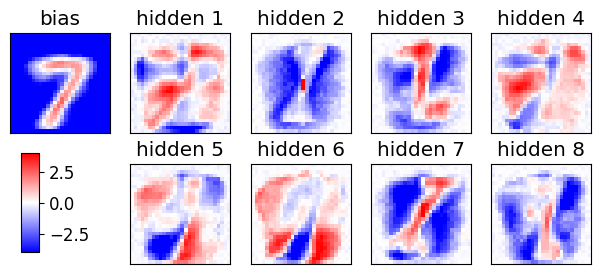

iteration 2 epoch 81 / 150  Nt: 4  N: 151  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 82 / 150  Nt: 4  N: 154  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 83 / 150  Nt: 4  N: 158  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 84 / 150  Nt: 4  N: 162  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 85 / 150  Nt: 4  N: 165  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 86 / 150  Nt: 4  N: 169  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 87 / 150  Nt: 4  N: 173  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 88 / 150  Nt: 4  N: 177  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 89 / 150  Nt: 4  N: 180  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 90 / 150  Nt: 4  N: 184  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 91

<Figure size 640x480 with 0 Axes>

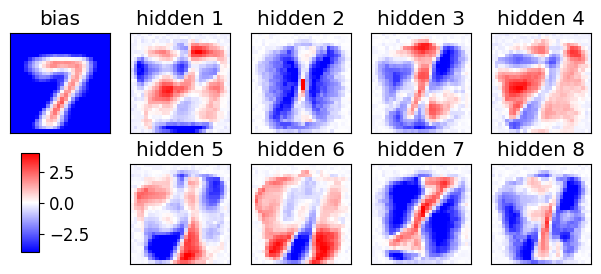

iteration 2 epoch 101 / 150  Nt: 4  N: 230  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 102 / 150  Nt: 4  N: 235  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 103 / 150  Nt: 4  N: 239  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 104 / 150  Nt: 4  N: 244  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 105 / 150  Nt: 4  N: 248  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 106 / 150  Nt: 4  N: 253  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 107 / 150  Nt: 4  N: 257  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 108 / 150  Nt: 4  N: 262  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 109 / 150  Nt: 4  N: 267  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 110 / 150  Nt: 4  N: 272  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

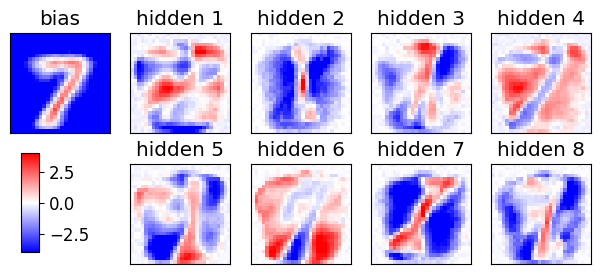

iteration 2 epoch 121 / 150  Nt: 4  N: 327  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 122 / 150  Nt: 4  N: 333  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 123 / 150  Nt: 4  N: 338  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 124 / 150  Nt: 4  N: 343  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 125 / 150  Nt: 4  N: 349  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 126 / 150  Nt: 4  N: 354  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 127 / 150  Nt: 4  N: 360  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 128 / 150  Nt: 4  N: 365  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 129 / 150  Nt: 4  N: 371  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 130 / 150  Nt: 4  N: 377  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

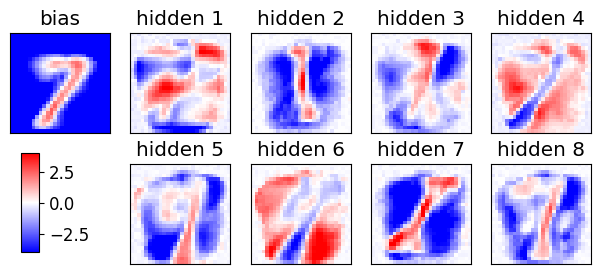

iteration 2 epoch 141 / 150  Nt: 4  N: 442  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 142 / 150  Nt: 4  N: 448  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 143 / 150  Nt: 4  N: 455  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 144 / 150  Nt: 4  N: 461  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 145 / 150  Nt: 4  N: 467  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 146 / 150  Nt: 4  N: 474  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 147 / 150  Nt: 4  N: 480  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 148 / 150  Nt: 4  N: 486  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 149 / 150  Nt: 4  N: 493  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 2 epoch 150 / 150  Nt: 4  N: 500  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

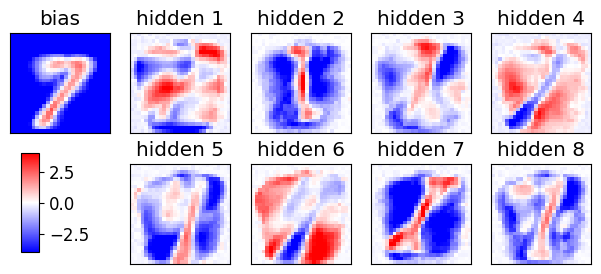

END of learning phase
END of learning phase
END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

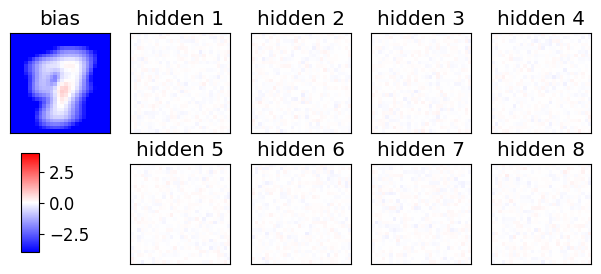

Starting the training
[13524 21518 12085  9988 20399  6131 15575 14250 20200 10884]
[  902  8225  6524 12487 11562  5363  6146  9340 15562 10575]
[19479 11622   980  2532 13597   710 13055  9850  8571 17887]
[19419 14428 16283  7065 11450 18867 20097  2636  6781 21568]
iteration 3 epoch 1 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 2 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 3 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 4 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 5 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 6 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 7 / 150  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 8 / 150  Nt: 4  N: 11  L: 8  rate: 0.05 

<Figure size 640x480 with 0 Axes>

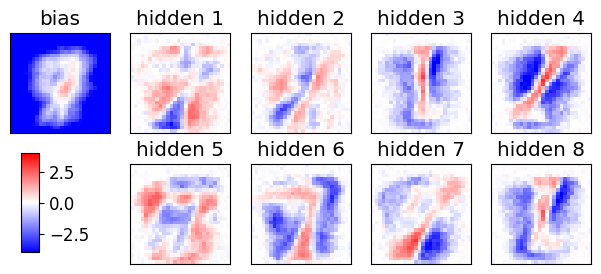

iteration 3 epoch 21 / 150  Nt: 4  N: 18  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 22 / 150  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 23 / 150  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 24 / 150  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 25 / 150  Nt: 4  N: 22  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 26 / 150  Nt: 4  N: 23  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 27 / 150  Nt: 4  N: 24  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 28 / 150  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 29 / 150  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 30 / 150  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 31 / 150  Nt

<Figure size 640x480 with 0 Axes>

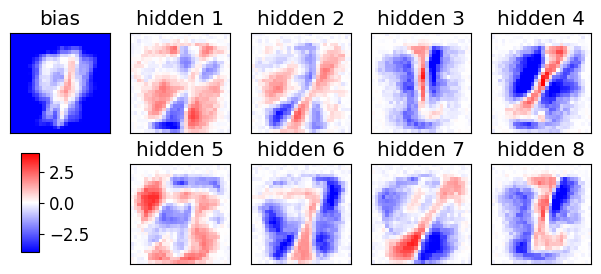

iteration 3 epoch 41 / 150  Nt: 4  N: 45  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 42 / 150  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 43 / 150  Nt: 4  N: 48  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 44 / 150  Nt: 4  N: 50  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 45 / 150  Nt: 4  N: 52  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 46 / 150  Nt: 4  N: 54  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 47 / 150  Nt: 4  N: 56  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 48 / 150  Nt: 4  N: 58  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 49 / 150  Nt: 4  N: 60  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 50 / 150  Nt: 4  N: 62  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 51 / 150  Nt

<Figure size 640x480 with 0 Axes>

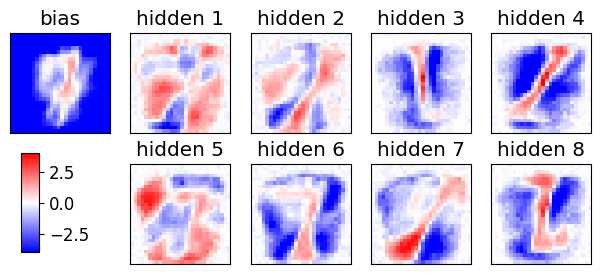

iteration 3 epoch 61 / 150  Nt: 4  N: 89  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 62 / 150  Nt: 4  N: 92  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 63 / 150  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 64 / 150  Nt: 4  N: 97  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 65 / 150  Nt: 4  N: 100  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 66 / 150  Nt: 4  N: 103  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 67 / 150  Nt: 4  N: 106  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 68 / 150  Nt: 4  N: 109  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 69 / 150  Nt: 4  N: 112  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 70 / 150  Nt: 4  N: 115  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 71 / 1

<Figure size 640x480 with 0 Axes>

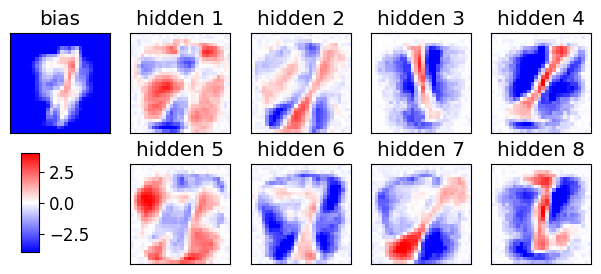

iteration 3 epoch 81 / 150  Nt: 4  N: 151  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 82 / 150  Nt: 4  N: 154  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 83 / 150  Nt: 4  N: 158  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 84 / 150  Nt: 4  N: 162  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 85 / 150  Nt: 4  N: 165  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 86 / 150  Nt: 4  N: 169  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 87 / 150  Nt: 4  N: 173  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 88 / 150  Nt: 4  N: 177  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 89 / 150  Nt: 4  N: 180  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 90 / 150  Nt: 4  N: 184  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 91

<Figure size 640x480 with 0 Axes>

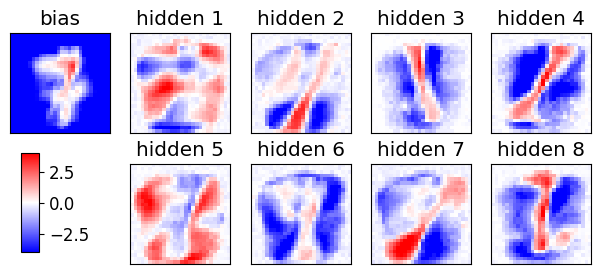

iteration 3 epoch 101 / 150  Nt: 4  N: 230  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 102 / 150  Nt: 4  N: 235  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 103 / 150  Nt: 4  N: 239  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 104 / 150  Nt: 4  N: 244  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 105 / 150  Nt: 4  N: 248  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 106 / 150  Nt: 4  N: 253  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 107 / 150  Nt: 4  N: 257  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 108 / 150  Nt: 4  N: 262  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 109 / 150  Nt: 4  N: 267  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 110 / 150  Nt: 4  N: 272  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

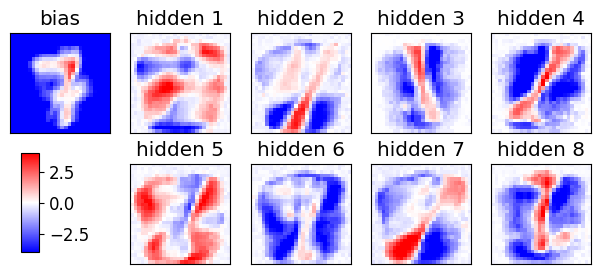

iteration 3 epoch 121 / 150  Nt: 4  N: 327  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 122 / 150  Nt: 4  N: 333  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 123 / 150  Nt: 4  N: 338  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 124 / 150  Nt: 4  N: 343  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 125 / 150  Nt: 4  N: 349  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 126 / 150  Nt: 4  N: 354  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 127 / 150  Nt: 4  N: 360  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 128 / 150  Nt: 4  N: 365  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 129 / 150  Nt: 4  N: 371  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 130 / 150  Nt: 4  N: 377  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 

<Figure size 640x480 with 0 Axes>

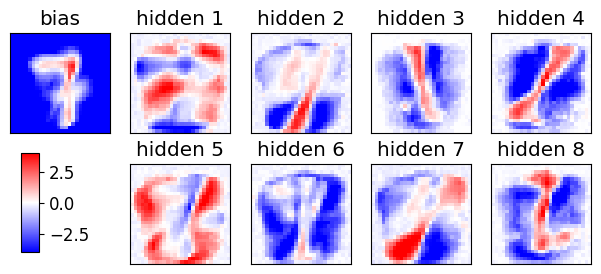

iteration 3 epoch 141 / 150  Nt: 4  N: 442  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 142 / 150  Nt: 4  N: 448  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 143 / 150  Nt: 4  N: 455  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 144 / 150  Nt: 4  N: 461  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 145 / 150  Nt: 4  N: 467  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 146 / 150  Nt: 4  N: 474  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 147 / 150  Nt: 4  N: 480  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 148 / 150  Nt: 4  N: 486  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 149 / 150  Nt: 4  N: 493  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False
iteration 3 epoch 150 / 150  Nt: 4  N: 500  L: 8  rate: 0.05  gam: 0.001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

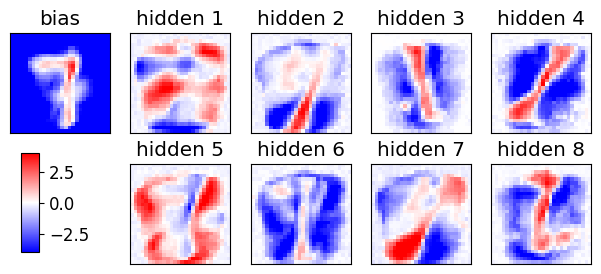

END of learning phase


In [121]:
for i in range(4):
    for L in L_v:
        if L == 8:
            iteration=i
            np.random.seed(12345*iteration)
            # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
            w = sigma * np.random.randn(D,L)
            #a = sigma * np.random.randn(D)
            # using Hinton initialization of visible biases
            a = Hinton_bias_init(data)
            # hidden biases initialized to zero
            b = np.zeros(L)
            #print("w=",w);print("a=",a);print("b=",b)
        
            # nr of epochs
            Nepoch=150
            # minibatches per epoch
            Nmini=20
            # minibatch size at initial epoch and final one
            N_ini,N_fin=10,500
            print(f"Nepoch={Nepoch}\nNmini={Nmini}")
        
        
            # recording history of weights ("E" means epoch)
            wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
            wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
            gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
            gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
            gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
            miniE = np.zeros(Nepoch+1)
            pzE=np.zeros((Nepoch+1,Nz))
            if GRAD=="RMSprop":
                gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)
        
            indices=np.arange(Nd).astype("int")
            plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)
        
            # for the plot with panels
            Ncols=min(8,max(2,L//2))
        
            if POTTS: print("Starting the training, POTTS=True")
            else: print("Starting the training")
        
            # Note: here an epoch does not analyze the whole dataset
            for epoch in range(1,1+Nepoch):
                # q maps epochs to interval [0,1]
                q = (epoch-1.)/(Nepoch-1.)
                # N, size of the mini batch
                # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
                N = int(N_ini + (N_fin-N_ini)*(q**2))
                #  l_rate interpolates between initial and final value
                l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q
        
                for mini in range(Nmini):
                    # initializitation for averages in minibatch
                    # visible variables "v" --> "x"
                    #  hidden variables "h" --> "z"
                    x_data, x_model = np.zeros(D),np.zeros(D)
                    z_data, z_model = np.zeros(L),np.zeros(L)
                    xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                    pz = np.zeros(L)
        
                    # Minibatch of size N: points randomply picked (without repetition) from data
                    selected = np.random.choice(indices,N,replace=False)
                    if epoch==1 and mini<=3: print(selected)
        
                    for k in range(N):
                        ###################################
                        x0 = data[selected[k]]
                        # positive CD phase: generating z from x[k]
                        z = CD_step(x0,w,b,POTTS=POTTS)
                        x_data  += x0
                        z_data  += z
                        xz_data += np.outer(x0,z)
                        # fantasy
                        zf=np.copy(z)
                        # Contrastive divergence with Nt steps
                        for t in range(Nt):
                            # negative CD pzase: generating fantasy xf from fantasy zf
                            xf = CD_step(zf,w.T,a)
                            # positive CD phase: generating fantasy zf from fantasy xf
                            zf = CD_step(xf,w,b,POTTS=POTTS)
                        x_model += xf
                        z_model += zf
                        xz_model+= np.outer(xf,zf)
                        # recording probability of encoding in z-space, if POTTS
                        if POTTS: pz[zf]+=1
        
                    # gradient of the likelihood: follow it along its positive direction
                    gw_d,gw_m = xz_data/N, xz_model/N
                    ga_d,ga_m = x_data/N, x_model/N
                    gb_d,gb_m = z_data/N, z_model/N
                    gw=np.copy(gw_d - gw_m)
                    ga=np.copy(ga_d - ga_m)
                    gb=np.copy(gb_d - gb_m)
        
                    # gradient ascent step
                    if GRAD=="RMSprop":
                        # RMSprop gradient ascent
                        gw2 = beta*gw2+(1-beta)*np.square(gw)
                        ga2 = beta*ga2+(1-beta)*np.square(ga)
                        gb2 = beta*gb2+(1-beta)*np.square(gb)
                        w += l_rate*gw/sqrt(epsilon+gw2)
                        a += l_rate*ga/sqrt(epsilon+ga2)
                        b += l_rate*gb/sqrt(epsilon+gb2)
                    else:
                        # defaulting to the vanilla stochastic gradient ascent (SGD)
                        w += l_rate*gw
                        a += l_rate*ga
                        b += l_rate*gb
                    # regularization (LASSO)
                    if gamma>0.:
                        w -= (gamma*l_rate)*sign(w)
                        a -= (gamma*l_rate)*sign(a)
                        b -= (gamma*l_rate)*sign(b)
        
                wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
                aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
                bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
                miniE[epoch]=N
                if POTTS: pzE[epoch] = pz/np.sum(pz)
                print("iteration",iteration,"epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                      " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)
        
                if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                    plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)
        
                str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
            save_epochs(wE,"w")
            save_epochs(bE,"b")
            save_epochs(aE,"a")
        
        print("END of learning phase")


Log-likelihood calculation: **DA FINIRE/ SOSTUTUIRE INCOLLANDO QUELLO FINITO!!**

In [ ]:
log_like_8=[]
log_like_8_std=[]
Nepoch=150

num_epo=np.arange(Nepoch-10,Nepoch,1) # consider trend over the last 5 iterations

for iteration in range(4):
    L=8
    Nt=4

    a_all = np.load(f"WEIGHTS/a_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_{iteration}_reg0.001.npy", allow_pickle=True)
    print(f'a_all iteration={i}, L={L}, Nt={Nt},gamma={0.01}')
    b_all= np.load(f"WEIGHTS/b_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_{iteration}_reg0.001.npy", allow_pickle=True)
    print(f'b_all iteration={i}, L={L}, Nt={Nt},gamma={0.01}')
    w_all=np.load(f"WEIGHTS/w_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_{iteration}_reg0.001.npy", allow_pickle=True)
    print(f'w_all iteration={i}, L={L}, Nt={Nt},gamma={0.01}') ## matrice visible*hidden per epoch

    log_like_8_iter=[]
    log_like_8_iter_std=[]
    Nepoch=150
    for i in range(Nepoch-10,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter=[]
        mean=[]
        for iter in range(5): # to determine the loglike at each epoch we run the calculation 5 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like_8_iter.append(ll_mean)
        log_like_8_iter_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_8.append(log_like_8_iter)
    log_like_8_std.append(log_like_8_iter_std)


a_all iteration=140, L=8, Nt=4,gamma=0.01
b_all iteration=140, L=8, Nt=4,gamma=0.01
w_all iteration=140, L=8, Nt=4,gamma=0.01
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:38<00:00, 55.59it/s]


Log-likelihood= -127.44796908573483 +- 0.5194814560774086
Epoch n.141


Computing log-likelihood:  11%|█████▉                                                | 600/5498 [00:10<01:27, 56.05it/s]

## POTTS with SGD

In [86]:
POTTS=True
L_v= [3,4,5,6,8]
Nt=4
gamma=0.01
GRAD=GRAD_list[0] # SGD algorithm for likelihood maximization
if GRAD=="SGD":
    l_rate_ini,l_rate_fin=1.0,0.25

Nepoch=500
Nmini=20


<Figure size 640x480 with 0 Axes>

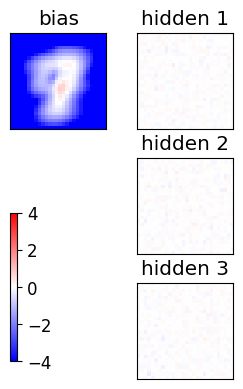

Starting the training, POTTS=True
[ 4230  1590  5188 15336  4042  4536 15380  9426  5043 14730]
[ 8320 17919 13287  2792 13737  9593 16448  2427 11839  6254]
[19765  2160  9322  2368 15034  3423  4708  9976  8541  8811]
[21729  5069 13274 19096  2939 16646 10539  1584  1410  8017]
epoch 1 / 500  Nt: 4  N: 10  L: 3  rate: 1.0  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 500  Nt: 4  N: 10  L: 3  rate: 0.998496993987976  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 500  Nt: 4  N: 10  L: 3  rate: 0.996993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 500  Nt: 4  N: 10  L: 3  rate: 0.9954909819639278  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 500  Nt: 4  N: 10  L: 3  rate: 0.9939879759519038  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 500  Nt: 4  N: 10  L: 3  rate: 0.9924849699398798  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 500  Nt: 4  N: 10  L: 3  rate: 0.9909819639278558  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 500  Nt: 4  N: 10  L: 3  rate: 0.9894789579158316  ga

<Figure size 640x480 with 0 Axes>

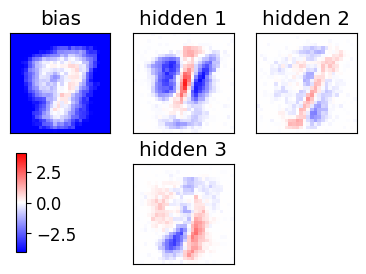

epoch 21 / 500  Nt: 4  N: 10  L: 3  rate: 0.969939879759519  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 500  Nt: 4  N: 10  L: 3  rate: 0.968436873747495  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 500  Nt: 4  N: 10  L: 3  rate: 0.966933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 500  Nt: 4  N: 11  L: 3  rate: 0.9654308617234469  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 500  Nt: 4  N: 11  L: 3  rate: 0.9639278557114228  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 500  Nt: 4  N: 11  L: 3  rate: 0.9624248496993988  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 500  Nt: 4  N: 11  L: 3  rate: 0.9609218436873748  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 500  Nt: 4  N: 11  L: 3  rate: 0.9594188376753507  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 500  Nt: 4  N: 11  L: 3  rate: 0.9579158316633266  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 500  Nt: 4  N: 11  L: 3  rate: 0.9564128256513026  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 500  Nt: 4  N: 11  L: 

<Figure size 640x480 with 0 Axes>

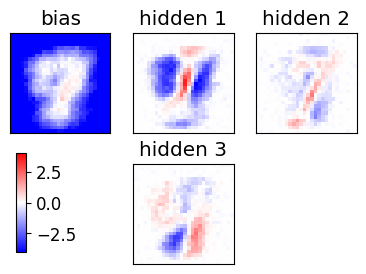

epoch 41 / 500  Nt: 4  N: 13  L: 3  rate: 0.9398797595190381  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 500  Nt: 4  N: 13  L: 3  rate: 0.938376753507014  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 500  Nt: 4  N: 13  L: 3  rate: 0.93687374749499  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 500  Nt: 4  N: 13  L: 3  rate: 0.935370741482966  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 500  Nt: 4  N: 13  L: 3  rate: 0.9338677354709419  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 500  Nt: 4  N: 13  L: 3  rate: 0.9323647294589178  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 500  Nt: 4  N: 14  L: 3  rate: 0.9308617234468938  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 500  Nt: 4  N: 14  L: 3  rate: 0.9293587174348698  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 500  Nt: 4  N: 14  L: 3  rate: 0.9278557114228457  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 500  Nt: 4  N: 14  L: 3  rate: 0.9263527054108216  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 500  Nt: 4  N: 14  L: 3

<Figure size 640x480 with 0 Axes>

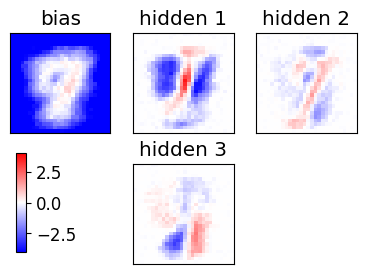

epoch 61 / 500  Nt: 4  N: 17  L: 3  rate: 0.9098196392785571  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 500  Nt: 4  N: 17  L: 3  rate: 0.9083166332665331  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 500  Nt: 4  N: 17  L: 3  rate: 0.906813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 500  Nt: 4  N: 17  L: 3  rate: 0.905310621242485  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 500  Nt: 4  N: 18  L: 3  rate: 0.9038076152304609  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 500  Nt: 4  N: 18  L: 3  rate: 0.9023046092184369  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 500  Nt: 4  N: 18  L: 3  rate: 0.9008016032064128  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 500  Nt: 4  N: 18  L: 3  rate: 0.8992985971943888  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 500  Nt: 4  N: 19  L: 3  rate: 0.8977955911823647  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 500  Nt: 4  N: 19  L: 3  rate: 0.8962925851703407  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 500  Nt: 4  N: 19  L:

<Figure size 640x480 with 0 Axes>

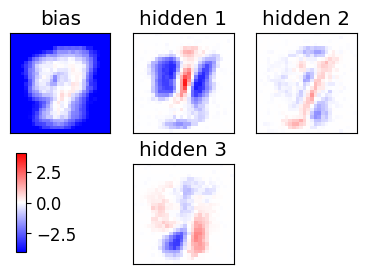

epoch 81 / 500  Nt: 4  N: 22  L: 3  rate: 0.8797595190380761  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 500  Nt: 4  N: 22  L: 3  rate: 0.8782565130260521  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 500  Nt: 4  N: 23  L: 3  rate: 0.8767535070140281  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 500  Nt: 4  N: 23  L: 3  rate: 0.875250501002004  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 500  Nt: 4  N: 23  L: 3  rate: 0.87374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 500  Nt: 4  N: 24  L: 3  rate: 0.8722444889779559  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 500  Nt: 4  N: 24  L: 3  rate: 0.8707414829659319  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 500  Nt: 4  N: 24  L: 3  rate: 0.8692384769539079  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 500  Nt: 4  N: 25  L: 3  rate: 0.8677354709418837  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 500  Nt: 4  N: 25  L: 3  rate: 0.8662324649298597  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 500  Nt: 4  N: 25  L: 

<Figure size 640x480 with 0 Axes>

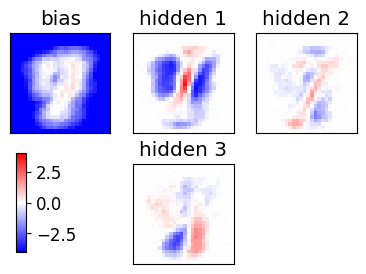

epoch 101 / 500  Nt: 4  N: 29  L: 3  rate: 0.8496993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 500  Nt: 4  N: 30  L: 3  rate: 0.8481963927855711  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 500  Nt: 4  N: 30  L: 3  rate: 0.8466933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 500  Nt: 4  N: 30  L: 3  rate: 0.8451903807615231  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 500  Nt: 4  N: 31  L: 3  rate: 0.8436873747494991  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 500  Nt: 4  N: 31  L: 3  rate: 0.8421843687374749  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 500  Nt: 4  N: 32  L: 3  rate: 0.8406813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 500  Nt: 4  N: 32  L: 3  rate: 0.8391783567134269  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 500  Nt: 4  N: 32  L: 3  rate: 0.8376753507014028  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 500  Nt: 4  N: 33  L: 3  rate: 0.8361723446893787  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 500  Nt:

<Figure size 640x480 with 0 Axes>

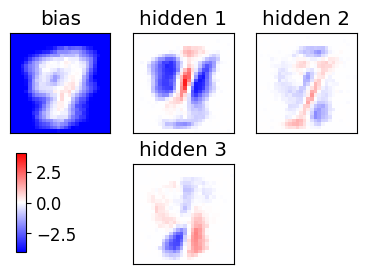

epoch 121 / 500  Nt: 4  N: 38  L: 3  rate: 0.8196392785571143  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 500  Nt: 4  N: 38  L: 3  rate: 0.8181362725450902  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 500  Nt: 4  N: 39  L: 3  rate: 0.8166332665330661  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 500  Nt: 4  N: 39  L: 3  rate: 0.8151302605210421  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 500  Nt: 4  N: 40  L: 3  rate: 0.8136272545090181  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 500  Nt: 4  N: 40  L: 3  rate: 0.8121242484969939  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 500  Nt: 4  N: 41  L: 3  rate: 0.8106212424849699  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 500  Nt: 4  N: 41  L: 3  rate: 0.8091182364729459  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 500  Nt: 4  N: 42  L: 3  rate: 0.8076152304609219  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 500  Nt: 4  N: 42  L: 3  rate: 0.8061122244488979  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 500  Nt:

<Figure size 640x480 with 0 Axes>

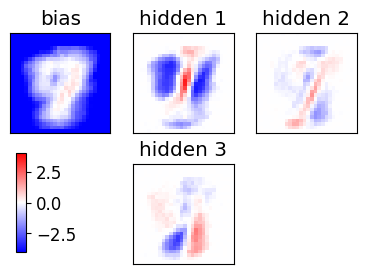

epoch 141 / 500  Nt: 4  N: 48  L: 3  rate: 0.7895791583166333  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 500  Nt: 4  N: 49  L: 3  rate: 0.7880761523046091  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 500  Nt: 4  N: 49  L: 3  rate: 0.7865731462925851  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 500  Nt: 4  N: 50  L: 3  rate: 0.7850701402805611  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 500  Nt: 4  N: 50  L: 3  rate: 0.7835671342685371  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 500  Nt: 4  N: 51  L: 3  rate: 0.7820641282565131  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 500  Nt: 4  N: 51  L: 3  rate: 0.780561122244489  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 500  Nt: 4  N: 52  L: 3  rate: 0.7790581162324649  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 500  Nt: 4  N: 53  L: 3  rate: 0.7775551102204409  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 500  Nt: 4  N: 53  L: 3  rate: 0.7760521042084167  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

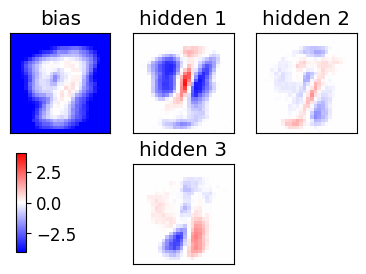

epoch 161 / 500  Nt: 4  N: 60  L: 3  rate: 0.7595190380761523  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 500  Nt: 4  N: 61  L: 3  rate: 0.7580160320641283  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 500  Nt: 4  N: 61  L: 3  rate: 0.7565130260521042  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 500  Nt: 4  N: 62  L: 3  rate: 0.7550100200400802  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 500  Nt: 4  N: 62  L: 3  rate: 0.7535070140280561  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 500  Nt: 4  N: 63  L: 3  rate: 0.7520040080160321  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 500  Nt: 4  N: 64  L: 3  rate: 0.750501002004008  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 500  Nt: 4  N: 64  L: 3  rate: 0.7489979959919839  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 500  Nt: 4  N: 65  L: 3  rate: 0.7474949899799599  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 500  Nt: 4  N: 66  L: 3  rate: 0.7459919839679359  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

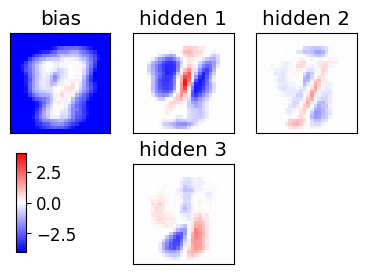

epoch 181 / 500  Nt: 4  N: 73  L: 3  rate: 0.7294589178356713  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 500  Nt: 4  N: 74  L: 3  rate: 0.7279559118236474  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 500  Nt: 4  N: 75  L: 3  rate: 0.7264529058116233  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 500  Nt: 4  N: 75  L: 3  rate: 0.7249498997995992  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 500  Nt: 4  N: 76  L: 3  rate: 0.7234468937875751  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 500  Nt: 4  N: 77  L: 3  rate: 0.7219438877755511  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 500  Nt: 4  N: 78  L: 3  rate: 0.720440881763527  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 500  Nt: 4  N: 78  L: 3  rate: 0.718937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 500  Nt: 4  N: 79  L: 3  rate: 0.717434869739479  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 500  Nt: 4  N: 80  L: 3  rate: 0.715931863727455  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 500  Nt: 4  

<Figure size 640x480 with 0 Axes>

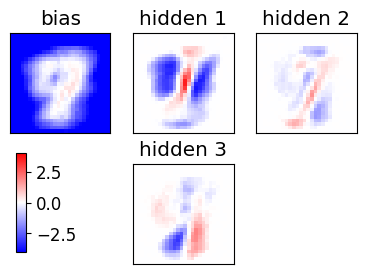

epoch 201 / 500  Nt: 4  N: 88  L: 3  rate: 0.6993987975951903  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 500  Nt: 4  N: 89  L: 3  rate: 0.6978957915831663  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 500  Nt: 4  N: 90  L: 3  rate: 0.6963927855711423  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 500  Nt: 4  N: 91  L: 3  rate: 0.6948897795591182  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 500  Nt: 4  N: 91  L: 3  rate: 0.6933867735470942  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 500  Nt: 4  N: 92  L: 3  rate: 0.6918837675350702  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 500  Nt: 4  N: 93  L: 3  rate: 0.6903807615230461  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 500  Nt: 4  N: 94  L: 3  rate: 0.688877755511022  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 500  Nt: 4  N: 95  L: 3  rate: 0.687374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 500  Nt: 4  N: 95  L: 3  rate: 0.685871743486974  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 500  Nt: 4 

<Figure size 640x480 with 0 Axes>

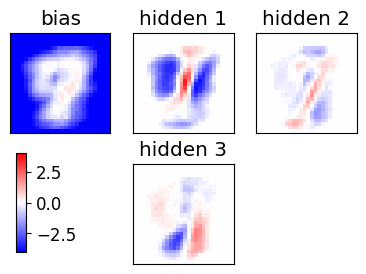

epoch 221 / 500  Nt: 4  N: 105  L: 3  rate: 0.6693386773547094  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 500  Nt: 4  N: 106  L: 3  rate: 0.6678356713426854  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 500  Nt: 4  N: 106  L: 3  rate: 0.6663326653306614  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 500  Nt: 4  N: 107  L: 3  rate: 0.6648296593186372  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 500  Nt: 4  N: 108  L: 3  rate: 0.6633266533066132  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 500  Nt: 4  N: 109  L: 3  rate: 0.6618236472945892  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 500  Nt: 4  N: 110  L: 3  rate: 0.6603206412825651  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 500  Nt: 4  N: 111  L: 3  rate: 0.658817635270541  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 500  Nt: 4  N: 112  L: 3  rate: 0.657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 500  Nt: 4  N: 113  L: 3  rate: 0.655811623246493  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 5

<Figure size 640x480 with 0 Axes>

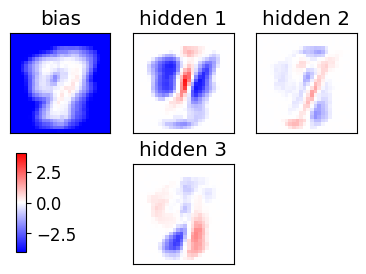

epoch 241 / 500  Nt: 4  N: 123  L: 3  rate: 0.6392785571142285  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 500  Nt: 4  N: 124  L: 3  rate: 0.6377755511022044  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 500  Nt: 4  N: 125  L: 3  rate: 0.6362725450901804  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 500  Nt: 4  N: 126  L: 3  rate: 0.6347695390781563  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 500  Nt: 4  N: 127  L: 3  rate: 0.6332665330661322  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 500  Nt: 4  N: 128  L: 3  rate: 0.6317635270541082  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 500  Nt: 4  N: 129  L: 3  rate: 0.6302605210420842  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 500  Nt: 4  N: 130  L: 3  rate: 0.6287575150300602  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 500  Nt: 4  N: 131  L: 3  rate: 0.6272545090180361  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 500  Nt: 4  N: 132  L: 3  rate: 0.625751503006012  gam: 0.01 SPINS= False POTTS= True
epoch 251 /

<Figure size 640x480 with 0 Axes>

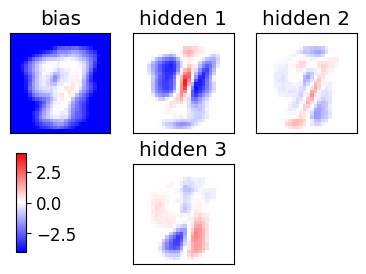

epoch 261 / 500  Nt: 4  N: 143  L: 3  rate: 0.6092184368737475  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 500  Nt: 4  N: 144  L: 3  rate: 0.6077154308617234  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 500  Nt: 4  N: 145  L: 3  rate: 0.6062124248496994  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 500  Nt: 4  N: 146  L: 3  rate: 0.6047094188376754  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 500  Nt: 4  N: 147  L: 3  rate: 0.6032064128256514  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 500  Nt: 4  N: 148  L: 3  rate: 0.6017034068136273  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 500  Nt: 4  N: 149  L: 3  rate: 0.6002004008016032  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 500  Nt: 4  N: 150  L: 3  rate: 0.5986973947895792  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 500  Nt: 4  N: 151  L: 3  rate: 0.5971943887775552  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 500  Nt: 4  N: 152  L: 3  rate: 0.595691382765531  gam: 0.01 SPINS= False POTTS= True
epoch 271 /

<Figure size 640x480 with 0 Axes>

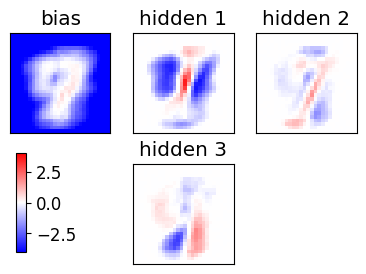

epoch 281 / 500  Nt: 4  N: 164  L: 3  rate: 0.5791583166332666  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 500  Nt: 4  N: 165  L: 3  rate: 0.5776553106212425  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 500  Nt: 4  N: 166  L: 3  rate: 0.5761523046092184  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 500  Nt: 4  N: 167  L: 3  rate: 0.5746492985971944  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 500  Nt: 4  N: 168  L: 3  rate: 0.5731462925851704  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 500  Nt: 4  N: 169  L: 3  rate: 0.5716432865731462  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 500  Nt: 4  N: 170  L: 3  rate: 0.5701402805611222  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 500  Nt: 4  N: 172  L: 3  rate: 0.5686372745490982  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 500  Nt: 4  N: 173  L: 3  rate: 0.5671342685370742  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 500  Nt: 4  N: 174  L: 3  rate: 0.5656312625250501  gam: 0.01 SPINS= False POTTS= True
epoch 291 

<Figure size 640x480 with 0 Axes>

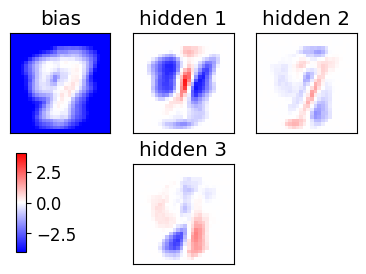

epoch 301 / 500  Nt: 4  N: 187  L: 3  rate: 0.5490981963927856  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 500  Nt: 4  N: 188  L: 3  rate: 0.5475951903807614  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 500  Nt: 4  N: 189  L: 3  rate: 0.5460921843687374  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 500  Nt: 4  N: 190  L: 3  rate: 0.5445891783567134  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 500  Nt: 4  N: 191  L: 3  rate: 0.5430861723446894  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 500  Nt: 4  N: 193  L: 3  rate: 0.5415831663326653  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 500  Nt: 4  N: 194  L: 3  rate: 0.5400801603206413  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 500  Nt: 4  N: 195  L: 3  rate: 0.5385771543086173  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 500  Nt: 4  N: 196  L: 3  rate: 0.5370741482965933  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 500  Nt: 4  N: 197  L: 3  rate: 0.5355711422845691  gam: 0.01 SPINS= False POTTS= True
epoch 311 

<Figure size 640x480 with 0 Axes>

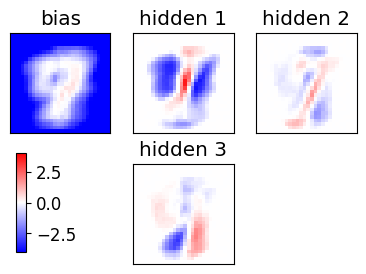

epoch 321 / 500  Nt: 4  N: 211  L: 3  rate: 0.5190380761523046  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 500  Nt: 4  N: 212  L: 3  rate: 0.5175350701402806  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 500  Nt: 4  N: 214  L: 3  rate: 0.5160320641282565  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 500  Nt: 4  N: 215  L: 3  rate: 0.5145290581162325  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 500  Nt: 4  N: 216  L: 3  rate: 0.5130260521042085  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 500  Nt: 4  N: 217  L: 3  rate: 0.5115230460921844  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 500  Nt: 4  N: 219  L: 3  rate: 0.5100200400801603  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 500  Nt: 4  N: 220  L: 3  rate: 0.5085170340681363  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 500  Nt: 4  N: 221  L: 3  rate: 0.5070140280561122  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 500  Nt: 4  N: 223  L: 3  rate: 0.5055110220440882  gam: 0.01 SPINS= False POTTS= True
epoch 331 

<Figure size 640x480 with 0 Axes>

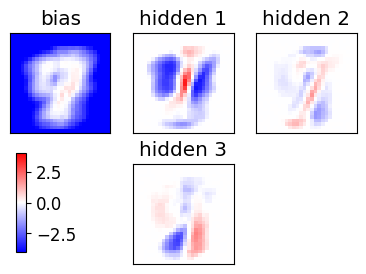

epoch 341 / 500  Nt: 4  N: 237  L: 3  rate: 0.4889779559118237  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 500  Nt: 4  N: 238  L: 3  rate: 0.48747494989979956  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 500  Nt: 4  N: 240  L: 3  rate: 0.48597194388777554  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 500  Nt: 4  N: 241  L: 3  rate: 0.4844689378757515  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 500  Nt: 4  N: 242  L: 3  rate: 0.4829659318637274  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 500  Nt: 4  N: 244  L: 3  rate: 0.48146292585170336  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 500  Nt: 4  N: 245  L: 3  rate: 0.47995991983967934  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 500  Nt: 4  N: 246  L: 3  rate: 0.4784569138276553  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 500  Nt: 4  N: 248  L: 3  rate: 0.4769539078156313  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 500  Nt: 4  N: 249  L: 3  rate: 0.47545090180360716  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

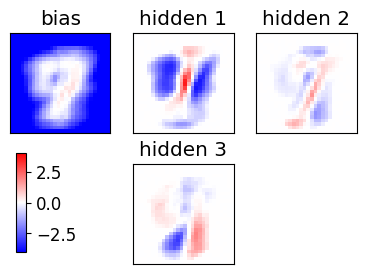

epoch 361 / 500  Nt: 4  N: 265  L: 3  rate: 0.4589178356713426  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 500  Nt: 4  N: 266  L: 3  rate: 0.4574148296593187  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 500  Nt: 4  N: 267  L: 3  rate: 0.45591182364729466  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 500  Nt: 4  N: 269  L: 3  rate: 0.4544088176352705  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 500  Nt: 4  N: 270  L: 3  rate: 0.4529058116232465  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 500  Nt: 4  N: 272  L: 3  rate: 0.4514028056112225  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 500  Nt: 4  N: 273  L: 3  rate: 0.44989979959919846  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 500  Nt: 4  N: 275  L: 3  rate: 0.44839679358717444  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 500  Nt: 4  N: 276  L: 3  rate: 0.4468937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 500  Nt: 4  N: 277  L: 3  rate: 0.4453907815631263  gam: 0.01 SPINS= False POTTS= True
epoch 3

<Figure size 640x480 with 0 Axes>

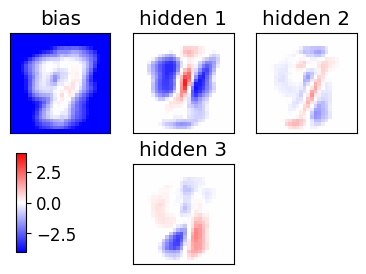

epoch 381 / 500  Nt: 4  N: 294  L: 3  rate: 0.4288577154308617  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 500  Nt: 4  N: 295  L: 3  rate: 0.4273547094188377  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 500  Nt: 4  N: 297  L: 3  rate: 0.42585170340681366  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 500  Nt: 4  N: 298  L: 3  rate: 0.42434869739478964  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 500  Nt: 4  N: 300  L: 3  rate: 0.4228456913827655  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 500  Nt: 4  N: 301  L: 3  rate: 0.4213426853707415  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 500  Nt: 4  N: 303  L: 3  rate: 0.41983967935871747  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 500  Nt: 4  N: 304  L: 3  rate: 0.41833667334669333  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 500  Nt: 4  N: 306  L: 3  rate: 0.4168336673346693  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 500  Nt: 4  N: 307  L: 3  rate: 0.4153306613226453  gam: 0.01 SPINS= False POTTS= True
epoch 

<Figure size 640x480 with 0 Axes>

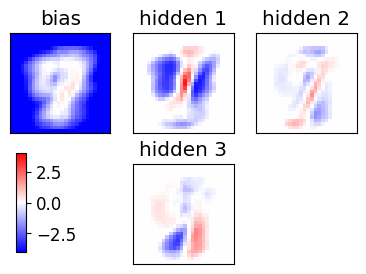

epoch 401 / 500  Nt: 4  N: 324  L: 3  rate: 0.3987975951903807  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 500  Nt: 4  N: 326  L: 3  rate: 0.3972945891783567  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 500  Nt: 4  N: 328  L: 3  rate: 0.39579158316633267  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 500  Nt: 4  N: 329  L: 3  rate: 0.39428857715430854  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 500  Nt: 4  N: 331  L: 3  rate: 0.3927855711422845  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 500  Nt: 4  N: 332  L: 3  rate: 0.3912825651302605  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 500  Nt: 4  N: 334  L: 3  rate: 0.3897795591182365  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 500  Nt: 4  N: 335  L: 3  rate: 0.38827655310621245  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 500  Nt: 4  N: 337  L: 3  rate: 0.3867735470941883  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 500  Nt: 4  N: 339  L: 3  rate: 0.3852705410821643  gam: 0.01 SPINS= False POTTS= True
epoch 4

<Figure size 640x480 with 0 Axes>

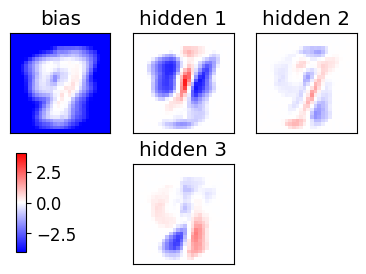

epoch 421 / 500  Nt: 4  N: 357  L: 3  rate: 0.36873747494989983  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 500  Nt: 4  N: 358  L: 3  rate: 0.3672344689378758  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 500  Nt: 4  N: 360  L: 3  rate: 0.3657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 500  Nt: 4  N: 362  L: 3  rate: 0.36422845691382766  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 500  Nt: 4  N: 363  L: 3  rate: 0.36272545090180364  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 500  Nt: 4  N: 365  L: 3  rate: 0.3612224448897796  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 500  Nt: 4  N: 367  L: 3  rate: 0.3597194388777556  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 500  Nt: 4  N: 368  L: 3  rate: 0.35821643286573146  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 500  Nt: 4  N: 370  L: 3  rate: 0.35671342685370744  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 500  Nt: 4  N: 372  L: 3  rate: 0.3552104208416834  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

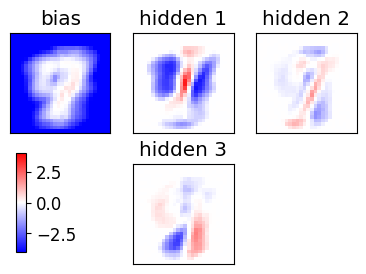

epoch 441 / 500  Nt: 4  N: 390  L: 3  rate: 0.33867735470941884  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 500  Nt: 4  N: 392  L: 3  rate: 0.3371743486973948  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 500  Nt: 4  N: 394  L: 3  rate: 0.3356713426853708  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 500  Nt: 4  N: 396  L: 3  rate: 0.33416833667334667  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 500  Nt: 4  N: 397  L: 3  rate: 0.33266533066132264  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 500  Nt: 4  N: 399  L: 3  rate: 0.3311623246492986  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 500  Nt: 4  N: 401  L: 3  rate: 0.3296593186372745  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 500  Nt: 4  N: 403  L: 3  rate: 0.32815631262525047  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 500  Nt: 4  N: 404  L: 3  rate: 0.32665330661322645  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 500  Nt: 4  N: 406  L: 3  rate: 0.3251503006012024  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

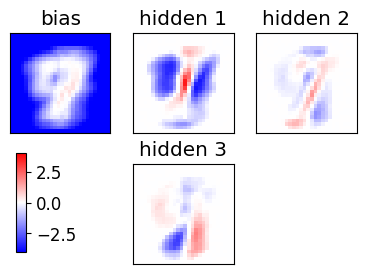

epoch 461 / 500  Nt: 4  N: 426  L: 3  rate: 0.30861723446893785  gam: 0.01 SPINS= False POTTS= True
epoch 462 / 500  Nt: 4  N: 428  L: 3  rate: 0.30711422845691383  gam: 0.01 SPINS= False POTTS= True
epoch 463 / 500  Nt: 4  N: 430  L: 3  rate: 0.3056112224448897  gam: 0.01 SPINS= False POTTS= True
epoch 464 / 500  Nt: 4  N: 431  L: 3  rate: 0.3041082164328657  gam: 0.01 SPINS= False POTTS= True
epoch 465 / 500  Nt: 4  N: 433  L: 3  rate: 0.30260521042084165  gam: 0.01 SPINS= False POTTS= True
epoch 466 / 500  Nt: 4  N: 435  L: 3  rate: 0.30110220440881763  gam: 0.01 SPINS= False POTTS= True
epoch 467 / 500  Nt: 4  N: 437  L: 3  rate: 0.2995991983967936  gam: 0.01 SPINS= False POTTS= True
epoch 468 / 500  Nt: 4  N: 439  L: 3  rate: 0.2980961923847695  gam: 0.01 SPINS= False POTTS= True
epoch 469 / 500  Nt: 4  N: 441  L: 3  rate: 0.29659318637274545  gam: 0.01 SPINS= False POTTS= True
epoch 470 / 500  Nt: 4  N: 442  L: 3  rate: 0.29509018036072143  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

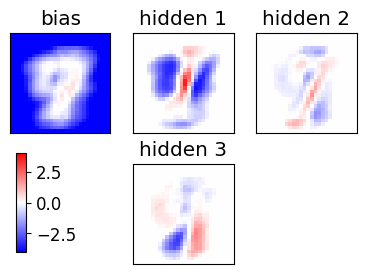

epoch 481 / 500  Nt: 4  N: 463  L: 3  rate: 0.27855711422845697  gam: 0.01 SPINS= False POTTS= True
epoch 482 / 500  Nt: 4  N: 465  L: 3  rate: 0.27705410821643284  gam: 0.01 SPINS= False POTTS= True
epoch 483 / 500  Nt: 4  N: 467  L: 3  rate: 0.2755511022044088  gam: 0.01 SPINS= False POTTS= True
epoch 484 / 500  Nt: 4  N: 469  L: 3  rate: 0.2740480961923848  gam: 0.01 SPINS= False POTTS= True
epoch 485 / 500  Nt: 4  N: 470  L: 3  rate: 0.27254509018036077  gam: 0.01 SPINS= False POTTS= True
epoch 486 / 500  Nt: 4  N: 472  L: 3  rate: 0.27104208416833675  gam: 0.01 SPINS= False POTTS= True
epoch 487 / 500  Nt: 4  N: 474  L: 3  rate: 0.2695390781563126  gam: 0.01 SPINS= False POTTS= True
epoch 488 / 500  Nt: 4  N: 476  L: 3  rate: 0.2680360721442886  gam: 0.01 SPINS= False POTTS= True
epoch 489 / 500  Nt: 4  N: 478  L: 3  rate: 0.2665330661322646  gam: 0.01 SPINS= False POTTS= True
epoch 490 / 500  Nt: 4  N: 480  L: 3  rate: 0.26503006012024044  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

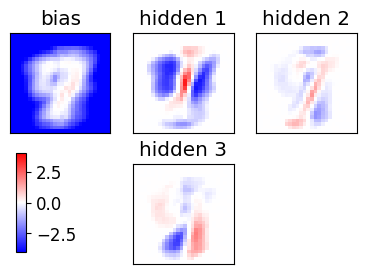

Nepoch=500
Nmini=20


<Figure size 640x480 with 0 Axes>

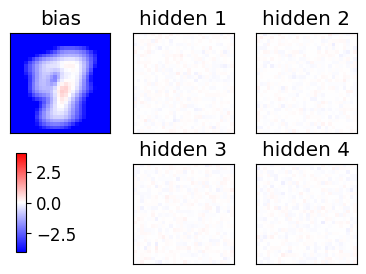

Starting the training, POTTS=True
[  748  4899 14613  7601 13907  1421 21880  9670 15225  6650]
[11405  1310  9520 21990  8636  7550 19671   404 11254  4416]
[  374 19142  7184  4955 16472 10641 15077 13229  3562 15455]
[ 3312  3878 11142 18416  3125 15188 18646  8642 15795  8608]
epoch 1 / 500  Nt: 4  N: 10  L: 4  rate: 1.0  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 500  Nt: 4  N: 10  L: 4  rate: 0.998496993987976  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 500  Nt: 4  N: 10  L: 4  rate: 0.996993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 500  Nt: 4  N: 10  L: 4  rate: 0.9954909819639278  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 500  Nt: 4  N: 10  L: 4  rate: 0.9939879759519038  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 500  Nt: 4  N: 10  L: 4  rate: 0.9924849699398798  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 500  Nt: 4  N: 10  L: 4  rate: 0.9909819639278558  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 500  Nt: 4  N: 10  L: 4  rate: 0.9894789579158316  ga

<Figure size 640x480 with 0 Axes>

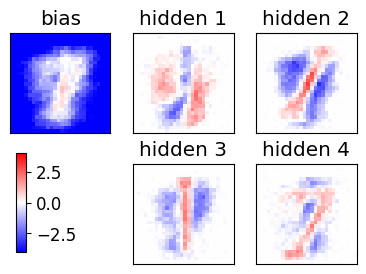

epoch 21 / 500  Nt: 4  N: 10  L: 4  rate: 0.969939879759519  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 500  Nt: 4  N: 10  L: 4  rate: 0.968436873747495  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 500  Nt: 4  N: 10  L: 4  rate: 0.966933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 500  Nt: 4  N: 11  L: 4  rate: 0.9654308617234469  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 500  Nt: 4  N: 11  L: 4  rate: 0.9639278557114228  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 500  Nt: 4  N: 11  L: 4  rate: 0.9624248496993988  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 500  Nt: 4  N: 11  L: 4  rate: 0.9609218436873748  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 500  Nt: 4  N: 11  L: 4  rate: 0.9594188376753507  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 500  Nt: 4  N: 11  L: 4  rate: 0.9579158316633266  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 500  Nt: 4  N: 11  L: 4  rate: 0.9564128256513026  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 500  Nt: 4  N: 11  L: 

<Figure size 640x480 with 0 Axes>

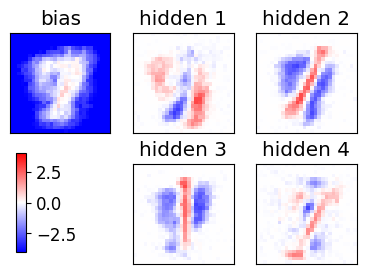

epoch 41 / 500  Nt: 4  N: 13  L: 4  rate: 0.9398797595190381  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 500  Nt: 4  N: 13  L: 4  rate: 0.938376753507014  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 500  Nt: 4  N: 13  L: 4  rate: 0.93687374749499  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 500  Nt: 4  N: 13  L: 4  rate: 0.935370741482966  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 500  Nt: 4  N: 13  L: 4  rate: 0.9338677354709419  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 500  Nt: 4  N: 13  L: 4  rate: 0.9323647294589178  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 500  Nt: 4  N: 14  L: 4  rate: 0.9308617234468938  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 500  Nt: 4  N: 14  L: 4  rate: 0.9293587174348698  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 500  Nt: 4  N: 14  L: 4  rate: 0.9278557114228457  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 500  Nt: 4  N: 14  L: 4  rate: 0.9263527054108216  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 500  Nt: 4  N: 14  L: 4

<Figure size 640x480 with 0 Axes>

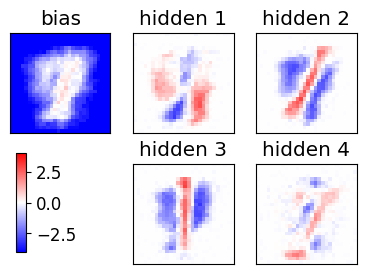

epoch 61 / 500  Nt: 4  N: 17  L: 4  rate: 0.9098196392785571  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 500  Nt: 4  N: 17  L: 4  rate: 0.9083166332665331  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 500  Nt: 4  N: 17  L: 4  rate: 0.906813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 500  Nt: 4  N: 17  L: 4  rate: 0.905310621242485  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 500  Nt: 4  N: 18  L: 4  rate: 0.9038076152304609  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 500  Nt: 4  N: 18  L: 4  rate: 0.9023046092184369  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 500  Nt: 4  N: 18  L: 4  rate: 0.9008016032064128  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 500  Nt: 4  N: 18  L: 4  rate: 0.8992985971943888  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 500  Nt: 4  N: 19  L: 4  rate: 0.8977955911823647  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 500  Nt: 4  N: 19  L: 4  rate: 0.8962925851703407  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 500  Nt: 4  N: 19  L:

<Figure size 640x480 with 0 Axes>

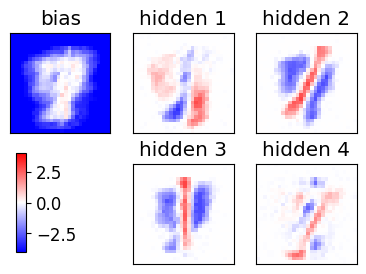

epoch 81 / 500  Nt: 4  N: 22  L: 4  rate: 0.8797595190380761  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 500  Nt: 4  N: 22  L: 4  rate: 0.8782565130260521  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 500  Nt: 4  N: 23  L: 4  rate: 0.8767535070140281  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 500  Nt: 4  N: 23  L: 4  rate: 0.875250501002004  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 500  Nt: 4  N: 23  L: 4  rate: 0.87374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 500  Nt: 4  N: 24  L: 4  rate: 0.8722444889779559  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 500  Nt: 4  N: 24  L: 4  rate: 0.8707414829659319  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 500  Nt: 4  N: 24  L: 4  rate: 0.8692384769539079  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 500  Nt: 4  N: 25  L: 4  rate: 0.8677354709418837  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 500  Nt: 4  N: 25  L: 4  rate: 0.8662324649298597  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 500  Nt: 4  N: 25  L: 

<Figure size 640x480 with 0 Axes>

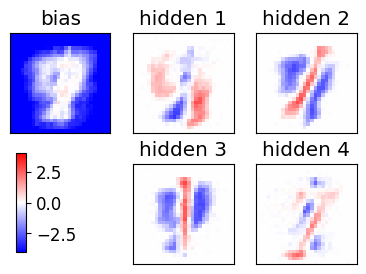

epoch 101 / 500  Nt: 4  N: 29  L: 4  rate: 0.8496993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 500  Nt: 4  N: 30  L: 4  rate: 0.8481963927855711  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 500  Nt: 4  N: 30  L: 4  rate: 0.8466933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 500  Nt: 4  N: 30  L: 4  rate: 0.8451903807615231  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 500  Nt: 4  N: 31  L: 4  rate: 0.8436873747494991  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 500  Nt: 4  N: 31  L: 4  rate: 0.8421843687374749  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 500  Nt: 4  N: 32  L: 4  rate: 0.8406813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 500  Nt: 4  N: 32  L: 4  rate: 0.8391783567134269  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 500  Nt: 4  N: 32  L: 4  rate: 0.8376753507014028  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 500  Nt: 4  N: 33  L: 4  rate: 0.8361723446893787  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 500  Nt:

<Figure size 640x480 with 0 Axes>

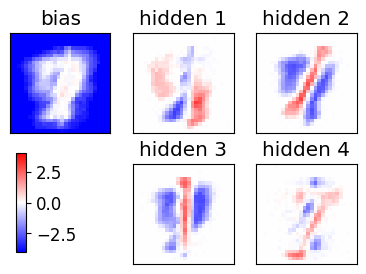

epoch 121 / 500  Nt: 4  N: 38  L: 4  rate: 0.8196392785571143  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 500  Nt: 4  N: 38  L: 4  rate: 0.8181362725450902  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 500  Nt: 4  N: 39  L: 4  rate: 0.8166332665330661  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 500  Nt: 4  N: 39  L: 4  rate: 0.8151302605210421  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 500  Nt: 4  N: 40  L: 4  rate: 0.8136272545090181  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 500  Nt: 4  N: 40  L: 4  rate: 0.8121242484969939  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 500  Nt: 4  N: 41  L: 4  rate: 0.8106212424849699  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 500  Nt: 4  N: 41  L: 4  rate: 0.8091182364729459  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 500  Nt: 4  N: 42  L: 4  rate: 0.8076152304609219  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 500  Nt: 4  N: 42  L: 4  rate: 0.8061122244488979  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 500  Nt:

<Figure size 640x480 with 0 Axes>

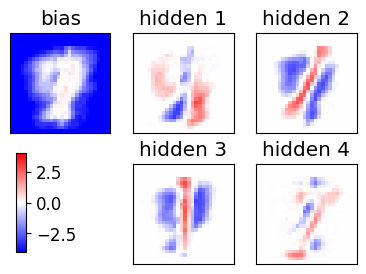

epoch 141 / 500  Nt: 4  N: 48  L: 4  rate: 0.7895791583166333  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 500  Nt: 4  N: 49  L: 4  rate: 0.7880761523046091  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 500  Nt: 4  N: 49  L: 4  rate: 0.7865731462925851  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 500  Nt: 4  N: 50  L: 4  rate: 0.7850701402805611  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 500  Nt: 4  N: 50  L: 4  rate: 0.7835671342685371  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 500  Nt: 4  N: 51  L: 4  rate: 0.7820641282565131  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 500  Nt: 4  N: 51  L: 4  rate: 0.780561122244489  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 500  Nt: 4  N: 52  L: 4  rate: 0.7790581162324649  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 500  Nt: 4  N: 53  L: 4  rate: 0.7775551102204409  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 500  Nt: 4  N: 53  L: 4  rate: 0.7760521042084167  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

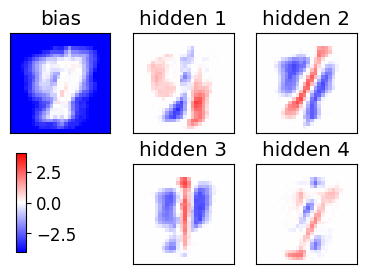

epoch 161 / 500  Nt: 4  N: 60  L: 4  rate: 0.7595190380761523  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 500  Nt: 4  N: 61  L: 4  rate: 0.7580160320641283  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 500  Nt: 4  N: 61  L: 4  rate: 0.7565130260521042  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 500  Nt: 4  N: 62  L: 4  rate: 0.7550100200400802  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 500  Nt: 4  N: 62  L: 4  rate: 0.7535070140280561  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 500  Nt: 4  N: 63  L: 4  rate: 0.7520040080160321  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 500  Nt: 4  N: 64  L: 4  rate: 0.750501002004008  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 500  Nt: 4  N: 64  L: 4  rate: 0.7489979959919839  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 500  Nt: 4  N: 65  L: 4  rate: 0.7474949899799599  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 500  Nt: 4  N: 66  L: 4  rate: 0.7459919839679359  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

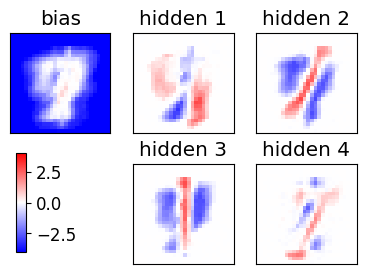

epoch 181 / 500  Nt: 4  N: 73  L: 4  rate: 0.7294589178356713  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 500  Nt: 4  N: 74  L: 4  rate: 0.7279559118236474  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 500  Nt: 4  N: 75  L: 4  rate: 0.7264529058116233  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 500  Nt: 4  N: 75  L: 4  rate: 0.7249498997995992  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 500  Nt: 4  N: 76  L: 4  rate: 0.7234468937875751  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 500  Nt: 4  N: 77  L: 4  rate: 0.7219438877755511  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 500  Nt: 4  N: 78  L: 4  rate: 0.720440881763527  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 500  Nt: 4  N: 78  L: 4  rate: 0.718937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 500  Nt: 4  N: 79  L: 4  rate: 0.717434869739479  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 500  Nt: 4  N: 80  L: 4  rate: 0.715931863727455  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 500  Nt: 4  

<Figure size 640x480 with 0 Axes>

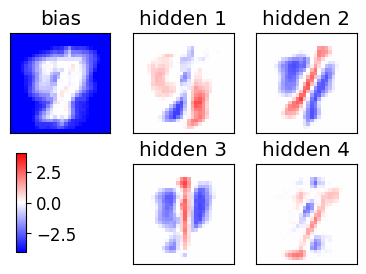

epoch 201 / 500  Nt: 4  N: 88  L: 4  rate: 0.6993987975951903  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 500  Nt: 4  N: 89  L: 4  rate: 0.6978957915831663  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 500  Nt: 4  N: 90  L: 4  rate: 0.6963927855711423  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 500  Nt: 4  N: 91  L: 4  rate: 0.6948897795591182  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 500  Nt: 4  N: 91  L: 4  rate: 0.6933867735470942  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 500  Nt: 4  N: 92  L: 4  rate: 0.6918837675350702  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 500  Nt: 4  N: 93  L: 4  rate: 0.6903807615230461  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 500  Nt: 4  N: 94  L: 4  rate: 0.688877755511022  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 500  Nt: 4  N: 95  L: 4  rate: 0.687374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 500  Nt: 4  N: 95  L: 4  rate: 0.685871743486974  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 500  Nt: 4 

<Figure size 640x480 with 0 Axes>

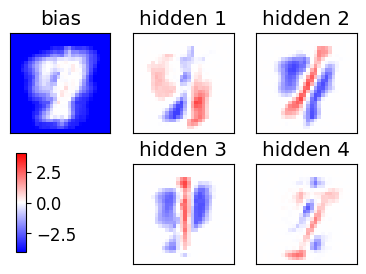

epoch 221 / 500  Nt: 4  N: 105  L: 4  rate: 0.6693386773547094  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 500  Nt: 4  N: 106  L: 4  rate: 0.6678356713426854  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 500  Nt: 4  N: 106  L: 4  rate: 0.6663326653306614  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 500  Nt: 4  N: 107  L: 4  rate: 0.6648296593186372  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 500  Nt: 4  N: 108  L: 4  rate: 0.6633266533066132  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 500  Nt: 4  N: 109  L: 4  rate: 0.6618236472945892  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 500  Nt: 4  N: 110  L: 4  rate: 0.6603206412825651  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 500  Nt: 4  N: 111  L: 4  rate: 0.658817635270541  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 500  Nt: 4  N: 112  L: 4  rate: 0.657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 500  Nt: 4  N: 113  L: 4  rate: 0.655811623246493  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 5

<Figure size 640x480 with 0 Axes>

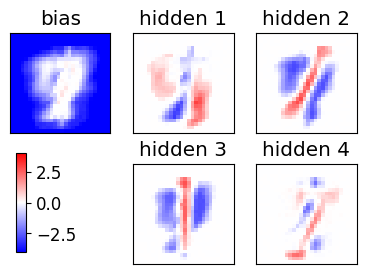

epoch 241 / 500  Nt: 4  N: 123  L: 4  rate: 0.6392785571142285  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 500  Nt: 4  N: 124  L: 4  rate: 0.6377755511022044  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 500  Nt: 4  N: 125  L: 4  rate: 0.6362725450901804  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 500  Nt: 4  N: 126  L: 4  rate: 0.6347695390781563  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 500  Nt: 4  N: 127  L: 4  rate: 0.6332665330661322  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 500  Nt: 4  N: 128  L: 4  rate: 0.6317635270541082  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 500  Nt: 4  N: 129  L: 4  rate: 0.6302605210420842  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 500  Nt: 4  N: 130  L: 4  rate: 0.6287575150300602  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 500  Nt: 4  N: 131  L: 4  rate: 0.6272545090180361  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 500  Nt: 4  N: 132  L: 4  rate: 0.625751503006012  gam: 0.01 SPINS= False POTTS= True
epoch 251 /

<Figure size 640x480 with 0 Axes>

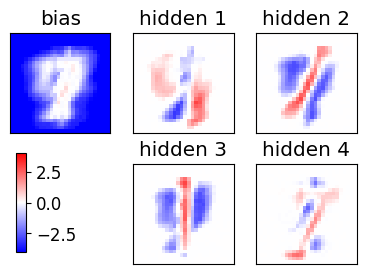

epoch 261 / 500  Nt: 4  N: 143  L: 4  rate: 0.6092184368737475  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 500  Nt: 4  N: 144  L: 4  rate: 0.6077154308617234  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 500  Nt: 4  N: 145  L: 4  rate: 0.6062124248496994  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 500  Nt: 4  N: 146  L: 4  rate: 0.6047094188376754  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 500  Nt: 4  N: 147  L: 4  rate: 0.6032064128256514  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 500  Nt: 4  N: 148  L: 4  rate: 0.6017034068136273  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 500  Nt: 4  N: 149  L: 4  rate: 0.6002004008016032  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 500  Nt: 4  N: 150  L: 4  rate: 0.5986973947895792  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 500  Nt: 4  N: 151  L: 4  rate: 0.5971943887775552  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 500  Nt: 4  N: 152  L: 4  rate: 0.595691382765531  gam: 0.01 SPINS= False POTTS= True
epoch 271 /

<Figure size 640x480 with 0 Axes>

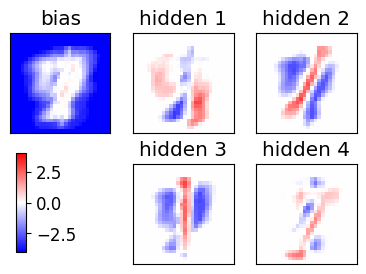

epoch 281 / 500  Nt: 4  N: 164  L: 4  rate: 0.5791583166332666  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 500  Nt: 4  N: 165  L: 4  rate: 0.5776553106212425  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 500  Nt: 4  N: 166  L: 4  rate: 0.5761523046092184  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 500  Nt: 4  N: 167  L: 4  rate: 0.5746492985971944  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 500  Nt: 4  N: 168  L: 4  rate: 0.5731462925851704  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 500  Nt: 4  N: 169  L: 4  rate: 0.5716432865731462  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 500  Nt: 4  N: 170  L: 4  rate: 0.5701402805611222  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 500  Nt: 4  N: 172  L: 4  rate: 0.5686372745490982  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 500  Nt: 4  N: 173  L: 4  rate: 0.5671342685370742  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 500  Nt: 4  N: 174  L: 4  rate: 0.5656312625250501  gam: 0.01 SPINS= False POTTS= True
epoch 291 

<Figure size 640x480 with 0 Axes>

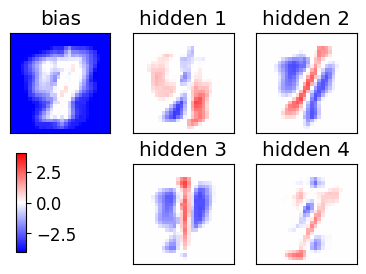

epoch 301 / 500  Nt: 4  N: 187  L: 4  rate: 0.5490981963927856  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 500  Nt: 4  N: 188  L: 4  rate: 0.5475951903807614  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 500  Nt: 4  N: 189  L: 4  rate: 0.5460921843687374  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 500  Nt: 4  N: 190  L: 4  rate: 0.5445891783567134  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 500  Nt: 4  N: 191  L: 4  rate: 0.5430861723446894  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 500  Nt: 4  N: 193  L: 4  rate: 0.5415831663326653  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 500  Nt: 4  N: 194  L: 4  rate: 0.5400801603206413  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 500  Nt: 4  N: 195  L: 4  rate: 0.5385771543086173  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 500  Nt: 4  N: 196  L: 4  rate: 0.5370741482965933  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 500  Nt: 4  N: 197  L: 4  rate: 0.5355711422845691  gam: 0.01 SPINS= False POTTS= True
epoch 311 

<Figure size 640x480 with 0 Axes>

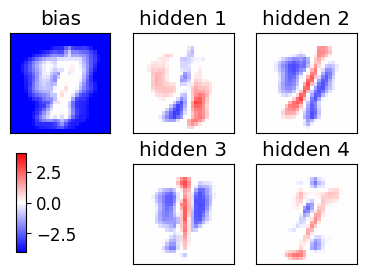

epoch 321 / 500  Nt: 4  N: 211  L: 4  rate: 0.5190380761523046  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 500  Nt: 4  N: 212  L: 4  rate: 0.5175350701402806  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 500  Nt: 4  N: 214  L: 4  rate: 0.5160320641282565  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 500  Nt: 4  N: 215  L: 4  rate: 0.5145290581162325  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 500  Nt: 4  N: 216  L: 4  rate: 0.5130260521042085  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 500  Nt: 4  N: 217  L: 4  rate: 0.5115230460921844  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 500  Nt: 4  N: 219  L: 4  rate: 0.5100200400801603  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 500  Nt: 4  N: 220  L: 4  rate: 0.5085170340681363  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 500  Nt: 4  N: 221  L: 4  rate: 0.5070140280561122  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 500  Nt: 4  N: 223  L: 4  rate: 0.5055110220440882  gam: 0.01 SPINS= False POTTS= True
epoch 331 

<Figure size 640x480 with 0 Axes>

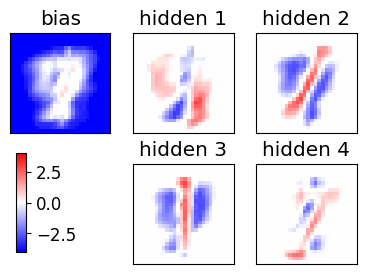

epoch 341 / 500  Nt: 4  N: 237  L: 4  rate: 0.4889779559118237  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 500  Nt: 4  N: 238  L: 4  rate: 0.48747494989979956  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 500  Nt: 4  N: 240  L: 4  rate: 0.48597194388777554  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 500  Nt: 4  N: 241  L: 4  rate: 0.4844689378757515  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 500  Nt: 4  N: 242  L: 4  rate: 0.4829659318637274  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 500  Nt: 4  N: 244  L: 4  rate: 0.48146292585170336  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 500  Nt: 4  N: 245  L: 4  rate: 0.47995991983967934  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 500  Nt: 4  N: 246  L: 4  rate: 0.4784569138276553  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 500  Nt: 4  N: 248  L: 4  rate: 0.4769539078156313  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 500  Nt: 4  N: 249  L: 4  rate: 0.47545090180360716  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

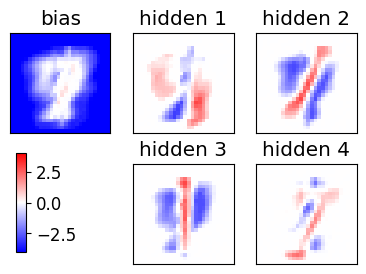

epoch 361 / 500  Nt: 4  N: 265  L: 4  rate: 0.4589178356713426  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 500  Nt: 4  N: 266  L: 4  rate: 0.4574148296593187  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 500  Nt: 4  N: 267  L: 4  rate: 0.45591182364729466  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 500  Nt: 4  N: 269  L: 4  rate: 0.4544088176352705  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 500  Nt: 4  N: 270  L: 4  rate: 0.4529058116232465  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 500  Nt: 4  N: 272  L: 4  rate: 0.4514028056112225  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 500  Nt: 4  N: 273  L: 4  rate: 0.44989979959919846  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 500  Nt: 4  N: 275  L: 4  rate: 0.44839679358717444  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 500  Nt: 4  N: 276  L: 4  rate: 0.4468937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 500  Nt: 4  N: 277  L: 4  rate: 0.4453907815631263  gam: 0.01 SPINS= False POTTS= True
epoch 3

<Figure size 640x480 with 0 Axes>

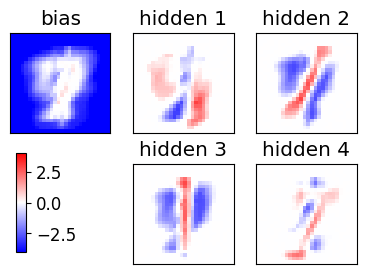

epoch 381 / 500  Nt: 4  N: 294  L: 4  rate: 0.4288577154308617  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 500  Nt: 4  N: 295  L: 4  rate: 0.4273547094188377  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 500  Nt: 4  N: 297  L: 4  rate: 0.42585170340681366  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 500  Nt: 4  N: 298  L: 4  rate: 0.42434869739478964  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 500  Nt: 4  N: 300  L: 4  rate: 0.4228456913827655  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 500  Nt: 4  N: 301  L: 4  rate: 0.4213426853707415  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 500  Nt: 4  N: 303  L: 4  rate: 0.41983967935871747  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 500  Nt: 4  N: 304  L: 4  rate: 0.41833667334669333  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 500  Nt: 4  N: 306  L: 4  rate: 0.4168336673346693  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 500  Nt: 4  N: 307  L: 4  rate: 0.4153306613226453  gam: 0.01 SPINS= False POTTS= True
epoch 

<Figure size 640x480 with 0 Axes>

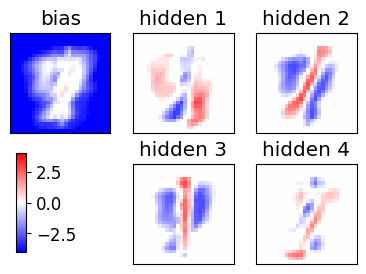

epoch 401 / 500  Nt: 4  N: 324  L: 4  rate: 0.3987975951903807  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 500  Nt: 4  N: 326  L: 4  rate: 0.3972945891783567  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 500  Nt: 4  N: 328  L: 4  rate: 0.39579158316633267  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 500  Nt: 4  N: 329  L: 4  rate: 0.39428857715430854  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 500  Nt: 4  N: 331  L: 4  rate: 0.3927855711422845  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 500  Nt: 4  N: 332  L: 4  rate: 0.3912825651302605  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 500  Nt: 4  N: 334  L: 4  rate: 0.3897795591182365  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 500  Nt: 4  N: 335  L: 4  rate: 0.38827655310621245  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 500  Nt: 4  N: 337  L: 4  rate: 0.3867735470941883  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 500  Nt: 4  N: 339  L: 4  rate: 0.3852705410821643  gam: 0.01 SPINS= False POTTS= True
epoch 4

<Figure size 640x480 with 0 Axes>

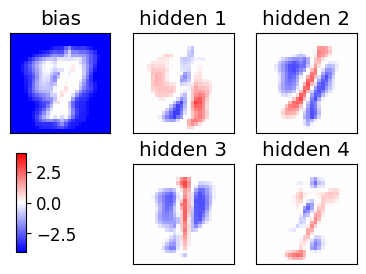

epoch 421 / 500  Nt: 4  N: 357  L: 4  rate: 0.36873747494989983  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 500  Nt: 4  N: 358  L: 4  rate: 0.3672344689378758  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 500  Nt: 4  N: 360  L: 4  rate: 0.3657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 500  Nt: 4  N: 362  L: 4  rate: 0.36422845691382766  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 500  Nt: 4  N: 363  L: 4  rate: 0.36272545090180364  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 500  Nt: 4  N: 365  L: 4  rate: 0.3612224448897796  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 500  Nt: 4  N: 367  L: 4  rate: 0.3597194388777556  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 500  Nt: 4  N: 368  L: 4  rate: 0.35821643286573146  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 500  Nt: 4  N: 370  L: 4  rate: 0.35671342685370744  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 500  Nt: 4  N: 372  L: 4  rate: 0.3552104208416834  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

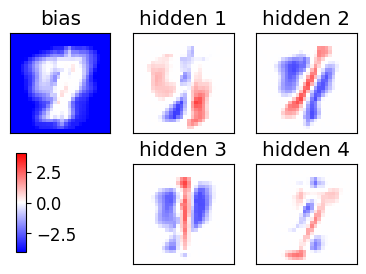

epoch 441 / 500  Nt: 4  N: 390  L: 4  rate: 0.33867735470941884  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 500  Nt: 4  N: 392  L: 4  rate: 0.3371743486973948  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 500  Nt: 4  N: 394  L: 4  rate: 0.3356713426853708  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 500  Nt: 4  N: 396  L: 4  rate: 0.33416833667334667  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 500  Nt: 4  N: 397  L: 4  rate: 0.33266533066132264  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 500  Nt: 4  N: 399  L: 4  rate: 0.3311623246492986  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 500  Nt: 4  N: 401  L: 4  rate: 0.3296593186372745  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 500  Nt: 4  N: 403  L: 4  rate: 0.32815631262525047  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 500  Nt: 4  N: 404  L: 4  rate: 0.32665330661322645  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 500  Nt: 4  N: 406  L: 4  rate: 0.3251503006012024  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

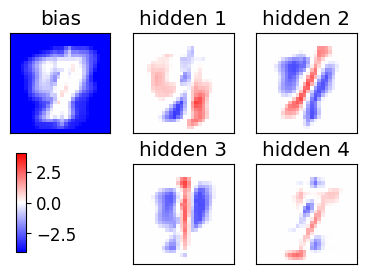

epoch 461 / 500  Nt: 4  N: 426  L: 4  rate: 0.30861723446893785  gam: 0.01 SPINS= False POTTS= True
epoch 462 / 500  Nt: 4  N: 428  L: 4  rate: 0.30711422845691383  gam: 0.01 SPINS= False POTTS= True
epoch 463 / 500  Nt: 4  N: 430  L: 4  rate: 0.3056112224448897  gam: 0.01 SPINS= False POTTS= True
epoch 464 / 500  Nt: 4  N: 431  L: 4  rate: 0.3041082164328657  gam: 0.01 SPINS= False POTTS= True
epoch 465 / 500  Nt: 4  N: 433  L: 4  rate: 0.30260521042084165  gam: 0.01 SPINS= False POTTS= True
epoch 466 / 500  Nt: 4  N: 435  L: 4  rate: 0.30110220440881763  gam: 0.01 SPINS= False POTTS= True
epoch 467 / 500  Nt: 4  N: 437  L: 4  rate: 0.2995991983967936  gam: 0.01 SPINS= False POTTS= True
epoch 468 / 500  Nt: 4  N: 439  L: 4  rate: 0.2980961923847695  gam: 0.01 SPINS= False POTTS= True
epoch 469 / 500  Nt: 4  N: 441  L: 4  rate: 0.29659318637274545  gam: 0.01 SPINS= False POTTS= True
epoch 470 / 500  Nt: 4  N: 442  L: 4  rate: 0.29509018036072143  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

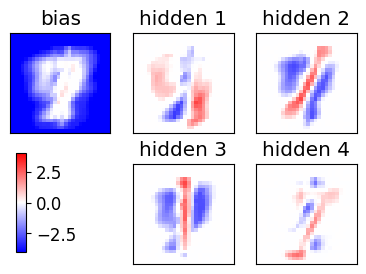

epoch 481 / 500  Nt: 4  N: 463  L: 4  rate: 0.27855711422845697  gam: 0.01 SPINS= False POTTS= True
epoch 482 / 500  Nt: 4  N: 465  L: 4  rate: 0.27705410821643284  gam: 0.01 SPINS= False POTTS= True
epoch 483 / 500  Nt: 4  N: 467  L: 4  rate: 0.2755511022044088  gam: 0.01 SPINS= False POTTS= True
epoch 484 / 500  Nt: 4  N: 469  L: 4  rate: 0.2740480961923848  gam: 0.01 SPINS= False POTTS= True
epoch 485 / 500  Nt: 4  N: 470  L: 4  rate: 0.27254509018036077  gam: 0.01 SPINS= False POTTS= True
epoch 486 / 500  Nt: 4  N: 472  L: 4  rate: 0.27104208416833675  gam: 0.01 SPINS= False POTTS= True
epoch 487 / 500  Nt: 4  N: 474  L: 4  rate: 0.2695390781563126  gam: 0.01 SPINS= False POTTS= True
epoch 488 / 500  Nt: 4  N: 476  L: 4  rate: 0.2680360721442886  gam: 0.01 SPINS= False POTTS= True
epoch 489 / 500  Nt: 4  N: 478  L: 4  rate: 0.2665330661322646  gam: 0.01 SPINS= False POTTS= True
epoch 490 / 500  Nt: 4  N: 480  L: 4  rate: 0.26503006012024044  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

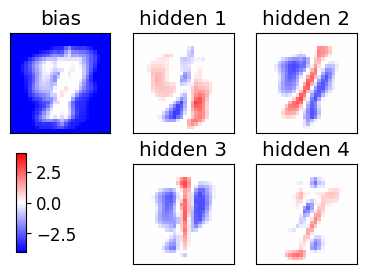

Nepoch=500
Nmini=20


<Figure size 640x480 with 0 Axes>

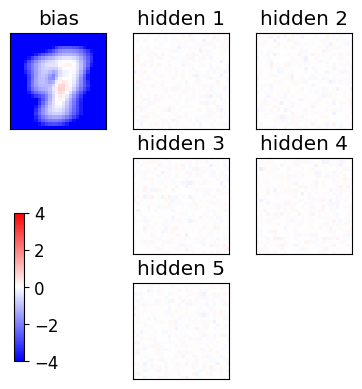

Starting the training, POTTS=True
[ 5797 13141  9123  1048  6779 12387  6604    78 16565  8376]
[ 5581 11844  2717   539 11966 10059 10564 18413 20318  4299]
[14353  4140  2716 14767 10439 19109 15408 12799 19194  2710]
[14756  7333  7958  2020 17453  7560  3337 14179 20043  8260]
epoch 1 / 500  Nt: 4  N: 10  L: 5  rate: 1.0  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 500  Nt: 4  N: 10  L: 5  rate: 0.998496993987976  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 500  Nt: 4  N: 10  L: 5  rate: 0.996993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 500  Nt: 4  N: 10  L: 5  rate: 0.9954909819639278  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 500  Nt: 4  N: 10  L: 5  rate: 0.9939879759519038  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 500  Nt: 4  N: 10  L: 5  rate: 0.9924849699398798  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 500  Nt: 4  N: 10  L: 5  rate: 0.9909819639278558  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 500  Nt: 4  N: 10  L: 5  rate: 0.9894789579158316  ga

<Figure size 640x480 with 0 Axes>

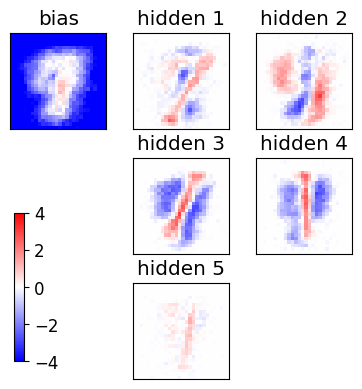

epoch 21 / 500  Nt: 4  N: 10  L: 5  rate: 0.969939879759519  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 500  Nt: 4  N: 10  L: 5  rate: 0.968436873747495  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 500  Nt: 4  N: 10  L: 5  rate: 0.966933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 500  Nt: 4  N: 11  L: 5  rate: 0.9654308617234469  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 500  Nt: 4  N: 11  L: 5  rate: 0.9639278557114228  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 500  Nt: 4  N: 11  L: 5  rate: 0.9624248496993988  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 500  Nt: 4  N: 11  L: 5  rate: 0.9609218436873748  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 500  Nt: 4  N: 11  L: 5  rate: 0.9594188376753507  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 500  Nt: 4  N: 11  L: 5  rate: 0.9579158316633266  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 500  Nt: 4  N: 11  L: 5  rate: 0.9564128256513026  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 500  Nt: 4  N: 11  L: 

<Figure size 640x480 with 0 Axes>

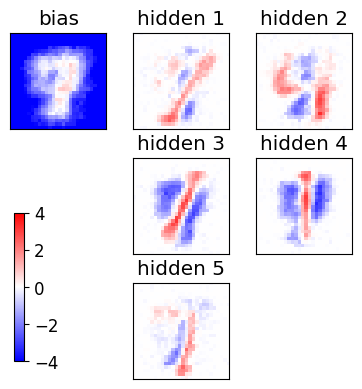

epoch 41 / 500  Nt: 4  N: 13  L: 5  rate: 0.9398797595190381  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 500  Nt: 4  N: 13  L: 5  rate: 0.938376753507014  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 500  Nt: 4  N: 13  L: 5  rate: 0.93687374749499  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 500  Nt: 4  N: 13  L: 5  rate: 0.935370741482966  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 500  Nt: 4  N: 13  L: 5  rate: 0.9338677354709419  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 500  Nt: 4  N: 13  L: 5  rate: 0.9323647294589178  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 500  Nt: 4  N: 14  L: 5  rate: 0.9308617234468938  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 500  Nt: 4  N: 14  L: 5  rate: 0.9293587174348698  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 500  Nt: 4  N: 14  L: 5  rate: 0.9278557114228457  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 500  Nt: 4  N: 14  L: 5  rate: 0.9263527054108216  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 500  Nt: 4  N: 14  L: 5

<Figure size 640x480 with 0 Axes>

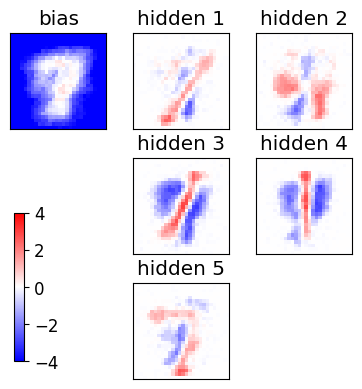

epoch 61 / 500  Nt: 4  N: 17  L: 5  rate: 0.9098196392785571  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 500  Nt: 4  N: 17  L: 5  rate: 0.9083166332665331  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 500  Nt: 4  N: 17  L: 5  rate: 0.906813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 500  Nt: 4  N: 17  L: 5  rate: 0.905310621242485  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 500  Nt: 4  N: 18  L: 5  rate: 0.9038076152304609  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 500  Nt: 4  N: 18  L: 5  rate: 0.9023046092184369  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 500  Nt: 4  N: 18  L: 5  rate: 0.9008016032064128  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 500  Nt: 4  N: 18  L: 5  rate: 0.8992985971943888  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 500  Nt: 4  N: 19  L: 5  rate: 0.8977955911823647  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 500  Nt: 4  N: 19  L: 5  rate: 0.8962925851703407  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 500  Nt: 4  N: 19  L:

<Figure size 640x480 with 0 Axes>

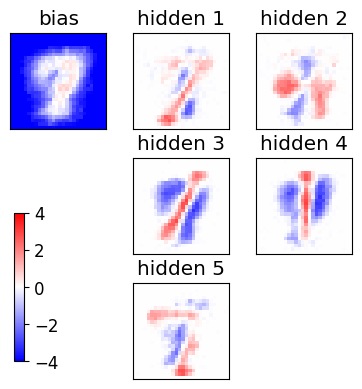

epoch 81 / 500  Nt: 4  N: 22  L: 5  rate: 0.8797595190380761  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 500  Nt: 4  N: 22  L: 5  rate: 0.8782565130260521  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 500  Nt: 4  N: 23  L: 5  rate: 0.8767535070140281  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 500  Nt: 4  N: 23  L: 5  rate: 0.875250501002004  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 500  Nt: 4  N: 23  L: 5  rate: 0.87374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 500  Nt: 4  N: 24  L: 5  rate: 0.8722444889779559  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 500  Nt: 4  N: 24  L: 5  rate: 0.8707414829659319  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 500  Nt: 4  N: 24  L: 5  rate: 0.8692384769539079  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 500  Nt: 4  N: 25  L: 5  rate: 0.8677354709418837  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 500  Nt: 4  N: 25  L: 5  rate: 0.8662324649298597  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 500  Nt: 4  N: 25  L: 

<Figure size 640x480 with 0 Axes>

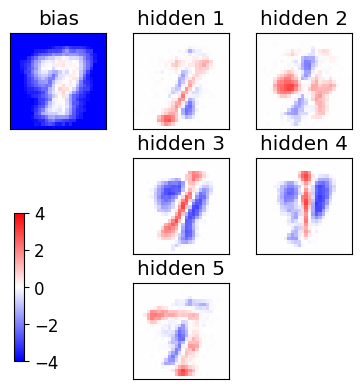

epoch 101 / 500  Nt: 4  N: 29  L: 5  rate: 0.8496993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 500  Nt: 4  N: 30  L: 5  rate: 0.8481963927855711  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 500  Nt: 4  N: 30  L: 5  rate: 0.8466933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 500  Nt: 4  N: 30  L: 5  rate: 0.8451903807615231  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 500  Nt: 4  N: 31  L: 5  rate: 0.8436873747494991  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 500  Nt: 4  N: 31  L: 5  rate: 0.8421843687374749  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 500  Nt: 4  N: 32  L: 5  rate: 0.8406813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 500  Nt: 4  N: 32  L: 5  rate: 0.8391783567134269  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 500  Nt: 4  N: 32  L: 5  rate: 0.8376753507014028  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 500  Nt: 4  N: 33  L: 5  rate: 0.8361723446893787  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 500  Nt:

<Figure size 640x480 with 0 Axes>

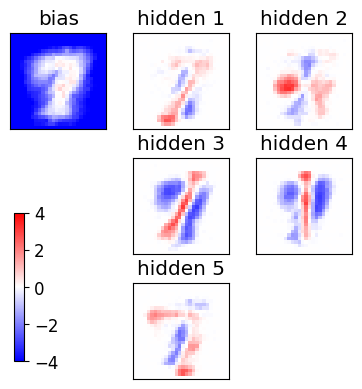

epoch 121 / 500  Nt: 4  N: 38  L: 5  rate: 0.8196392785571143  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 500  Nt: 4  N: 38  L: 5  rate: 0.8181362725450902  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 500  Nt: 4  N: 39  L: 5  rate: 0.8166332665330661  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 500  Nt: 4  N: 39  L: 5  rate: 0.8151302605210421  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 500  Nt: 4  N: 40  L: 5  rate: 0.8136272545090181  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 500  Nt: 4  N: 40  L: 5  rate: 0.8121242484969939  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 500  Nt: 4  N: 41  L: 5  rate: 0.8106212424849699  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 500  Nt: 4  N: 41  L: 5  rate: 0.8091182364729459  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 500  Nt: 4  N: 42  L: 5  rate: 0.8076152304609219  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 500  Nt: 4  N: 42  L: 5  rate: 0.8061122244488979  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 500  Nt:

<Figure size 640x480 with 0 Axes>

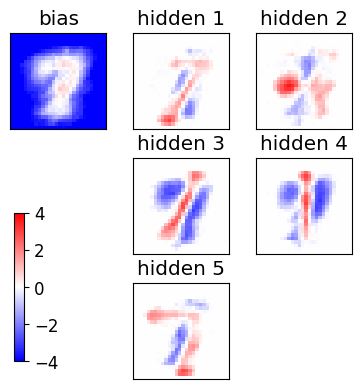

epoch 141 / 500  Nt: 4  N: 48  L: 5  rate: 0.7895791583166333  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 500  Nt: 4  N: 49  L: 5  rate: 0.7880761523046091  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 500  Nt: 4  N: 49  L: 5  rate: 0.7865731462925851  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 500  Nt: 4  N: 50  L: 5  rate: 0.7850701402805611  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 500  Nt: 4  N: 50  L: 5  rate: 0.7835671342685371  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 500  Nt: 4  N: 51  L: 5  rate: 0.7820641282565131  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 500  Nt: 4  N: 51  L: 5  rate: 0.780561122244489  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 500  Nt: 4  N: 52  L: 5  rate: 0.7790581162324649  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 500  Nt: 4  N: 53  L: 5  rate: 0.7775551102204409  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 500  Nt: 4  N: 53  L: 5  rate: 0.7760521042084167  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

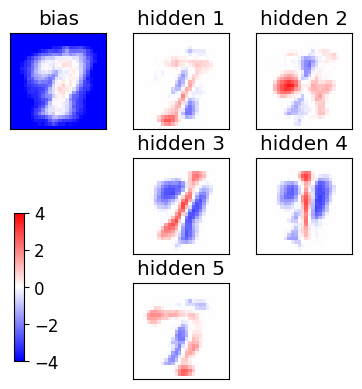

epoch 161 / 500  Nt: 4  N: 60  L: 5  rate: 0.7595190380761523  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 500  Nt: 4  N: 61  L: 5  rate: 0.7580160320641283  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 500  Nt: 4  N: 61  L: 5  rate: 0.7565130260521042  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 500  Nt: 4  N: 62  L: 5  rate: 0.7550100200400802  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 500  Nt: 4  N: 62  L: 5  rate: 0.7535070140280561  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 500  Nt: 4  N: 63  L: 5  rate: 0.7520040080160321  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 500  Nt: 4  N: 64  L: 5  rate: 0.750501002004008  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 500  Nt: 4  N: 64  L: 5  rate: 0.7489979959919839  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 500  Nt: 4  N: 65  L: 5  rate: 0.7474949899799599  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 500  Nt: 4  N: 66  L: 5  rate: 0.7459919839679359  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

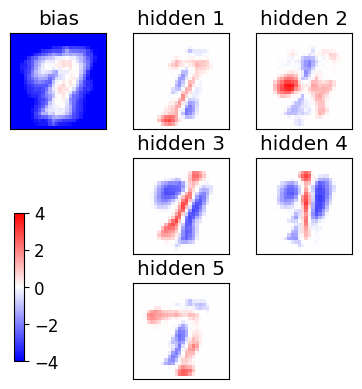

epoch 181 / 500  Nt: 4  N: 73  L: 5  rate: 0.7294589178356713  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 500  Nt: 4  N: 74  L: 5  rate: 0.7279559118236474  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 500  Nt: 4  N: 75  L: 5  rate: 0.7264529058116233  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 500  Nt: 4  N: 75  L: 5  rate: 0.7249498997995992  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 500  Nt: 4  N: 76  L: 5  rate: 0.7234468937875751  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 500  Nt: 4  N: 77  L: 5  rate: 0.7219438877755511  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 500  Nt: 4  N: 78  L: 5  rate: 0.720440881763527  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 500  Nt: 4  N: 78  L: 5  rate: 0.718937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 500  Nt: 4  N: 79  L: 5  rate: 0.717434869739479  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 500  Nt: 4  N: 80  L: 5  rate: 0.715931863727455  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 500  Nt: 4  

<Figure size 640x480 with 0 Axes>

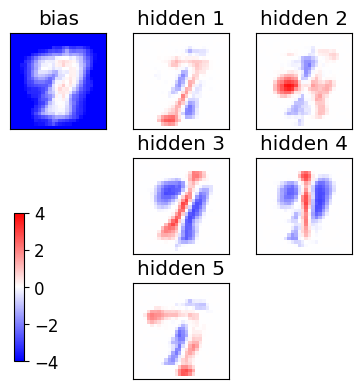

epoch 201 / 500  Nt: 4  N: 88  L: 5  rate: 0.6993987975951903  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 500  Nt: 4  N: 89  L: 5  rate: 0.6978957915831663  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 500  Nt: 4  N: 90  L: 5  rate: 0.6963927855711423  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 500  Nt: 4  N: 91  L: 5  rate: 0.6948897795591182  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 500  Nt: 4  N: 91  L: 5  rate: 0.6933867735470942  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 500  Nt: 4  N: 92  L: 5  rate: 0.6918837675350702  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 500  Nt: 4  N: 93  L: 5  rate: 0.6903807615230461  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 500  Nt: 4  N: 94  L: 5  rate: 0.688877755511022  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 500  Nt: 4  N: 95  L: 5  rate: 0.687374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 500  Nt: 4  N: 95  L: 5  rate: 0.685871743486974  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 500  Nt: 4 

<Figure size 640x480 with 0 Axes>

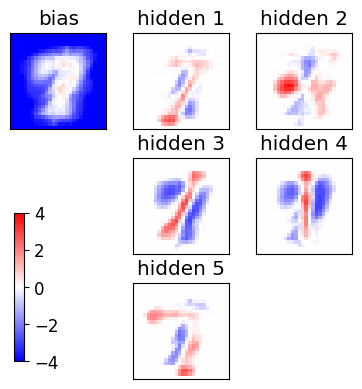

epoch 221 / 500  Nt: 4  N: 105  L: 5  rate: 0.6693386773547094  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 500  Nt: 4  N: 106  L: 5  rate: 0.6678356713426854  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 500  Nt: 4  N: 106  L: 5  rate: 0.6663326653306614  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 500  Nt: 4  N: 107  L: 5  rate: 0.6648296593186372  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 500  Nt: 4  N: 108  L: 5  rate: 0.6633266533066132  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 500  Nt: 4  N: 109  L: 5  rate: 0.6618236472945892  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 500  Nt: 4  N: 110  L: 5  rate: 0.6603206412825651  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 500  Nt: 4  N: 111  L: 5  rate: 0.658817635270541  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 500  Nt: 4  N: 112  L: 5  rate: 0.657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 500  Nt: 4  N: 113  L: 5  rate: 0.655811623246493  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 5

<Figure size 640x480 with 0 Axes>

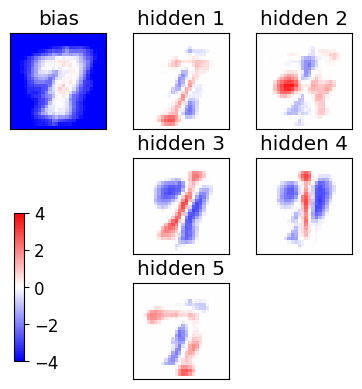

epoch 241 / 500  Nt: 4  N: 123  L: 5  rate: 0.6392785571142285  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 500  Nt: 4  N: 124  L: 5  rate: 0.6377755511022044  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 500  Nt: 4  N: 125  L: 5  rate: 0.6362725450901804  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 500  Nt: 4  N: 126  L: 5  rate: 0.6347695390781563  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 500  Nt: 4  N: 127  L: 5  rate: 0.6332665330661322  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 500  Nt: 4  N: 128  L: 5  rate: 0.6317635270541082  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 500  Nt: 4  N: 129  L: 5  rate: 0.6302605210420842  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 500  Nt: 4  N: 130  L: 5  rate: 0.6287575150300602  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 500  Nt: 4  N: 131  L: 5  rate: 0.6272545090180361  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 500  Nt: 4  N: 132  L: 5  rate: 0.625751503006012  gam: 0.01 SPINS= False POTTS= True
epoch 251 /

<Figure size 640x480 with 0 Axes>

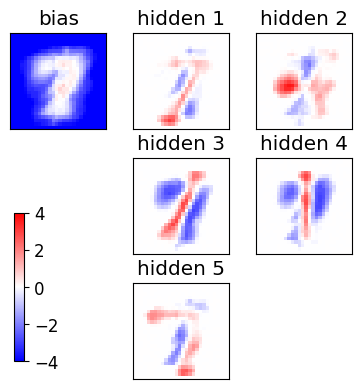

epoch 261 / 500  Nt: 4  N: 143  L: 5  rate: 0.6092184368737475  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 500  Nt: 4  N: 144  L: 5  rate: 0.6077154308617234  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 500  Nt: 4  N: 145  L: 5  rate: 0.6062124248496994  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 500  Nt: 4  N: 146  L: 5  rate: 0.6047094188376754  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 500  Nt: 4  N: 147  L: 5  rate: 0.6032064128256514  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 500  Nt: 4  N: 148  L: 5  rate: 0.6017034068136273  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 500  Nt: 4  N: 149  L: 5  rate: 0.6002004008016032  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 500  Nt: 4  N: 150  L: 5  rate: 0.5986973947895792  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 500  Nt: 4  N: 151  L: 5  rate: 0.5971943887775552  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 500  Nt: 4  N: 152  L: 5  rate: 0.595691382765531  gam: 0.01 SPINS= False POTTS= True
epoch 271 /

<Figure size 640x480 with 0 Axes>

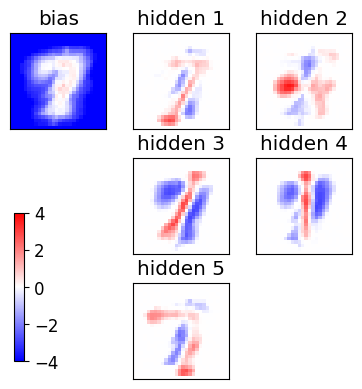

epoch 281 / 500  Nt: 4  N: 164  L: 5  rate: 0.5791583166332666  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 500  Nt: 4  N: 165  L: 5  rate: 0.5776553106212425  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 500  Nt: 4  N: 166  L: 5  rate: 0.5761523046092184  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 500  Nt: 4  N: 167  L: 5  rate: 0.5746492985971944  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 500  Nt: 4  N: 168  L: 5  rate: 0.5731462925851704  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 500  Nt: 4  N: 169  L: 5  rate: 0.5716432865731462  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 500  Nt: 4  N: 170  L: 5  rate: 0.5701402805611222  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 500  Nt: 4  N: 172  L: 5  rate: 0.5686372745490982  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 500  Nt: 4  N: 173  L: 5  rate: 0.5671342685370742  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 500  Nt: 4  N: 174  L: 5  rate: 0.5656312625250501  gam: 0.01 SPINS= False POTTS= True
epoch 291 

<Figure size 640x480 with 0 Axes>

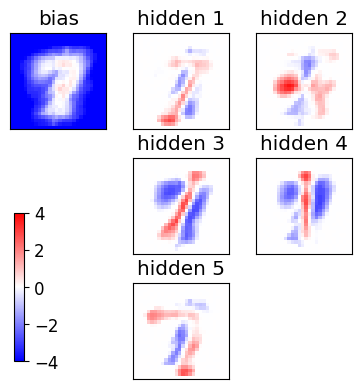

epoch 301 / 500  Nt: 4  N: 187  L: 5  rate: 0.5490981963927856  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 500  Nt: 4  N: 188  L: 5  rate: 0.5475951903807614  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 500  Nt: 4  N: 189  L: 5  rate: 0.5460921843687374  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 500  Nt: 4  N: 190  L: 5  rate: 0.5445891783567134  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 500  Nt: 4  N: 191  L: 5  rate: 0.5430861723446894  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 500  Nt: 4  N: 193  L: 5  rate: 0.5415831663326653  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 500  Nt: 4  N: 194  L: 5  rate: 0.5400801603206413  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 500  Nt: 4  N: 195  L: 5  rate: 0.5385771543086173  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 500  Nt: 4  N: 196  L: 5  rate: 0.5370741482965933  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 500  Nt: 4  N: 197  L: 5  rate: 0.5355711422845691  gam: 0.01 SPINS= False POTTS= True
epoch 311 

<Figure size 640x480 with 0 Axes>

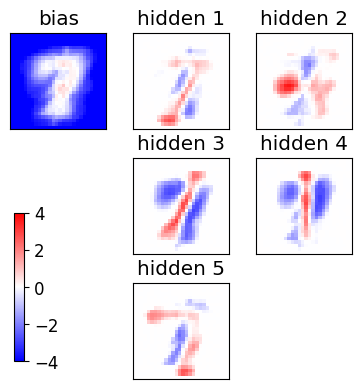

epoch 321 / 500  Nt: 4  N: 211  L: 5  rate: 0.5190380761523046  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 500  Nt: 4  N: 212  L: 5  rate: 0.5175350701402806  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 500  Nt: 4  N: 214  L: 5  rate: 0.5160320641282565  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 500  Nt: 4  N: 215  L: 5  rate: 0.5145290581162325  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 500  Nt: 4  N: 216  L: 5  rate: 0.5130260521042085  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 500  Nt: 4  N: 217  L: 5  rate: 0.5115230460921844  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 500  Nt: 4  N: 219  L: 5  rate: 0.5100200400801603  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 500  Nt: 4  N: 220  L: 5  rate: 0.5085170340681363  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 500  Nt: 4  N: 221  L: 5  rate: 0.5070140280561122  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 500  Nt: 4  N: 223  L: 5  rate: 0.5055110220440882  gam: 0.01 SPINS= False POTTS= True
epoch 331 

<Figure size 640x480 with 0 Axes>

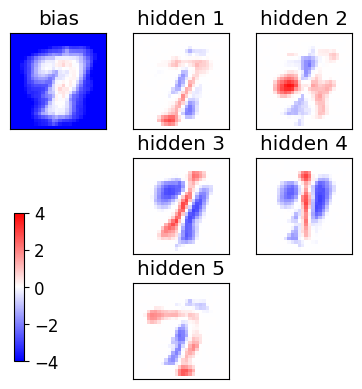

epoch 341 / 500  Nt: 4  N: 237  L: 5  rate: 0.4889779559118237  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 500  Nt: 4  N: 238  L: 5  rate: 0.48747494989979956  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 500  Nt: 4  N: 240  L: 5  rate: 0.48597194388777554  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 500  Nt: 4  N: 241  L: 5  rate: 0.4844689378757515  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 500  Nt: 4  N: 242  L: 5  rate: 0.4829659318637274  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 500  Nt: 4  N: 244  L: 5  rate: 0.48146292585170336  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 500  Nt: 4  N: 245  L: 5  rate: 0.47995991983967934  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 500  Nt: 4  N: 246  L: 5  rate: 0.4784569138276553  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 500  Nt: 4  N: 248  L: 5  rate: 0.4769539078156313  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 500  Nt: 4  N: 249  L: 5  rate: 0.47545090180360716  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

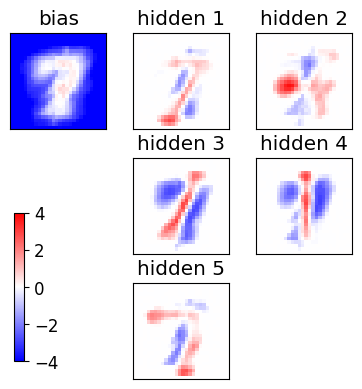

epoch 361 / 500  Nt: 4  N: 265  L: 5  rate: 0.4589178356713426  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 500  Nt: 4  N: 266  L: 5  rate: 0.4574148296593187  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 500  Nt: 4  N: 267  L: 5  rate: 0.45591182364729466  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 500  Nt: 4  N: 269  L: 5  rate: 0.4544088176352705  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 500  Nt: 4  N: 270  L: 5  rate: 0.4529058116232465  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 500  Nt: 4  N: 272  L: 5  rate: 0.4514028056112225  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 500  Nt: 4  N: 273  L: 5  rate: 0.44989979959919846  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 500  Nt: 4  N: 275  L: 5  rate: 0.44839679358717444  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 500  Nt: 4  N: 276  L: 5  rate: 0.4468937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 500  Nt: 4  N: 277  L: 5  rate: 0.4453907815631263  gam: 0.01 SPINS= False POTTS= True
epoch 3

<Figure size 640x480 with 0 Axes>

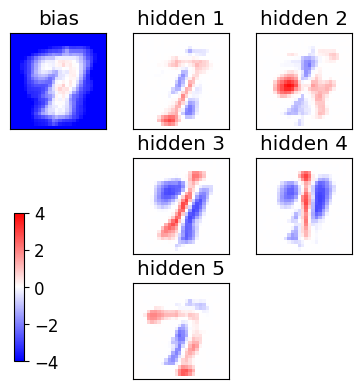

epoch 381 / 500  Nt: 4  N: 294  L: 5  rate: 0.4288577154308617  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 500  Nt: 4  N: 295  L: 5  rate: 0.4273547094188377  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 500  Nt: 4  N: 297  L: 5  rate: 0.42585170340681366  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 500  Nt: 4  N: 298  L: 5  rate: 0.42434869739478964  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 500  Nt: 4  N: 300  L: 5  rate: 0.4228456913827655  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 500  Nt: 4  N: 301  L: 5  rate: 0.4213426853707415  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 500  Nt: 4  N: 303  L: 5  rate: 0.41983967935871747  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 500  Nt: 4  N: 304  L: 5  rate: 0.41833667334669333  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 500  Nt: 4  N: 306  L: 5  rate: 0.4168336673346693  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 500  Nt: 4  N: 307  L: 5  rate: 0.4153306613226453  gam: 0.01 SPINS= False POTTS= True
epoch 

<Figure size 640x480 with 0 Axes>

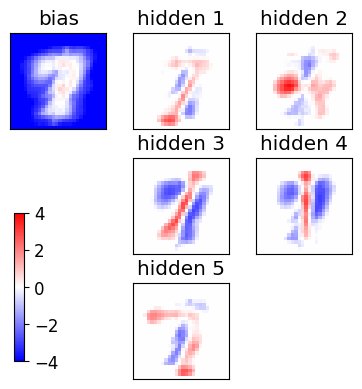

epoch 401 / 500  Nt: 4  N: 324  L: 5  rate: 0.3987975951903807  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 500  Nt: 4  N: 326  L: 5  rate: 0.3972945891783567  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 500  Nt: 4  N: 328  L: 5  rate: 0.39579158316633267  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 500  Nt: 4  N: 329  L: 5  rate: 0.39428857715430854  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 500  Nt: 4  N: 331  L: 5  rate: 0.3927855711422845  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 500  Nt: 4  N: 332  L: 5  rate: 0.3912825651302605  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 500  Nt: 4  N: 334  L: 5  rate: 0.3897795591182365  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 500  Nt: 4  N: 335  L: 5  rate: 0.38827655310621245  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 500  Nt: 4  N: 337  L: 5  rate: 0.3867735470941883  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 500  Nt: 4  N: 339  L: 5  rate: 0.3852705410821643  gam: 0.01 SPINS= False POTTS= True
epoch 4

<Figure size 640x480 with 0 Axes>

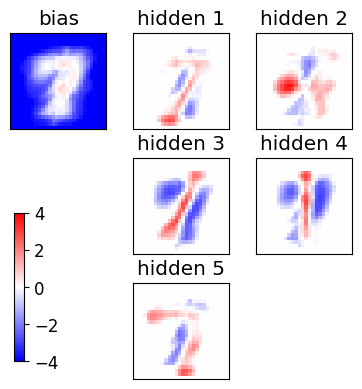

epoch 421 / 500  Nt: 4  N: 357  L: 5  rate: 0.36873747494989983  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 500  Nt: 4  N: 358  L: 5  rate: 0.3672344689378758  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 500  Nt: 4  N: 360  L: 5  rate: 0.3657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 500  Nt: 4  N: 362  L: 5  rate: 0.36422845691382766  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 500  Nt: 4  N: 363  L: 5  rate: 0.36272545090180364  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 500  Nt: 4  N: 365  L: 5  rate: 0.3612224448897796  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 500  Nt: 4  N: 367  L: 5  rate: 0.3597194388777556  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 500  Nt: 4  N: 368  L: 5  rate: 0.35821643286573146  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 500  Nt: 4  N: 370  L: 5  rate: 0.35671342685370744  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 500  Nt: 4  N: 372  L: 5  rate: 0.3552104208416834  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

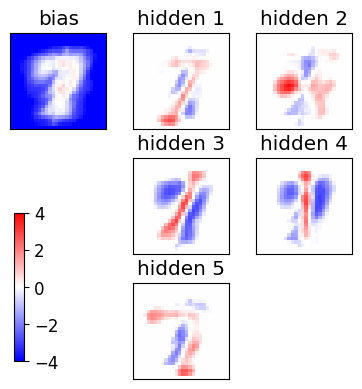

epoch 441 / 500  Nt: 4  N: 390  L: 5  rate: 0.33867735470941884  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 500  Nt: 4  N: 392  L: 5  rate: 0.3371743486973948  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 500  Nt: 4  N: 394  L: 5  rate: 0.3356713426853708  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 500  Nt: 4  N: 396  L: 5  rate: 0.33416833667334667  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 500  Nt: 4  N: 397  L: 5  rate: 0.33266533066132264  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 500  Nt: 4  N: 399  L: 5  rate: 0.3311623246492986  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 500  Nt: 4  N: 401  L: 5  rate: 0.3296593186372745  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 500  Nt: 4  N: 403  L: 5  rate: 0.32815631262525047  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 500  Nt: 4  N: 404  L: 5  rate: 0.32665330661322645  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 500  Nt: 4  N: 406  L: 5  rate: 0.3251503006012024  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

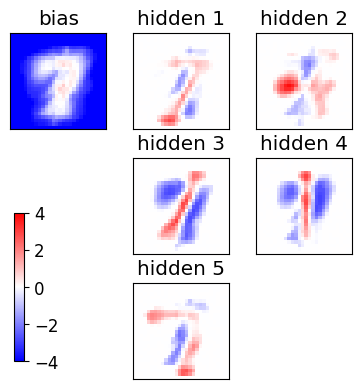

epoch 461 / 500  Nt: 4  N: 426  L: 5  rate: 0.30861723446893785  gam: 0.01 SPINS= False POTTS= True
epoch 462 / 500  Nt: 4  N: 428  L: 5  rate: 0.30711422845691383  gam: 0.01 SPINS= False POTTS= True
epoch 463 / 500  Nt: 4  N: 430  L: 5  rate: 0.3056112224448897  gam: 0.01 SPINS= False POTTS= True
epoch 464 / 500  Nt: 4  N: 431  L: 5  rate: 0.3041082164328657  gam: 0.01 SPINS= False POTTS= True
epoch 465 / 500  Nt: 4  N: 433  L: 5  rate: 0.30260521042084165  gam: 0.01 SPINS= False POTTS= True
epoch 466 / 500  Nt: 4  N: 435  L: 5  rate: 0.30110220440881763  gam: 0.01 SPINS= False POTTS= True
epoch 467 / 500  Nt: 4  N: 437  L: 5  rate: 0.2995991983967936  gam: 0.01 SPINS= False POTTS= True
epoch 468 / 500  Nt: 4  N: 439  L: 5  rate: 0.2980961923847695  gam: 0.01 SPINS= False POTTS= True
epoch 469 / 500  Nt: 4  N: 441  L: 5  rate: 0.29659318637274545  gam: 0.01 SPINS= False POTTS= True
epoch 470 / 500  Nt: 4  N: 442  L: 5  rate: 0.29509018036072143  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

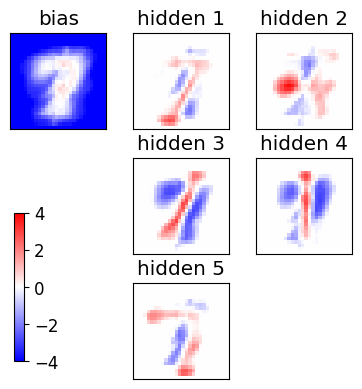

epoch 481 / 500  Nt: 4  N: 463  L: 5  rate: 0.27855711422845697  gam: 0.01 SPINS= False POTTS= True
epoch 482 / 500  Nt: 4  N: 465  L: 5  rate: 0.27705410821643284  gam: 0.01 SPINS= False POTTS= True
epoch 483 / 500  Nt: 4  N: 467  L: 5  rate: 0.2755511022044088  gam: 0.01 SPINS= False POTTS= True
epoch 484 / 500  Nt: 4  N: 469  L: 5  rate: 0.2740480961923848  gam: 0.01 SPINS= False POTTS= True
epoch 485 / 500  Nt: 4  N: 470  L: 5  rate: 0.27254509018036077  gam: 0.01 SPINS= False POTTS= True
epoch 486 / 500  Nt: 4  N: 472  L: 5  rate: 0.27104208416833675  gam: 0.01 SPINS= False POTTS= True
epoch 487 / 500  Nt: 4  N: 474  L: 5  rate: 0.2695390781563126  gam: 0.01 SPINS= False POTTS= True
epoch 488 / 500  Nt: 4  N: 476  L: 5  rate: 0.2680360721442886  gam: 0.01 SPINS= False POTTS= True
epoch 489 / 500  Nt: 4  N: 478  L: 5  rate: 0.2665330661322646  gam: 0.01 SPINS= False POTTS= True
epoch 490 / 500  Nt: 4  N: 480  L: 5  rate: 0.26503006012024044  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

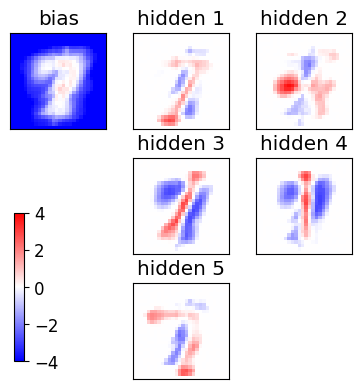

Nepoch=500
Nmini=20


<Figure size 640x480 with 0 Axes>

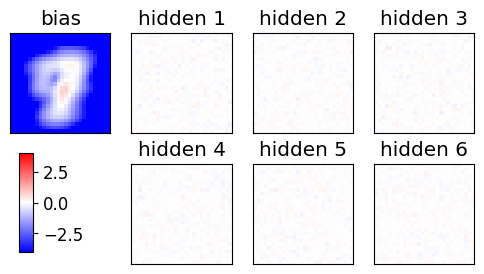

Starting the training, POTTS=True
[18560   676  2323 17350  7019 13079 18785 11438  4334 21460]
[ 9167 19389  7439  8090  5038  6742  4664  1859  8323 16601]
[11679 14236 18494  3722  6313 21834  1204 13965 18714 21695]
[21678 11378  1287 11266  4006 20547 14579 15809  4297   104]
epoch 1 / 500  Nt: 4  N: 10  L: 6  rate: 1.0  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 500  Nt: 4  N: 10  L: 6  rate: 0.998496993987976  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 500  Nt: 4  N: 10  L: 6  rate: 0.996993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 500  Nt: 4  N: 10  L: 6  rate: 0.9954909819639278  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 500  Nt: 4  N: 10  L: 6  rate: 0.9939879759519038  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 500  Nt: 4  N: 10  L: 6  rate: 0.9924849699398798  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 500  Nt: 4  N: 10  L: 6  rate: 0.9909819639278558  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 500  Nt: 4  N: 10  L: 6  rate: 0.9894789579158316  ga

<Figure size 640x480 with 0 Axes>

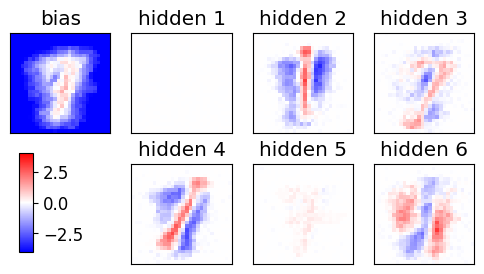

epoch 21 / 500  Nt: 4  N: 10  L: 6  rate: 0.969939879759519  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 500  Nt: 4  N: 10  L: 6  rate: 0.968436873747495  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 500  Nt: 4  N: 10  L: 6  rate: 0.966933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 500  Nt: 4  N: 11  L: 6  rate: 0.9654308617234469  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 500  Nt: 4  N: 11  L: 6  rate: 0.9639278557114228  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 500  Nt: 4  N: 11  L: 6  rate: 0.9624248496993988  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 500  Nt: 4  N: 11  L: 6  rate: 0.9609218436873748  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 500  Nt: 4  N: 11  L: 6  rate: 0.9594188376753507  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 500  Nt: 4  N: 11  L: 6  rate: 0.9579158316633266  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 500  Nt: 4  N: 11  L: 6  rate: 0.9564128256513026  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 500  Nt: 4  N: 11  L: 

<Figure size 640x480 with 0 Axes>

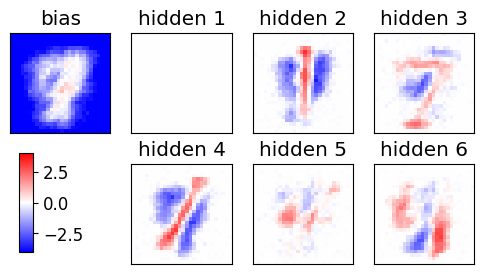

epoch 41 / 500  Nt: 4  N: 13  L: 6  rate: 0.9398797595190381  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 500  Nt: 4  N: 13  L: 6  rate: 0.938376753507014  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 500  Nt: 4  N: 13  L: 6  rate: 0.93687374749499  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 500  Nt: 4  N: 13  L: 6  rate: 0.935370741482966  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 500  Nt: 4  N: 13  L: 6  rate: 0.9338677354709419  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 500  Nt: 4  N: 13  L: 6  rate: 0.9323647294589178  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 500  Nt: 4  N: 14  L: 6  rate: 0.9308617234468938  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 500  Nt: 4  N: 14  L: 6  rate: 0.9293587174348698  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 500  Nt: 4  N: 14  L: 6  rate: 0.9278557114228457  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 500  Nt: 4  N: 14  L: 6  rate: 0.9263527054108216  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 500  Nt: 4  N: 14  L: 6

<Figure size 640x480 with 0 Axes>

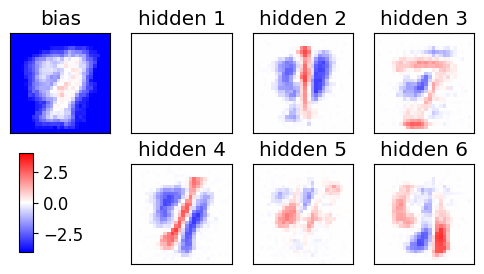

epoch 61 / 500  Nt: 4  N: 17  L: 6  rate: 0.9098196392785571  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 500  Nt: 4  N: 17  L: 6  rate: 0.9083166332665331  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 500  Nt: 4  N: 17  L: 6  rate: 0.906813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 500  Nt: 4  N: 17  L: 6  rate: 0.905310621242485  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 500  Nt: 4  N: 18  L: 6  rate: 0.9038076152304609  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 500  Nt: 4  N: 18  L: 6  rate: 0.9023046092184369  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 500  Nt: 4  N: 18  L: 6  rate: 0.9008016032064128  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 500  Nt: 4  N: 18  L: 6  rate: 0.8992985971943888  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 500  Nt: 4  N: 19  L: 6  rate: 0.8977955911823647  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 500  Nt: 4  N: 19  L: 6  rate: 0.8962925851703407  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 500  Nt: 4  N: 19  L:

<Figure size 640x480 with 0 Axes>

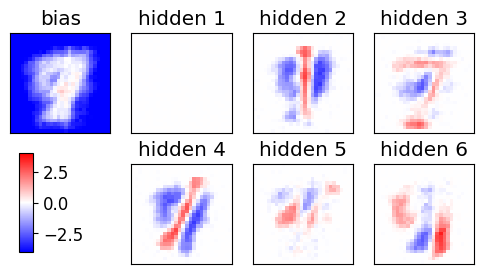

epoch 81 / 500  Nt: 4  N: 22  L: 6  rate: 0.8797595190380761  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 500  Nt: 4  N: 22  L: 6  rate: 0.8782565130260521  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 500  Nt: 4  N: 23  L: 6  rate: 0.8767535070140281  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 500  Nt: 4  N: 23  L: 6  rate: 0.875250501002004  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 500  Nt: 4  N: 23  L: 6  rate: 0.87374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 500  Nt: 4  N: 24  L: 6  rate: 0.8722444889779559  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 500  Nt: 4  N: 24  L: 6  rate: 0.8707414829659319  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 500  Nt: 4  N: 24  L: 6  rate: 0.8692384769539079  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 500  Nt: 4  N: 25  L: 6  rate: 0.8677354709418837  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 500  Nt: 4  N: 25  L: 6  rate: 0.8662324649298597  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 500  Nt: 4  N: 25  L: 

<Figure size 640x480 with 0 Axes>

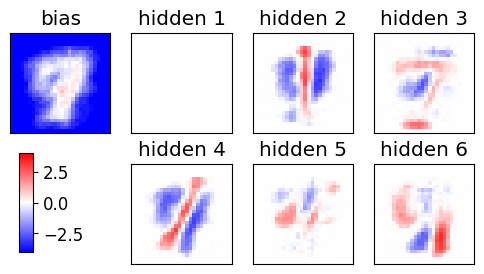

epoch 101 / 500  Nt: 4  N: 29  L: 6  rate: 0.8496993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 500  Nt: 4  N: 30  L: 6  rate: 0.8481963927855711  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 500  Nt: 4  N: 30  L: 6  rate: 0.8466933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 500  Nt: 4  N: 30  L: 6  rate: 0.8451903807615231  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 500  Nt: 4  N: 31  L: 6  rate: 0.8436873747494991  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 500  Nt: 4  N: 31  L: 6  rate: 0.8421843687374749  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 500  Nt: 4  N: 32  L: 6  rate: 0.8406813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 500  Nt: 4  N: 32  L: 6  rate: 0.8391783567134269  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 500  Nt: 4  N: 32  L: 6  rate: 0.8376753507014028  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 500  Nt: 4  N: 33  L: 6  rate: 0.8361723446893787  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 500  Nt:

<Figure size 640x480 with 0 Axes>

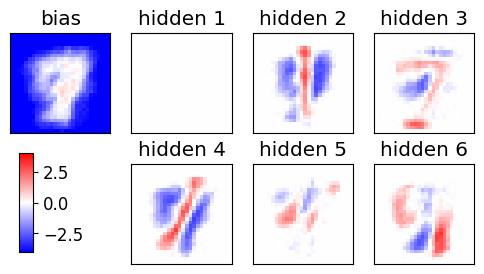

epoch 121 / 500  Nt: 4  N: 38  L: 6  rate: 0.8196392785571143  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 500  Nt: 4  N: 38  L: 6  rate: 0.8181362725450902  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 500  Nt: 4  N: 39  L: 6  rate: 0.8166332665330661  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 500  Nt: 4  N: 39  L: 6  rate: 0.8151302605210421  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 500  Nt: 4  N: 40  L: 6  rate: 0.8136272545090181  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 500  Nt: 4  N: 40  L: 6  rate: 0.8121242484969939  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 500  Nt: 4  N: 41  L: 6  rate: 0.8106212424849699  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 500  Nt: 4  N: 41  L: 6  rate: 0.8091182364729459  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 500  Nt: 4  N: 42  L: 6  rate: 0.8076152304609219  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 500  Nt: 4  N: 42  L: 6  rate: 0.8061122244488979  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 500  Nt:

<Figure size 640x480 with 0 Axes>

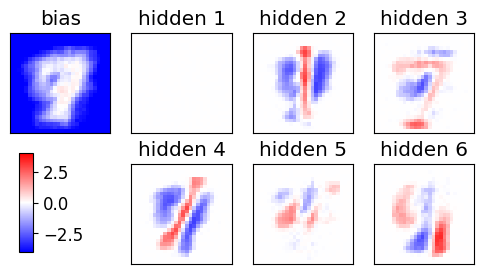

epoch 141 / 500  Nt: 4  N: 48  L: 6  rate: 0.7895791583166333  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 500  Nt: 4  N: 49  L: 6  rate: 0.7880761523046091  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 500  Nt: 4  N: 49  L: 6  rate: 0.7865731462925851  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 500  Nt: 4  N: 50  L: 6  rate: 0.7850701402805611  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 500  Nt: 4  N: 50  L: 6  rate: 0.7835671342685371  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 500  Nt: 4  N: 51  L: 6  rate: 0.7820641282565131  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 500  Nt: 4  N: 51  L: 6  rate: 0.780561122244489  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 500  Nt: 4  N: 52  L: 6  rate: 0.7790581162324649  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 500  Nt: 4  N: 53  L: 6  rate: 0.7775551102204409  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 500  Nt: 4  N: 53  L: 6  rate: 0.7760521042084167  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

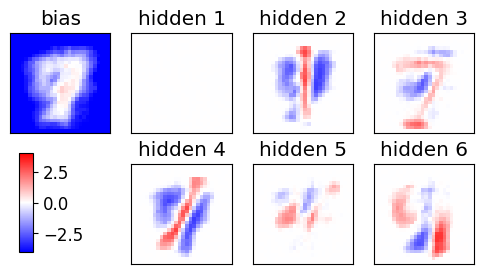

epoch 161 / 500  Nt: 4  N: 60  L: 6  rate: 0.7595190380761523  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 500  Nt: 4  N: 61  L: 6  rate: 0.7580160320641283  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 500  Nt: 4  N: 61  L: 6  rate: 0.7565130260521042  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 500  Nt: 4  N: 62  L: 6  rate: 0.7550100200400802  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 500  Nt: 4  N: 62  L: 6  rate: 0.7535070140280561  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 500  Nt: 4  N: 63  L: 6  rate: 0.7520040080160321  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 500  Nt: 4  N: 64  L: 6  rate: 0.750501002004008  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 500  Nt: 4  N: 64  L: 6  rate: 0.7489979959919839  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 500  Nt: 4  N: 65  L: 6  rate: 0.7474949899799599  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 500  Nt: 4  N: 66  L: 6  rate: 0.7459919839679359  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

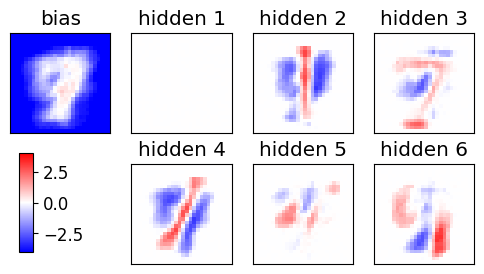

epoch 181 / 500  Nt: 4  N: 73  L: 6  rate: 0.7294589178356713  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 500  Nt: 4  N: 74  L: 6  rate: 0.7279559118236474  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 500  Nt: 4  N: 75  L: 6  rate: 0.7264529058116233  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 500  Nt: 4  N: 75  L: 6  rate: 0.7249498997995992  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 500  Nt: 4  N: 76  L: 6  rate: 0.7234468937875751  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 500  Nt: 4  N: 77  L: 6  rate: 0.7219438877755511  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 500  Nt: 4  N: 78  L: 6  rate: 0.720440881763527  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 500  Nt: 4  N: 78  L: 6  rate: 0.718937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 500  Nt: 4  N: 79  L: 6  rate: 0.717434869739479  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 500  Nt: 4  N: 80  L: 6  rate: 0.715931863727455  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 500  Nt: 4  

<Figure size 640x480 with 0 Axes>

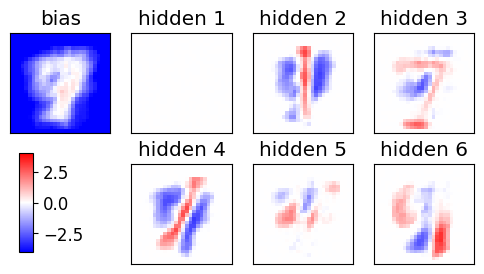

epoch 201 / 500  Nt: 4  N: 88  L: 6  rate: 0.6993987975951903  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 500  Nt: 4  N: 89  L: 6  rate: 0.6978957915831663  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 500  Nt: 4  N: 90  L: 6  rate: 0.6963927855711423  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 500  Nt: 4  N: 91  L: 6  rate: 0.6948897795591182  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 500  Nt: 4  N: 91  L: 6  rate: 0.6933867735470942  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 500  Nt: 4  N: 92  L: 6  rate: 0.6918837675350702  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 500  Nt: 4  N: 93  L: 6  rate: 0.6903807615230461  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 500  Nt: 4  N: 94  L: 6  rate: 0.688877755511022  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 500  Nt: 4  N: 95  L: 6  rate: 0.687374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 500  Nt: 4  N: 95  L: 6  rate: 0.685871743486974  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 500  Nt: 4 

<Figure size 640x480 with 0 Axes>

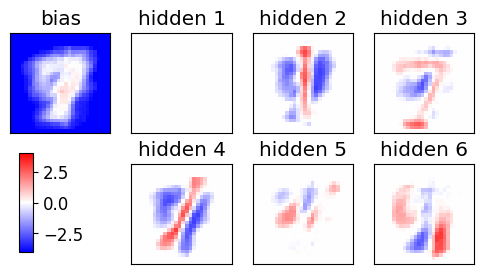

epoch 221 / 500  Nt: 4  N: 105  L: 6  rate: 0.6693386773547094  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 500  Nt: 4  N: 106  L: 6  rate: 0.6678356713426854  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 500  Nt: 4  N: 106  L: 6  rate: 0.6663326653306614  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 500  Nt: 4  N: 107  L: 6  rate: 0.6648296593186372  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 500  Nt: 4  N: 108  L: 6  rate: 0.6633266533066132  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 500  Nt: 4  N: 109  L: 6  rate: 0.6618236472945892  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 500  Nt: 4  N: 110  L: 6  rate: 0.6603206412825651  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 500  Nt: 4  N: 111  L: 6  rate: 0.658817635270541  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 500  Nt: 4  N: 112  L: 6  rate: 0.657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 500  Nt: 4  N: 113  L: 6  rate: 0.655811623246493  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 5

<Figure size 640x480 with 0 Axes>

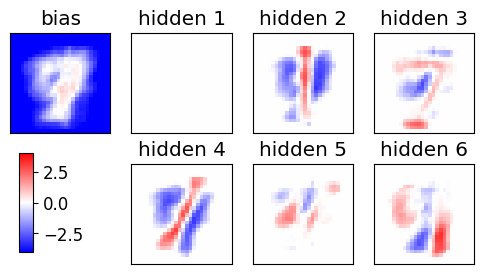

epoch 241 / 500  Nt: 4  N: 123  L: 6  rate: 0.6392785571142285  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 500  Nt: 4  N: 124  L: 6  rate: 0.6377755511022044  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 500  Nt: 4  N: 125  L: 6  rate: 0.6362725450901804  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 500  Nt: 4  N: 126  L: 6  rate: 0.6347695390781563  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 500  Nt: 4  N: 127  L: 6  rate: 0.6332665330661322  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 500  Nt: 4  N: 128  L: 6  rate: 0.6317635270541082  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 500  Nt: 4  N: 129  L: 6  rate: 0.6302605210420842  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 500  Nt: 4  N: 130  L: 6  rate: 0.6287575150300602  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 500  Nt: 4  N: 131  L: 6  rate: 0.6272545090180361  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 500  Nt: 4  N: 132  L: 6  rate: 0.625751503006012  gam: 0.01 SPINS= False POTTS= True
epoch 251 /

<Figure size 640x480 with 0 Axes>

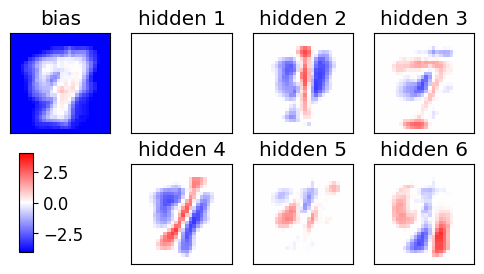

epoch 261 / 500  Nt: 4  N: 143  L: 6  rate: 0.6092184368737475  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 500  Nt: 4  N: 144  L: 6  rate: 0.6077154308617234  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 500  Nt: 4  N: 145  L: 6  rate: 0.6062124248496994  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 500  Nt: 4  N: 146  L: 6  rate: 0.6047094188376754  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 500  Nt: 4  N: 147  L: 6  rate: 0.6032064128256514  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 500  Nt: 4  N: 148  L: 6  rate: 0.6017034068136273  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 500  Nt: 4  N: 149  L: 6  rate: 0.6002004008016032  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 500  Nt: 4  N: 150  L: 6  rate: 0.5986973947895792  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 500  Nt: 4  N: 151  L: 6  rate: 0.5971943887775552  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 500  Nt: 4  N: 152  L: 6  rate: 0.595691382765531  gam: 0.01 SPINS= False POTTS= True
epoch 271 /

<Figure size 640x480 with 0 Axes>

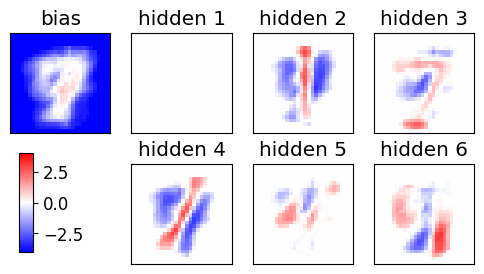

epoch 281 / 500  Nt: 4  N: 164  L: 6  rate: 0.5791583166332666  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 500  Nt: 4  N: 165  L: 6  rate: 0.5776553106212425  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 500  Nt: 4  N: 166  L: 6  rate: 0.5761523046092184  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 500  Nt: 4  N: 167  L: 6  rate: 0.5746492985971944  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 500  Nt: 4  N: 168  L: 6  rate: 0.5731462925851704  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 500  Nt: 4  N: 169  L: 6  rate: 0.5716432865731462  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 500  Nt: 4  N: 170  L: 6  rate: 0.5701402805611222  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 500  Nt: 4  N: 172  L: 6  rate: 0.5686372745490982  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 500  Nt: 4  N: 173  L: 6  rate: 0.5671342685370742  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 500  Nt: 4  N: 174  L: 6  rate: 0.5656312625250501  gam: 0.01 SPINS= False POTTS= True
epoch 291 

<Figure size 640x480 with 0 Axes>

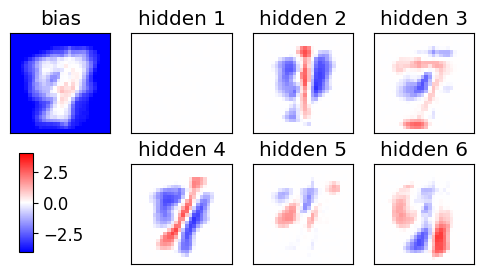

epoch 301 / 500  Nt: 4  N: 187  L: 6  rate: 0.5490981963927856  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 500  Nt: 4  N: 188  L: 6  rate: 0.5475951903807614  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 500  Nt: 4  N: 189  L: 6  rate: 0.5460921843687374  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 500  Nt: 4  N: 190  L: 6  rate: 0.5445891783567134  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 500  Nt: 4  N: 191  L: 6  rate: 0.5430861723446894  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 500  Nt: 4  N: 193  L: 6  rate: 0.5415831663326653  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 500  Nt: 4  N: 194  L: 6  rate: 0.5400801603206413  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 500  Nt: 4  N: 195  L: 6  rate: 0.5385771543086173  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 500  Nt: 4  N: 196  L: 6  rate: 0.5370741482965933  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 500  Nt: 4  N: 197  L: 6  rate: 0.5355711422845691  gam: 0.01 SPINS= False POTTS= True
epoch 311 

<Figure size 640x480 with 0 Axes>

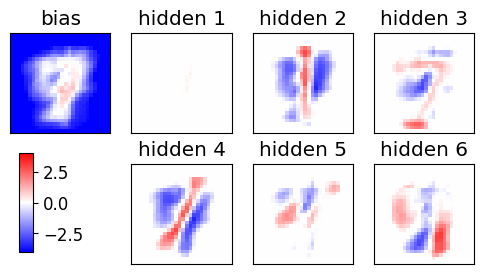

epoch 321 / 500  Nt: 4  N: 211  L: 6  rate: 0.5190380761523046  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 500  Nt: 4  N: 212  L: 6  rate: 0.5175350701402806  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 500  Nt: 4  N: 214  L: 6  rate: 0.5160320641282565  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 500  Nt: 4  N: 215  L: 6  rate: 0.5145290581162325  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 500  Nt: 4  N: 216  L: 6  rate: 0.5130260521042085  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 500  Nt: 4  N: 217  L: 6  rate: 0.5115230460921844  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 500  Nt: 4  N: 219  L: 6  rate: 0.5100200400801603  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 500  Nt: 4  N: 220  L: 6  rate: 0.5085170340681363  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 500  Nt: 4  N: 221  L: 6  rate: 0.5070140280561122  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 500  Nt: 4  N: 223  L: 6  rate: 0.5055110220440882  gam: 0.01 SPINS= False POTTS= True
epoch 331 

<Figure size 640x480 with 0 Axes>

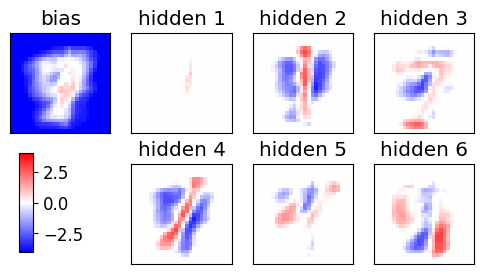

epoch 341 / 500  Nt: 4  N: 237  L: 6  rate: 0.4889779559118237  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 500  Nt: 4  N: 238  L: 6  rate: 0.48747494989979956  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 500  Nt: 4  N: 240  L: 6  rate: 0.48597194388777554  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 500  Nt: 4  N: 241  L: 6  rate: 0.4844689378757515  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 500  Nt: 4  N: 242  L: 6  rate: 0.4829659318637274  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 500  Nt: 4  N: 244  L: 6  rate: 0.48146292585170336  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 500  Nt: 4  N: 245  L: 6  rate: 0.47995991983967934  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 500  Nt: 4  N: 246  L: 6  rate: 0.4784569138276553  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 500  Nt: 4  N: 248  L: 6  rate: 0.4769539078156313  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 500  Nt: 4  N: 249  L: 6  rate: 0.47545090180360716  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

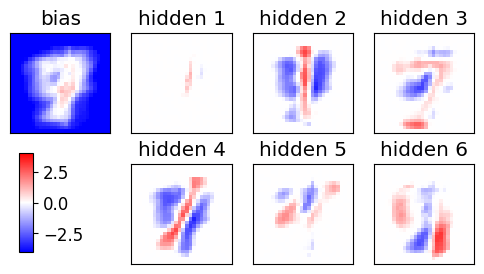

epoch 361 / 500  Nt: 4  N: 265  L: 6  rate: 0.4589178356713426  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 500  Nt: 4  N: 266  L: 6  rate: 0.4574148296593187  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 500  Nt: 4  N: 267  L: 6  rate: 0.45591182364729466  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 500  Nt: 4  N: 269  L: 6  rate: 0.4544088176352705  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 500  Nt: 4  N: 270  L: 6  rate: 0.4529058116232465  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 500  Nt: 4  N: 272  L: 6  rate: 0.4514028056112225  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 500  Nt: 4  N: 273  L: 6  rate: 0.44989979959919846  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 500  Nt: 4  N: 275  L: 6  rate: 0.44839679358717444  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 500  Nt: 4  N: 276  L: 6  rate: 0.4468937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 500  Nt: 4  N: 277  L: 6  rate: 0.4453907815631263  gam: 0.01 SPINS= False POTTS= True
epoch 3

<Figure size 640x480 with 0 Axes>

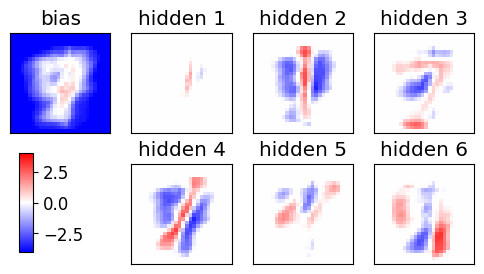

epoch 381 / 500  Nt: 4  N: 294  L: 6  rate: 0.4288577154308617  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 500  Nt: 4  N: 295  L: 6  rate: 0.4273547094188377  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 500  Nt: 4  N: 297  L: 6  rate: 0.42585170340681366  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 500  Nt: 4  N: 298  L: 6  rate: 0.42434869739478964  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 500  Nt: 4  N: 300  L: 6  rate: 0.4228456913827655  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 500  Nt: 4  N: 301  L: 6  rate: 0.4213426853707415  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 500  Nt: 4  N: 303  L: 6  rate: 0.41983967935871747  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 500  Nt: 4  N: 304  L: 6  rate: 0.41833667334669333  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 500  Nt: 4  N: 306  L: 6  rate: 0.4168336673346693  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 500  Nt: 4  N: 307  L: 6  rate: 0.4153306613226453  gam: 0.01 SPINS= False POTTS= True
epoch 

<Figure size 640x480 with 0 Axes>

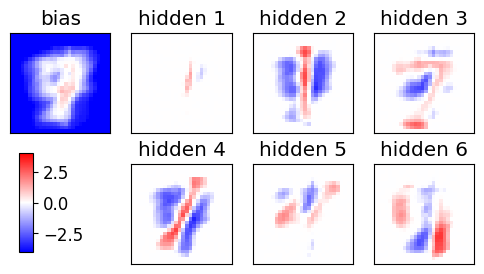

epoch 401 / 500  Nt: 4  N: 324  L: 6  rate: 0.3987975951903807  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 500  Nt: 4  N: 326  L: 6  rate: 0.3972945891783567  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 500  Nt: 4  N: 328  L: 6  rate: 0.39579158316633267  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 500  Nt: 4  N: 329  L: 6  rate: 0.39428857715430854  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 500  Nt: 4  N: 331  L: 6  rate: 0.3927855711422845  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 500  Nt: 4  N: 332  L: 6  rate: 0.3912825651302605  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 500  Nt: 4  N: 334  L: 6  rate: 0.3897795591182365  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 500  Nt: 4  N: 335  L: 6  rate: 0.38827655310621245  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 500  Nt: 4  N: 337  L: 6  rate: 0.3867735470941883  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 500  Nt: 4  N: 339  L: 6  rate: 0.3852705410821643  gam: 0.01 SPINS= False POTTS= True
epoch 4

<Figure size 640x480 with 0 Axes>

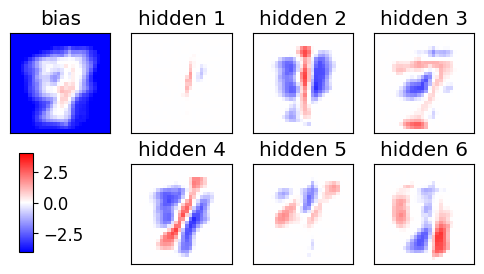

epoch 421 / 500  Nt: 4  N: 357  L: 6  rate: 0.36873747494989983  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 500  Nt: 4  N: 358  L: 6  rate: 0.3672344689378758  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 500  Nt: 4  N: 360  L: 6  rate: 0.3657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 500  Nt: 4  N: 362  L: 6  rate: 0.36422845691382766  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 500  Nt: 4  N: 363  L: 6  rate: 0.36272545090180364  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 500  Nt: 4  N: 365  L: 6  rate: 0.3612224448897796  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 500  Nt: 4  N: 367  L: 6  rate: 0.3597194388777556  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 500  Nt: 4  N: 368  L: 6  rate: 0.35821643286573146  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 500  Nt: 4  N: 370  L: 6  rate: 0.35671342685370744  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 500  Nt: 4  N: 372  L: 6  rate: 0.3552104208416834  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

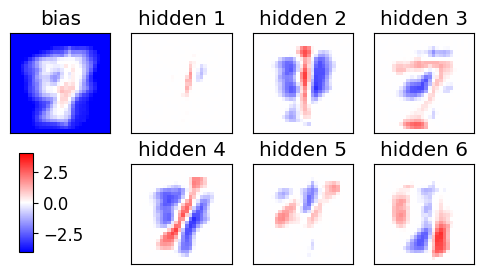

epoch 441 / 500  Nt: 4  N: 390  L: 6  rate: 0.33867735470941884  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 500  Nt: 4  N: 392  L: 6  rate: 0.3371743486973948  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 500  Nt: 4  N: 394  L: 6  rate: 0.3356713426853708  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 500  Nt: 4  N: 396  L: 6  rate: 0.33416833667334667  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 500  Nt: 4  N: 397  L: 6  rate: 0.33266533066132264  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 500  Nt: 4  N: 399  L: 6  rate: 0.3311623246492986  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 500  Nt: 4  N: 401  L: 6  rate: 0.3296593186372745  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 500  Nt: 4  N: 403  L: 6  rate: 0.32815631262525047  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 500  Nt: 4  N: 404  L: 6  rate: 0.32665330661322645  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 500  Nt: 4  N: 406  L: 6  rate: 0.3251503006012024  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

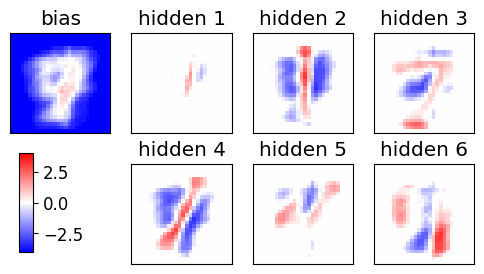

epoch 461 / 500  Nt: 4  N: 426  L: 6  rate: 0.30861723446893785  gam: 0.01 SPINS= False POTTS= True
epoch 462 / 500  Nt: 4  N: 428  L: 6  rate: 0.30711422845691383  gam: 0.01 SPINS= False POTTS= True
epoch 463 / 500  Nt: 4  N: 430  L: 6  rate: 0.3056112224448897  gam: 0.01 SPINS= False POTTS= True
epoch 464 / 500  Nt: 4  N: 431  L: 6  rate: 0.3041082164328657  gam: 0.01 SPINS= False POTTS= True
epoch 465 / 500  Nt: 4  N: 433  L: 6  rate: 0.30260521042084165  gam: 0.01 SPINS= False POTTS= True
epoch 466 / 500  Nt: 4  N: 435  L: 6  rate: 0.30110220440881763  gam: 0.01 SPINS= False POTTS= True
epoch 467 / 500  Nt: 4  N: 437  L: 6  rate: 0.2995991983967936  gam: 0.01 SPINS= False POTTS= True
epoch 468 / 500  Nt: 4  N: 439  L: 6  rate: 0.2980961923847695  gam: 0.01 SPINS= False POTTS= True
epoch 469 / 500  Nt: 4  N: 441  L: 6  rate: 0.29659318637274545  gam: 0.01 SPINS= False POTTS= True
epoch 470 / 500  Nt: 4  N: 442  L: 6  rate: 0.29509018036072143  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

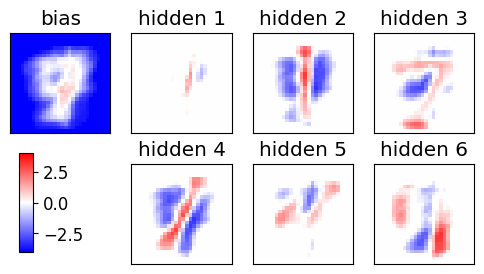

epoch 481 / 500  Nt: 4  N: 463  L: 6  rate: 0.27855711422845697  gam: 0.01 SPINS= False POTTS= True
epoch 482 / 500  Nt: 4  N: 465  L: 6  rate: 0.27705410821643284  gam: 0.01 SPINS= False POTTS= True
epoch 483 / 500  Nt: 4  N: 467  L: 6  rate: 0.2755511022044088  gam: 0.01 SPINS= False POTTS= True
epoch 484 / 500  Nt: 4  N: 469  L: 6  rate: 0.2740480961923848  gam: 0.01 SPINS= False POTTS= True
epoch 485 / 500  Nt: 4  N: 470  L: 6  rate: 0.27254509018036077  gam: 0.01 SPINS= False POTTS= True
epoch 486 / 500  Nt: 4  N: 472  L: 6  rate: 0.27104208416833675  gam: 0.01 SPINS= False POTTS= True
epoch 487 / 500  Nt: 4  N: 474  L: 6  rate: 0.2695390781563126  gam: 0.01 SPINS= False POTTS= True
epoch 488 / 500  Nt: 4  N: 476  L: 6  rate: 0.2680360721442886  gam: 0.01 SPINS= False POTTS= True
epoch 489 / 500  Nt: 4  N: 478  L: 6  rate: 0.2665330661322646  gam: 0.01 SPINS= False POTTS= True
epoch 490 / 500  Nt: 4  N: 480  L: 6  rate: 0.26503006012024044  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

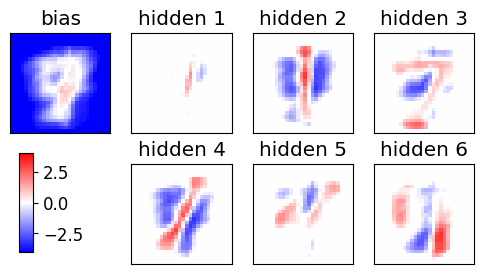

Nepoch=500
Nmini=20


<Figure size 640x480 with 0 Axes>

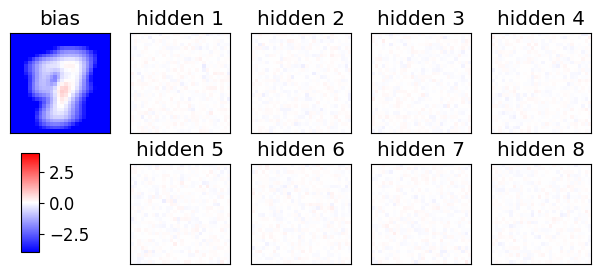

Starting the training, POTTS=True
[ 6700  1391  9706 10678 10690 19114 18298  2113 11710  1143]
[ 6450  2430 19994  1924  5081  4141 11737   726  8253 14781]
[11517 17605 17053  5720  9576 17524  5045 13155 17174  7021]
[ 2394 21172 13316  5562  2906 15749 10242  2881  8905 19458]
epoch 1 / 500  Nt: 4  N: 10  L: 8  rate: 1.0  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 500  Nt: 4  N: 10  L: 8  rate: 0.998496993987976  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 500  Nt: 4  N: 10  L: 8  rate: 0.996993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 500  Nt: 4  N: 10  L: 8  rate: 0.9954909819639278  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 500  Nt: 4  N: 10  L: 8  rate: 0.9939879759519038  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 500  Nt: 4  N: 10  L: 8  rate: 0.9924849699398798  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 500  Nt: 4  N: 10  L: 8  rate: 0.9909819639278558  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 500  Nt: 4  N: 10  L: 8  rate: 0.9894789579158316  ga

<Figure size 640x480 with 0 Axes>

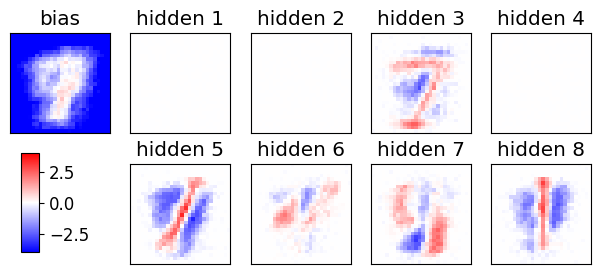

epoch 21 / 500  Nt: 4  N: 10  L: 8  rate: 0.969939879759519  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 500  Nt: 4  N: 10  L: 8  rate: 0.968436873747495  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 500  Nt: 4  N: 10  L: 8  rate: 0.966933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 500  Nt: 4  N: 11  L: 8  rate: 0.9654308617234469  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 500  Nt: 4  N: 11  L: 8  rate: 0.9639278557114228  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 500  Nt: 4  N: 11  L: 8  rate: 0.9624248496993988  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 500  Nt: 4  N: 11  L: 8  rate: 0.9609218436873748  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 500  Nt: 4  N: 11  L: 8  rate: 0.9594188376753507  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 500  Nt: 4  N: 11  L: 8  rate: 0.9579158316633266  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 500  Nt: 4  N: 11  L: 8  rate: 0.9564128256513026  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 500  Nt: 4  N: 11  L: 

<Figure size 640x480 with 0 Axes>

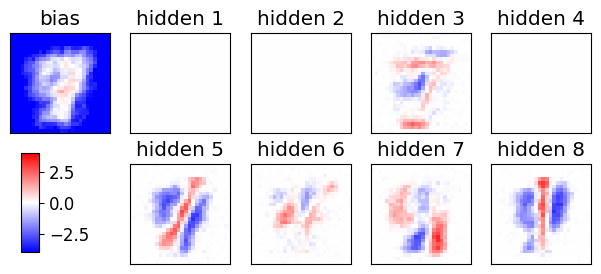

epoch 41 / 500  Nt: 4  N: 13  L: 8  rate: 0.9398797595190381  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 500  Nt: 4  N: 13  L: 8  rate: 0.938376753507014  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 500  Nt: 4  N: 13  L: 8  rate: 0.93687374749499  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 500  Nt: 4  N: 13  L: 8  rate: 0.935370741482966  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 500  Nt: 4  N: 13  L: 8  rate: 0.9338677354709419  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 500  Nt: 4  N: 13  L: 8  rate: 0.9323647294589178  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 500  Nt: 4  N: 14  L: 8  rate: 0.9308617234468938  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 500  Nt: 4  N: 14  L: 8  rate: 0.9293587174348698  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 500  Nt: 4  N: 14  L: 8  rate: 0.9278557114228457  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 500  Nt: 4  N: 14  L: 8  rate: 0.9263527054108216  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 500  Nt: 4  N: 14  L: 8

<Figure size 640x480 with 0 Axes>

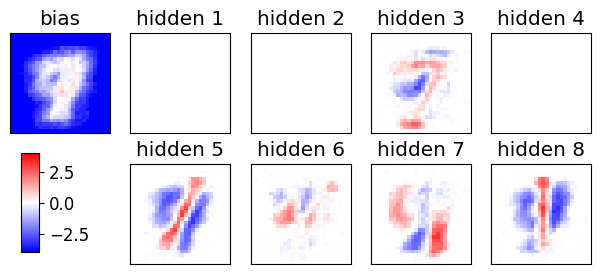

epoch 61 / 500  Nt: 4  N: 17  L: 8  rate: 0.9098196392785571  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 500  Nt: 4  N: 17  L: 8  rate: 0.9083166332665331  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 500  Nt: 4  N: 17  L: 8  rate: 0.906813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 500  Nt: 4  N: 17  L: 8  rate: 0.905310621242485  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 500  Nt: 4  N: 18  L: 8  rate: 0.9038076152304609  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 500  Nt: 4  N: 18  L: 8  rate: 0.9023046092184369  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 500  Nt: 4  N: 18  L: 8  rate: 0.9008016032064128  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 500  Nt: 4  N: 18  L: 8  rate: 0.8992985971943888  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 500  Nt: 4  N: 19  L: 8  rate: 0.8977955911823647  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 500  Nt: 4  N: 19  L: 8  rate: 0.8962925851703407  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 500  Nt: 4  N: 19  L:

<Figure size 640x480 with 0 Axes>

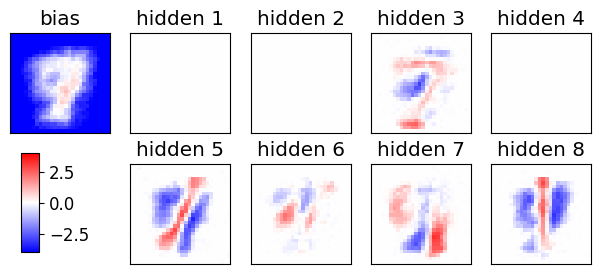

epoch 81 / 500  Nt: 4  N: 22  L: 8  rate: 0.8797595190380761  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 500  Nt: 4  N: 22  L: 8  rate: 0.8782565130260521  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 500  Nt: 4  N: 23  L: 8  rate: 0.8767535070140281  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 500  Nt: 4  N: 23  L: 8  rate: 0.875250501002004  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 500  Nt: 4  N: 23  L: 8  rate: 0.87374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 500  Nt: 4  N: 24  L: 8  rate: 0.8722444889779559  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 500  Nt: 4  N: 24  L: 8  rate: 0.8707414829659319  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 500  Nt: 4  N: 24  L: 8  rate: 0.8692384769539079  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 500  Nt: 4  N: 25  L: 8  rate: 0.8677354709418837  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 500  Nt: 4  N: 25  L: 8  rate: 0.8662324649298597  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 500  Nt: 4  N: 25  L: 

<Figure size 640x480 with 0 Axes>

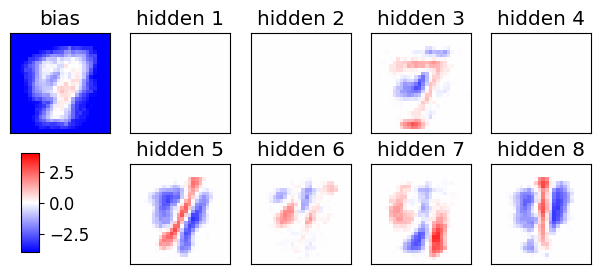

epoch 101 / 500  Nt: 4  N: 29  L: 8  rate: 0.8496993987975952  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 500  Nt: 4  N: 30  L: 8  rate: 0.8481963927855711  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 500  Nt: 4  N: 30  L: 8  rate: 0.8466933867735471  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 500  Nt: 4  N: 30  L: 8  rate: 0.8451903807615231  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 500  Nt: 4  N: 31  L: 8  rate: 0.8436873747494991  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 500  Nt: 4  N: 31  L: 8  rate: 0.8421843687374749  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 500  Nt: 4  N: 32  L: 8  rate: 0.8406813627254509  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 500  Nt: 4  N: 32  L: 8  rate: 0.8391783567134269  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 500  Nt: 4  N: 32  L: 8  rate: 0.8376753507014028  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 500  Nt: 4  N: 33  L: 8  rate: 0.8361723446893787  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 500  Nt:

<Figure size 640x480 with 0 Axes>

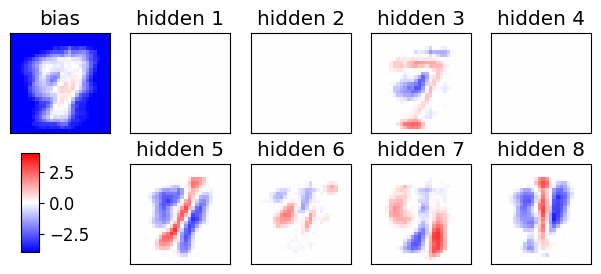

epoch 121 / 500  Nt: 4  N: 38  L: 8  rate: 0.8196392785571143  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 500  Nt: 4  N: 38  L: 8  rate: 0.8181362725450902  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 500  Nt: 4  N: 39  L: 8  rate: 0.8166332665330661  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 500  Nt: 4  N: 39  L: 8  rate: 0.8151302605210421  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 500  Nt: 4  N: 40  L: 8  rate: 0.8136272545090181  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 500  Nt: 4  N: 40  L: 8  rate: 0.8121242484969939  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 500  Nt: 4  N: 41  L: 8  rate: 0.8106212424849699  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 500  Nt: 4  N: 41  L: 8  rate: 0.8091182364729459  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 500  Nt: 4  N: 42  L: 8  rate: 0.8076152304609219  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 500  Nt: 4  N: 42  L: 8  rate: 0.8061122244488979  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 500  Nt:

<Figure size 640x480 with 0 Axes>

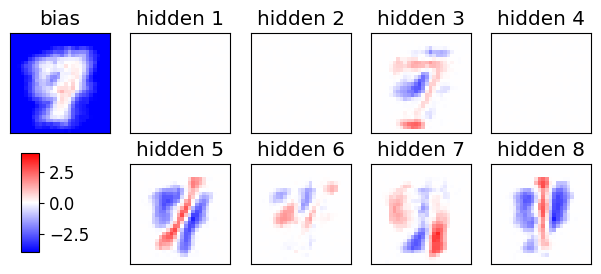

epoch 141 / 500  Nt: 4  N: 48  L: 8  rate: 0.7895791583166333  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 500  Nt: 4  N: 49  L: 8  rate: 0.7880761523046091  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 500  Nt: 4  N: 49  L: 8  rate: 0.7865731462925851  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 500  Nt: 4  N: 50  L: 8  rate: 0.7850701402805611  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 500  Nt: 4  N: 50  L: 8  rate: 0.7835671342685371  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 500  Nt: 4  N: 51  L: 8  rate: 0.7820641282565131  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 500  Nt: 4  N: 51  L: 8  rate: 0.780561122244489  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 500  Nt: 4  N: 52  L: 8  rate: 0.7790581162324649  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 500  Nt: 4  N: 53  L: 8  rate: 0.7775551102204409  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 500  Nt: 4  N: 53  L: 8  rate: 0.7760521042084167  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

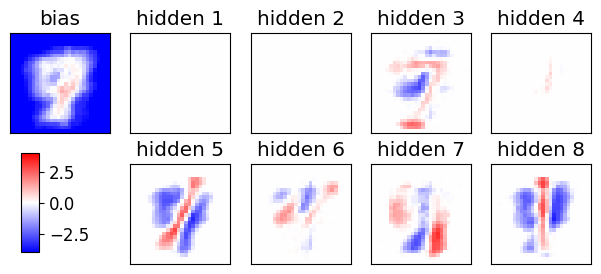

epoch 161 / 500  Nt: 4  N: 60  L: 8  rate: 0.7595190380761523  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 500  Nt: 4  N: 61  L: 8  rate: 0.7580160320641283  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 500  Nt: 4  N: 61  L: 8  rate: 0.7565130260521042  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 500  Nt: 4  N: 62  L: 8  rate: 0.7550100200400802  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 500  Nt: 4  N: 62  L: 8  rate: 0.7535070140280561  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 500  Nt: 4  N: 63  L: 8  rate: 0.7520040080160321  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 500  Nt: 4  N: 64  L: 8  rate: 0.750501002004008  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 500  Nt: 4  N: 64  L: 8  rate: 0.7489979959919839  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 500  Nt: 4  N: 65  L: 8  rate: 0.7474949899799599  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 500  Nt: 4  N: 66  L: 8  rate: 0.7459919839679359  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 500  Nt: 

<Figure size 640x480 with 0 Axes>

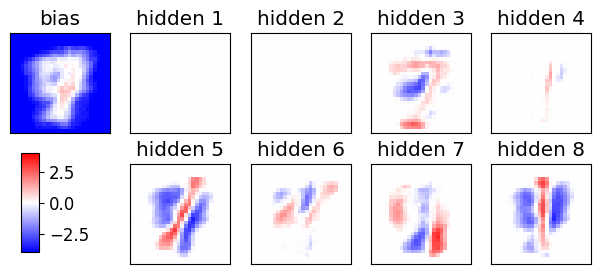

epoch 181 / 500  Nt: 4  N: 73  L: 8  rate: 0.7294589178356713  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 500  Nt: 4  N: 74  L: 8  rate: 0.7279559118236474  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 500  Nt: 4  N: 75  L: 8  rate: 0.7264529058116233  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 500  Nt: 4  N: 75  L: 8  rate: 0.7249498997995992  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 500  Nt: 4  N: 76  L: 8  rate: 0.7234468937875751  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 500  Nt: 4  N: 77  L: 8  rate: 0.7219438877755511  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 500  Nt: 4  N: 78  L: 8  rate: 0.720440881763527  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 500  Nt: 4  N: 78  L: 8  rate: 0.718937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 500  Nt: 4  N: 79  L: 8  rate: 0.717434869739479  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 500  Nt: 4  N: 80  L: 8  rate: 0.715931863727455  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 500  Nt: 4  

<Figure size 640x480 with 0 Axes>

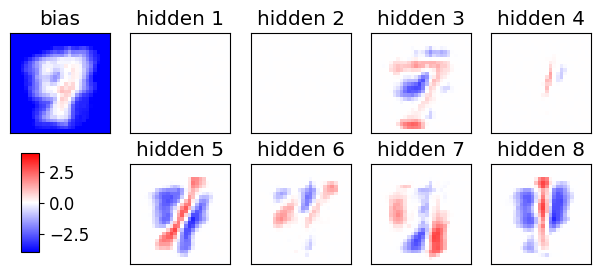

epoch 201 / 500  Nt: 4  N: 88  L: 8  rate: 0.6993987975951903  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 500  Nt: 4  N: 89  L: 8  rate: 0.6978957915831663  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 500  Nt: 4  N: 90  L: 8  rate: 0.6963927855711423  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 500  Nt: 4  N: 91  L: 8  rate: 0.6948897795591182  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 500  Nt: 4  N: 91  L: 8  rate: 0.6933867735470942  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 500  Nt: 4  N: 92  L: 8  rate: 0.6918837675350702  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 500  Nt: 4  N: 93  L: 8  rate: 0.6903807615230461  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 500  Nt: 4  N: 94  L: 8  rate: 0.688877755511022  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 500  Nt: 4  N: 95  L: 8  rate: 0.687374749498998  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 500  Nt: 4  N: 95  L: 8  rate: 0.685871743486974  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 500  Nt: 4 

<Figure size 640x480 with 0 Axes>

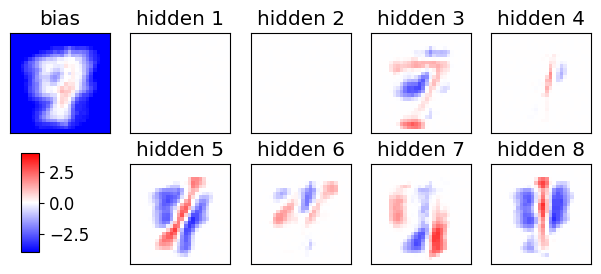

epoch 221 / 500  Nt: 4  N: 105  L: 8  rate: 0.6693386773547094  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 500  Nt: 4  N: 106  L: 8  rate: 0.6678356713426854  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 500  Nt: 4  N: 106  L: 8  rate: 0.6663326653306614  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 500  Nt: 4  N: 107  L: 8  rate: 0.6648296593186372  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 500  Nt: 4  N: 108  L: 8  rate: 0.6633266533066132  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 500  Nt: 4  N: 109  L: 8  rate: 0.6618236472945892  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 500  Nt: 4  N: 110  L: 8  rate: 0.6603206412825651  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 500  Nt: 4  N: 111  L: 8  rate: 0.658817635270541  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 500  Nt: 4  N: 112  L: 8  rate: 0.657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 500  Nt: 4  N: 113  L: 8  rate: 0.655811623246493  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 5

<Figure size 640x480 with 0 Axes>

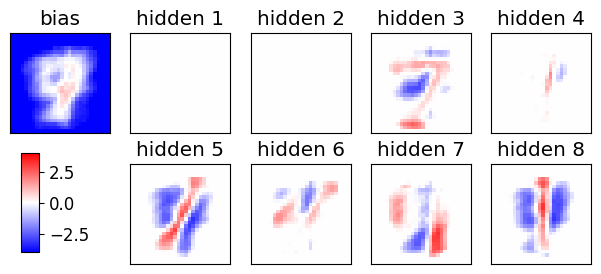

epoch 241 / 500  Nt: 4  N: 123  L: 8  rate: 0.6392785571142285  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 500  Nt: 4  N: 124  L: 8  rate: 0.6377755511022044  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 500  Nt: 4  N: 125  L: 8  rate: 0.6362725450901804  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 500  Nt: 4  N: 126  L: 8  rate: 0.6347695390781563  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 500  Nt: 4  N: 127  L: 8  rate: 0.6332665330661322  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 500  Nt: 4  N: 128  L: 8  rate: 0.6317635270541082  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 500  Nt: 4  N: 129  L: 8  rate: 0.6302605210420842  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 500  Nt: 4  N: 130  L: 8  rate: 0.6287575150300602  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 500  Nt: 4  N: 131  L: 8  rate: 0.6272545090180361  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 500  Nt: 4  N: 132  L: 8  rate: 0.625751503006012  gam: 0.01 SPINS= False POTTS= True
epoch 251 /

<Figure size 640x480 with 0 Axes>

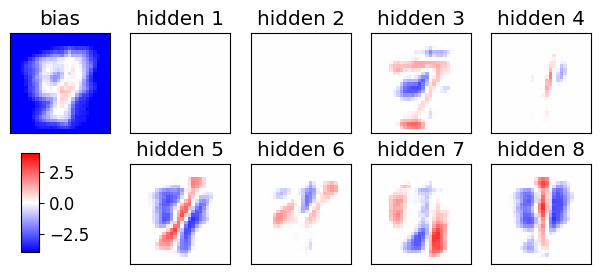

epoch 261 / 500  Nt: 4  N: 143  L: 8  rate: 0.6092184368737475  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 500  Nt: 4  N: 144  L: 8  rate: 0.6077154308617234  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 500  Nt: 4  N: 145  L: 8  rate: 0.6062124248496994  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 500  Nt: 4  N: 146  L: 8  rate: 0.6047094188376754  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 500  Nt: 4  N: 147  L: 8  rate: 0.6032064128256514  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 500  Nt: 4  N: 148  L: 8  rate: 0.6017034068136273  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 500  Nt: 4  N: 149  L: 8  rate: 0.6002004008016032  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 500  Nt: 4  N: 150  L: 8  rate: 0.5986973947895792  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 500  Nt: 4  N: 151  L: 8  rate: 0.5971943887775552  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 500  Nt: 4  N: 152  L: 8  rate: 0.595691382765531  gam: 0.01 SPINS= False POTTS= True
epoch 271 /

<Figure size 640x480 with 0 Axes>

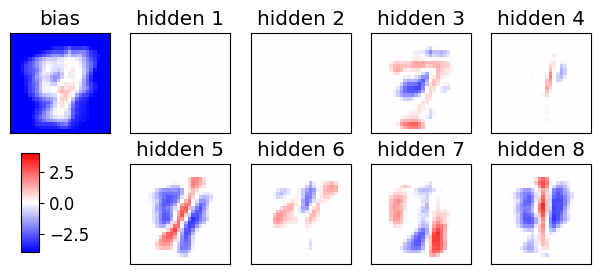

epoch 281 / 500  Nt: 4  N: 164  L: 8  rate: 0.5791583166332666  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 500  Nt: 4  N: 165  L: 8  rate: 0.5776553106212425  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 500  Nt: 4  N: 166  L: 8  rate: 0.5761523046092184  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 500  Nt: 4  N: 167  L: 8  rate: 0.5746492985971944  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 500  Nt: 4  N: 168  L: 8  rate: 0.5731462925851704  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 500  Nt: 4  N: 169  L: 8  rate: 0.5716432865731462  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 500  Nt: 4  N: 170  L: 8  rate: 0.5701402805611222  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 500  Nt: 4  N: 172  L: 8  rate: 0.5686372745490982  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 500  Nt: 4  N: 173  L: 8  rate: 0.5671342685370742  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 500  Nt: 4  N: 174  L: 8  rate: 0.5656312625250501  gam: 0.01 SPINS= False POTTS= True
epoch 291 

<Figure size 640x480 with 0 Axes>

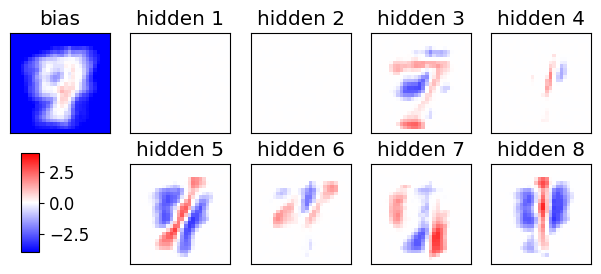

epoch 301 / 500  Nt: 4  N: 187  L: 8  rate: 0.5490981963927856  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 500  Nt: 4  N: 188  L: 8  rate: 0.5475951903807614  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 500  Nt: 4  N: 189  L: 8  rate: 0.5460921843687374  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 500  Nt: 4  N: 190  L: 8  rate: 0.5445891783567134  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 500  Nt: 4  N: 191  L: 8  rate: 0.5430861723446894  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 500  Nt: 4  N: 193  L: 8  rate: 0.5415831663326653  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 500  Nt: 4  N: 194  L: 8  rate: 0.5400801603206413  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 500  Nt: 4  N: 195  L: 8  rate: 0.5385771543086173  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 500  Nt: 4  N: 196  L: 8  rate: 0.5370741482965933  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 500  Nt: 4  N: 197  L: 8  rate: 0.5355711422845691  gam: 0.01 SPINS= False POTTS= True
epoch 311 

<Figure size 640x480 with 0 Axes>

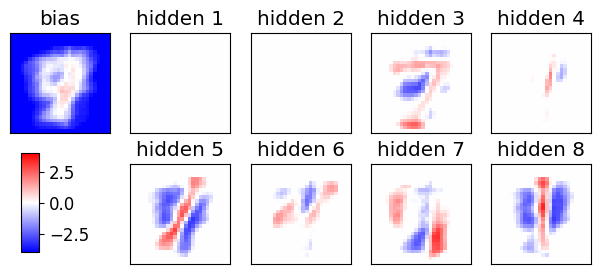

epoch 321 / 500  Nt: 4  N: 211  L: 8  rate: 0.5190380761523046  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 500  Nt: 4  N: 212  L: 8  rate: 0.5175350701402806  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 500  Nt: 4  N: 214  L: 8  rate: 0.5160320641282565  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 500  Nt: 4  N: 215  L: 8  rate: 0.5145290581162325  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 500  Nt: 4  N: 216  L: 8  rate: 0.5130260521042085  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 500  Nt: 4  N: 217  L: 8  rate: 0.5115230460921844  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 500  Nt: 4  N: 219  L: 8  rate: 0.5100200400801603  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 500  Nt: 4  N: 220  L: 8  rate: 0.5085170340681363  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 500  Nt: 4  N: 221  L: 8  rate: 0.5070140280561122  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 500  Nt: 4  N: 223  L: 8  rate: 0.5055110220440882  gam: 0.01 SPINS= False POTTS= True
epoch 331 

<Figure size 640x480 with 0 Axes>

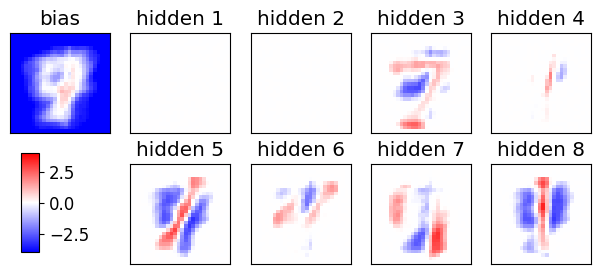

epoch 341 / 500  Nt: 4  N: 237  L: 8  rate: 0.4889779559118237  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 500  Nt: 4  N: 238  L: 8  rate: 0.48747494989979956  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 500  Nt: 4  N: 240  L: 8  rate: 0.48597194388777554  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 500  Nt: 4  N: 241  L: 8  rate: 0.4844689378757515  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 500  Nt: 4  N: 242  L: 8  rate: 0.4829659318637274  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 500  Nt: 4  N: 244  L: 8  rate: 0.48146292585170336  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 500  Nt: 4  N: 245  L: 8  rate: 0.47995991983967934  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 500  Nt: 4  N: 246  L: 8  rate: 0.4784569138276553  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 500  Nt: 4  N: 248  L: 8  rate: 0.4769539078156313  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 500  Nt: 4  N: 249  L: 8  rate: 0.47545090180360716  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

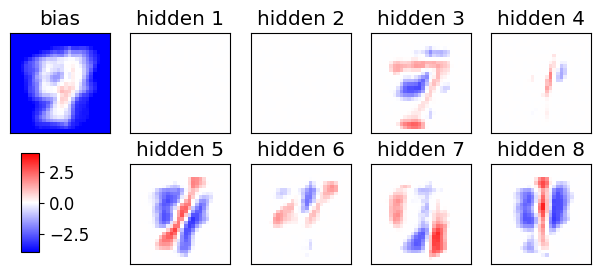

epoch 361 / 500  Nt: 4  N: 265  L: 8  rate: 0.4589178356713426  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 500  Nt: 4  N: 266  L: 8  rate: 0.4574148296593187  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 500  Nt: 4  N: 267  L: 8  rate: 0.45591182364729466  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 500  Nt: 4  N: 269  L: 8  rate: 0.4544088176352705  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 500  Nt: 4  N: 270  L: 8  rate: 0.4529058116232465  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 500  Nt: 4  N: 272  L: 8  rate: 0.4514028056112225  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 500  Nt: 4  N: 273  L: 8  rate: 0.44989979959919846  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 500  Nt: 4  N: 275  L: 8  rate: 0.44839679358717444  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 500  Nt: 4  N: 276  L: 8  rate: 0.4468937875751503  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 500  Nt: 4  N: 277  L: 8  rate: 0.4453907815631263  gam: 0.01 SPINS= False POTTS= True
epoch 3

<Figure size 640x480 with 0 Axes>

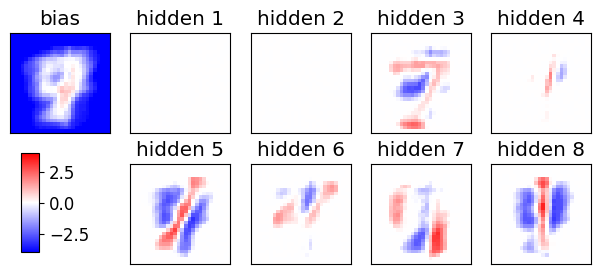

epoch 381 / 500  Nt: 4  N: 294  L: 8  rate: 0.4288577154308617  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 500  Nt: 4  N: 295  L: 8  rate: 0.4273547094188377  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 500  Nt: 4  N: 297  L: 8  rate: 0.42585170340681366  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 500  Nt: 4  N: 298  L: 8  rate: 0.42434869739478964  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 500  Nt: 4  N: 300  L: 8  rate: 0.4228456913827655  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 500  Nt: 4  N: 301  L: 8  rate: 0.4213426853707415  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 500  Nt: 4  N: 303  L: 8  rate: 0.41983967935871747  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 500  Nt: 4  N: 304  L: 8  rate: 0.41833667334669333  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 500  Nt: 4  N: 306  L: 8  rate: 0.4168336673346693  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 500  Nt: 4  N: 307  L: 8  rate: 0.4153306613226453  gam: 0.01 SPINS= False POTTS= True
epoch 

<Figure size 640x480 with 0 Axes>

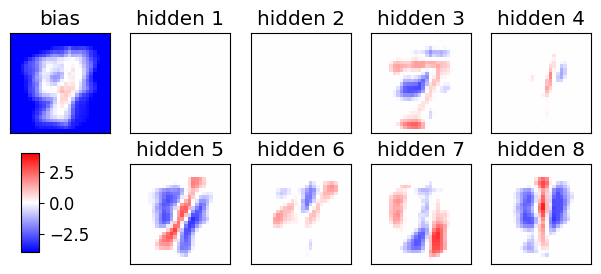

epoch 401 / 500  Nt: 4  N: 324  L: 8  rate: 0.3987975951903807  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 500  Nt: 4  N: 326  L: 8  rate: 0.3972945891783567  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 500  Nt: 4  N: 328  L: 8  rate: 0.39579158316633267  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 500  Nt: 4  N: 329  L: 8  rate: 0.39428857715430854  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 500  Nt: 4  N: 331  L: 8  rate: 0.3927855711422845  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 500  Nt: 4  N: 332  L: 8  rate: 0.3912825651302605  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 500  Nt: 4  N: 334  L: 8  rate: 0.3897795591182365  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 500  Nt: 4  N: 335  L: 8  rate: 0.38827655310621245  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 500  Nt: 4  N: 337  L: 8  rate: 0.3867735470941883  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 500  Nt: 4  N: 339  L: 8  rate: 0.3852705410821643  gam: 0.01 SPINS= False POTTS= True
epoch 4

<Figure size 640x480 with 0 Axes>

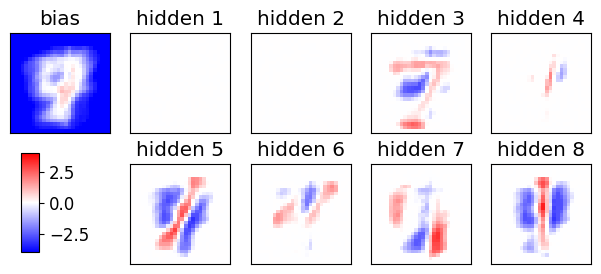

epoch 421 / 500  Nt: 4  N: 357  L: 8  rate: 0.36873747494989983  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 500  Nt: 4  N: 358  L: 8  rate: 0.3672344689378758  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 500  Nt: 4  N: 360  L: 8  rate: 0.3657314629258517  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 500  Nt: 4  N: 362  L: 8  rate: 0.36422845691382766  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 500  Nt: 4  N: 363  L: 8  rate: 0.36272545090180364  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 500  Nt: 4  N: 365  L: 8  rate: 0.3612224448897796  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 500  Nt: 4  N: 367  L: 8  rate: 0.3597194388777556  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 500  Nt: 4  N: 368  L: 8  rate: 0.35821643286573146  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 500  Nt: 4  N: 370  L: 8  rate: 0.35671342685370744  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 500  Nt: 4  N: 372  L: 8  rate: 0.3552104208416834  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

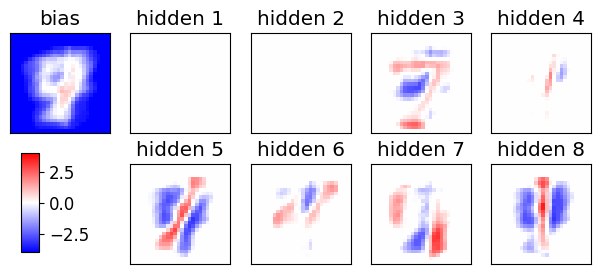

epoch 441 / 500  Nt: 4  N: 390  L: 8  rate: 0.33867735470941884  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 500  Nt: 4  N: 392  L: 8  rate: 0.3371743486973948  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 500  Nt: 4  N: 394  L: 8  rate: 0.3356713426853708  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 500  Nt: 4  N: 396  L: 8  rate: 0.33416833667334667  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 500  Nt: 4  N: 397  L: 8  rate: 0.33266533066132264  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 500  Nt: 4  N: 399  L: 8  rate: 0.3311623246492986  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 500  Nt: 4  N: 401  L: 8  rate: 0.3296593186372745  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 500  Nt: 4  N: 403  L: 8  rate: 0.32815631262525047  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 500  Nt: 4  N: 404  L: 8  rate: 0.32665330661322645  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 500  Nt: 4  N: 406  L: 8  rate: 0.3251503006012024  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

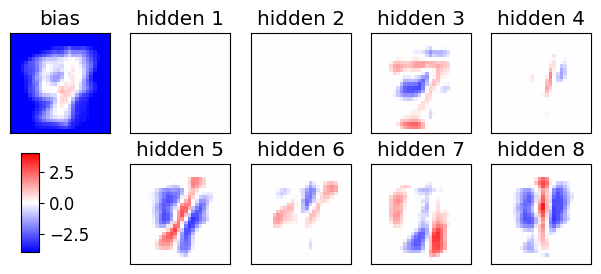

epoch 461 / 500  Nt: 4  N: 426  L: 8  rate: 0.30861723446893785  gam: 0.01 SPINS= False POTTS= True
epoch 462 / 500  Nt: 4  N: 428  L: 8  rate: 0.30711422845691383  gam: 0.01 SPINS= False POTTS= True
epoch 463 / 500  Nt: 4  N: 430  L: 8  rate: 0.3056112224448897  gam: 0.01 SPINS= False POTTS= True
epoch 464 / 500  Nt: 4  N: 431  L: 8  rate: 0.3041082164328657  gam: 0.01 SPINS= False POTTS= True
epoch 465 / 500  Nt: 4  N: 433  L: 8  rate: 0.30260521042084165  gam: 0.01 SPINS= False POTTS= True
epoch 466 / 500  Nt: 4  N: 435  L: 8  rate: 0.30110220440881763  gam: 0.01 SPINS= False POTTS= True
epoch 467 / 500  Nt: 4  N: 437  L: 8  rate: 0.2995991983967936  gam: 0.01 SPINS= False POTTS= True
epoch 468 / 500  Nt: 4  N: 439  L: 8  rate: 0.2980961923847695  gam: 0.01 SPINS= False POTTS= True
epoch 469 / 500  Nt: 4  N: 441  L: 8  rate: 0.29659318637274545  gam: 0.01 SPINS= False POTTS= True
epoch 470 / 500  Nt: 4  N: 442  L: 8  rate: 0.29509018036072143  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

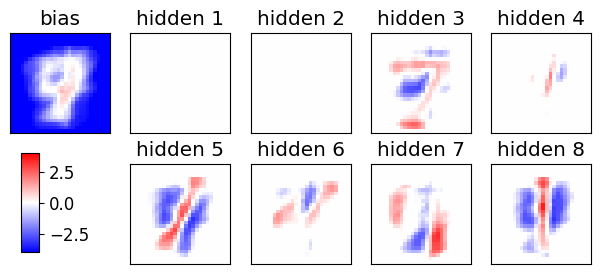

epoch 481 / 500  Nt: 4  N: 463  L: 8  rate: 0.27855711422845697  gam: 0.01 SPINS= False POTTS= True
epoch 482 / 500  Nt: 4  N: 465  L: 8  rate: 0.27705410821643284  gam: 0.01 SPINS= False POTTS= True
epoch 483 / 500  Nt: 4  N: 467  L: 8  rate: 0.2755511022044088  gam: 0.01 SPINS= False POTTS= True
epoch 484 / 500  Nt: 4  N: 469  L: 8  rate: 0.2740480961923848  gam: 0.01 SPINS= False POTTS= True
epoch 485 / 500  Nt: 4  N: 470  L: 8  rate: 0.27254509018036077  gam: 0.01 SPINS= False POTTS= True
epoch 486 / 500  Nt: 4  N: 472  L: 8  rate: 0.27104208416833675  gam: 0.01 SPINS= False POTTS= True
epoch 487 / 500  Nt: 4  N: 474  L: 8  rate: 0.2695390781563126  gam: 0.01 SPINS= False POTTS= True
epoch 488 / 500  Nt: 4  N: 476  L: 8  rate: 0.2680360721442886  gam: 0.01 SPINS= False POTTS= True
epoch 489 / 500  Nt: 4  N: 478  L: 8  rate: 0.2665330661322646  gam: 0.01 SPINS= False POTTS= True
epoch 490 / 500  Nt: 4  N: 480  L: 8  rate: 0.26503006012024044  gam: 0.01 SPINS= False POTTS= True
epoch

<Figure size 640x480 with 0 Axes>

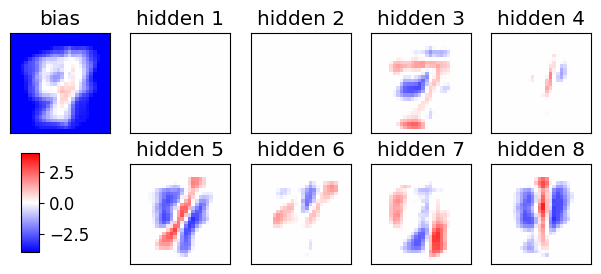

END of learning phase


In [87]:
for L in L_v:
    if POTTS:
        str_simul="RBM_Potts"
        Nz=L
    else:
        str_simul="RBM"
    # number of possible hidden states: 2**L
        Nz=2**L
    
    # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
    w = sigma * np.random.randn(D,L)
    #a = sigma * np.random.randn(D)
    # using Hinton initialization of visible biases
    a = Hinton_bias_init(data)
    # hidden biases initialized to zero
    b = np.zeros(L)
    #print("w=",w);print("a=",a);print("b=",b)

    # nr of epochs
    Nepoch= 500 
    # minibatches per epoch
    Nmini=20
    # minibatch size at initial epoch and final one
    N_ini,N_fin=10,500
    print(f"Nepoch={Nepoch}\nNmini={Nmini}")


    # recording history of weights ("E" means epoch)
    wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
    wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
    gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
    gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
    gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
    miniE = np.zeros(Nepoch+1)
    pzE=np.zeros((Nepoch+1,Nz))
    if GRAD=="RMSprop":
        gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)

    indices=np.arange(Nd).astype("int")
    plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)

    # for the plot with panels
    Ncols=min(8,max(2,L//2))

    if POTTS: print("Starting the training, POTTS=True")
    else: print("Starting the training")

    # Note: here an epoch does not analyze the whole dataset
    for epoch in range(1,1+Nepoch):
        # q maps epochs to interval [0,1]
        q = (epoch-1.)/(Nepoch-1.)
        # N, size of the mini batch
        # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
        N = int(N_ini + (N_fin-N_ini)*(q**2))
        #  l_rate interpolates between initial and final value
        l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q

        for mini in range(Nmini):
            # initializitation for averages in minibatch
            # visible variables "v" --> "x"
            #  hidden variables "h" --> "z"
            x_data, x_model = np.zeros(D),np.zeros(D)
            z_data, z_model = np.zeros(L),np.zeros(L)
            xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
            pz = np.zeros(L)

            # Minibatch of size N: points randomply picked (without repetition) from data
            selected = np.random.choice(indices,N,replace=False)
            if epoch==1 and mini<=3: print(selected)

            for k in range(N):
                ###################################
                x0 = data[selected[k]]
                # positive CD phase: generating z from x[k]
                z = CD_step(x0,w,b,POTTS=POTTS)
                x_data  += x0
                z_data  += z
                xz_data += np.outer(x0,z)
                # fantasy
                zf=np.copy(z)
                # Contrastive divergence with Nt steps
                for t in range(Nt):
                    # negative CD pzase: generating fantasy xf from fantasy zf
                    xf = CD_step(zf,w.T,a)
                    # positive CD phase: generating fantasy zf from fantasy xf
                    zf = CD_step(xf,w,b,POTTS=POTTS)
                x_model += xf
                z_model += zf
                xz_model+= np.outer(xf,zf)
                # recording probability of encoding in z-space, if POTTS
                if POTTS: pz[zf]+=1
                ###################################

            # gradient of the likelihood: follow it along its positive direction
            gw_d,gw_m = xz_data/N, xz_model/N
            ga_d,ga_m = x_data/N, x_model/N
            gb_d,gb_m = z_data/N, z_model/N
            gw=np.copy(gw_d - gw_m)
            ga=np.copy(ga_d - ga_m)
            gb=np.copy(gb_d - gb_m)

            # gradient ascent step
            if GRAD=="RMSprop":
                # RMSprop gradient ascent
                gw2 = beta*gw2+(1-beta)*np.square(gw)
                ga2 = beta*ga2+(1-beta)*np.square(ga)
                gb2 = beta*gb2+(1-beta)*np.square(gb)
                w += l_rate*gw/sqrt(epsilon+gw2)
                a += l_rate*ga/sqrt(epsilon+ga2)
                b += l_rate*gb/sqrt(epsilon+gb2)
            else:
                # defaulting to the vanilla stochastic gradient ascent (SGD)
                w += l_rate*gw
                a += l_rate*ga
                b += l_rate*gb
            # regularization (LASSO)
            if gamma>0.:
                w -= (gamma*l_rate)*sign(w)
                a -= (gamma*l_rate)*sign(a)
                b -= (gamma*l_rate)*sign(b)

        wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
        aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
        bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
        miniE[epoch]=N
        if POTTS: pzE[epoch] = pz/np.sum(pz)
        print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
              " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)

        if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
            plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

        str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
    save_epochs(wE,"w")
    save_epochs(bE,"b")
    save_epochs(aE,"a")

print("END of learning phase")
